In [1]:
### Import modules

import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from IPython.display import display
import glob
import lanefind
%matplotlib inline

import importlib
importlib.reload(lanefind)



<module 'lanefind' from '/Users/amorten/Projects/Udacity/SelfDrivingCar/Term1/CarND-Advanced-Lane-Lines/lanefind.py'>

In [2]:
### Define a helper function that plots on array of images
### in a nx by ny grid

def plot_images(images,nx,ny,figsize=(15,10),titles=[],fontsize=36,cmap=None,saveas=""):

    fig = plt.figure(figsize=figsize)

    for idx in range(len(images)):
    
        plt.subplot(nx,ny,idx+1)
        plt.imshow(images[idx],cmap=cmap)
        if(len(titles) > idx):
            plt.title(titles[idx],fontsize=fontsize)
    
    display(fig)
    if saveas:
        plt.savefig(saveas,bbox_inches="tight")
    plt.close()
        

Calibration images with detected corners:


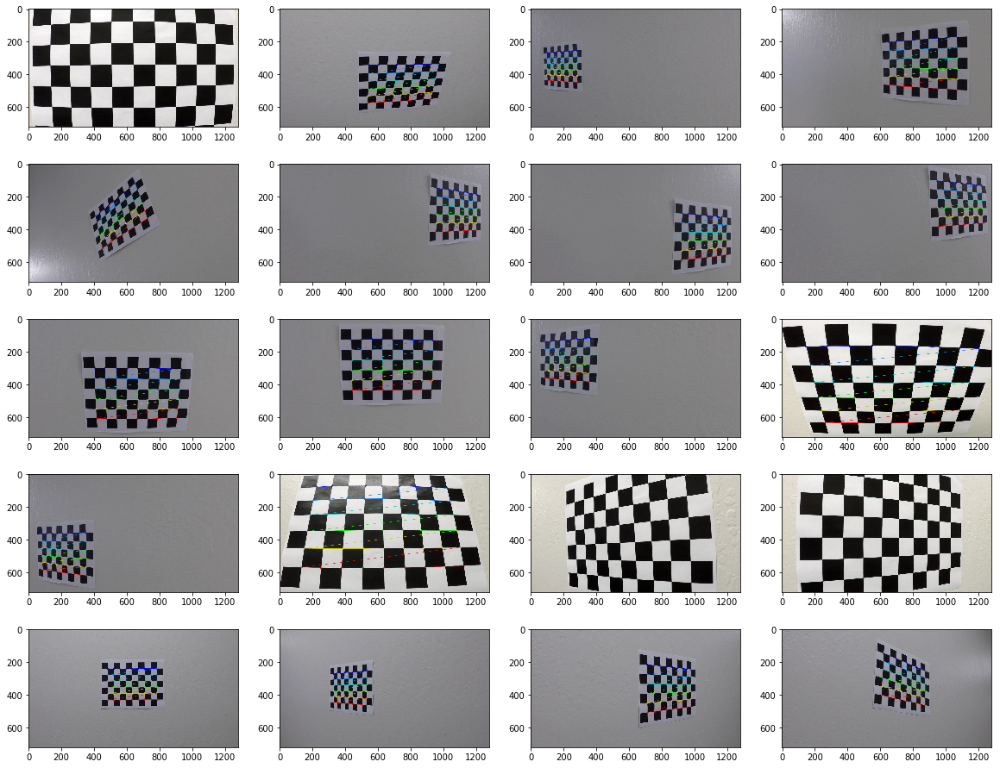

Undistorted Calibration images:


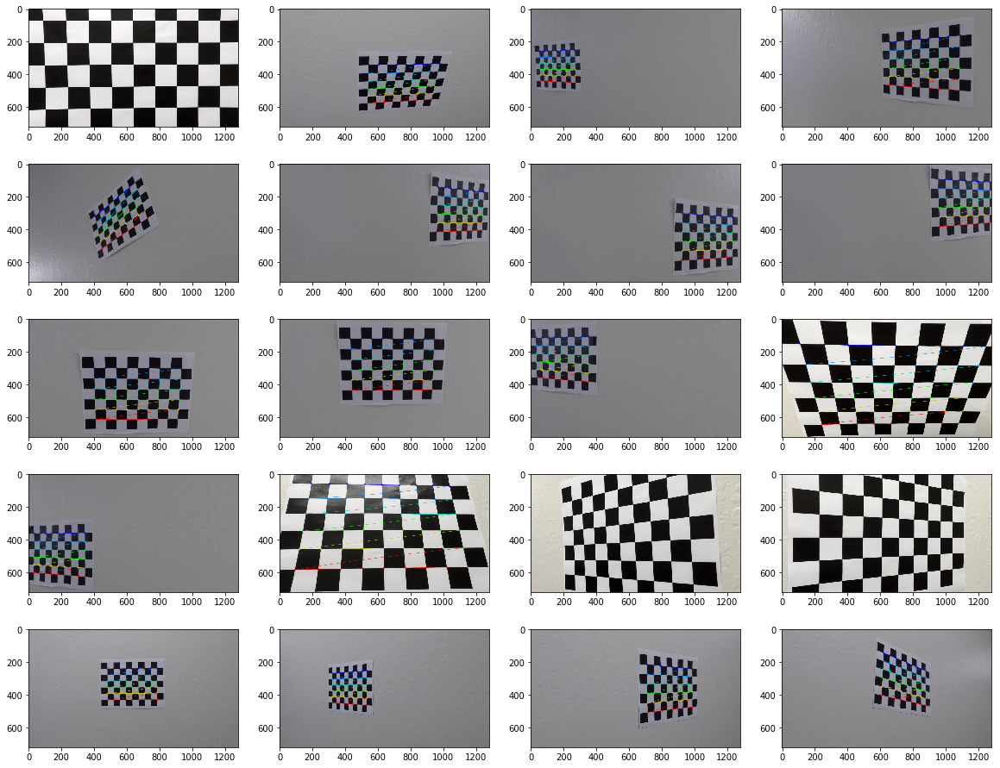

An example of undistorting a calibrtion image:


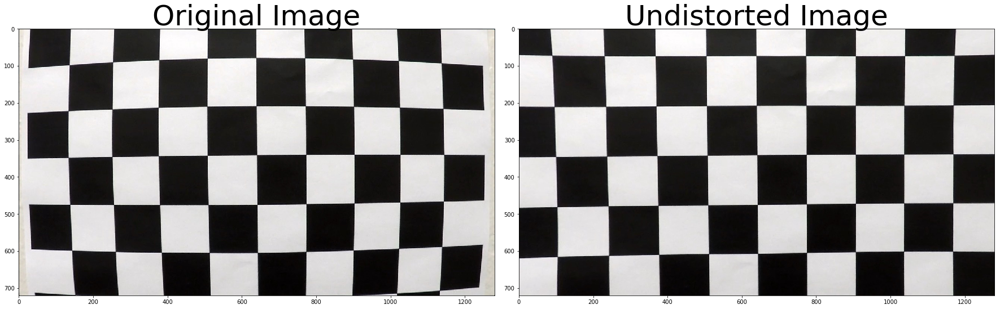

In [3]:
### Do the camera calibration

# prepare object points
nx = 9 # Number of inside corners in x
ny = 6 # Number of inside corners in y

# Make a list of calibration images
fnames = 'camera_cal/calibration*.jpg'
image_fnames = glob.glob(fnames)

# Calibrate camera using above list of calibration images
ret, mtx, dist, rvecs, tvecs, cal_images = lanefind.calibrate_camera(image_fnames,nx,ny)

# Plot the calibration images with corners drawn on
print("Calibration images with detected corners:")
plot_images(cal_images,5,4,figsize=(20,16),
           saveas="./output_images/all_detected_corners.jpg")

# Plot all of the undistorted calibration images
cal_undists = []
for img in cal_images:

    cal_undist = cv2.undistort(img, mtx, dist, None, mtx)
    cal_undists.append(cal_undist)

print("Undistorted Calibration images:")
plot_images(cal_undists,5,4,figsize=(20,16),
           saveas="./output_images/all_undistorted.jpg")
    
# Plot an example undistorted image:
print("An example of undistorting a calibrtion image:")
img = mpimg.imread(image_fnames[0])
undist = cv2.undistort(img, mtx, dist, None, mtx)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig("./output_images/undistort_example.jpg")


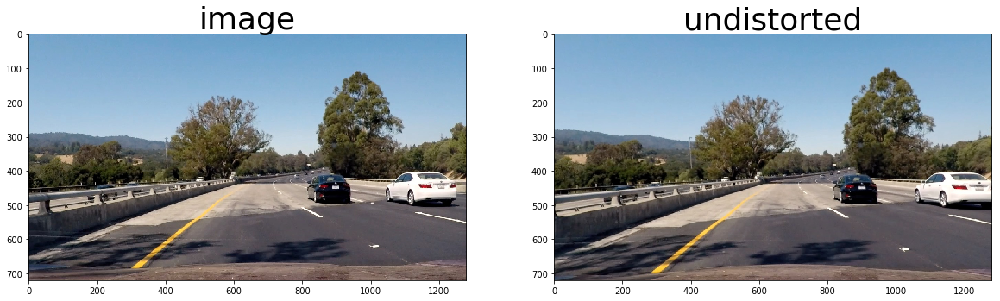

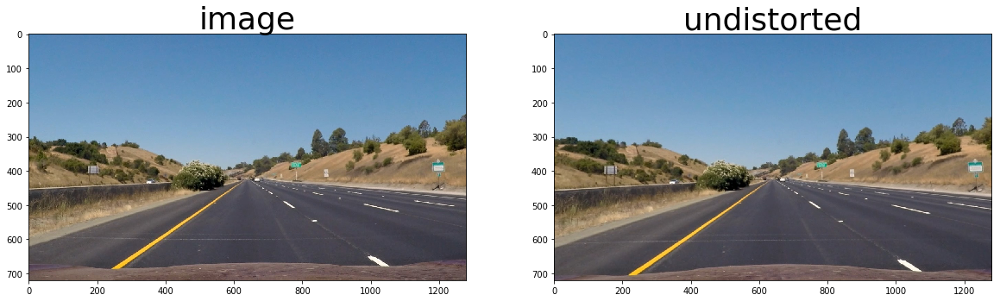

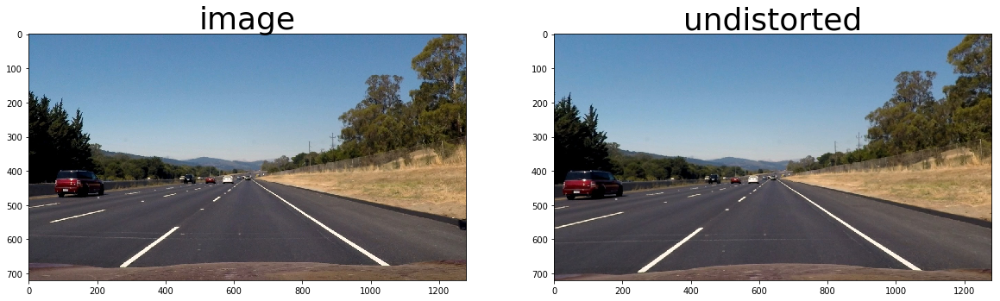

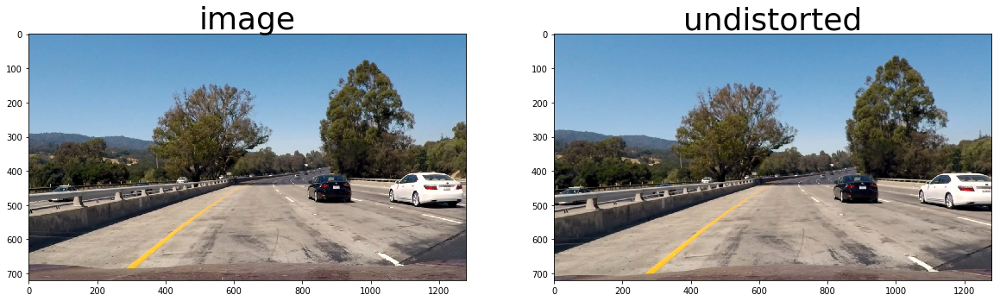

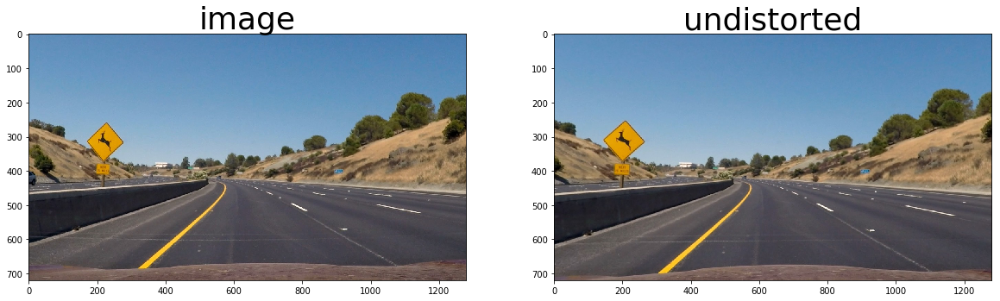

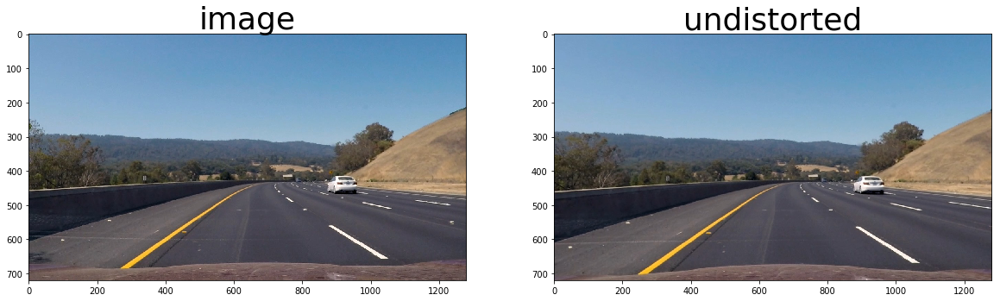

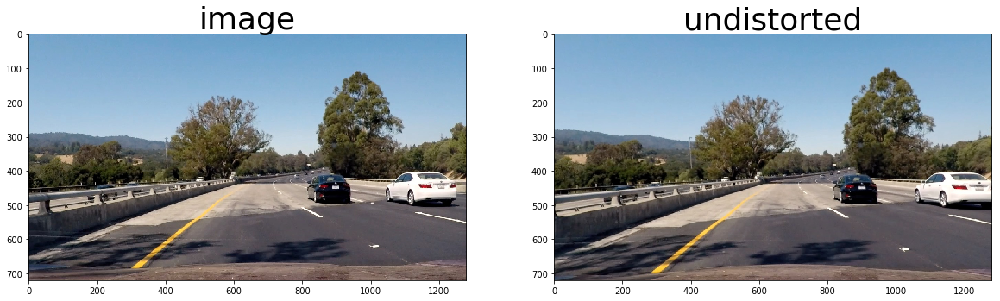

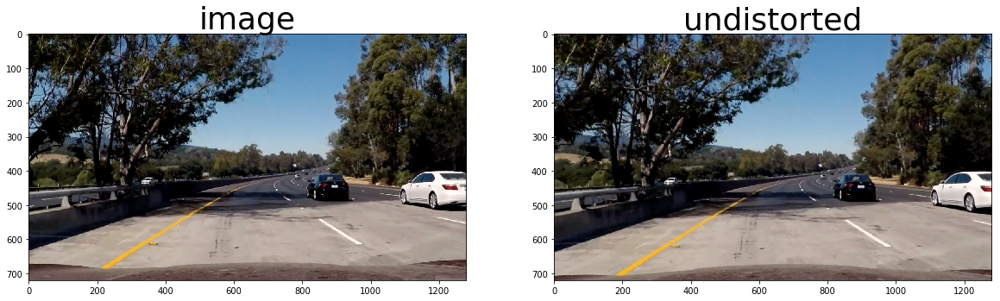

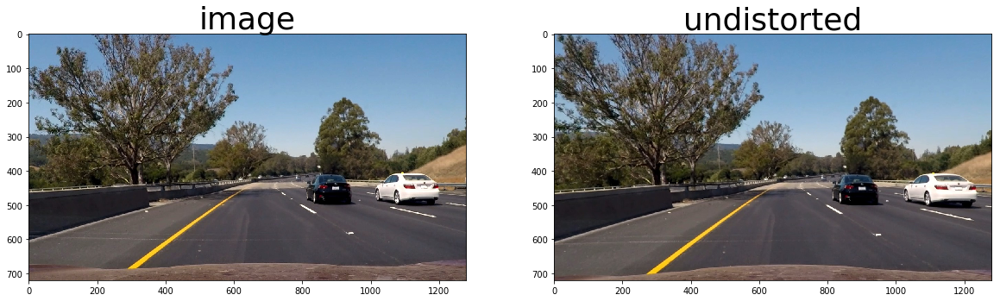

In [4]:
### For reference, here is how to apply a distortion correction 
### to a single image:

fname = 'test_images/test4.jpg'
image = mpimg.imread(fname)

undist = cv2.undistort(image, mtx, dist, None, mtx)

plot_images([image, undist],1,2,figsize=(20,8),
            titles=["image","undistorted"],
           saveas="output_images/undistorted_test_image.jpg")

# Well, here it is again for all images, since I think the project rubric
# requires it...

fnames = 'test_images/*.jpg'
image_fnames = glob.glob(fnames)

for fname in image_fnames:
    
    image = mpimg.imread(fname)
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    plot_images([image, undist],1,2,figsize=(20,8),
                titles=["image","undistorted"])

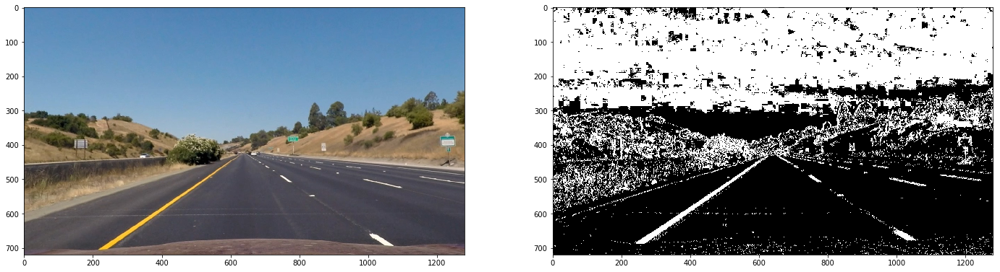

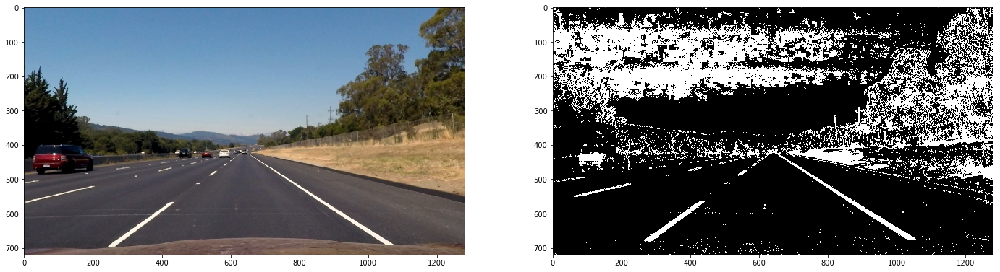

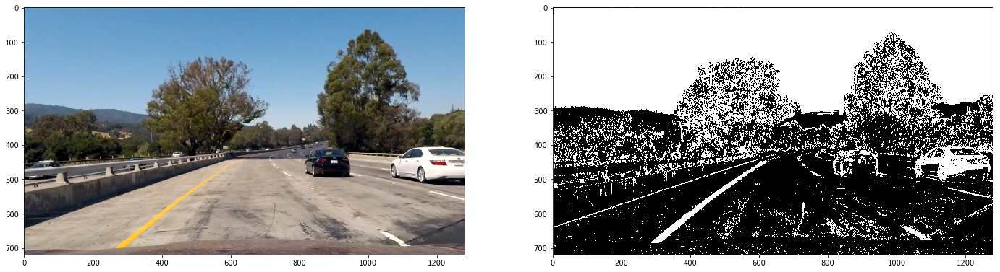

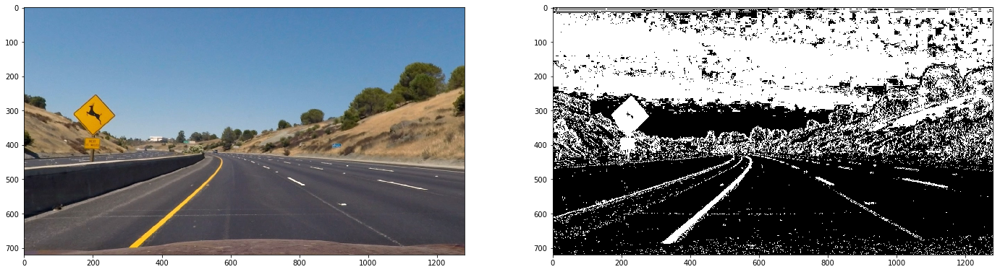

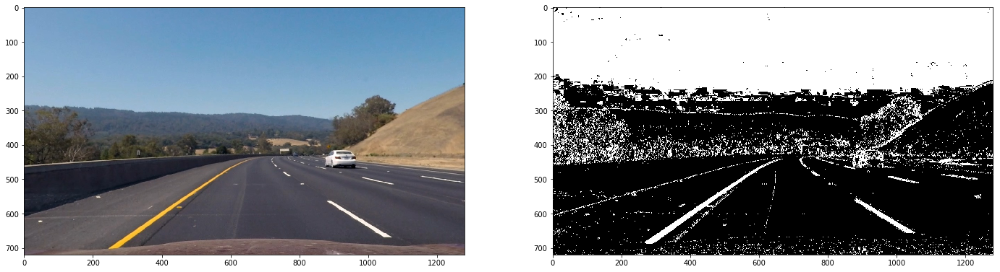

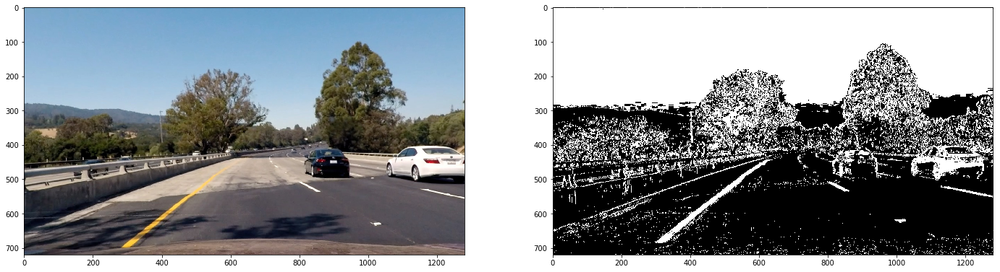

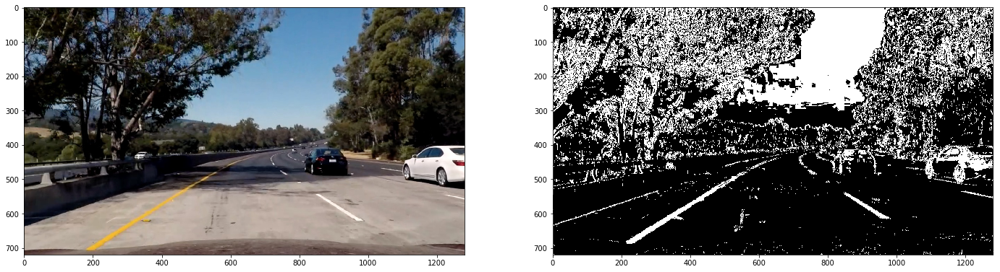

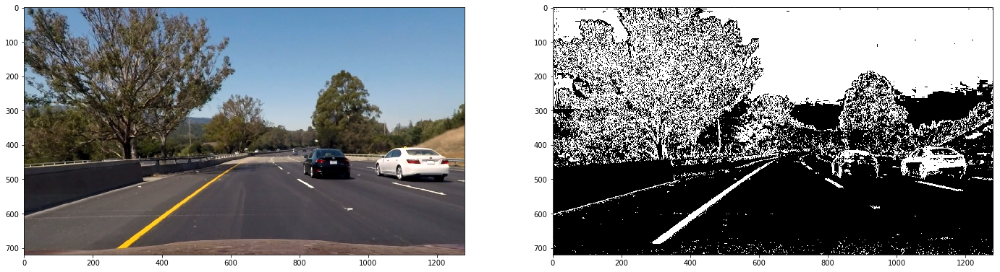

In [5]:
### Find lane pixels in all of the test images.
### And plot the resulting binary images.

fnames = 'test_images/*.jpg'
#fnames = 'test_images/test1.jpg'
image_fnames = glob.glob(fnames)

images = []
undists = []
color_binaries = []
combined_binaries = []

for fname in image_fnames:

    # First undistort the raw images
    img = mpimg.imread(fname)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Then apply color/gradient thresholds to find lane lines
    color_binary, combined_binary = lanefind.threshold_image_improved(img, 
                                                             sx_thresh=(12,255), 
                                                             sy_thresh=(5,255), 
                                                             s_thresh=(100,255), 
                                                             v_thresh=(50,255))
    images.append(img)
    undists.append(undist)
    color_binaries.append(color_binary)
    combined_binaries.append(combined_binary)


# Plot both the undistorted image and binary lane pixes for each test image
for idx in range(len(images)):
    
    plot_images([undists[idx], combined_binaries[idx]],1,2,figsize=(24,9),
                cmap = "gray",
               saveas="output_images/binary.jpg")


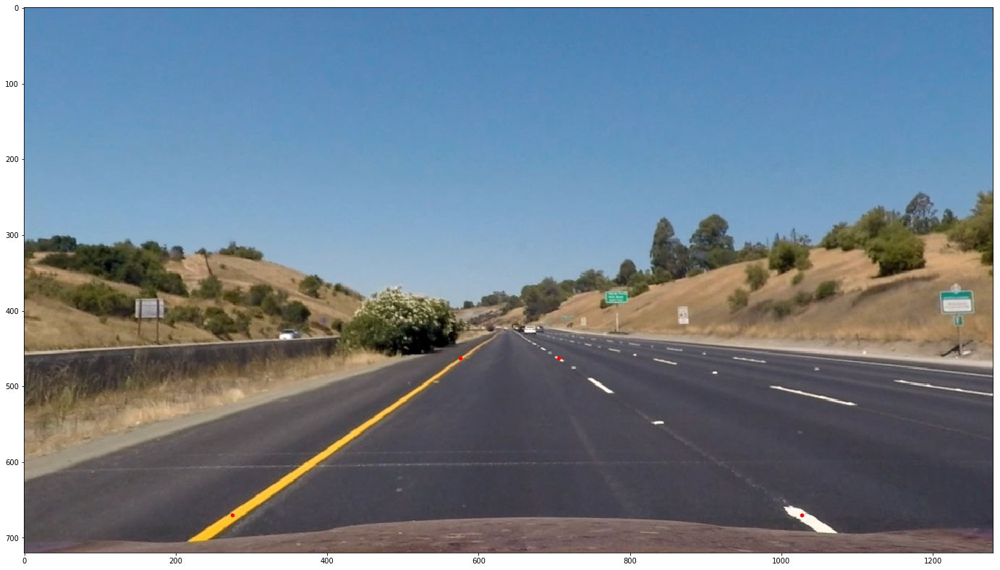

In [6]:
### Determine a trapezoid on the undistorted image 
### that would correspond to a rectangle when viewed
### from above (birds-eye view), and then compute
### the transformation matrix, M, and its inverse, Minv.
### Use an image with straight lane lines and indicate the
### corners of the trapezoid with red dots.

# this image has straight lane lines
image = undists[0]

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(24, 18))

ax.imshow(image)

# Here are the positions of the trapezoid corners, based
# on investigating the image manually

lr = [995+32,750-80] #[x,y] coords of lower right corner
ll = [243+32,750-80] #[x,y] coords of lower left corner
ur = [674+32,543-80] #[x,y] coords of upper right corner
ul = [544+32,543-80] #[x,y] coords of upper left corner

# Set margins so that that left curving and right curving
# lanes will be fully visible in birds-eye-view
margin_bottom = 40
margin_top = -200
margin_left = 70
margin_right = -70

src = np.float32([ur,lr,ll,ul])
dst = np.float32([[lr[0]+margin_right,ur[1]+margin_top],
                  [lr[0]+margin_right,lr[1]+margin_bottom],
                  [ll[0]+margin_left,ll[1]+margin_bottom],
                  [ll[0]+margin_left,ul[1]+margin_top]])

# Compute the perspective transform, M, given source and 
# destination points:
M = cv2.getPerspectiveTransform(src, dst)

# Compute the inverse perspective transform, Minv:
Minv = cv2.getPerspectiveTransform(dst, src)

# Now plot the corners of the trapezoid
ax.scatter(lr[0],lr[1],c='r',s=20)
ax.scatter(ll[0],ll[1],c='r',s=20)
ax.scatter(ur[0],ur[1],c='r',s=20)
ax.scatter(ul[0],ul[1],c='r',s=20)

plt.show()

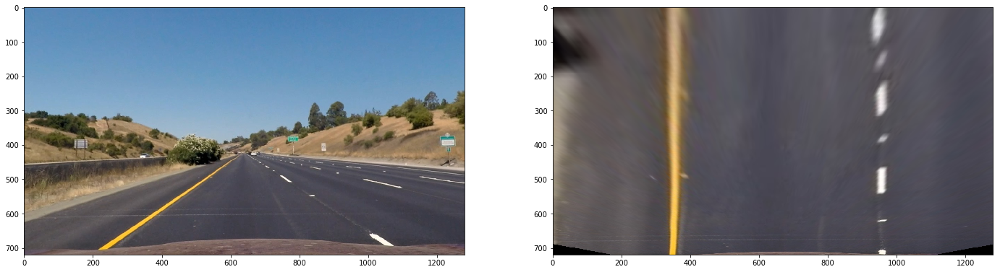

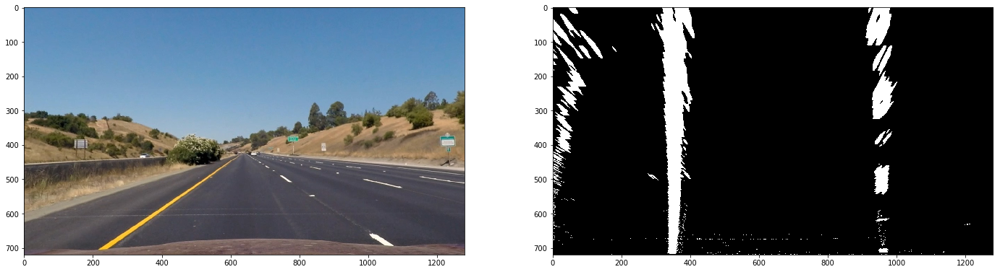

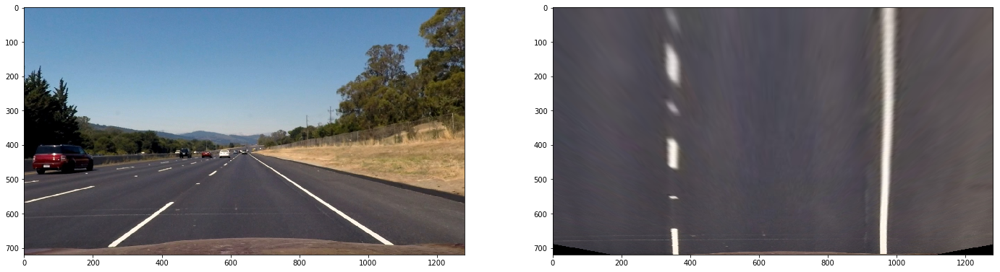

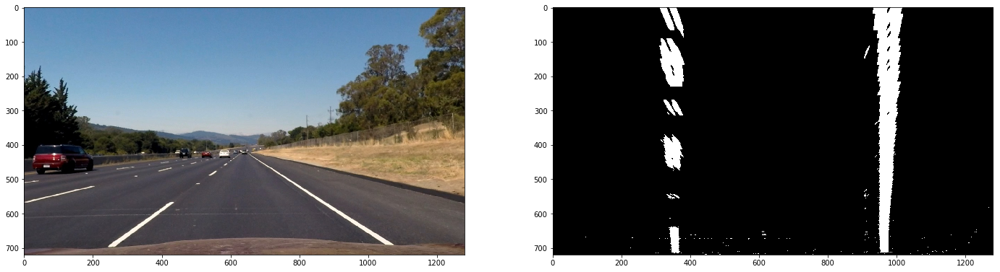

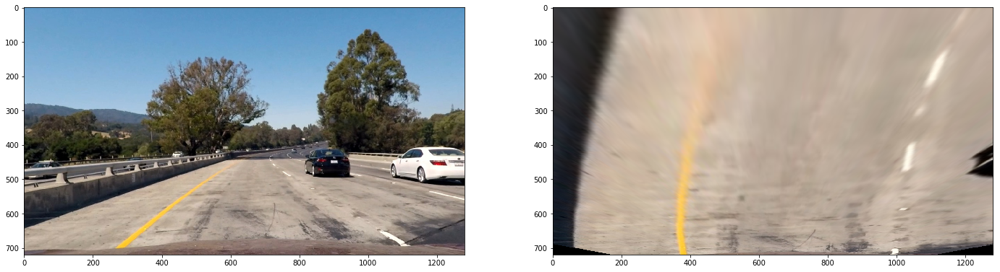

...

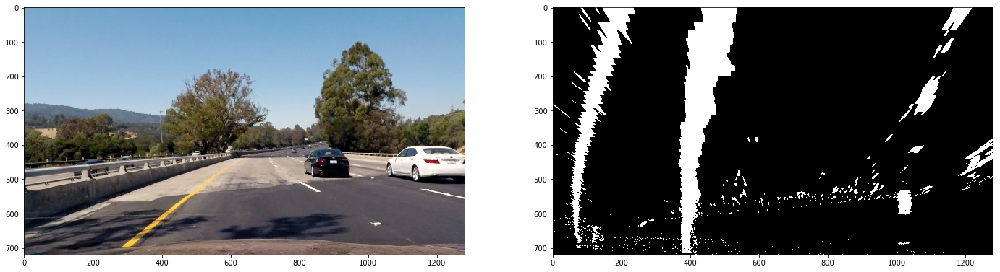

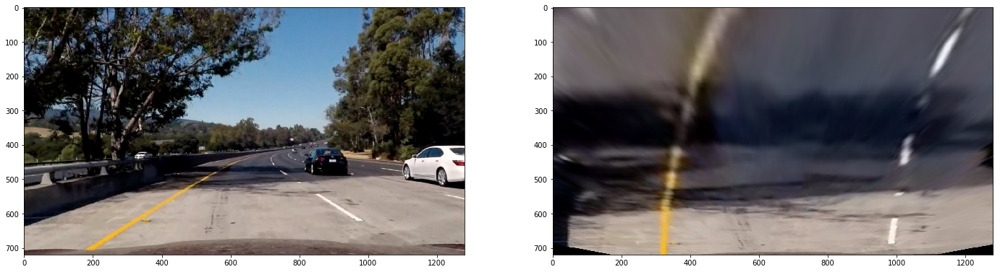

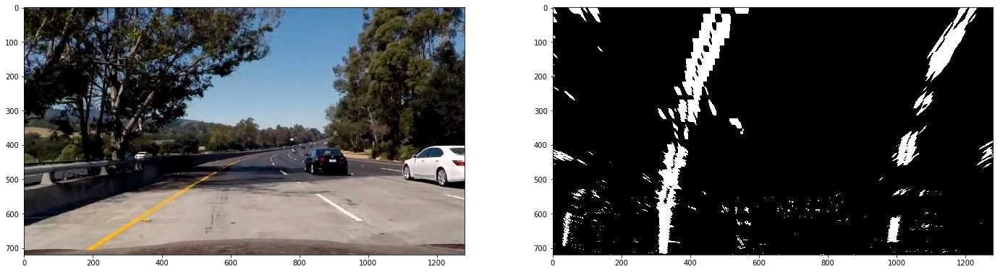

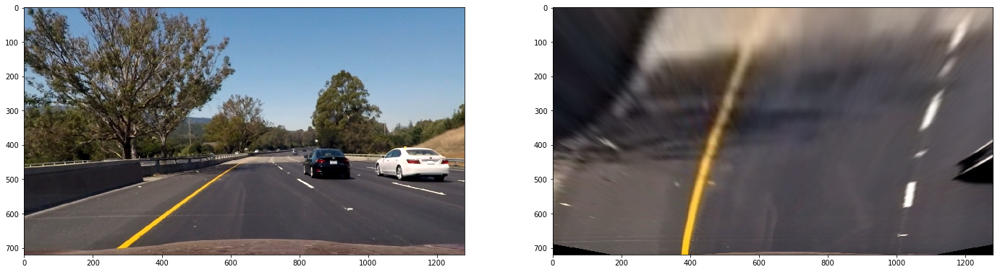

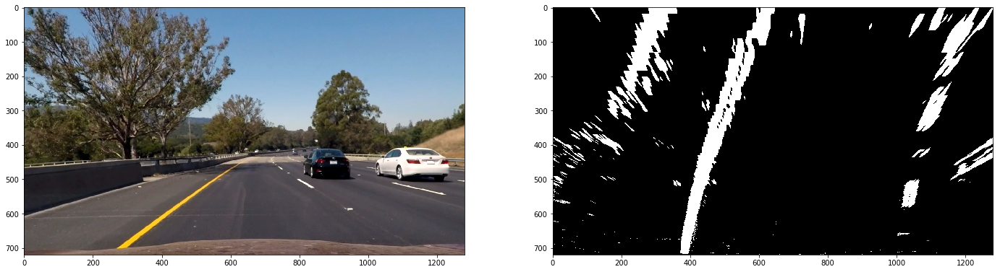

In [7]:
### Apply a perspective transform to rectify binary 
### image ("birds-eye view") for all test images.

warpeds = []
warped_color_binaries = []
warped_binaries = []
for idx in range(len(undists)):
    
    img = undists[idx]
    img_size = (img.shape[1], img.shape[0])
    
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    warpeds.append(warped)
    
    warped_color_binary = cv2.warpPerspective(color_binaries[idx], M, img_size, flags=cv2.INTER_LINEAR)
    warped_color_binaries.append(warped_color_binary)
    
    warped_binary = cv2.warpPerspective(combined_binaries[idx], M, img_size, flags=cv2.INTER_LINEAR)
    warped_binaries.append(warped_binary)
    
    # Plot the warped images and warped binaries
    plot_images([undists[idx], warpeds[idx]],1,2,figsize=(24,9),
               saveas="output_images/birds_eye_image.jpg")
    plot_images([undists[idx], warped_binaries[idx]],1,2,figsize=(24,9),
                cmap="gray",
               saveas="output_images/birds_eye_binary.jpg")
    

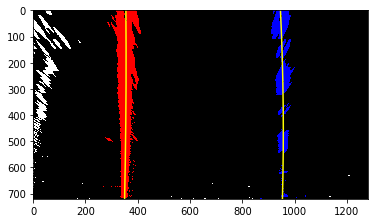

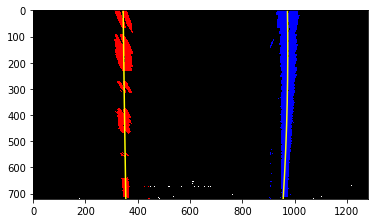

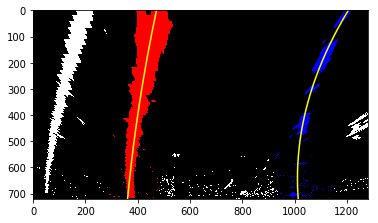

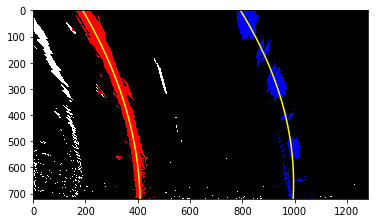

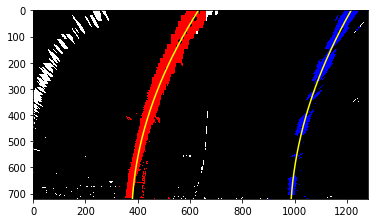

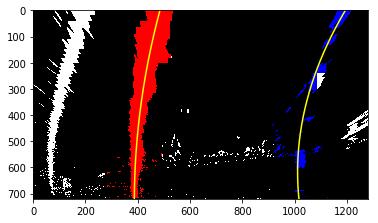

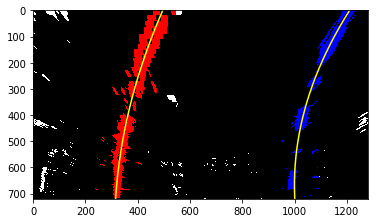

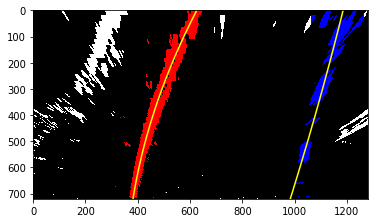

In [18]:
### Find lane lanes for all test images using the histogram method

import importlib
importlib.reload(lanefind)

out_imgs = []
lanes = []
for binary_warped in warped_binaries:
    lane, out_img = lanefind.find_lanes_by_histogram(
        binary_warped,initial_bottom_frac=0.5,nwindows=9)
    out_imgs.append(out_img)
    lanes.append(lane)

    plt.figure()
    plt.imshow(out_img)
    plt.plot(lane.left_fitx, lane.ploty, color='yellow')
    plt.plot(lane.right_fitx, lane.ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.savefig("output_images/lane_fit.jpg",bbox_inches="tight")

#plot_images(out_imgs,4,2,figsize=(20,32))

In [9]:
### Calculate lane features for all of the test images.

img_shape = (1280,720)

for lane in lanes:
    lanefind.calc_lane_features(lane,img_shape)

    print('Offset: ',lane.lane_offset,'m',
          '\nLeft lane pos: ',lane.left_pos_x,'m',
          '\nRight lane pos: ',lane.right_pos_x,'m')
    print('Left curvature: ',lane.left_curverad, 'm', 
          '\nRight curvature: ',lane.right_curverad, 'm\n')


Offset:  -0.0614971883396 m 
Left lane pos:  1.84972801442 m 
Right lane pos:  5.03898064798 m
Left curvature:  7988.12402527 m 
Right curvature:  3209.48213011 m

Offset:  -0.0814625676939 m 
Left lane pos:  1.87385338467 m 
Right lane pos:  5.05478603644 m
Left curvature:  45286.4407072 m 
Right curvature:  3025.1241473 m

Offset:  -0.251107705713 m 
Left lane pos:  1.91049122715 m 
Right lane pos:  5.35743846999 m
Left curvature:  2024.40183657 m 
Right curvature:  348.892009401 m

Offset:  -0.325741496047 m 
Left lane pos:  2.16172536363 m 
Right lane pos:  5.25547191418 m
Left curvature:  417.156454163 m 
Right curvature:  351.897363143 m

Offset:  -0.229308809459 m 
Left lane pos:  2.00783223734 m 
Right lane pos:  5.21649966729 m
Left curvature:  416.976323717 m 
Right curvature:  475.715071084 m

Offset:  -0.325741515418 m 
Left lane pos:  2.04597416022 m 
Right lane pos:  5.37122315633 m
Left curvature:  905.796386146 m 
Right curvature:  343.928292443 m

Offset:  -0.095323148

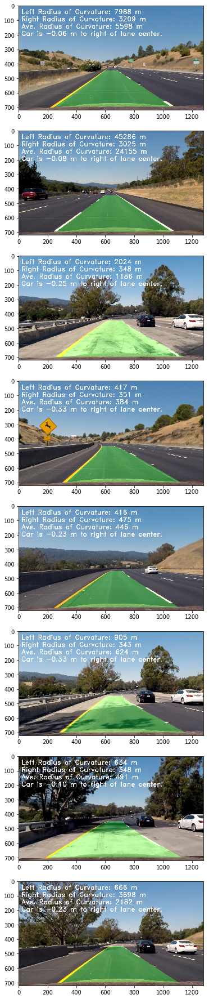

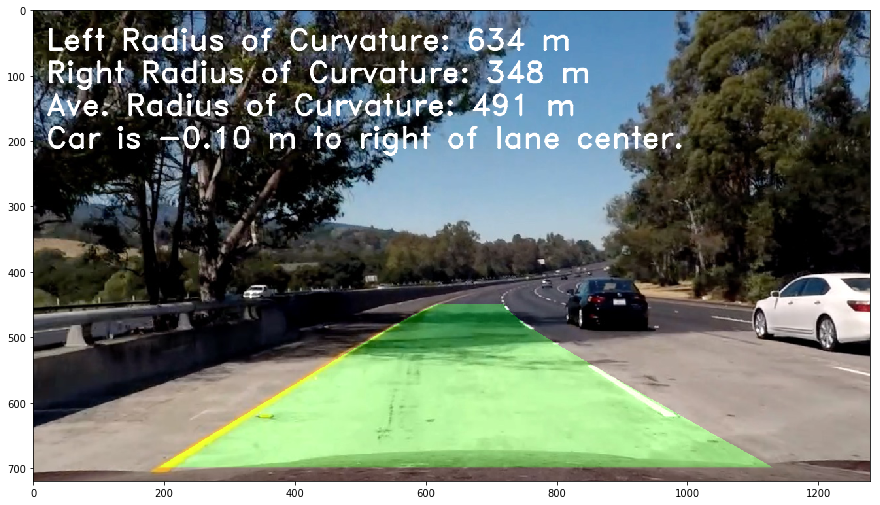

In [10]:
# Warp the detected lane boundaries back onto the original image.
# Output visual display of the lanes.

import importlib
importlib.reload(lanefind)

results = []
for idx in range(len(lanes)):

    lane = lanes[idx]
    undist = undists[idx]

    result = lanefind.draw_lane_lines(undist,Minv,lane,
                                     averaged_lanes=False,
                                     feature_fontsize=1.5)
    results.append(result)

plot_images(results,len(lanes),1,figsize=(8,32),titles=[])

# Save one of the plots for the write-up
idx = 6
result = results[idx]
lane = lanes[idx]
plt.figure(figsize=(15,9))
plt.imshow(result)
plt.savefig("output_images/lane_area.jpg",bbox_inches="tight")


In [11]:
### Import everything needed to edit/save/watch video clips

from moviepy.editor import VideoFileClip 
from IPython.display import HTML

In [15]:
### Define the function process_image, which basically
### does all of the above steps (except camera calibration)

import importlib
importlib.reload(lanefind)

def process_image(image):
    
    # Global variable contains previous lane information
    global recent_lanes
    # Global variable the defines how many previous lanes
    # to be kept in recent_lanes.
    global n_history
    
    # Undist the input image
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    
    # Find lane lane pixels using grayscale gradient and color channel thresholds
    # The commented out method doesn't work as well as the "improved" method
    
    #color_binary, combined_binary = threshold_image(undist, s_thresh=(100, 255), sx_thresh=(20, 100), r_thresh=(220,255))
    color_binary, combined_binary = lanefind.threshold_image_improved(undist, 
                                                             sx_thresh=(12,255), 
                                                             sy_thresh=(5,255), 
                                                             s_thresh=(100,255), 
                                                             v_thresh=(50,255))

    # Warp the binary image to birds-eye-view
    warped_binary = cv2.warpPerspective(combined_binary, M, img_size, flags=cv2.INTER_LINEAR)

    # Check whether previous lane lines have been detected
    if (len(recent_lanes)==0):
        no_prev_lane = True
        prev_lane = None
    else:
        no_prev_lane = False
        prev_lane = recent_lanes[0]

    if ( not no_prev_lane 
        and prev_lane.left_detected 
        and prev_lane.right_detected ):
        
        # If previous lane lines were valid, find new lanes based on previous
        lane, out_img = lanefind.find_lane_lanes_given_previous(warped_binary,prev_lane)
        
    else:
        # Otherwise, use the historgram method to detect lane lines from scratch
        print("No previous lane detected.")
        lane, out_img = lanefind.find_lanes_by_histogram(
            warped_binary,initial_bottom_frac=0.5,nwindows=9)
    
    # Calculate lane features 
    img_shape = warped_binary.shape[::-1]
    lane = lanefind.calc_lane_features(lane,img_shape)
    
    # Check whether the lane features are valid (on there own and
    # in comparison with previous lane values)
    lanefind.check_lane_validity(lane,prev_lane,
                        left_curverad_range=[100,1000000000],right_curverad_range=[100,1000000000],
                        left_pos_x_range=[1.5,2.5],right_pos_x_range=[4.8,5.8],
                        lane_width_range=[2.8,3.8],
                        left_curverad_max_ratio=10.,right_curverad_max_ratio=10.,
                        left_pos_x_max_diff=0.5,right_pos_x_max_diff=0.5,
                        lane_width_max_diff=0.5)

    # If lane history gets too large, remove the oldest element
    recent_lanes.insert(0,lane)
    if (len(recent_lanes) > n_history):
        recent_lanes.pop()
    
    # Average lane parameters over the history
    lanefind.calc_best_lane(recent_lanes)
        
    # Draw averaged lane on the undistorted original image
    lane = recent_lanes[0]
    result = lanefind.draw_lane_lines(undist,Minv,lane,
                                      averaged_lanes=True,
                                      feature_fontsize=1.5)
    
    # Uncomment the following lines to plot both averaged 
    # and raw lane lines. It's much slower to plot for
    # every frame in the video, but very useful for debugging.
    
    #result_no_ave = lanefind.draw_lane_lines(undist,Minv,lane,
    #                                         averaged_lanes=False)
    #plot_images([result,result_no_ave],1,2,figsize=(20,6),titles=["ave","raw"])
    
    
    return result


No previous lane detected.
Curve:  15162.0175501 m, 3086.65270322 m
Pos:  1.85278356585 m, 5.02530754747 m
Width:  3.17252398162 m
Offset:  -0.056188413807 m
Current lanes are valid.


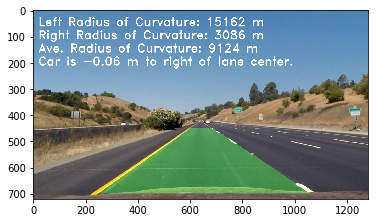

No previous lane detected.
Curve:  73035.2754124 m, 2318.09396827 m
Pos:  1.8762948945 m, 5.03953858243 m
Width:  3.16324368793 m
Offset:  -0.0750595956044 m
Current lanes are valid.


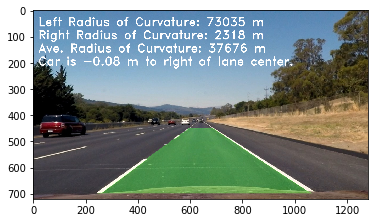

No previous lane detected.
Curve:  2404.37767554 m, 374.577754046 m
Pos:  1.90984913964 m, 5.30940759485 m
Width:  3.39955845522 m
Offset:  -0.226771224388 m
Current lanes are valid.


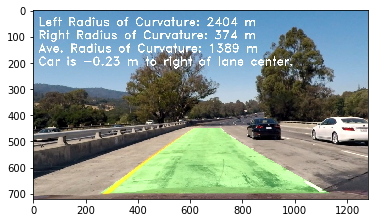

No previous lane detected.
Curve:  435.021520597 m, 363.201616803 m
Pos:  2.16807097825 m, 5.2454062628 m
Width:  3.07733528455 m
Offset:  -0.323881477671 m
Current lanes are valid.


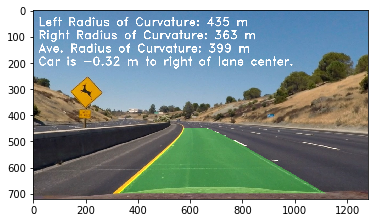

No previous lane detected.
Curve:  420.787489998 m, 495.365783843 m
Pos:  2.01366378032 m, 5.19652553945 m
Width:  3.18286175913 m
Offset:  -0.22223751703 m
Current lanes are valid.


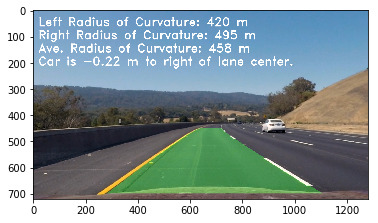

No previous lane detected.
Curve:  880.6588904 m, 345.805619373 m
Pos:  2.05434071047 m, 5.34992271297 m
Width:  3.2955820025 m
Offset:  -0.319274568863 m
Current lanes are valid.


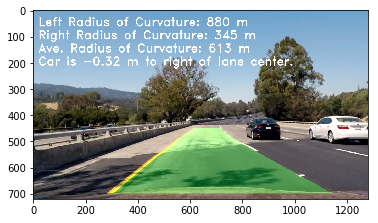

No previous lane detected.
Curve:  633.24815329 m, 352.248681079 m
Pos:  1.67676798885 m, 5.27435643282 m
Width:  3.59758844397 m
Offset:  -0.0927050679811 m
Current lanes are valid.


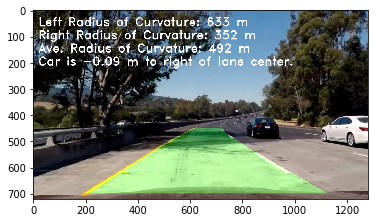

No previous lane detected.
Curve:  687.373958255 m, 4117.21547449 m
Pos:  2.0240692218 m, 5.18974471426 m
Width:  3.16567549246 m
Offset:  -0.224049825169 m
Current lanes are valid.


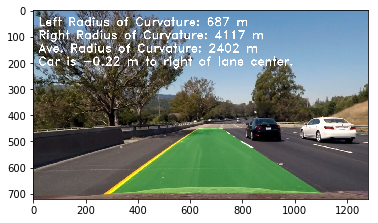

In [16]:
### Test the pipeline on the test images

fnames = 'test_images/*.jpg'
image_fnames = glob.glob(fnames)

for fname in image_fnames:

    img = mpimg.imread(fname)
    
    recent_lanes = []
    n_history = 5
    
    img = process_image(img)
    fig = plt.figure()
    plt.imshow(img)
    display(fig)
    plt.close()
    

In [17]:
video_name = 'project_video.mp4'
video_output_name = 'lane_lines.mp4'
recent_lanes = []
n_history = 3
# Define clip1 once by uncommenting one the following lines for 
# various subclips of interst.
#clip1 = VideoFileClip(video_name).subclip(40,42) #Shady area
#clip1 = VideoFileClip(video_name).subclip(9,13) # switch from curve to straight
clip1 = VideoFileClip(video_name) # The full video
clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time clip.write_videofile(video_output_name, audio=False)

No previous lane detected.
Curve:  387.287691413 m, 716.534570691 m
Pos:  2.10149000779 m, 5.44292410022 m
Width:  3.34143409244 m
Offset:  -0.389349911147 m
Current lanes are valid.
[MoviePy] >>>> Building video lane_lines.mp4
[MoviePy] Writing video lane_lines.mp4


  0%|          | 1/1261 [00:00<05:53,  3.56it/s]

Curve:  388.351935315 m, 720.826263618 m
Pos:  2.10399618903 m, 5.44425535119 m
Width:  3.34025916216 m
Offset:  -0.391268627254 m
Current lanes are valid.


  0%|          | 2/1261 [00:00<06:29,  3.23it/s]

Curve:  404.379384595 m, 639.11673232 m
Pos:  2.1242903796 m, 5.42202230587 m
Width:  3.29773192627 m
Offset:  -0.390299199879 m
Current lanes are valid.


  0%|          | 3/1261 [00:01<06:53,  3.04it/s]

Curve:  420.314693987 m, 502.815366295 m
Pos:  2.13425413609 m, 5.39212230145 m
Width:  3.25786816536 m
Offset:  -0.380331075911 m
Current lanes are valid.


  0%|          | 4/1261 [00:01<07:07,  2.94it/s]

Curve:  396.955500933 m, 447.842630661 m
Pos:  2.1352611973 m, 5.38570464088 m
Width:  3.25044344358 m
Offset:  -0.377625776234 m
Current lanes are valid.


  0%|          | 5/1261 [00:01<07:47,  2.69it/s]

Curve:  484.367976724 m, 435.37475213 m
Pos:  2.16913768224 m, 5.38031310843 m
Width:  3.21117542618 m
Offset:  -0.391868252479 m
Current lanes are valid.


  0%|          | 6/1261 [00:02<07:47,  2.69it/s]

Curve:  520.754170301 m, 465.325339267 m
Pos:  2.18414065536 m, 5.39727145557 m
Width:  3.21313080021 m
Offset:  -0.40784891261 m
Current lanes are valid.


  1%|          | 7/1261 [00:02<07:17,  2.86it/s]

Curve:  523.810438958 m, 491.35516991 m
Pos:  2.18568230279 m, 5.39642778893 m
Width:  3.21074548614 m
Offset:  -0.408197903001 m
Current lanes are valid.


  1%|          | 8/1261 [00:02<08:01,  2.60it/s]

Curve:  476.704380964 m, 682.709913669 m
Pos:  2.18283636556 m, 5.45605059865 m
Width:  3.2732142331 m
Offset:  -0.436586339248 m
Current lanes are valid.


  1%|          | 9/1261 [00:03<08:22,  2.49it/s]

Curve:  503.109244947 m, 644.899544897 m
Pos:  2.18379768635 m, 5.4357438591 m
Width:  3.25194617275 m
Offset:  -0.426913629869 m
Current lanes are valid.


  1%|          | 10/1261 [00:03<08:00,  2.61it/s]

Curve:  542.864505283 m, 749.6126662 m
Pos:  2.18592060089 m, 5.44936231967 m
Width:  3.26344171878 m
Offset:  -0.434784317423 m
Current lanes are valid.


  1%|          | 11/1261 [00:04<07:34,  2.75it/s]

Curve:  540.996919443 m, 696.402798182 m
Pos:  2.18275361372 m, 5.43402294508 m
Width:  3.25126933136 m
Offset:  -0.425531136541 m
Current lanes are valid.


  1%|          | 12/1261 [00:04<06:52,  3.03it/s]

Curve:  678.840336174 m, 934.419092835 m
Pos:  2.18552806645 m, 5.45816711221 m
Width:  3.27263904577 m
Offset:  -0.438990446471 m
Current lanes are valid.


  1%|          | 13/1261 [00:04<06:21,  3.27it/s]

Curve:  578.18024813 m, 564.89961529 m
Pos:  2.17059543325 m, 5.40294711551 m
Width:  3.23235168226 m
Offset:  -0.403914131522 m
Current lanes are valid.


  1%|          | 14/1261 [00:04<06:05,  3.41it/s]

Curve:  504.317384202 m, 500.952486521 m
Pos:  2.15302899527 m, 5.38524914769 m
Width:  3.23222015242 m
Offset:  -0.386281928624 m
Current lanes are valid.


  1%|          | 15/1261 [00:05<06:02,  3.44it/s]

Curve:  466.360635759 m, 408.099289428 m
Pos:  2.14771647112 m, 5.35452768208 m
Width:  3.20681121097 m
Offset:  -0.368264933744 m
Current lanes are valid.


  1%|▏         | 16/1261 [00:05<05:51,  3.54it/s]

Curve:  436.142611681 m, 363.178716002 m
Pos:  2.14271753073 m, 5.3249226284 m
Width:  3.18220509767 m
Offset:  -0.350962936707 m
Current lanes are valid.


  1%|▏         | 17/1261 [00:05<05:42,  3.64it/s]

Curve:  432.342650474 m, 394.9952915 m
Pos:  2.14338581982 m, 5.3412153874 m
Width:  3.19782956758 m
Offset:  -0.359443460751 m
Current lanes are valid.


  1%|▏         | 18/1261 [00:05<05:33,  3.73it/s]

Curve:  449.448954802 m, 420.418330341 m
Pos:  2.14421968362 m, 5.33387631835 m
Width:  3.18965663473 m
Offset:  -0.356190858129 m
Current lanes are valid.


  2%|▏         | 19/1261 [00:06<05:25,  3.82it/s]

Curve:  481.354165933 m, 415.557128438 m
Pos:  2.14213867768 m, 5.32930984333 m
Width:  3.18717116564 m
Offset:  -0.352867117648 m
Current lanes are valid.


  2%|▏         | 20/1261 [00:06<05:22,  3.84it/s]

Curve:  488.261478541 m, 460.995994102 m
Pos:  2.13423616504 m, 5.32854716246 m
Width:  3.19431099742 m
Offset:  -0.348534520892 m
Current lanes are valid.


  2%|▏         | 21/1261 [00:06<05:25,  3.81it/s]

Curve:  524.42213563 m, 436.912498005 m
Pos:  2.12497722595 m, 5.31890126252 m
Width:  3.19392403657 m
Offset:  -0.33908210138 m
Current lanes are valid.


  2%|▏         | 22/1261 [00:06<05:38,  3.66it/s]

Curve:  508.704492842 m, 466.919284281 m
Pos:  2.10922771222 m, 5.34410774644 m
Width:  3.23488003422 m
Offset:  -0.34381058647 m
Current lanes are valid.


  2%|▏         | 23/1261 [00:07<05:24,  3.81it/s]

Curve:  550.376142183 m, 490.197207031 m
Pos:  2.09933667802 m, 5.35004424087 m
Width:  3.25070756285 m
Offset:  -0.341833316584 m
Current lanes are valid.


  2%|▏         | 24/1261 [00:07<05:16,  3.91it/s]

Curve:  484.816754615 m, 640.51919296 m
Pos:  2.07921865729 m, 5.39021470487 m
Width:  3.31099604758 m
Offset:  -0.351859538224 m
Current lanes are valid.


  2%|▏         | 25/1261 [00:07<05:31,  3.73it/s]

Curve:  442.782061421 m, 462.622530796 m
Pos:  2.07245635799 m, 5.34157038636 m
Width:  3.26911402836 m
Offset:  -0.324156229316 m
Current lanes are valid.


  2%|▏         | 26/1261 [00:08<05:26,  3.78it/s]

Curve:  477.918771183 m, 537.138291242 m
Pos:  2.06517465913 m, 5.36476921424 m
Width:  3.29959455511 m
Offset:  -0.332114793828 m
Current lanes are valid.


  2%|▏         | 27/1261 [00:08<05:19,  3.87it/s]

Curve:  414.865922709 m, 515.461445852 m
Pos:  2.042149584 m, 5.35796704583 m
Width:  3.31581746183 m
Offset:  -0.317201172061 m
Current lanes are valid.


  2%|▏         | 28/1261 [00:08<05:14,  3.92it/s]

Curve:  454.371191789 m, 517.65777517 m
Pos:  2.04185909979 m, 5.36814509217 m
Width:  3.32628599238 m
Offset:  -0.322144953123 m
Current lanes are valid.


  2%|▏         | 29/1261 [00:08<05:15,  3.90it/s]

Curve:  388.563116557 m, 514.191011398 m
Pos:  2.03079503981 m, 5.3733059016 m
Width:  3.34251086179 m
Offset:  -0.319193327848 m
Current lanes are valid.


  2%|▏         | 30/1261 [00:09<05:30,  3.73it/s]

Curve:  370.211004567 m, 409.506839866 m
Pos:  2.03540393269 m, 5.33691210809 m
Width:  3.3015081754 m
Offset:  -0.303300877534 m
Current lanes are valid.


  2%|▏         | 31/1261 [00:09<05:40,  3.61it/s]

Curve:  368.266245192 m, 331.787921209 m
Pos:  2.04330161777 m, 5.31946908819 m
Width:  3.27616747043 m
Offset:  -0.298528210121 m
Current lanes are valid.


  3%|▎         | 32/1261 [00:09<05:45,  3.56it/s]

Curve:  326.425800941 m, 356.466083554 m
Pos:  2.03849459029 m, 5.32486669302 m
Width:  3.28637210274 m
Offset:  -0.298823498799 m
Current lanes are valid.


  3%|▎         | 33/1261 [00:09<05:38,  3.62it/s]

Curve:  340.380996469 m, 351.714723469 m
Pos:  2.04068322297 m, 5.32399656422 m
Width:  3.28331334125 m
Offset:  -0.29948275074 m
Current lanes are valid.


  3%|▎         | 34/1261 [00:10<05:30,  3.71it/s]

Curve:  315.147295012 m, 442.466368096 m
Pos:  2.04157815989 m, 5.37810053217 m
Width:  3.33652237229 m
Offset:  -0.326982203173 m
Current lanes are valid.


  3%|▎         | 35/1261 [00:10<05:24,  3.78it/s]

Curve:  298.601621032 m, 409.472880909 m
Pos:  2.04609656275 m, 5.36868330899 m
Width:  3.32258674624 m
Offset:  -0.324532793012 m
Current lanes are valid.


  3%|▎         | 36/1261 [00:10<05:18,  3.85it/s]

Curve:  289.741199642 m, 360.743489298 m
Pos:  2.05065932879 m, 5.33205628518 m
Width:  3.28139695639 m
Offset:  -0.30850066413 m
Current lanes are valid.


  3%|▎         | 37/1261 [00:10<05:14,  3.89it/s]

Curve:  286.606898305 m, 324.821877786 m
Pos:  2.05622593367 m, 5.31096974324 m
Width:  3.25474380957 m
Offset:  -0.300740695597 m
Current lanes are valid.


  3%|▎         | 38/1261 [00:11<05:12,  3.92it/s]

Curve:  282.931803574 m, 299.144448691 m
Pos:  2.06845145982 m, 5.29943515056 m
Width:  3.23098369074 m
Offset:  -0.301086162335 m
Current lanes are valid.


  3%|▎         | 39/1261 [00:11<05:10,  3.94it/s]

Curve:  290.814588063 m, 282.187661558 m
Pos:  2.08150817064 m, 5.28713938941 m
Width:  3.20563121876 m
Offset:  -0.301466637167 m
Current lanes are valid.


  3%|▎         | 40/1261 [00:11<05:08,  3.95it/s]

Curve:  302.881370021 m, 294.664459351 m
Pos:  2.08969029873 m, 5.29755416739 m
Width:  3.20786386867 m
Offset:  -0.310765090203 m
Current lanes are valid.


  3%|▎         | 41/1261 [00:11<05:07,  3.97it/s]

Curve:  317.038716218 m, 308.1973555 m
Pos:  2.10132958667 m, 5.31722286364 m
Width:  3.21589327697 m
Offset:  -0.326419082296 m
Current lanes are valid.


  3%|▎         | 42/1261 [00:12<05:39,  3.59it/s]

Curve:  325.813761909 m, 321.338614463 m
Pos:  2.11276393186 m, 5.33222114537 m
Width:  3.21945721351 m
Offset:  -0.339635395761 m
Current lanes are valid.


  3%|▎         | 43/1261 [00:12<06:54,  2.94it/s]

Curve:  337.738162677 m, 335.969595696 m
Pos:  2.12009292369 m, 5.33924499938 m
Width:  3.21915207569 m
Offset:  -0.346811818675 m
Current lanes are valid.


  3%|▎         | 44/1261 [00:13<06:37,  3.06it/s]

Curve:  348.371397264 m, 351.105694738 m
Pos:  2.1180225023 m, 5.34282202721 m
Width:  3.2247995249 m
Offset:  -0.347565121898 m
Current lanes are valid.


  4%|▎         | 45/1261 [00:13<06:26,  3.14it/s]

Curve:  363.340746463 m, 364.415869087 m
Pos:  2.12194384873 m, 5.34955198029 m
Width:  3.22760813156 m
Offset:  -0.352890771655 m
Current lanes are valid.


  4%|▎         | 46/1261 [00:13<06:16,  3.22it/s]

Curve:  389.252175702 m, 438.402412255 m
Pos:  2.12411856305 m, 5.38720348573 m
Width:  3.26308492268 m
Offset:  -0.372803881531 m
Current lanes are valid.


  4%|▎         | 47/1261 [00:13<05:59,  3.38it/s]

Curve:  377.400651991 m, 416.425772002 m
Pos:  2.1172041159 m, 5.36463335665 m
Width:  3.24742924075 m
Offset:  -0.358061593418 m
Current lanes are valid.


  4%|▍         | 48/1261 [00:14<05:49,  3.47it/s]

Curve:  393.305011607 m, 402.871928869 m
Pos:  2.11888755207 m, 5.36567563178 m
Width:  3.2467880797 m
Offset:  -0.359424449068 m
Current lanes are valid.


  4%|▍         | 49/1261 [00:14<06:34,  3.07it/s]

Curve:  423.593528034 m, 416.694088137 m
Pos:  2.11857735658 m, 5.36868375649 m
Width:  3.25010639991 m
Offset:  -0.360773413681 m
Current lanes are valid.


  4%|▍         | 50/1261 [00:14<06:34,  3.07it/s]

Curve:  417.485658476 m, 392.493064545 m
Pos:  2.11598346595 m, 5.36454310928 m
Width:  3.24855964333 m
Offset:  -0.357406144758 m
Current lanes are valid.


  4%|▍         | 51/1261 [00:15<06:50,  2.95it/s]

Curve:  434.18232083 m, 470.994230782 m
Pos:  2.11621855278 m, 5.38526261068 m
Width:  3.2690440579 m
Offset:  -0.367883438871 m
Current lanes are valid.


  4%|▍         | 52/1261 [00:15<07:13,  2.79it/s]

Curve:  418.788664549 m, 399.59296606 m
Pos:  2.11229817885 m, 5.35290058264 m
Width:  3.24060240379 m
Offset:  -0.349742237889 m
Current lanes are valid.


  4%|▍         | 53/1261 [00:15<07:01,  2.86it/s]

Curve:  422.810832378 m, 363.068692989 m
Pos:  2.11166434863 m, 5.3340548642 m
Width:  3.22239051558 m
Offset:  -0.340002463559 m
Current lanes are valid.


  4%|▍         | 54/1261 [00:16<06:48,  2.95it/s]

Curve:  420.358124927 m, 355.799805235 m
Pos:  2.10819508176 m, 5.32714600437 m
Width:  3.21895092261 m
Offset:  -0.334813400206 m
Current lanes are valid.


  4%|▍         | 55/1261 [00:16<06:34,  3.06it/s]

Curve:  443.314288301 m, 377.696933272 m
Pos:  2.10994438893 m, 5.32763206406 m
Width:  3.21768767513 m
Offset:  -0.335931083634 m
Current lanes are valid.


  4%|▍         | 56/1261 [00:16<06:21,  3.16it/s]

Curve:  452.015822209 m, 420.843207941 m
Pos:  2.10234296473 m, 5.3429896262 m
Width:  3.24064666147 m
Offset:  -0.339809152607 m
Current lanes are valid.


  5%|▍         | 57/1261 [00:17<06:05,  3.30it/s]

Curve:  493.349222282 m, 440.240930332 m
Pos:  2.10839081346 m, 5.35008237187 m
Width:  3.24169155841 m
Offset:  -0.346379449807 m
Current lanes are valid.


  5%|▍         | 58/1261 [00:17<05:56,  3.37it/s]

Curve:  514.616009812 m, 489.653724685 m
Pos:  2.10489130386 m, 5.35806956394 m
Width:  3.25317826008 m
Offset:  -0.348623291043 m
Current lanes are valid.


  5%|▍         | 59/1261 [00:17<05:50,  3.43it/s]

Curve:  436.568274472 m, 458.136906492 m
Pos:  2.09190135882 m, 5.3443178113 m
Width:  3.25241645249 m
Offset:  -0.335252442204 m
Current lanes are valid.


  5%|▍         | 60/1261 [00:18<05:44,  3.49it/s]

Curve:  450.894742584 m, 355.053479923 m
Pos:  2.09294281796 m, 5.28117820251 m
Width:  3.18823538455 m
Offset:  -0.304203367378 m
Current lanes are valid.


  5%|▍         | 61/1261 [00:18<05:31,  3.62it/s]

Curve:  467.546593881 m, 314.908826823 m
Pos:  2.09355151452 m, 5.24821654561 m
Width:  3.15466503109 m
Offset:  -0.28802688721 m
Current lanes are valid.


  5%|▍         | 62/1261 [00:18<05:25,  3.68it/s]

Curve:  419.291524198 m, 316.028541306 m
Pos:  2.08244230139 m, 5.25536672293 m
Width:  3.17292442154 m
Offset:  -0.286047369302 m
Current lanes are valid.


  5%|▍         | 63/1261 [00:18<05:33,  3.59it/s]

Curve:  434.033080928 m, 327.425817142 m
Pos:  2.07528550041 m, 5.24836534265 m
Width:  3.17307984224 m
Offset:  -0.278968278672 m
Current lanes are valid.


  5%|▌         | 64/1261 [00:19<05:50,  3.42it/s]

Curve:  416.723397665 m, 338.322985179 m
Pos:  2.0691362221 m, 5.25989945018 m
Width:  3.19076322808 m
Offset:  -0.281660693283 m
Current lanes are valid.


  5%|▌         | 65/1261 [00:19<05:40,  3.51it/s]

Curve:  524.889400948 m, 363.912667047 m
Pos:  2.0786254146 m, 5.26623088131 m
Width:  3.18760546671 m
Offset:  -0.2895710051 m
Current lanes are valid.


  5%|▌         | 66/1261 [00:19<06:27,  3.08it/s]

Curve:  452.504689754 m, 389.97840722 m
Pos:  2.06130811187 m, 5.27317221442 m
Width:  3.21186410254 m
Offset:  -0.284383020287 m
Current lanes are valid.


  5%|▌         | 67/1261 [00:20<06:24,  3.11it/s]

Curve:  455.345921036 m, 385.457363812 m
Pos:  2.05320800959 m, 5.26194958628 m
Width:  3.20874157668 m
Offset:  -0.274721655078 m
Current lanes are valid.


  5%|▌         | 68/1261 [00:20<06:26,  3.09it/s]

Curve:  449.357046363 m, 380.61476969 m
Pos:  2.04264173375 m, 5.25597839769 m
Width:  3.21333666394 m
Offset:  -0.266452922867 m
Current lanes are valid.


  5%|▌         | 69/1261 [00:20<07:17,  2.73it/s]

Curve:  423.074519888 m, 357.914899897 m
Pos:  2.03812892801 m, 5.23770010549 m
Width:  3.19957117748 m
Offset:  -0.255057373893 m
Current lanes are valid.


  6%|▌         | 70/1261 [00:21<08:36,  2.31it/s]

Curve:  457.502315921 m, 380.907663873 m
Pos:  2.03531617375 m, 5.2254632197 m
Width:  3.19014704596 m
Offset:  -0.247532553866 m
Current lanes are valid.


  6%|▌         | 71/1261 [00:22<09:22,  2.12it/s]

Curve:  441.50464991 m, 314.304006357 m
Pos:  2.03033472971 m, 5.16411180076 m
Width:  3.13377707105 m
Offset:  -0.214366122378 m
Current lanes are valid.


  6%|▌         | 72/1261 [00:22<08:45,  2.26it/s]

Curve:  434.461506603 m, 333.515320248 m
Pos:  2.01679502611 m, 5.17948508332 m
Width:  3.16269005721 m
Offset:  -0.215282911856 m
Current lanes are valid.


  6%|▌         | 73/1261 [00:22<08:39,  2.29it/s]

Curve:  458.135514339 m, 327.880212962 m
Pos:  2.01507401534 m, 5.17125830313 m
Width:  3.1561842878 m
Offset:  -0.210309016377 m
Current lanes are valid.


  6%|▌         | 74/1261 [00:23<08:35,  2.30it/s]

Curve:  463.553560228 m, 332.282062195 m
Pos:  2.01430116195 m, 5.17799482935 m
Width:  3.1636936674 m
Offset:  -0.21329085279 m
Current lanes are valid.


  6%|▌         | 75/1261 [00:23<08:27,  2.34it/s]

Curve:  494.83463088 m, 340.541797624 m
Pos:  2.00523344435 m, 5.18425902515 m
Width:  3.1790255808 m
Offset:  -0.211889091897 m
Current lanes are valid.


  6%|▌         | 76/1261 [00:24<08:26,  2.34it/s]

Curve:  477.019024161 m, 312.210359656 m
Pos:  2.00286624002 m, 5.16991818081 m
Width:  3.16705194079 m
Offset:  -0.203535067559 m
Current lanes are valid.


  6%|▌         | 77/1261 [00:24<08:38,  2.28it/s]

Curve:  487.068979782 m, 359.590303227 m
Pos:  1.98815788469 m, 5.20090043104 m
Width:  3.21274254635 m
Offset:  -0.211672015009 m
Current lanes are valid.


  6%|▌         | 78/1261 [00:25<08:36,  2.29it/s]

Curve:  545.069907383 m, 360.807762475 m
Pos:  1.98879236084 m, 5.20264785067 m
Width:  3.21385548983 m
Offset:  -0.212862962893 m
Current lanes are valid.


  6%|▋         | 79/1261 [00:25<08:48,  2.23it/s]

Curve:  560.037904077 m, 344.947240159 m
Pos:  1.97551686295 m, 5.20700696258 m
Width:  3.23149009963 m
Offset:  -0.20840476991 m
Current lanes are valid.


  6%|▋         | 80/1261 [00:25<08:14,  2.39it/s]

Curve:  535.797421253 m, 347.706887647 m
Pos:  1.96380300652 m, 5.19735303284 m
Width:  3.23355002632 m
Offset:  -0.197720876823 m
Current lanes are valid.


  6%|▋         | 81/1261 [00:26<07:23,  2.66it/s]

Curve:  504.663724426 m, 391.630304845 m
Pos:  1.95628188878 m, 5.21631837733 m
Width:  3.26003648856 m
Offset:  -0.203442990197 m
Current lanes are valid.


  7%|▋         | 82/1261 [00:26<07:05,  2.77it/s]

Curve:  486.162792185 m, 410.00343529 m
Pos:  1.94224774223 m, 5.21942968115 m
Width:  3.27718193892 m
Offset:  -0.197981568831 m
Current lanes are valid.


  7%|▋         | 83/1261 [00:26<07:03,  2.78it/s]

Curve:  488.24741195 m, 464.694029924 m
Pos:  1.93212793957 m, 5.24622963307 m
Width:  3.3141016935 m
Offset:  -0.206321643464 m
Current lanes are valid.


  7%|▋         | 84/1261 [00:27<07:07,  2.76it/s]

Curve:  497.208757355 m, 447.406858972 m
Pos:  1.9146858868 m, 5.23290187921 m
Width:  3.31821599241 m
Offset:  -0.190936740144 m
Current lanes are valid.


  7%|▋         | 85/1261 [00:27<06:32,  3.00it/s]

Curve:  495.785335143 m, 516.586449951 m
Pos:  1.91048186359 m, 5.26824367974 m
Width:  3.35776181615 m
Offset:  -0.20650562881 m
Current lanes are valid.


  7%|▋         | 86/1261 [00:27<06:16,  3.12it/s]

Curve:  461.834806045 m, 642.691543889 m
Pos:  1.90530398833 m, 5.29759151498 m
Width:  3.39228752665 m
Offset:  -0.218590608798 m
Current lanes are valid.


  7%|▋         | 87/1261 [00:28<05:58,  3.27it/s]

Curve:  424.31590375 m, 477.091322275 m
Pos:  1.91516354369 m, 5.24554040034 m
Width:  3.33037685664 m
Offset:  -0.197494829157 m
Current lanes are valid.


  7%|▋         | 88/1261 [00:28<05:46,  3.39it/s]

Curve:  392.010900007 m, 381.034546466 m
Pos:  1.92037477418 m, 5.20443134535 m
Width:  3.28405657117 m
Offset:  -0.179545916909 m
Current lanes are valid.


  7%|▋         | 89/1261 [00:28<05:34,  3.51it/s]

Curve:  386.858471106 m, 322.419094632 m
Pos:  1.92972608131 m, 5.1750744704 m
Width:  3.24534838909 m
Offset:  -0.169543132996 m
Current lanes are valid.


  7%|▋         | 90/1261 [00:28<05:29,  3.55it/s]

Curve:  349.341967132 m, 345.549631239 m
Pos:  1.93681354628 m, 5.19382489064 m
Width:  3.25701134436 m
Offset:  -0.182462075602 m
Current lanes are valid.


  7%|▋         | 91/1261 [00:29<05:32,  3.52it/s]

Curve:  375.220524502 m, 361.195888967 m
Pos:  1.94248404478 m, 5.20014799941 m
Width:  3.25766395464 m
Offset:  -0.188458879237 m
Current lanes are valid.


  7%|▋         | 92/1261 [00:29<05:27,  3.57it/s]

Curve:  387.276736424 m, 382.002476166 m
Pos:  1.94989500775 m, 5.21108244115 m
Width:  3.2611874334 m
Offset:  -0.197631581597 m
Current lanes are valid.


  7%|▋         | 93/1261 [00:29<05:25,  3.59it/s]

Curve:  361.003895216 m, 389.999726294 m
Pos:  1.95913469622 m, 5.20999190345 m
Width:  3.25085720724 m
Offset:  -0.201706156978 m
Current lanes are valid.


  7%|▋         | 94/1261 [00:29<05:23,  3.61it/s]

Curve:  348.002566227 m, 384.58181356 m
Pos:  1.96174919996 m, 5.20510096403 m
Width:  3.24335176407 m
Offset:  -0.200567939137 m
Current lanes are valid.


  8%|▊         | 95/1261 [00:30<05:21,  3.62it/s]

Curve:  364.898891969 m, 414.910493139 m
Pos:  1.96990221448 m, 5.20477807724 m
Width:  3.23487586275 m
Offset:  -0.204483003003 m
Current lanes are valid.


  8%|▊         | 96/1261 [00:30<05:09,  3.76it/s]

Curve:  378.74672118 m, 428.859103554 m
Pos:  1.97794392475 m, 5.20592324508 m
Width:  3.22797932033 m
Offset:  -0.209076442058 m
Current lanes are valid.


  8%|▊         | 97/1261 [00:30<04:58,  3.91it/s]

Curve:  366.928719144 m, 368.206551562 m
Pos:  1.97744718573 m, 5.16747109387 m
Width:  3.19002390814 m
Offset:  -0.189601996945 m
Current lanes are valid.


  8%|▊         | 98/1261 [00:30<04:43,  4.10it/s]

Curve:  377.113608901 m, 388.750316146 m
Pos:  1.97323086001 m, 5.1847623446 m
Width:  3.2115314846 m
Offset:  -0.19613945945 m
Current lanes are valid.


  8%|▊         | 99/1261 [00:31<04:36,  4.20it/s]

Curve:  357.004694063 m, 319.232556318 m
Pos:  1.9736680757 m, 5.1387210635 m
Width:  3.1650529878 m
Offset:  -0.173337426741 m
Current lanes are valid.


  8%|▊         | 100/1261 [00:31<04:30,  4.29it/s]

Curve:  368.896613564 m, 337.273360587 m
Pos:  1.97535648485 m, 5.15387167199 m
Width:  3.17851518714 m
Offset:  -0.181756935563 m
Current lanes are valid.


  8%|▊         | 101/1261 [00:31<05:05,  3.80it/s]

Curve:  365.142353723 m, 281.441836536 m
Pos:  1.98181026345 m, 5.12084139905 m
Width:  3.1390311356 m
Offset:  -0.168468688396 m
Current lanes are valid.


  8%|▊         | 102/1261 [00:31<05:05,  3.79it/s]

Curve:  341.021522125 m, 271.837534102 m
Pos:  1.97544687761 m, 5.12497376404 m
Width:  3.14952688644 m
Offset:  -0.167353177968 m
Current lanes are valid.


  8%|▊         | 103/1261 [00:32<05:26,  3.55it/s]

Curve:  352.981207922 m, 280.470647699 m
Pos:  1.98186122955 m, 5.14611690853 m
Width:  3.16425567899 m
Offset:  -0.181131926183 m
Current lanes are valid.


  8%|▊         | 104/1261 [00:32<05:46,  3.34it/s]

Curve:  351.675905419 m, 299.113458596 m
Pos:  1.98697194375 m, 5.16751670506 m
Width:  3.18054476132 m
Offset:  -0.19438718155 m
Current lanes are valid.


  8%|▊         | 105/1261 [00:32<06:02,  3.19it/s]

Curve:  371.364598933 m, 303.413476161 m
Pos:  1.99091582604 m, 5.179300332 m
Width:  3.18838450596 m
Offset:  -0.20225093616 m
Current lanes are valid.


  8%|▊         | 106/1261 [00:33<05:51,  3.28it/s]

Curve:  398.651294771 m, 310.362535206 m
Pos:  2.00187318037 m, 5.18612896784 m
Width:  3.18425578747 m
Offset:  -0.211143931246 m
Current lanes are valid.


  8%|▊         | 107/1261 [00:33<05:57,  3.22it/s]

Curve:  414.652016938 m, 309.408520696 m
Pos:  2.00456991306 m, 5.19249780629 m
Width:  3.18792789322 m
Offset:  -0.215676716819 m
Current lanes are valid.


  9%|▊         | 108/1261 [00:33<05:49,  3.29it/s]

Curve:  378.261656889 m, 343.553304388 m
Pos:  2.00895889329 m, 5.22386249215 m
Width:  3.21490359886 m
Offset:  -0.233553549859 m
Current lanes are valid.


  9%|▊         | 109/1261 [00:34<06:13,  3.09it/s]

Curve:  381.386840425 m, 407.736246041 m
Pos:  2.01611783103 m, 5.27042884845 m
Width:  3.25431101742 m
Offset:  -0.260416196884 m
Current lanes are valid.


  9%|▊         | 110/1261 [00:34<06:14,  3.07it/s]

Curve:  374.664310841 m, 435.761607379 m
Pos:  2.01430873525 m, 5.28657316291 m
Width:  3.27226442766 m
Offset:  -0.267583806219 m
Current lanes are valid.


  9%|▉         | 111/1261 [00:34<06:52,  2.79it/s]

Curve:  363.972073863 m, 354.057642443 m
Pos:  2.01554720477 m, 5.24181217007 m
Width:  3.2262649653 m
Offset:  -0.245822544563 m
Current lanes are valid.


  9%|▉         | 112/1261 [00:35<06:28,  2.96it/s]

Curve:  389.609059111 m, 375.490502457 m
Pos:  2.01449064378 m, 5.26230243972 m
Width:  3.24781179594 m
Offset:  -0.255539398894 m
Current lanes are valid.


  9%|▉         | 113/1261 [00:35<07:06,  2.69it/s]

Curve:  372.751882639 m, 343.609299633 m
Pos:  2.02177403869 m, 5.25561568824 m
Width:  3.23384164956 m
Offset:  -0.255837720609 m
Current lanes are valid.


  9%|▉         | 114/1261 [00:36<06:30,  2.94it/s]

Curve:  363.69294174 m, 351.234848677 m
Pos:  2.02600854727 m, 5.26516260971 m
Width:  3.23915406244 m
Offset:  -0.26272843563 m
Current lanes are valid.


  9%|▉         | 115/1261 [00:36<06:10,  3.10it/s]

Curve:  344.664242069 m, 281.743113693 m
Pos:  2.03381724868 m, 5.23170480915 m
Width:  3.19788756047 m
Offset:  -0.249903886059 m
Current lanes are valid.


  9%|▉         | 116/1261 [00:36<05:50,  3.26it/s]

Curve:  339.922241015 m, 272.93798004 m
Pos:  2.03383774157 m, 5.23191078017 m
Width:  3.1980730386 m
Offset:  -0.250017118011 m
Current lanes are valid.


  9%|▉         | 117/1261 [00:36<06:35,  2.90it/s]

Curve:  340.601065122 m, 288.675316369 m
Pos:  2.03717268701 m, 5.2481555473 m
Width:  3.21098286029 m
Offset:  -0.259806974299 m
Current lanes are valid.


  9%|▉         | 118/1261 [00:37<06:22,  2.99it/s]

Curve:  337.714640491 m, 323.842839973 m
Pos:  2.04101133247 m, 5.27298038436 m
Width:  3.2319690519 m
Offset:  -0.274138715559 m
Current lanes are valid.


  9%|▉         | 119/1261 [00:37<06:22,  2.99it/s]

Curve:  340.931489641 m, 339.309246372 m
Pos:  2.04615971213 m, 5.28237475 m
Width:  3.23621503786 m
Offset:  -0.281410088208 m
Current lanes are valid.


 10%|▉         | 120/1261 [00:37<06:19,  3.01it/s]

Curve:  308.857476582 m, 351.779653124 m
Pos:  2.05088793281 m, 5.30413621043 m
Width:  3.25324827762 m
Offset:  -0.294654928764 m
Current lanes are valid.


 10%|▉         | 121/1261 [00:38<07:34,  2.51it/s]

Curve:  326.440593703 m, 349.428156645 m
Pos:  2.05596491314 m, 5.30482992435 m
Width:  3.24886501121 m
Offset:  -0.29754027589 m
Current lanes are valid.


 10%|▉         | 122/1261 [00:38<06:58,  2.72it/s]

Curve:  322.632558214 m, 362.782610531 m
Pos:  2.06267746125 m, 5.3285884752 m
Width:  3.26591101395 m
Offset:  -0.312775825371 m
Current lanes are valid.


 10%|▉         | 123/1261 [00:39<06:27,  2.94it/s]

Curve:  313.117117394 m, 298.694957861 m
Pos:  2.0710017598 m, 5.27070023501 m
Width:  3.19969847521 m
Offset:  -0.28799385455 m
Current lanes are valid.


 10%|▉         | 124/1261 [00:39<06:19,  2.99it/s]

Curve:  322.91712848 m, 297.470319884 m
Pos:  2.0802488445 m, 5.26992188061 m
Width:  3.18967303611 m
Offset:  -0.292228219694 m
Current lanes are valid.


 10%|▉         | 125/1261 [00:39<06:15,  3.02it/s]

Curve:  320.974498309 m, 277.340552082 m
Pos:  2.08469369297 m, 5.26559576045 m
Width:  3.18090206748 m
Offset:  -0.292287583854 m
Current lanes are valid.


 10%|▉         | 126/1261 [00:40<05:56,  3.19it/s]

Curve:  341.770741719 m, 283.732940869 m
Pos:  2.08764174186 m, 5.26472122947 m
Width:  3.17707948761 m
Offset:  -0.293324342809 m
Current lanes are valid.


 10%|█         | 127/1261 [00:40<05:43,  3.30it/s]

Curve:  351.512051563 m, 294.226325399 m
Pos:  2.09929445645 m, 5.2846435539 m
Width:  3.18534909745 m
Offset:  -0.309111862318 m
Current lanes are valid.


 10%|█         | 128/1261 [00:40<05:27,  3.46it/s]

Curve:  360.231728889 m, 321.149499385 m
Pos:  2.10205909154 m, 5.30166703836 m
Width:  3.19960794682 m
Offset:  -0.319005922094 m
Current lanes are valid.


 10%|█         | 129/1261 [00:40<05:30,  3.42it/s]

Curve:  351.418739822 m, 348.85383293 m
Pos:  2.11271367223 m, 5.31706429097 m
Width:  3.20435061874 m
Offset:  -0.332031838743 m
Current lanes are valid.


 10%|█         | 130/1261 [00:41<05:23,  3.49it/s]

Curve:  376.166112137 m, 384.482512558 m
Pos:  2.11740802505 m, 5.31486374559 m
Width:  3.19745572054 m
Offset:  -0.333278742462 m
Current lanes are valid.


 10%|█         | 131/1261 [00:41<05:16,  3.57it/s]

Curve:  372.53173491 m, 361.911382606 m
Pos:  2.12330419696 m, 5.30844208932 m
Width:  3.18513789236 m
Offset:  -0.333016000283 m
Current lanes are valid.


 10%|█         | 132/1261 [00:41<05:11,  3.62it/s]

Curve:  364.701525665 m, 349.492714117 m
Pos:  2.12974101714 m, 5.29465993307 m
Width:  3.16491891593 m
Offset:  -0.329343332246 m
Current lanes are valid.


 11%|█         | 133/1261 [00:41<05:20,  3.52it/s]

Curve:  382.85629219 m, 404.366406677 m
Pos:  2.1364035722 m, 5.3216368215 m
Width:  3.1852332493 m
Offset:  -0.346163053992 m
Current lanes are valid.


 11%|█         | 134/1261 [00:42<05:24,  3.47it/s]

Curve:  406.88569464 m, 367.053891706 m
Pos:  2.15102256506 m, 5.30977163389 m
Width:  3.15874906883 m
Offset:  -0.347539956621 m
Current lanes are valid.


 11%|█         | 135/1261 [00:42<05:23,  3.48it/s]

Curve:  426.438340178 m, 362.476885067 m
Pos:  2.16097873355 m, 5.3037349689 m
Width:  3.14275623535 m
Offset:  -0.349499708365 m
Current lanes are valid.


 11%|█         | 136/1261 [00:42<05:39,  3.32it/s]

Curve:  442.846623962 m, 375.305350511 m
Pos:  2.16418591404 m, 5.30866517477 m
Width:  3.14447926073 m
Offset:  -0.353568401548 m
Current lanes are valid.


 11%|█         | 137/1261 [00:43<06:13,  3.01it/s]

Curve:  457.080337331 m, 383.45860524 m
Pos:  2.15882958193 m, 5.31169048164 m
Width:  3.1528608997 m
Offset:  -0.352402888927 m
Current lanes are valid.


 11%|█         | 138/1261 [00:43<06:40,  2.80it/s]

Curve:  481.276291799 m, 431.377621231 m
Pos:  2.15456083033 m, 5.34232546094 m
Width:  3.18776463061 m
Offset:  -0.365586002778 m
Current lanes are valid.


 11%|█         | 139/1261 [00:44<06:42,  2.79it/s]

Curve:  527.864235825 m, 370.726181239 m
Pos:  2.1564234368 m, 5.31482243692 m
Width:  3.15839900012 m
Offset:  -0.352765794 m
Current lanes are valid.


 11%|█         | 140/1261 [00:44<06:30,  2.87it/s]

Curve:  542.52018979 m, 446.219450929 m
Pos:  2.14327788654 m, 5.34477406951 m
Width:  3.20149618297 m
Offset:  -0.361168835169 m
Current lanes are valid.


 11%|█         | 141/1261 [00:44<06:28,  2.88it/s]

Curve:  546.471544065 m, 374.604461176 m
Pos:  2.13924062382 m, 5.32198498065 m
Width:  3.18274435683 m
Offset:  -0.347755659374 m
Current lanes are valid.


 11%|█▏        | 142/1261 [00:44<05:59,  3.11it/s]

Curve:  527.790767473 m, 375.072379267 m
Pos:  2.1304013571 m, 5.32540454921 m
Width:  3.19500319211 m
Offset:  -0.345045810297 m
Current lanes are valid.


 11%|█▏        | 143/1261 [00:45<05:51,  3.18it/s]

Curve:  521.022126258 m, 432.857550235 m
Pos:  2.13494647289 m, 5.34557776463 m
Width:  3.21063129174 m
Offset:  -0.357404975904 m
Current lanes are valid.


 11%|█▏        | 144/1261 [00:45<05:37,  3.31it/s]

Curve:  516.94244872 m, 459.89267505 m
Pos:  2.12946559243 m, 5.34187105591 m
Width:  3.21240546348 m
Offset:  -0.352811181314 m
Current lanes are valid.


 11%|█▏        | 145/1261 [00:45<05:50,  3.19it/s]

Curve:  503.870222546 m, 475.052323199 m
Pos:  2.11961356952 m, 5.34895824184 m
Width:  3.22934467231 m
Offset:  -0.351428762823 m
Current lanes are valid.


 12%|█▏        | 146/1261 [00:46<05:28,  3.39it/s]

Curve:  463.615555796 m, 534.398524342 m
Pos:  2.11284762254 m, 5.35910572692 m
Width:  3.24625810437 m
Offset:  -0.353119531871 m
Current lanes are valid.


 12%|█▏        | 147/1261 [00:46<05:19,  3.48it/s]

Curve:  463.921551109 m, 521.519248369 m
Pos:  2.10933099249 m, 5.35631284946 m
Width:  3.24698185697 m
Offset:  -0.349964778115 m
Current lanes are valid.


 12%|█▏        | 148/1261 [00:46<05:32,  3.34it/s]

Curve:  394.027197974 m, 374.797831013 m
Pos:  2.10800242499 m, 5.30346449961 m
Width:  3.19546207462 m
Offset:  -0.322876319447 m
Current lanes are valid.


 12%|█▏        | 149/1261 [00:47<05:22,  3.45it/s]

Curve:  400.462969805 m, 296.687464594 m
Pos:  2.10746695971 m, 5.25689833394 m
Width:  3.14943137423 m
Offset:  -0.29932550397 m
Current lanes are valid.


 12%|█▏        | 150/1261 [00:47<05:14,  3.53it/s]

Curve:  433.628885237 m, 314.978887622 m
Pos:  2.11042333143 m, 5.26704741928 m
Width:  3.15662408785 m
Offset:  -0.305878232498 m
Current lanes are valid.


 12%|█▏        | 151/1261 [00:47<05:32,  3.34it/s]

Curve:  421.989420889 m, 337.860504554 m
Pos:  2.09754194059 m, 5.27929816288 m
Width:  3.18175622229 m
Offset:  -0.305562908876 m
Current lanes are valid.


 12%|█▏        | 152/1261 [00:47<05:36,  3.30it/s]

Curve:  427.244778803 m, 367.451235804 m
Pos:  2.08917431541 m, 5.29478720334 m
Width:  3.20561288793 m
Offset:  -0.309123616518 m
Current lanes are valid.


 12%|█▏        | 153/1261 [00:48<05:46,  3.20it/s]

Curve:  400.297725624 m, 370.191383609 m
Pos:  2.08245533501 m, 5.30507187736 m
Width:  3.22261654235 m
Offset:  -0.310906463326 m
Current lanes are valid.


 12%|█▏        | 154/1261 [00:48<05:47,  3.18it/s]

Curve:  435.79753017 m, 367.354864539 m
Pos:  2.08082719048 m, 5.31342831671 m
Width:  3.23260112623 m
Offset:  -0.314270610735 m
Current lanes are valid.


 12%|█▏        | 155/1261 [00:48<05:38,  3.27it/s]

Curve:  427.024711575 m, 380.585451571 m
Pos:  2.07866436109 m, 5.31920015829 m
Width:  3.2405357972 m
Offset:  -0.316075116834 m
Current lanes are valid.


 12%|█▏        | 156/1261 [00:49<05:47,  3.18it/s]

Curve:  427.934153032 m, 415.063290955 m
Pos:  2.07422489024 m, 5.32236910706 m
Width:  3.24814421682 m
Offset:  -0.315439855796 m
Current lanes are valid.


 12%|█▏        | 157/1261 [00:49<05:28,  3.36it/s]

Curve:  425.791198601 m, 445.22798818 m
Pos:  2.06988779405 m, 5.32560787913 m
Width:  3.25572008508 m
Offset:  -0.314890693736 m
Current lanes are valid.


 13%|█▎        | 158/1261 [00:49<06:21,  2.89it/s]

Curve:  390.001425335 m, 362.468783373 m
Pos:  2.06228757497 m, 5.28572649452 m
Width:  3.22343891955 m
Offset:  -0.29114989189 m
Current lanes are valid.


 13%|█▎        | 159/1261 [00:50<06:48,  2.70it/s]

Curve:  400.388760293 m, 333.443006074 m
Pos:  2.05416685837 m, 5.24901656651 m
Width:  3.19484970815 m
Offset:  -0.268734569584 m
Current lanes are valid.


 13%|█▎        | 160/1261 [00:50<06:56,  2.65it/s]

Curve:  368.028118788 m, 258.362199591 m
Pos:  2.04546363481 m, 5.1803555192 m
Width:  3.13489188439 m
Offset:  -0.230052434151 m
Current lanes are valid.


 13%|█▎        | 161/1261 [00:51<06:47,  2.70it/s]

Curve:  409.02328219 m, 294.991893152 m
Pos:  2.05072363206 m, 5.22636716852 m
Width:  3.17564353646 m
Offset:  -0.255688257435 m
Current lanes are valid.


 13%|█▎        | 162/1261 [00:51<06:25,  2.85it/s]

Curve:  422.035691531 m, 291.333887648 m
Pos:  2.04887325071 m, 5.23233454249 m
Width:  3.18346129178 m
Offset:  -0.257746753742 m
Current lanes are valid.


 13%|█▎        | 163/1261 [00:51<06:12,  2.95it/s]

Curve:  424.944555002 m, 282.884193532 m
Pos:  2.04275890118 m, 5.22951521737 m
Width:  3.18675631619 m
Offset:  -0.253279916415 m
Current lanes are valid.


 13%|█▎        | 164/1261 [00:51<05:57,  3.06it/s]

Curve:  411.16093581 m, 244.529342074 m
Pos:  2.04293815545 m, 5.20565943825 m
Width:  3.1627212828 m
Offset:  -0.241441653994 m
Current lanes are valid.


 13%|█▎        | 165/1261 [00:52<05:45,  3.17it/s]

Curve:  374.125423378 m, 250.315592636 m
Pos:  2.03870289618 m, 5.2285381328 m
Width:  3.18983523662 m
Offset:  -0.25076337163 m
Current lanes are valid.


 13%|█▎        | 166/1261 [00:52<05:46,  3.16it/s]

Curve:  375.270302023 m, 253.162595148 m
Pos:  2.03102907441 m, 5.23653596257 m
Width:  3.20550688816 m
Offset:  -0.250925375632 m
Current lanes are valid.


 13%|█▎        | 167/1261 [00:52<05:33,  3.28it/s]

Curve:  328.094508559 m, 250.417948779 m
Pos:  2.02210019002 m, 5.25381311793 m
Width:  3.23171292791 m
Offset:  -0.255099511115 m
Current lanes are valid.


 13%|█▎        | 168/1261 [00:53<05:17,  3.45it/s]

Curve:  376.427149825 m, 268.539780204 m
Pos:  2.03056916625 m, 5.25952853231 m
Width:  3.22895936607 m
Offset:  -0.262191706424 m
Current lanes are valid.


 13%|█▎        | 169/1261 [00:53<05:16,  3.45it/s]

Curve:  383.835273273 m, 273.770531072 m
Pos:  2.02511699714 m, 5.25658350808 m
Width:  3.23146651094 m
Offset:  -0.257993109749 m
Current lanes are valid.


 13%|█▎        | 170/1261 [00:53<05:16,  3.44it/s]

Curve:  415.816894969 m, 270.441808572 m
Pos:  2.02117436057 m, 5.23878152206 m
Width:  3.21760716149 m
Offset:  -0.24712079846 m
Current lanes are valid.


 14%|█▎        | 171/1261 [00:54<05:35,  3.25it/s]

Curve:  406.298869177 m, 264.09300899 m
Pos:  2.01035434888 m, 5.20238990241 m
Width:  3.19203555353 m
Offset:  -0.223514982787 m
Current lanes are valid.


 14%|█▎        | 172/1261 [00:54<05:25,  3.35it/s]

Curve:  384.176352867 m, 238.326657909 m
Pos:  2.00237917918 m, 5.16491705869 m
Width:  3.1625378795 m
Offset:  -0.200790976078 m
Current lanes are valid.


 14%|█▎        | 173/1261 [00:54<05:24,  3.36it/s]

Curve:  365.920652915 m, 221.391456544 m
Pos:  1.99392099693 m, 5.15827902325 m
Width:  3.16435802632 m
Offset:  -0.193242867231 m
Current lanes are valid.


 14%|█▍        | 174/1261 [00:54<05:29,  3.30it/s]

Curve:  334.044333413 m, 223.934340722 m
Pos:  1.99033898239 m, 5.17843532613 m
Width:  3.18809634374 m
Offset:  -0.2015300114 m
Current lanes are valid.


 14%|█▍        | 175/1261 [00:55<05:23,  3.36it/s]

Curve:  312.412134348 m, 218.633269274 m
Pos:  1.9785657829 m, 5.18083199487 m
Width:  3.20226621197 m
Offset:  -0.19684174603 m
Current lanes are valid.


 14%|█▍        | 176/1261 [00:55<05:42,  3.16it/s]

Curve:  302.944113088 m, 229.893496947 m
Pos:  1.9716327584 m, 5.21217557533 m
Width:  3.24054281692 m
Offset:  -0.209047024008 m
Current lanes are valid.


 14%|█▍        | 177/1261 [00:56<06:35,  2.74it/s]

Curve:  329.768556825 m, 233.345125666 m
Pos:  1.9705582899 m, 5.21009278726 m
Width:  3.23953449736 m
Offset:  -0.207468395725 m
Current lanes are valid.


 14%|█▍        | 178/1261 [00:56<06:22,  2.83it/s]

Curve:  327.775435117 m, 238.753462147 m
Pos:  1.96684229676 m, 5.24168988203 m
Width:  3.27484758527 m
Offset:  -0.221408946538 m
Current lanes are valid.


 14%|█▍        | 179/1261 [00:56<06:09,  2.93it/s]

Curve:  338.900880265 m, 264.516101752 m
Pos:  1.96571474547 m, 5.27528547181 m
Width:  3.30957072634 m
Offset:  -0.237642965779 m
Current lanes are valid.


 14%|█▍        | 180/1261 [00:57<06:05,  2.95it/s]

Curve:  337.03842219 m, 282.063044152 m
Pos:  1.95964891024 m, 5.2959894131 m
Width:  3.33634050287 m
Offset:  -0.244962018815 m
Current lanes are valid.


 14%|█▍        | 181/1261 [00:57<06:00,  2.99it/s]

Curve:  316.817633446 m, 292.45505814 m
Pos:  1.96162155742 m, 5.3155203205 m
Width:  3.35389876307 m
Offset:  -0.255713796101 m
Current lanes are valid.


 14%|█▍        | 182/1261 [00:57<05:51,  3.07it/s]

Curve:  316.290206591 m, 300.608332382 m
Pos:  1.95087793713 m, 5.32273959357 m
Width:  3.37186165644 m
Offset:  -0.253951622491 m
Current lanes are valid.


 15%|█▍        | 183/1261 [00:57<05:40,  3.16it/s]

Curve:  301.66890529 m, 295.02932763 m
Pos:  1.95327058922 m, 5.33213003514 m
Width:  3.37885944592 m
Offset:  -0.259843169319 m
Current lanes are valid.


 15%|█▍        | 184/1261 [00:58<05:45,  3.12it/s]

Curve:  283.133847556 m, 259.255026313 m
Pos:  1.94866544466 m, 5.30532355363 m
Width:  3.35665810898 m
Offset:  -0.244137356287 m
Current lanes are valid.


 15%|█▍        | 185/1261 [00:58<05:41,  3.15it/s]

Curve:  270.132335054 m, 249.170765678 m
Pos:  1.94848726737 m, 5.29383306909 m
Width:  3.34534580172 m
Offset:  -0.238303025375 m
Current lanes are valid.


 15%|█▍        | 186/1261 [00:58<05:35,  3.21it/s]

Curve:  241.087594895 m, 258.231208236 m
Pos:  1.95645486053 m, 5.31277608603 m
Width:  3.3563212255 m
Offset:  -0.251758330421 m
Current lanes are valid.


 15%|█▍        | 187/1261 [00:59<05:28,  3.27it/s]

Curve:  242.422837924 m, 272.459617519 m
Pos:  1.9633696747 m, 5.31885771228 m
Width:  3.35548803758 m
Offset:  -0.258256550632 m
Current lanes are valid.


 15%|█▍        | 188/1261 [00:59<05:31,  3.24it/s]

Curve:  231.941293486 m, 243.321069584 m
Pos:  1.96985692604 m, 5.28356670757 m
Width:  3.31370978153 m
Offset:  -0.24385467395 m
Current lanes are valid.


 15%|█▍        | 189/1261 [00:59<05:57,  3.00it/s]

Curve:  241.383385107 m, 236.78603651 m
Pos:  1.98793625874 m, 5.27125915092 m
Width:  3.28332289219 m
Offset:  -0.246740561972 m
Current lanes are valid.


 15%|█▌        | 190/1261 [01:00<05:43,  3.12it/s]

Curve:  242.734493612 m, 231.463677566 m
Pos:  1.99968572831 m, 5.26510351548 m
Width:  3.26541778716 m
Offset:  -0.249537479038 m
Current lanes are valid.


 15%|█▌        | 191/1261 [01:00<05:38,  3.16it/s]

Curve:  242.789540482 m, 225.591901696 m
Pos:  2.01454897382 m, 5.26147923064 m
Width:  3.24693025682 m
Offset:  -0.255156959373 m
Current lanes are valid.


 15%|█▌        | 192/1261 [01:00<05:25,  3.28it/s]

Curve:  254.789708362 m, 236.23493816 m
Pos:  2.03126510461 m, 5.27398079725 m
Width:  3.24271569265 m
Offset:  -0.269765808075 m
Current lanes are valid.


 15%|█▌        | 193/1261 [01:01<05:16,  3.38it/s]

Curve:  247.847429679 m, 228.539065235 m
Pos:  2.04125759738 m, 5.26997833926 m
Width:  3.22872074187 m
Offset:  -0.272760825461 m
Current lanes are valid.


 15%|█▌        | 194/1261 [01:01<05:20,  3.33it/s]

Curve:  259.709750911 m, 234.644007815 m
Pos:  2.05038212147 m, 5.25598023419 m
Width:  3.20559811272 m
Offset:  -0.270324034974 m
Current lanes are valid.


 15%|█▌        | 195/1261 [01:01<05:41,  3.12it/s]

Curve:  263.353494875 m, 226.734379972 m
Pos:  2.05514221309 m, 5.23289476738 m
Width:  3.17775255429 m
Offset:  -0.261161347375 m
Current lanes are valid.


 16%|█▌        | 196/1261 [01:02<06:37,  2.68it/s]

Curve:  328.118200532 m, 261.046979453 m
Pos:  2.06475538293 m, 5.23965464537 m
Width:  3.17489926244 m
Offset:  -0.26934787129 m
Current lanes are valid.


 16%|█▌        | 197/1261 [01:02<06:22,  2.78it/s]

Curve:  381.873755536 m, 286.083811519 m
Pos:  2.06011186301 m, 5.26629796325 m
Width:  3.20618610023 m
Offset:  -0.280347770272 m
Current lanes are valid.


 16%|█▌        | 198/1261 [01:02<05:52,  3.01it/s]

Curve:  432.452186011 m, 300.870751259 m
Pos:  2.04757509947 m, 5.2824009116 m
Width:  3.23482581213 m
Offset:  -0.282130862676 m
Current lanes are valid.


 16%|█▌        | 199/1261 [01:03<05:42,  3.10it/s]

Curve:  508.277068549 m, 302.540560893 m
Pos:  2.04340323375 m, 5.28526007132 m
Width:  3.24185683757 m
Offset:  -0.281474509679 m
Current lanes are valid.


 16%|█▌        | 200/1261 [01:03<05:27,  3.24it/s]

Curve:  481.558590139 m, 557.233599309 m
Pos:  2.03476988261 m, 5.39213412186 m
Width:  3.35736423925 m
Offset:  -0.330594859378 m
Current lanes are valid.


 16%|█▌        | 201/1261 [01:03<05:16,  3.35it/s]

Curve:  466.49753459 m, 556.586476767 m
Pos:  2.0165949639 m, 5.38432136569 m
Width:  3.36772640179 m
Offset:  -0.317601021942 m
Current lanes are valid.


 16%|█▌        | 202/1261 [01:03<05:20,  3.30it/s]

Curve:  426.445547855 m, 426.705628337 m
Pos:  2.00683452473 m, 5.34230480287 m
Width:  3.33547027814 m
Offset:  -0.291712520945 m
Current lanes are valid.


 16%|█▌        | 203/1261 [01:04<05:23,  3.27it/s]

Curve:  407.824961212 m, 395.64410584 m
Pos:  1.99863223137 m, 5.32768768248 m
Width:  3.32905545111 m
Offset:  -0.280302814066 m
Current lanes are valid.


 16%|█▌        | 204/1261 [01:04<05:38,  3.12it/s]

Curve:  399.292064058 m, 343.182829113 m
Pos:  1.99288284286 m, 5.30944069907 m
Width:  3.31655785621 m
Offset:  -0.268304628109 m
Current lanes are valid.


 16%|█▋        | 205/1261 [01:05<05:56,  2.96it/s]

Curve:  380.046445916 m, 337.808561523 m
Pos:  1.99562509764 m, 5.30524937541 m
Width:  3.30962427776 m
Offset:  -0.267580093668 m
Current lanes are valid.


 16%|█▋        | 206/1261 [01:05<05:37,  3.12it/s]

Curve:  375.051387735 m, 386.841660257 m
Pos:  1.99691190555 m, 5.32472414959 m
Width:  3.32781224404 m
Offset:  -0.277960884712 m
Current lanes are valid.


 16%|█▋        | 207/1261 [01:05<05:41,  3.09it/s]

Curve:  338.700811271 m, 396.356894537 m
Pos:  2.00185370899 m, 5.32105090763 m
Width:  3.31919719863 m
Offset:  -0.278595165454 m
Current lanes are valid.


 16%|█▋        | 208/1261 [01:05<05:45,  3.04it/s]

Curve:  326.089231237 m, 340.33770152 m
Pos:  2.00820485876 m, 5.28205778129 m
Width:  3.27385292253 m
Offset:  -0.262274177168 m
Current lanes are valid.


 17%|█▋        | 209/1261 [01:06<05:42,  3.07it/s]

Curve:  336.089242792 m, 370.645955435 m
Pos:  2.0085630347 m, 5.30768348849 m
Width:  3.29912045378 m
Offset:  -0.275266118738 m
Current lanes are valid.


 17%|█▋        | 210/1261 [01:06<05:26,  3.22it/s]

Curve:  346.956394312 m, 455.189197939 m
Pos:  2.00469772016 m, 5.34036770018 m
Width:  3.33566998002 m
Offset:  -0.289675567311 m
Current lanes are valid.


 17%|█▋        | 211/1261 [01:06<05:23,  3.24it/s]

Curve:  369.906705543 m, 473.422054072 m
Pos:  2.00010003647 m, 5.33646048389 m
Width:  3.33636044741 m
Offset:  -0.285423117322 m
Current lanes are valid.


 17%|█▋        | 212/1261 [01:07<05:27,  3.21it/s]

Curve:  355.470694624 m, 468.585407145 m
Pos:  2.00151147742 m, 5.33612764459 m
Width:  3.33461616718 m
Offset:  -0.285962418147 m
Current lanes are valid.


 17%|█▋        | 213/1261 [01:07<06:16,  2.78it/s]

Curve:  373.364433957 m, 541.915846241 m
Pos:  2.00501085526 m, 5.35115447637 m
Width:  3.34614362111 m
Offset:  -0.295225522955 m
Current lanes are valid.


 17%|█▋        | 214/1261 [01:07<05:58,  2.92it/s]

Curve:  368.434587573 m, 418.091607334 m
Pos:  2.00736537228 m, 5.30770658152 m
Width:  3.30034120924 m
Offset:  -0.274678834045 m
Current lanes are valid.


 17%|█▋        | 215/1261 [01:08<05:37,  3.10it/s]

Curve:  368.572885065 m, 387.132079415 m
Pos:  2.00271178012 m, 5.28065696535 m
Width:  3.27794518523 m
Offset:  -0.258827229881 m
Current lanes are valid.


 17%|█▋        | 216/1261 [01:08<05:30,  3.16it/s]

Curve:  401.311892365 m, 381.037832468 m
Pos:  2.01599818516 m, 5.26749681257 m
Width:  3.25149862741 m
Offset:  -0.258890356005 m
Current lanes are valid.


 17%|█▋        | 217/1261 [01:08<05:42,  3.04it/s]

Curve:  381.427178089 m, 402.442118429 m
Pos:  2.00932689581 m, 5.26971467402 m
Width:  3.26038777821 m
Offset:  -0.256663642056 m
Current lanes are valid.


 17%|█▋        | 218/1261 [01:09<05:41,  3.05it/s]

Curve:  400.527713896 m, 399.093722597 m
Pos:  2.00531056115 m, 5.25953711379 m
Width:  3.25422655265 m
Offset:  -0.249566694613 m
Current lanes are valid.


 17%|█▋        | 219/1261 [01:09<05:38,  3.07it/s]

Curve:  387.469861254 m, 412.133470801 m
Pos:  2.00908331601 m, 5.24974437408 m
Width:  3.24066105807 m
Offset:  -0.246556702188 m
Current lanes are valid.


 17%|█▋        | 220/1261 [01:09<05:21,  3.24it/s]

Curve:  428.645803223 m, 425.859031147 m
Pos:  2.00664799317 m, 5.23002565453 m
Width:  3.22337766136 m
Offset:  -0.235479680993 m
Current lanes are valid.


 18%|█▊        | 221/1261 [01:10<05:21,  3.23it/s]

Curve:  435.715623116 m, 460.861527733 m
Pos:  2.00727391208 m, 5.24120600326 m
Width:  3.23393209118 m
Offset:  -0.241382814811 m
Current lanes are valid.


 18%|█▊        | 222/1261 [01:10<05:15,  3.29it/s]

Curve:  441.492269305 m, 440.412690816 m
Pos:  2.00915872745 m, 5.22883851561 m
Width:  3.21967978816 m
Offset:  -0.236141478673 m
Current lanes are valid.


 18%|█▊        | 223/1261 [01:10<05:21,  3.23it/s]

Curve:  449.900020919 m, 442.632191704 m
Pos:  2.00617739512 m, 5.22823659022 m
Width:  3.2220591951 m
Offset:  -0.234349849811 m
Current lanes are valid.


 18%|█▊        | 224/1261 [01:11<05:31,  3.13it/s]

Curve:  420.441894576 m, 316.341313636 m
Pos:  2.00775593842 m, 5.17234767288 m
Width:  3.16459173445 m
Offset:  -0.207194662793 m
Current lanes are valid.


 18%|█▊        | 225/1261 [01:11<05:23,  3.21it/s]

Curve:  446.129399523 m, 309.022863244 m
Pos:  2.0038451676 m, 5.16878825507 m
Width:  3.16494308747 m
Offset:  -0.203459568478 m
Current lanes are valid.


 18%|█▊        | 226/1261 [01:11<05:17,  3.26it/s]

Curve:  427.240666604 m, 294.276733453 m
Pos:  2.00034191786 m, 5.16247007341 m
Width:  3.16212815555 m
Offset:  -0.198548852778 m
Current lanes are valid.


 18%|█▊        | 227/1261 [01:12<05:24,  3.18it/s]

Curve:  441.714322355 m, 299.750435034 m
Pos:  1.99428378541 m, 5.16945433134 m
Width:  3.17517054593 m
Offset:  -0.199011915518 m
Current lanes are valid.


 18%|█▊        | 228/1261 [01:12<05:28,  3.15it/s]

Curve:  470.075296751 m, 323.798102552 m
Pos:  1.98966700471 m, 5.18477421905 m
Width:  3.19510721435 m
Offset:  -0.204363469023 m
Current lanes are valid.


 18%|█▊        | 229/1261 [01:12<05:19,  3.23it/s]

Curve:  466.546893271 m, 331.476643562 m
Pos:  1.9849070081 m, 5.18523436054 m
Width:  3.20032735245 m
Offset:  -0.202213541462 m
Current lanes are valid.


 18%|█▊        | 230/1261 [01:12<05:28,  3.14it/s]

Curve:  506.385213538 m, 335.713129299 m
Pos:  1.97534289867 m, 5.17798659328 m
Width:  3.20264369461 m
Offset:  -0.193807603115 m
Current lanes are valid.


 18%|█▊        | 231/1261 [01:13<05:50,  2.94it/s]

Curve:  469.873518421 m, 332.255842957 m
Pos:  1.96382547115 m, 5.16352207706 m
Width:  3.19969660591 m
Offset:  -0.180816631247 m
Current lanes are valid.


 18%|█▊        | 232/1261 [01:13<05:44,  2.98it/s]

Curve:  479.563983032 m, 321.177225848 m
Pos:  1.94889750261 m, 5.13513357212 m
Width:  3.18623606951 m
Offset:  -0.159158394508 m
Current lanes are valid.


 18%|█▊        | 233/1261 [01:13<05:27,  3.14it/s]

Curve:  463.634455929 m, 366.661092298 m
Pos:  1.93569569748 m, 5.16375008172 m
Width:  3.22805438424 m
Offset:  -0.166865746745 m
Current lanes are valid.


 19%|█▊        | 234/1261 [01:14<05:07,  3.34it/s]

Curve:  460.746869558 m, 338.183836116 m
Pos:  1.92825427089 m, 5.14591292238 m
Width:  3.21765865149 m
Offset:  -0.15422645378 m
Current lanes are valid.


 19%|█▊        | 235/1261 [01:14<04:54,  3.48it/s]

Curve:  457.860738271 m, 324.118741674 m
Pos:  1.9171770329 m, 5.13780987679 m
Width:  3.22063284388 m
Offset:  -0.144636311988 m
Current lanes are valid.


 19%|█▊        | 236/1261 [01:14<05:01,  3.40it/s]

Curve:  428.958690067 m, 248.841129409 m
Pos:  1.91947368597 m, 5.08534392382 m
Width:  3.16587023785 m
Offset:  -0.119551662038 m
Current lanes are valid.


 19%|█▉        | 237/1261 [01:15<04:59,  3.42it/s]

Curve:  432.452111118 m, 248.195304415 m
Pos:  1.91443331243 m, 5.08882434314 m
Width:  3.17439103072 m
Offset:  -0.118771684927 m
Current lanes are valid.


 19%|█▉        | 238/1261 [01:15<04:51,  3.51it/s]

Curve:  389.637681765 m, 267.964768239 m
Pos:  1.90177512981 m, 5.12095936086 m
Width:  3.21918423105 m
Offset:  -0.128510102476 m
Current lanes are valid.


 19%|█▉        | 239/1261 [01:15<05:04,  3.35it/s]

Curve:  367.73672223 m, 274.791013683 m
Pos:  1.89020675594 m, 5.13084888709 m
Width:  3.24064213115 m
Offset:  -0.127670678658 m
Current lanes are valid.


 19%|█▉        | 240/1261 [01:15<04:56,  3.45it/s]

Curve:  371.766652467 m, 291.519165504 m
Pos:  1.88139826701 m, 5.14800974206 m
Width:  3.26661147504 m
Offset:  -0.131846861678 m
Current lanes are valid.


 19%|█▉        | 241/1261 [01:16<04:54,  3.46it/s]

Curve:  383.132202858 m, 310.330667086 m
Pos:  1.88418964362 m, 5.15392472579 m
Width:  3.26973508216 m
Offset:  -0.136200041847 m
Current lanes are valid.


 19%|█▉        | 242/1261 [01:16<04:44,  3.59it/s]

Curve:  397.55173084 m, 332.888410091 m
Pos:  1.87056092785 m, 5.16940469662 m
Width:  3.29884376877 m
Offset:  -0.137125669379 m
Current lanes are valid.


 19%|█▉        | 243/1261 [01:16<04:39,  3.64it/s]

Curve:  366.498374309 m, 265.972652723 m
Pos:  1.87098881989 m, 5.12913515816 m
Width:  3.25814633827 m
Offset:  -0.117204846166 m
Current lanes are valid.


 19%|█▉        | 244/1261 [01:17<04:34,  3.71it/s]

Curve:  379.602624173 m, 290.943696343 m
Pos:  1.86718753949 m, 5.13458084654 m
Width:  3.26739330705 m
Offset:  -0.118027050157 m
Current lanes are valid.


 19%|█▉        | 245/1261 [01:17<04:42,  3.60it/s]

Curve:  350.177942821 m, 233.807649383 m
Pos:  1.8569782778 m, 5.06117428709 m
Width:  3.2041960093 m
Offset:  -0.0762191395874 m
Current lanes are valid.


 20%|█▉        | 246/1261 [01:17<04:47,  3.53it/s]

Curve:  347.067085339 m, 245.96543718 m
Pos:  1.85783174391 m, 5.06840679921 m
Width:  3.2105750553 m
Offset:  -0.0802621287009 m
Current lanes are valid.


 20%|█▉        | 247/1261 [01:17<04:43,  3.57it/s]

Curve:  349.996847082 m, 242.213264542 m
Pos:  1.84889781032 m, 5.06417089114 m
Width:  3.21527308082 m
Offset:  -0.0736772078751 m
Current lanes are valid.


 20%|█▉        | 248/1261 [01:18<04:35,  3.67it/s]

Curve:  340.93256473 m, 267.246228059 m
Pos:  1.85958081081 m, 5.10481228306 m
Width:  3.24523147225 m
Offset:  -0.0993394040765 m
Current lanes are valid.


 20%|█▉        | 249/1261 [01:18<04:27,  3.79it/s]

Curve:  353.758118295 m, 277.2545659 m
Pos:  1.85344177608 m, 5.09693524693 m
Width:  3.24349347085 m
Offset:  -0.0923313686488 m
Current lanes are valid.


 20%|█▉        | 250/1261 [01:18<04:28,  3.77it/s]

Curve:  351.549570835 m, 299.966241999 m
Pos:  1.85737129494 m, 5.11374971384 m
Width:  3.2563784189 m
Offset:  -0.102703361536 m
Current lanes are valid.


 20%|█▉        | 251/1261 [01:19<05:12,  3.23it/s]

Curve:  367.898434576 m, 319.08309052 m
Pos:  1.84962317197 m, 5.12225987762 m
Width:  3.27263670565 m
Offset:  -0.103084381935 m
Current lanes are valid.


 20%|█▉        | 252/1261 [01:19<05:19,  3.16it/s]

Curve:  388.390169618 m, 304.303889027 m
Pos:  1.85342723635 m, 5.11372549223 m
Width:  3.26029825588 m
Offset:  -0.10071922143 m
Current lanes are valid.


 20%|██        | 253/1261 [01:19<05:16,  3.19it/s]

Curve:  392.992520298 m, 334.77163091 m
Pos:  1.85815521323 m, 5.12394974951 m
Width:  3.26579453628 m
Offset:  -0.108195338511 m
Current lanes are valid.


 20%|██        | 254/1261 [01:19<04:57,  3.38it/s]

Curve:  422.78003108 m, 339.887261372 m
Pos:  1.8595619499 m, 5.12280885346 m
Width:  3.26324690356 m
Offset:  -0.108328258826 m
Current lanes are valid.


 20%|██        | 255/1261 [01:20<04:49,  3.48it/s]

Curve:  394.037913599 m, 292.588737033 m
Pos:  1.86272149224 m, 5.09859143173 m
Width:  3.23586993949 m
Offset:  -0.097799319129 m
Current lanes are valid.


 20%|██        | 256/1261 [01:20<04:38,  3.61it/s]

Curve:  402.435121654 m, 294.254535365 m
Pos:  1.8623937889 m, 5.07569255699 m
Width:  3.21329876809 m
Offset:  -0.0861860300877 m
Current lanes are valid.


 20%|██        | 257/1261 [01:20<04:42,  3.56it/s]

Curve:  375.643795954 m, 266.472643692 m
Pos:  1.8572554144 m, 5.03411868382 m
Width:  3.17686326941 m
Offset:  -0.062829906252 m
Current lanes are valid.


 20%|██        | 258/1261 [01:21<04:38,  3.60it/s]

Curve:  381.754980648 m, 257.661206217 m
Pos:  1.86240343248 m, 5.02555388633 m
Width:  3.16315045385 m
Offset:  -0.0611215165478 m
Current lanes are valid.


 21%|██        | 259/1261 [01:21<04:35,  3.63it/s]

Curve:  391.319087868 m, 255.661115036 m
Pos:  1.86608590881 m, 5.03483997645 m
Width:  3.16875406764 m
Offset:  -0.0676057997702 m
Current lanes are valid.


 21%|██        | 260/1261 [01:21<04:36,  3.63it/s]

Curve:  400.748856198 m, 286.652752211 m
Pos:  1.8784260218 m, 5.08102288775 m
Width:  3.20259686595 m
Offset:  -0.096867311917 m
Current lanes are valid.


 21%|██        | 261/1261 [01:21<04:37,  3.61it/s]

Curve:  423.976028565 m, 288.373817487 m
Pos:  1.87831069191 m, 5.08584333314 m
Width:  3.20753264122 m
Offset:  -0.0992198696681 m
Current lanes are valid.


 21%|██        | 262/1261 [01:22<04:31,  3.68it/s]

Curve:  427.732856043 m, 319.95185657 m
Pos:  1.88372799367 m, 5.12663842321 m
Width:  3.24291042954 m
Offset:  -0.122326065585 m
Current lanes are valid.


 21%|██        | 263/1261 [01:22<04:32,  3.67it/s]

Curve:  438.629725216 m, 373.757454777 m
Pos:  1.88323750885 m, 5.15143851028 m
Width:  3.26820100143 m
Offset:  -0.134480866708 m
Current lanes are valid.


 21%|██        | 264/1261 [01:22<04:40,  3.56it/s]

Curve:  423.100758321 m, 396.620080219 m
Pos:  1.8731234691 m, 5.16769407617 m
Width:  3.29457060707 m
Offset:  -0.137551629776 m
Current lanes are valid.


 21%|██        | 265/1261 [01:22<04:42,  3.53it/s]

Curve:  459.168408742 m, 419.141054701 m
Pos:  1.88230710043 m, 5.17483512665 m
Width:  3.29252802622 m
Offset:  -0.145713970682 m
Current lanes are valid.


 21%|██        | 266/1261 [01:23<04:36,  3.60it/s]

Curve:  471.945128534 m, 426.958921999 m
Pos:  1.87162736116 m, 5.18191993073 m
Width:  3.31029256957 m
Offset:  -0.143916503089 m
Current lanes are valid.


 21%|██        | 267/1261 [01:23<04:32,  3.65it/s]

Curve:  462.54393938 m, 463.680992757 m
Pos:  1.87825934203 m, 5.19599804066 m
Width:  3.31773869863 m
Offset:  -0.154271548486 m
Current lanes are valid.


 21%|██▏       | 268/1261 [01:23<04:31,  3.66it/s]

Curve:  475.128747537 m, 493.600154965 m
Pos:  1.87596419277 m, 5.20801249744 m
Width:  3.33204830467 m
Offset:  -0.159131202249 m
Current lanes are valid.


 21%|██▏       | 269/1261 [01:24<04:32,  3.64it/s]

Curve:  483.703008353 m, 516.019371014 m
Pos:  1.86535100418 m, 5.22284202856 m
Width:  3.35749102438 m
Offset:  -0.161239373516 m
Current lanes are valid.


 21%|██▏       | 270/1261 [01:24<04:29,  3.68it/s]

Curve:  475.94872252 m, 502.545203431 m
Pos:  1.86444166589 m, 5.21421296579 m
Width:  3.3497712999 m
Offset:  -0.156470172983 m
Current lanes are valid.


 21%|██▏       | 271/1261 [01:24<04:38,  3.55it/s]

Curve:  484.021241256 m, 449.736102954 m
Pos:  1.87298294695 m, 5.18257993849 m
Width:  3.30959699154 m
Offset:  -0.144924299864 m
Current lanes are valid.


 22%|██▏       | 272/1261 [01:24<04:59,  3.30it/s]

Curve:  498.696722932 m, 337.447812529 m
Pos:  1.89313667563 m, 5.1447667606 m
Width:  3.25163008497 m
Offset:  -0.13609457526 m
Current lanes are valid.


 22%|██▏       | 273/1261 [01:25<05:11,  3.18it/s]

Curve:  524.31186181 m, 386.026386577 m
Pos:  1.90119502084 m, 5.16343173221 m
Width:  3.26223671137 m
Offset:  -0.14945623367 m
Current lanes are valid.


 22%|██▏       | 274/1261 [01:25<04:56,  3.33it/s]

Curve:  516.307636574 m, 415.052480142 m
Pos:  1.91498353701 m, 5.18422581358 m
Width:  3.26924227657 m
Offset:  -0.166747532438 m
Current lanes are valid.


 22%|██▏       | 275/1261 [01:25<04:51,  3.38it/s]

Curve:  536.364423959 m, 428.35113786 m
Pos:  1.91648741122 m, 5.18662472757 m
Width:  3.27013731635 m
Offset:  -0.168698926535 m
Current lanes are valid.


 22%|██▏       | 276/1261 [01:26<05:10,  3.17it/s]

Curve:  558.608741471 m, 461.311748772 m
Pos:  1.91803297259 m, 5.19695271442 m
Width:  3.27891974183 m
Offset:  -0.174635700649 m
Current lanes are valid.


 22%|██▏       | 277/1261 [01:26<05:17,  3.10it/s]

Curve:  636.584196012 m, 477.404239342 m
Pos:  1.93371107803 m, 5.19483126854 m
Width:  3.26112019051 m
Offset:  -0.181414030427 m
Current lanes are valid.


 22%|██▏       | 278/1261 [01:26<05:01,  3.26it/s]

Curve:  687.97930443 m, 493.560621612 m
Pos:  1.93799176991 m, 5.20564171395 m
Width:  3.26764994405 m
Offset:  -0.188959599072 m
Current lanes are valid.


 22%|██▏       | 279/1261 [01:27<04:59,  3.28it/s]

Curve:  628.407719428 m, 438.787708474 m
Pos:  1.93981981338 m, 5.18720857364 m
Width:  3.24738876027 m
Offset:  -0.180657050652 m
Current lanes are valid.


 22%|██▏       | 280/1261 [01:27<04:49,  3.38it/s]

Curve:  628.862628523 m, 467.687268385 m
Pos:  1.93731448474 m, 5.18510860694 m
Width:  3.2477941222 m
Offset:  -0.178354402985 m
Current lanes are valid.


 22%|██▏       | 281/1261 [01:27<05:03,  3.23it/s]

Curve:  652.61213254 m, 482.575242617 m
Pos:  1.94220984954 m, 5.19299846397 m
Width:  3.25078861443 m
Offset:  -0.184747013897 m
Current lanes are valid.


 22%|██▏       | 282/1261 [01:28<05:49,  2.80it/s]

Curve:  633.991303233 m, 412.036527889 m
Pos:  1.94548326309 m, 5.15583711527 m
Width:  3.21035385217 m
Offset:  -0.167803046324 m
Current lanes are valid.


 22%|██▏       | 283/1261 [01:28<05:37,  2.90it/s]

Curve:  676.961978072 m, 413.757577241 m
Pos:  1.95024611321 m, 5.16158566595 m
Width:  3.21133955274 m
Offset:  -0.173058746722 m
Current lanes are valid.


 23%|██▎       | 284/1261 [01:28<05:20,  3.05it/s]

Curve:  663.157374655 m, 419.535473192 m
Pos:  1.95529661451 m, 5.18373255952 m
Width:  3.22843594501 m
Offset:  -0.186657444155 m
Current lanes are valid.


 23%|██▎       | 285/1261 [01:29<05:19,  3.05it/s]

Curve:  722.357318524 m, 438.222768415 m
Pos:  1.96400841954 m, 5.18909926579 m
Width:  3.22509084626 m
Offset:  -0.193696699808 m
Current lanes are valid.


 23%|██▎       | 286/1261 [01:29<04:59,  3.26it/s]

Curve:  756.997686377 m, 416.913144914 m
Pos:  1.95975031459 m, 5.19029496077 m
Width:  3.23054464618 m
Offset:  -0.192165494825 m
Current lanes are valid.


 23%|██▎       | 287/1261 [01:29<05:05,  3.18it/s]

Curve:  792.522283681 m, 433.507079542 m
Pos:  1.9639185273 m, 5.20295733959 m
Width:  3.23903881229 m
Offset:  -0.200580790587 m
Current lanes are valid.


 23%|██▎       | 288/1261 [01:30<05:26,  2.98it/s]

Curve:  830.831766388 m, 469.007879048 m
Pos:  1.96377811004 m, 5.22811925077 m
Width:  3.26434114073 m
Offset:  -0.213091537545 m
Current lanes are valid.


 23%|██▎       | 289/1261 [01:30<05:57,  2.72it/s]

Curve:  922.634046715 m, 520.760063282 m
Pos:  1.98640365176 m, 5.23689352938 m
Width:  3.25048987762 m
Offset:  -0.228791447712 m
Current lanes are valid.


 23%|██▎       | 290/1261 [01:30<05:58,  2.71it/s]

Curve:  901.333401647 m, 542.791276781 m
Pos:  1.98104785408 m, 5.25176184162 m
Width:  3.27071398754 m
Offset:  -0.233547704989 m
Current lanes are valid.


 23%|██▎       | 291/1261 [01:31<05:50,  2.76it/s]

Curve:  845.37024691 m, 661.274742485 m
Pos:  1.98536854009 m, 5.26964039165 m
Width:  3.28427185156 m
Offset:  -0.244647323014 m
Current lanes are valid.


 23%|██▎       | 292/1261 [01:31<05:30,  2.93it/s]

Curve:  815.562298442 m, 615.291833256 m
Pos:  1.98769320079 m, 5.25427951289 m
Width:  3.2665863121 m
Offset:  -0.238129213981 m
Current lanes are valid.


 23%|██▎       | 293/1261 [01:31<05:34,  2.90it/s]

Curve:  820.877230357 m, 577.500034205 m
Pos:  1.98872353157 m, 5.25443947994 m
Width:  3.26571594837 m
Offset:  -0.238724362894 m
Current lanes are valid.


 23%|██▎       | 294/1261 [01:32<05:13,  3.09it/s]

Curve:  872.084615942 m, 573.942605586 m
Pos:  1.99946377633 m, 5.25642359422 m
Width:  3.25695981789 m
Offset:  -0.245086542421 m
Current lanes are valid.


 23%|██▎       | 295/1261 [01:32<04:57,  3.24it/s]

Curve:  991.646434017 m, 617.422116627 m
Pos:  2.00475563696 m, 5.26775923168 m
Width:  3.26300359473 m
Offset:  -0.253400291461 m
Current lanes are valid.


 23%|██▎       | 296/1261 [01:32<04:54,  3.28it/s]

Curve:  1114.60751147 m, 703.758337127 m
Pos:  2.01716615981 m, 5.2913876021 m
Width:  3.27422144228 m
Offset:  -0.271419738098 m
Current lanes are valid.


 24%|██▎       | 297/1261 [01:33<04:50,  3.32it/s]

Curve:  1281.63882608 m, 722.871076442 m
Pos:  2.01555609136 m, 5.28041797376 m
Width:  3.2648618824 m
Offset:  -0.265129889702 m
Current lanes are valid.


 24%|██▎       | 298/1261 [01:33<04:42,  3.41it/s]

Curve:  1591.89382175 m, 780.740203058 m
Pos:  2.01937996232 m, 5.29078574893 m
Width:  3.27140578662 m
Offset:  -0.272225712769 m
Current lanes are valid.


 24%|██▎       | 299/1261 [01:33<04:35,  3.49it/s]

Curve:  1682.69244814 m, 847.374786851 m
Pos:  2.01982846991 m, 5.28681619647 m
Width:  3.26698772656 m
Offset:  -0.270465190331 m
Current lanes are valid.


 24%|██▍       | 300/1261 [01:33<04:35,  3.49it/s]

Curve:  1550.47514334 m, 817.851925912 m
Pos:  2.00951657169 m, 5.28938441756 m
Width:  3.27986784588 m
Offset:  -0.266593351768 m
Current lanes are valid.


 24%|██▍       | 301/1261 [01:34<04:32,  3.53it/s]

Curve:  2319.83721787 m, 1169.61561812 m
Pos:  2.0287746355 m, 5.30812769489 m
Width:  3.27935305939 m
Offset:  -0.285594022335 m
Current lanes are valid.


 24%|██▍       | 302/1261 [01:34<04:30,  3.55it/s]

Curve:  1997.0027701 m, 1030.92714804 m
Pos:  2.01106237929 m, 5.3034223684 m
Width:  3.29235998911 m
Offset:  -0.27438523099 m
Current lanes are valid.


 24%|██▍       | 303/1261 [01:34<04:32,  3.51it/s]

Curve:  1800.01179934 m, 1113.60001885 m
Pos:  2.00442083038 m, 5.30878044105 m
Width:  3.30435961067 m
Offset:  -0.273743492861 m
Current lanes are valid.


 24%|██▍       | 304/1261 [01:35<04:45,  3.35it/s]

Curve:  1992.51159527 m, 2673.56243293 m
Pos:  2.00145691595 m, 5.34250315257 m
Width:  3.34104623662 m
Offset:  -0.289122891403 m
Current lanes are valid.


 24%|██▍       | 305/1261 [01:35<04:33,  3.49it/s]

Curve:  2053.10569494 m, 21214.7781323 m
Pos:  1.99819201538 m, 5.40120341526 m
Width:  3.40301139988 m
Offset:  -0.316840572464 m
Current lanes are valid.


 24%|██▍       | 306/1261 [01:35<04:29,  3.55it/s]

Curve:  2089.06921304 m, 2109.38038804 m
Pos:  2.0029322874 m, 5.33242868274 m
Width:  3.32949639534 m
Offset:  -0.28482334221 m
Current lanes were not valid.


 24%|██▍       | 307/1261 [01:35<04:22,  3.64it/s]

No previous lane detected.
Curve:  2677.95845319 m, 5073.2978513 m
Pos:  2.00567894566 m, 5.35366286435 m
Width:  3.34798391869 m
Offset:  -0.296813762145 m
Current lanes are valid.


 24%|██▍       | 308/1261 [01:36<04:25,  3.59it/s]

Curve:  2731.38172667 m, 1113.97699221 m
Pos:  2.01685967733 m, 5.29188223563 m
Width:  3.2750225583 m
Offset:  -0.27151381362 m
Current lanes are valid.


 25%|██▍       | 309/1261 [01:36<04:41,  3.38it/s]

Curve:  3006.98882594 m, 1035.43296226 m
Pos:  2.01860654403 m, 5.27773115989 m
Width:  3.25912461586 m
Offset:  -0.265311709103 m
Current lanes are valid.


 25%|██▍       | 310/1261 [01:36<04:53,  3.24it/s]

Curve:  2962.87275137 m, 1159.22823713 m
Pos:  2.02014414428 m, 5.29043742563 m
Width:  3.27029328135 m
Offset:  -0.272433642097 m
Current lanes are valid.


 25%|██▍       | 311/1261 [01:37<04:45,  3.33it/s]

Curve:  4317.28657777 m, 1438.93482114 m
Pos:  2.03108249906 m, 5.28409292184 m
Width:  3.25301042279 m
Offset:  -0.274730567595 m
Current lanes are valid.


 25%|██▍       | 312/1261 [01:37<04:38,  3.41it/s]

Curve:  4744.67229803 m, 1878.38574776 m
Pos:  2.02623670419 m, 5.29376240955 m
Width:  3.26752570535 m
Offset:  -0.277142414012 m
Current lanes are valid.


 25%|██▍       | 313/1261 [01:37<04:27,  3.54it/s]

Curve:  24110.9132255 m, 1221.25413241 m
Pos:  2.04777710782 m, 5.26617852601 m
Width:  3.21840141819 m
Offset:  -0.274120674058 m
Current lanes are valid.


 25%|██▍       | 314/1261 [01:37<04:29,  3.52it/s]

Curve:  14902.6517624 m, 1150.02697557 m
Pos:  2.04568476 m, 5.26003842464 m
Width:  3.21435366465 m
Offset:  -0.270004449463 m
Current lanes are valid.


 25%|██▍       | 315/1261 [01:38<04:20,  3.63it/s]

Curve:  38450.9399063 m, 1119.16158974 m
Pos:  2.04988024498 m, 5.2511578327 m
Width:  3.20127758772 m
Offset:  -0.267661895982 m
Current lanes are valid.


 25%|██▌       | 316/1261 [01:38<04:17,  3.67it/s]

Curve:  440971.153216 m, 810.491726066 m
Pos:  2.04704880051 m, 5.21964680648 m
Width:  3.17259800597 m
Offset:  -0.25049066064 m
Current lanes were not valid.


 25%|██▌       | 317/1261 [01:38<04:14,  3.70it/s]

No previous lane detected.
Curve:  11002.050051 m, 666.144012419 m
Pos:  2.04119339665 m, 5.17147911519 m
Width:  3.13028571854 m
Offset:  -0.223479113061 m
Current lanes were not valid.


 25%|██▌       | 318/1261 [01:39<04:13,  3.73it/s]

No previous lane detected.
Curve:  6232.12333484 m, 953.722884268 m
Pos:  2.05987107258 m, 5.21029373244 m
Width:  3.15042265986 m
Offset:  -0.252225259652 m
Current lanes are valid.


 25%|██▌       | 319/1261 [01:39<04:13,  3.72it/s]

Curve:  6422.45199569 m, 848.658318513 m
Pos:  2.05805579142 m, 5.20687081116 m
Width:  3.14881501974 m
Offset:  -0.249606158433 m
Current lanes are valid.


 25%|██▌       | 320/1261 [01:39<04:16,  3.66it/s]

Curve:  5966.83254611 m, 1291.28481496 m
Pos:  2.0637202109 m, 5.24212417241 m
Width:  3.17840396151 m
Offset:  -0.270065048797 m
Current lanes are valid.


 25%|██▌       | 321/1261 [01:39<04:14,  3.70it/s]

Curve:  4728.42507549 m, 1156.84820832 m
Pos:  2.06224835346 m, 5.24011420377 m
Width:  3.17786585031 m
Offset:  -0.268324135754 m
Current lanes are valid.


 26%|██▌       | 322/1261 [01:40<04:14,  3.69it/s]

Curve:  4259.42650586 m, 1455.0947164 m
Pos:  2.06018617374 m, 5.26480200931 m
Width:  3.20461583558 m
Offset:  -0.279636948669 m
Current lanes are valid.


 26%|██▌       | 323/1261 [01:40<04:10,  3.75it/s]

Curve:  4208.77800391 m, 1744.81724102 m
Pos:  2.06046834172 m, 5.2628050498 m
Width:  3.20233670808 m
Offset:  -0.278779552905 m
Current lanes are valid.


 26%|██▌       | 324/1261 [01:40<04:11,  3.72it/s]

Curve:  4471.68334666 m, 1346.42565177 m
Pos:  2.05290822395 m, 5.26289599632 m
Width:  3.20998777237 m
Offset:  -0.275044967278 m
Current lanes are valid.


 26%|██▌       | 325/1261 [01:40<04:10,  3.74it/s]

Curve:  2836.25445383 m, 1664.2910517 m
Pos:  2.05895133216 m, 5.27110162166 m
Width:  3.2121502895 m
Offset:  -0.28216933405 m
Current lanes are valid.


 26%|██▌       | 326/1261 [01:41<04:09,  3.74it/s]

Curve:  2736.5562158 m, 1462.24847814 m
Pos:  2.05600834484 m, 5.2648177286 m
Width:  3.20880938375 m
Offset:  -0.277555893863 m
Current lanes are valid.


 26%|██▌       | 327/1261 [01:41<04:07,  3.77it/s]

Curve:  2744.66717489 m, 1973.08883994 m
Pos:  2.04781691733 m, 5.28289925412 m
Width:  3.23508233679 m
Offset:  -0.282500942867 m
Current lanes are valid.


 26%|██▌       | 328/1261 [01:41<04:12,  3.70it/s]

Curve:  2526.7004888 m, 1946.51836225 m
Pos:  2.0452129938 m, 5.28722361501 m
Width:  3.24201062121 m
Offset:  -0.283361161546 m
Current lanes are valid.


 26%|██▌       | 329/1261 [01:42<04:27,  3.49it/s]

Curve:  3604.76712631 m, 16776.9855565 m
Pos:  2.02800424837 m, 5.34502188638 m
Width:  3.31701763801 m
Offset:  -0.303655924515 m
Current lanes are valid.


 26%|██▌       | 330/1261 [01:42<04:41,  3.31it/s]

Curve:  3089.36068881 m, 2802.92600196 m
Pos:  2.0347805607 m, 5.31666227213 m
Width:  3.28188171143 m
Offset:  -0.292864273555 m
Current lanes are valid.


 26%|██▌       | 331/1261 [01:42<04:48,  3.22it/s]

Curve:  8786.63907941 m, 1606.08875413 m
Pos:  2.02168442341 m, 5.2832042397 m
Width:  3.26151981629 m
Offset:  -0.269587188701 m
Current lanes are valid.


 26%|██▋       | 332/1261 [01:42<04:45,  3.25it/s]

Curve:  12982.9171468 m, 1904.91965112 m
Pos:  2.02490054742 m, 5.27942858078 m
Width:  3.25452803336 m
Offset:  -0.269307421245 m
Current lanes are valid.


 26%|██▋       | 333/1261 [01:43<04:30,  3.43it/s]

Curve:  780843.116642 m, 1877.42234132 m
Pos:  2.02524325588 m, 5.27274418723 m
Width:  3.24750093135 m
Offset:  -0.266136578695 m
Current lanes were not valid.


 26%|██▋       | 334/1261 [01:43<04:26,  3.47it/s]

No previous lane detected.
Curve:  74938.1269179 m, 2218.28651956 m
Pos:  2.0264064485 m, 5.27576863125 m
Width:  3.24936218276 m
Offset:  -0.26823039702 m
Current lanes were not valid.


 27%|██▋       | 335/1261 [01:43<04:31,  3.41it/s]

No previous lane detected.
Curve:  23862.3605696 m, 2927.85671747 m
Pos:  2.03066506916 m, 5.28998900708 m
Width:  3.25932393792 m
Offset:  -0.27746989526 m
Current lanes are valid.


 27%|██▋       | 336/1261 [01:44<04:37,  3.34it/s]

Curve:  8958.9259637 m, 2165.98080653 m
Pos:  2.02879787984 m, 5.29041048508 m
Width:  3.26161260524 m
Offset:  -0.276747039604 m
Current lanes are valid.


 27%|██▋       | 337/1261 [01:44<04:28,  3.44it/s]

Curve:  13753.27145 m, 2703.40308644 m
Pos:  2.03064603673 m, 5.29915316606 m
Width:  3.26850712933 m
Offset:  -0.28204245854 m
Current lanes are valid.


 27%|██▋       | 338/1261 [01:44<04:28,  3.44it/s]

Curve:  20651.3935266 m, 3521.38508833 m
Pos:  2.03242008347 m, 5.30166487195 m
Width:  3.26924478848 m
Offset:  -0.284185334851 m
Current lanes are valid.


 27%|██▋       | 339/1261 [01:45<05:02,  3.05it/s]

Curve:  91748.6983767 m, 16504.2598599 m
Pos:  2.0294737566 m, 5.31111543684 m
Width:  3.28164168024 m
Offset:  -0.287437453862 m
Current lanes are valid.


 27%|██▋       | 340/1261 [01:45<05:50,  2.63it/s]

Curve:  140290.093012 m, 1846.46641304 m
Pos:  2.0356817289 m, 5.27870491239 m
Width:  3.24302318349 m
Offset:  -0.274336177792 m
Current lanes are valid.


 27%|██▋       | 341/1261 [01:45<05:25,  2.83it/s]

Curve:  9008.4313433 m, 1569.58193701 m
Pos:  2.03285783828 m, 5.25762186486 m
Width:  3.22476402658 m
Offset:  -0.262382708711 m
Current lanes were not valid.


 27%|██▋       | 342/1261 [01:46<05:11,  2.95it/s]

No previous lane detected.
Curve:  11986.4134121 m, 1333.00097119 m
Pos:  2.04554654183 m, 5.2468622836 m
Width:  3.20131574178 m
Offset:  -0.26334726986 m
Current lanes are valid.


 27%|██▋       | 343/1261 [01:46<05:04,  3.01it/s]

Curve:  6486.3102615 m, 1080.96899227 m
Pos:  2.03896195208 m, 5.22545368287 m
Width:  3.18649173079 m
Offset:  -0.249350674613 m
Current lanes are valid.


 27%|██▋       | 344/1261 [01:46<05:00,  3.05it/s]

Curve:  4207.76001734 m, 1257.07118887 m
Pos:  2.03117490191 m, 5.24446607817 m
Width:  3.21329117626 m
Offset:  -0.25496334718 m
Current lanes are valid.


 27%|██▋       | 345/1261 [01:47<04:57,  3.08it/s]

Curve:  6812.99266411 m, 1280.50612476 m
Pos:  2.03834802297 m, 5.24848632953 m
Width:  3.21013830656 m
Offset:  -0.260560033393 m
Current lanes are valid.


 27%|██▋       | 346/1261 [01:47<04:59,  3.05it/s]

Curve:  6144.8284094 m, 1582.82911538 m
Pos:  2.03379986648 m, 5.25851772293 m
Width:  3.22471785644 m
Offset:  -0.263301651848 m
Current lanes are valid.


 28%|██▊       | 347/1261 [01:48<07:02,  2.16it/s]

Curve:  9783.08001322 m, 1476.1448474 m
Pos:  2.04518007277 m, 5.26112510424 m
Width:  3.21594503147 m
Offset:  -0.270295445648 m
Current lanes are valid.


 28%|██▊       | 348/1261 [01:48<06:46,  2.25it/s]

Curve:  11850.8194667 m, 1284.91429377 m
Pos:  2.04292910925 m, 5.26173197056 m
Width:  3.21880286131 m
Offset:  -0.269473397044 m
Current lanes are valid.


 28%|██▊       | 349/1261 [01:48<06:06,  2.49it/s]

Curve:  8472.0219384 m, 2117.66899323 m
Pos:  2.04368740002 m, 5.27775251165 m
Width:  3.23406511164 m
Offset:  -0.277862812976 m
Current lanes are valid.


 28%|██▊       | 350/1261 [01:49<05:47,  2.62it/s]

Curve:  7329.29299317 m, 2209.39378172 m
Pos:  2.03935435248 m, 5.28130645461 m
Width:  3.24195210212 m
Offset:  -0.277473260686 m
Current lanes are valid.


 28%|██▊       | 351/1261 [01:49<05:11,  2.92it/s]

Curve:  21449.9589538 m, 2757.39115931 m
Pos:  2.04523095283 m, 5.28742331972 m
Width:  3.2421923669 m
Offset:  -0.283469993418 m
Current lanes are valid.


 28%|██▊       | 352/1261 [01:49<04:42,  3.21it/s]

Curve:  22512.979611 m, 3191.6343245 m
Pos:  2.04784870009 m, 5.29014158911 m
Width:  3.24229288902 m
Offset:  -0.286138001741 m
Current lanes are valid.


 28%|██▊       | 353/1261 [01:50<04:23,  3.44it/s]

Curve:  77586.774996 m, 3081.78002886 m
Pos:  2.04375307421 m, 5.29077783252 m
Width:  3.24702475831 m
Offset:  -0.28440831051 m
Current lanes are valid.


 28%|██▊       | 354/1261 [01:50<04:10,  3.61it/s]

Curve:  4735.31703568 m, 2365.96393117 m
Pos:  2.05610542864 m, 5.283797274 m
Width:  3.22769184537 m
Offset:  -0.287094208463 m
Current lanes were not valid.
No previous lane detected.


 28%|██▊       | 355/1261 [01:50<04:09,  3.63it/s]

Curve:  3758.58764161 m, 1752.0363387 m
Pos:  2.05354492377 m, 5.27494180593 m
Width:  3.22139688216 m
Offset:  -0.281386221996 m
Current lanes are valid.


 28%|██▊       | 356/1261 [01:50<04:02,  3.73it/s]

Curve:  2674.05509356 m, 1560.01697475 m
Pos:  2.06231328068 m, 5.27234015598 m
Width:  3.21002687531 m
Offset:  -0.284469575475 m
Current lanes are valid.


 28%|██▊       | 357/1261 [01:51<03:48,  3.95it/s]

Curve:  1660.61025039 m, 1263.28234099 m
Pos:  2.07822339657 m, 5.26036545369 m
Width:  3.18214205712 m
Offset:  -0.286437282268 m
Current lanes are valid.


 28%|██▊       | 358/1261 [01:51<03:38,  4.14it/s]

Curve:  1705.70394637 m, 1401.84680196 m
Pos:  2.07811320862 m, 5.27183634908 m
Width:  3.19372314046 m
Offset:  -0.292117635993 m
Current lanes are valid.


 28%|██▊       | 359/1261 [01:51<03:33,  4.23it/s]

Curve:  1089.53742233 m, 2592.33838937 m
Pos:  2.09859670674 m, 5.29482727951 m
Width:  3.19623057278 m
Offset:  -0.313854850268 m
Current lanes are valid.


 29%|██▊       | 360/1261 [01:51<03:31,  4.27it/s]

Curve:  1059.7636136 m, 2544.57454276 m
Pos:  2.09674048571 m, 5.29686916271 m
Width:  3.200128677 m
Offset:  -0.31394768135 m
Current lanes are valid.


 29%|██▊       | 361/1261 [01:52<04:22,  3.42it/s]

Curve:  1126.78593896 m, 3005.07934926 m
Pos:  2.09288615007 m, 5.2980255742 m
Width:  3.20513942413 m
Offset:  -0.31259871928 m
Current lanes are valid.


 29%|██▊       | 362/1261 [01:52<04:13,  3.54it/s]

Curve:  1135.87084468 m, 5141.61531145 m
Pos:  2.0941077111 m, 5.29524107645 m
Width:  3.20113336536 m
Offset:  -0.311817250917 m
Current lanes are valid.


 29%|██▉       | 363/1261 [01:52<04:21,  3.43it/s]

Curve:  1090.45128875 m, 2793.11902303 m
Pos:  2.09464169549 m, 5.29424283179 m
Width:  3.1996011363 m
Offset:  -0.31158512078 m
Current lanes are valid.


 29%|██▉       | 364/1261 [01:52<04:14,  3.53it/s]

Curve:  1233.63058621 m, 2487.2950642 m
Pos:  2.09181502037 m, 5.28508892973 m
Width:  3.19327390936 m
Offset:  -0.305594832188 m
Current lanes are valid.


 29%|██▉       | 365/1261 [01:53<04:00,  3.72it/s]

Curve:  1120.93131462 m, 2579.36331943 m
Pos:  2.09385168424 m, 5.2912551619 m
Width:  3.19740347766 m
Offset:  -0.309696280214 m
Current lanes are valid.


 29%|██▉       | 366/1261 [01:53<03:51,  3.87it/s]

Curve:  1094.93860619 m, 3003.62553874 m
Pos:  2.09270082638 m, 5.29568661277 m
Width:  3.20298578639 m
Offset:  -0.311336576715 m
Current lanes are valid.


 29%|██▉       | 367/1261 [01:53<04:02,  3.68it/s]

Curve:  1288.39004987 m, 4382.04128974 m
Pos:  2.0776658144 m, 5.30125687729 m
Width:  3.22359106289 m
Offset:  -0.30660420299 m
Current lanes are valid.


 29%|██▉       | 368/1261 [01:54<04:08,  3.59it/s]

Curve:  1421.90122556 m, 3566.25447853 m
Pos:  2.06489910035 m, 5.29659119434 m
Width:  3.23169209399 m
Offset:  -0.297888004492 m
Current lanes are valid.


 29%|██▉       | 369/1261 [01:54<04:17,  3.46it/s]

Curve:  1667.34917439 m, 3018.17601179 m
Pos:  2.05944528151 m, 5.28307365711 m
Width:  3.2236283756 m
Offset:  -0.28840232645 m
Current lanes are valid.


 29%|██▉       | 370/1261 [01:54<04:05,  3.63it/s]

Curve:  1712.22993288 m, 3916.89276679 m
Pos:  2.04826969989 m, 5.29688262639 m
Width:  3.2486129265 m
Offset:  -0.289719020285 m
Current lanes are valid.


 29%|██▉       | 371/1261 [01:54<04:16,  3.47it/s]

Curve:  2028.07636156 m, 11384.219821 m
Pos:  2.03536677961 m, 5.30431065169 m
Width:  3.26894387208 m
Offset:  -0.286981572795 m
Current lanes are valid.


 30%|██▉       | 372/1261 [01:55<03:58,  3.74it/s]

Curve:  2210.38733193 m, 9093.32900593 m
Pos:  2.02486195615 m, 5.29980081175 m
Width:  3.2749388556 m
Offset:  -0.279474241095 m
Current lanes are valid.


 30%|██▉       | 373/1261 [01:55<03:45,  3.94it/s]

Curve:  2992.7881792 m, 6342821.86951 m
Pos:  2.01141502501 m, 5.30902540826 m
Width:  3.29761038325 m
Offset:  -0.277363073778 m
Current lanes were not valid.
No previous lane detected.


 30%|██▉       | 374/1261 [01:55<03:44,  3.95it/s]

Curve:  7754.25760037 m, 7658.63667565 m
Pos:  1.99796571827 m, 5.29801240199 m
Width:  3.30004668372 m
Offset:  -0.265131917271 m
Current lanes were not valid.
No previous lane detected.


 30%|██▉       | 375/1261 [01:55<03:37,  4.08it/s]

Curve:  59239.6003948 m, 15996.2191307 m
Pos:  1.99011231137 m, 5.29090455006 m
Width:  3.30079223869 m
Offset:  -0.257651287856 m
Current lanes are valid.


 30%|██▉       | 376/1261 [01:56<03:34,  4.13it/s]

Curve:  5472.89308138 m, 10384.2300939 m
Pos:  1.98639409961 m, 5.27256814974 m
Width:  3.28617405013 m
Offset:  -0.246623981822 m
Current lanes were not valid.
No previous lane detected.


 30%|██▉       | 377/1261 [01:56<03:28,  4.24it/s]

Curve:  2705.63973343 m, 20052.5903796 m
Pos:  1.97488943334 m, 5.27159424695 m
Width:  3.29670481361 m
Offset:  -0.240384697289 m
Current lanes are valid.


 30%|██▉       | 378/1261 [01:56<03:36,  4.08it/s]

Curve:  2476.48227164 m, 4197.52652991 m
Pos:  1.97700286377 m, 5.24770672974 m
Width:  3.27070386597 m
Offset:  -0.229497653899 m
Current lanes are valid.


 30%|███       | 379/1261 [01:56<03:35,  4.09it/s]

Curve:  2486.26281528 m, 5551.07367263 m
Pos:  1.97945501133 m, 5.25508750415 m
Width:  3.27563249282 m
Offset:  -0.234414114886 m
Current lanes are valid.


 30%|███       | 380/1261 [01:57<03:35,  4.09it/s]

Curve:  2235.2466514 m, 11573.950409 m
Pos:  1.98434645888 m, 5.26739564802 m
Width:  3.28304918914 m
Offset:  -0.243013910591 m
Current lanes are valid.


 30%|███       | 381/1261 [01:57<03:31,  4.16it/s]

Curve:  2189.69555543 m, 10268.902572 m
Pos:  1.98673316073 m, 5.27431901277 m
Width:  3.28758585204 m
Offset:  -0.247668943894 m
Current lanes are valid.


 30%|███       | 382/1261 [01:57<03:46,  3.89it/s]

Curve:  2406.15293214 m, 3608.04928832 m
Pos:  1.98852754723 m, 5.25331017415 m
Width:  3.26478262693 m
Offset:  -0.238061717832 m
Current lanes are valid.


 30%|███       | 383/1261 [01:57<03:52,  3.78it/s]

Curve:  1928.29532949 m, 4003.09015197 m
Pos:  1.9894105122 m, 5.25510268688 m
Width:  3.26569217469 m
Offset:  -0.239399456682 m
Current lanes are valid.


 30%|███       | 384/1261 [01:58<03:46,  3.87it/s]

Curve:  1667.41114761 m, 5836.64557287 m
Pos:  1.99117725186 m, 5.2618581574 m
Width:  3.27068090554 m
Offset:  -0.243660561775 m
Current lanes are valid.


 31%|███       | 385/1261 [01:58<03:35,  4.06it/s]

Curve:  1927.21596818 m, 31781.1023033 m
Pos:  2.00148364803 m, 5.27348191107 m
Width:  3.27199826304 m
Offset:  -0.254625636696 m
Current lanes are valid.


 31%|███       | 386/1261 [01:58<03:35,  4.05it/s]

Curve:  1788.06021019 m, 16910.1934623 m
Pos:  1.99975888514 m, 5.27622218023 m
Width:  3.2764632951 m
Offset:  -0.255133389827 m
Current lanes are valid.


 31%|███       | 387/1261 [01:58<03:28,  4.20it/s]

Curve:  2116.92185031 m, 3783.4815731 m
Pos:  2.00691019995 m, 5.2724132146 m
Width:  3.26550301465 m
Offset:  -0.256804564422 m
Current lanes are valid.


 31%|███       | 388/1261 [01:59<03:25,  4.24it/s]

Curve:  2293.8289641 m, 16778.992466 m
Pos:  2.01556252253 m, 5.28768087922 m
Width:  3.27211835668 m
Offset:  -0.268764558018 m
Current lanes are valid.


 31%|███       | 389/1261 [01:59<03:20,  4.34it/s]

Curve:  5787.02233506 m, 16624.1370019 m
Pos:  2.02580848912 m, 5.28142757582 m
Width:  3.25561908671 m
Offset:  -0.270760889612 m
Current lanes are valid.


 31%|███       | 390/1261 [01:59<03:25,  4.23it/s]

Curve:  11799.1708277 m, 19153.3735279 m
Pos:  2.02683982512 m, 5.28560492582 m
Width:  3.2587651007 m
Offset:  -0.273365232614 m
Current lanes are valid.


 31%|███       | 391/1261 [01:59<03:35,  4.04it/s]

Curve:  13366.6435228 m, 2294.76514479 m
Pos:  2.02758944365 m, 5.30955393143 m
Width:  3.28196448778 m
Offset:  -0.285714544681 m
Current lanes are valid.


 31%|███       | 392/1261 [02:00<03:45,  3.86it/s]

Curve:  3795.81305596 m, 1569.71998859 m
Pos:  2.01247016685 m, 5.32846884506 m
Width:  3.31599867821 m
Offset:  -0.2876123631 m
Current lanes are valid.


 31%|███       | 393/1261 [02:00<03:47,  3.82it/s]

Curve:  6473.49954233 m, 1644.80558629 m
Pos:  2.02510980777 m, 5.30939812671 m
Width:  3.28428831894 m
Offset:  -0.284396824379 m
Current lanes are valid.


 31%|███       | 394/1261 [02:00<03:37,  3.99it/s]

Curve:  6810.98743041 m, 3479.36011586 m
Pos:  2.02295271781 m, 5.28754059426 m
Width:  3.26458787644 m
Offset:  -0.272389513176 m
Current lanes are valid.


 31%|███▏      | 395/1261 [02:00<03:31,  4.10it/s]

Curve:  4947.88325221 m, 2504.92042811 m
Pos:  2.01756579014 m, 5.28636508803 m
Width:  3.26879929789 m
Offset:  -0.269108296231 m
Current lanes are valid.


 31%|███▏      | 396/1261 [02:00<03:23,  4.26it/s]

Curve:  9641.77461699 m, 2940.95480384 m
Pos:  2.0189404023 m, 5.27304454897 m
Width:  3.25410414667 m
Offset:  -0.26313533278 m
Current lanes are valid.


 31%|███▏      | 397/1261 [02:01<03:18,  4.35it/s]

Curve:  15306.8705003 m, 3660.53417382 m
Pos:  2.02241893564 m, 5.27012103238 m
Width:  3.24770209673 m
Offset:  -0.263412841153 m
Current lanes are valid.


 32%|███▏      | 398/1261 [02:01<03:20,  4.30it/s]

Curve:  16880.7184216 m, 56412.6535461 m
Pos:  2.01963638216 m, 5.25646153656 m
Width:  3.23682515441 m
Offset:  -0.255191816503 m
Current lanes were not valid.
No previous lane detected.


 32%|███▏      | 399/1261 [02:01<03:20,  4.30it/s]

Curve:  175037.590881 m, 53457.5168447 m
Pos:  2.01057841755 m, 5.25400312448 m
Width:  3.24342470693 m
Offset:  -0.24943362816 m
Current lanes were not valid.
No previous lane detected.


 32%|███▏      | 400/1261 [02:01<03:21,  4.28it/s]

Curve:  36009.2709084 m, 13908.9761829 m
Pos:  2.00515593449 m, 5.24381860626 m
Width:  3.23866267177 m
Offset:  -0.241630127515 m
Current lanes are valid.


 32%|███▏      | 401/1261 [02:02<03:18,  4.32it/s]

Curve:  38719.3073321 m, 4137.6491193 m
Pos:  2.00373339052 m, 5.23549573087 m
Width:  3.23176234035 m
Offset:  -0.236757417842 m
Current lanes are valid.


 32%|███▏      | 402/1261 [02:02<03:17,  4.35it/s]

Curve:  9516.21186005 m, 16141.0634678 m
Pos:  2.00662924884 m, 5.24095270745 m
Width:  3.23432345861 m
Offset:  -0.240933835288 m
Current lanes are valid.


 32%|███▏      | 403/1261 [02:02<03:24,  4.19it/s]

Curve:  9524.10920325 m, 2557.2682509 m
Pos:  2.0068221409 m, 5.2685415295 m
Width:  3.2617193886 m
Offset:  -0.254824692341 m
Current lanes are valid.


 32%|███▏      | 404/1261 [02:02<03:25,  4.18it/s]

Curve:  31637.9424752 m, 4836.34202965 m
Pos:  1.99637053628 m, 5.25493871681 m
Width:  3.25856818053 m
Offset:  -0.24279748369 m
Current lanes are valid.


 32%|███▏      | 405/1261 [02:03<03:23,  4.21it/s]

Curve:  29164.8334956 m, 3235.03831319 m
Pos:  1.99586632852 m, 5.2577734403 m
Width:  3.26190711178 m
Offset:  -0.243962741554 m
Current lanes are valid.


 32%|███▏      | 406/1261 [02:03<03:20,  4.25it/s]

Curve:  559955.975983 m, 3966.74212058 m
Pos:  1.98515818631 m, 5.25114691273 m
Width:  3.26598872642 m
Offset:  -0.235295406661 m
Current lanes were not valid.
No previous lane detected.


 32%|███▏      | 407/1261 [02:03<03:18,  4.30it/s]

Curve:  25902.2109154 m, 6291.85235038 m
Pos:  1.97293123411 m, 5.23831635941 m
Width:  3.2653851253 m
Offset:  -0.222766653903 m
Current lanes were not valid.
No previous lane detected.


 32%|███▏      | 408/1261 [02:03<03:15,  4.37it/s]

Curve:  34201.5058916 m, 5196.90601829 m
Pos:  1.96988534908 m, 5.23324055995 m
Width:  3.26335521087 m
Offset:  -0.218705811661 m
Current lanes are valid.


 32%|███▏      | 409/1261 [02:03<03:15,  4.35it/s]

Curve:  13783.5533238 m, 4251.19994105 m
Pos:  1.97474445144 m, 5.23358586873 m
Width:  3.25884141729 m
Offset:  -0.22130801723 m
Current lanes are valid.


 33%|███▎      | 410/1261 [02:04<03:21,  4.23it/s]

Curve:  5058.12071316 m, 33505.0775769 m
Pos:  1.98061552771 m, 5.21521960589 m
Width:  3.23460407819 m
Offset:  -0.215060423944 m
Current lanes are valid.


 33%|███▎      | 411/1261 [02:04<03:17,  4.30it/s]

Curve:  9558.68783319 m, 3738.54351859 m
Pos:  1.96810264854 m, 5.19801474358 m
Width:  3.22991209505 m
Offset:  -0.200201553202 m
Current lanes are valid.


 33%|███▎      | 412/1261 [02:04<03:23,  4.17it/s]

Curve:  13085.2626498 m, 3163.73287847 m
Pos:  1.96605238717 m, 5.18973558583 m
Width:  3.22368319865 m
Offset:  -0.195036843642 m
Current lanes are valid.


 33%|███▎      | 413/1261 [02:04<03:20,  4.23it/s]

Curve:  1054030.24191 m, 2397.24544631 m
Pos:  1.95559314469 m, 5.16921144522 m
Width:  3.21361830053 m
Offset:  -0.179545152096 m
Current lanes were not valid.
No previous lane detected.


 33%|███▎      | 414/1261 [02:05<03:17,  4.28it/s]

Curve:  7613.1469557 m, 48064.0531625 m
Pos:  1.94791061652 m, 5.22205055777 m
Width:  3.27413994125 m
Offset:  -0.202123444288 m
Current lanes were not valid.


 33%|███▎      | 415/1261 [02:05<03:29,  4.04it/s]

No previous lane detected.
Curve:  3612.81319659 m, 4087.37682512 m
Pos:  1.94221063876 m, 5.22099303502 m
Width:  3.27878239626 m
Offset:  -0.198744694035 m
Current lanes were not valid.


 33%|███▎      | 416/1261 [02:05<03:38,  3.86it/s]

No previous lane detected.
Curve:  3781.83380145 m, 2686.81790061 m
Pos:  1.93084855695 m, 5.2298997549 m
Width:  3.29905119795 m
Offset:  -0.197517013069 m
Current lanes are valid.


 33%|███▎      | 417/1261 [02:06<03:44,  3.77it/s]

Curve:  2585.77277554 m, 4034.67364712 m
Pos:  1.92122429518 m, 5.21515795911 m
Width:  3.29393366394 m
Offset:  -0.185333984286 m
Current lanes are valid.


 33%|███▎      | 418/1261 [02:06<03:36,  3.90it/s]

Curve:  2585.38423009 m, 2644.09379852 m
Pos:  1.91832007385 m, 5.21913654981 m
Width:  3.30081647596 m
Offset:  -0.185871168975 m
Current lanes are valid.


 33%|███▎      | 419/1261 [02:06<03:27,  4.05it/s]

Curve:  2964.21874067 m, 28452.6393012 m
Pos:  1.92028609481 m, 5.20064666927 m
Width:  3.28036057446 m
Offset:  -0.177609239181 m
Current lanes were not valid.


 33%|███▎      | 420/1261 [02:06<03:28,  4.03it/s]

No previous lane detected.
Curve:  2970.09432629 m, 48885.8071443 m
Pos:  1.92614208994 m, 5.19183307336 m
Width:  3.26569098341 m
Offset:  -0.176130438793 m
Current lanes are valid.


 33%|███▎      | 421/1261 [02:06<03:22,  4.16it/s]

Curve:  4599.55065879 m, 10278.1579592 m
Pos:  1.94000480124 m, 5.17913857827 m
Width:  3.23913377703 m
Offset:  -0.1767145469 m
Current lanes are valid.


 33%|███▎      | 422/1261 [02:07<03:22,  4.14it/s]

Curve:  4759.68439951 m, 3761.15119993 m
Pos:  1.94414474448 m, 5.16580441194 m
Width:  3.22165966746 m
Offset:  -0.172117435355 m
Current lanes are valid.


 34%|███▎      | 423/1261 [02:07<03:18,  4.22it/s]

Curve:  3907.29774291 m, 4549.7354533 m
Pos:  1.93321307004 m, 5.16212012385 m
Width:  3.22890705381 m
Offset:  -0.164809454085 m
Current lanes are valid.


 34%|███▎      | 424/1261 [02:07<03:20,  4.18it/s]

Curve:  5857.73833461 m, 5744.48488024 m
Pos:  1.92857054221 m, 5.16116855862 m
Width:  3.23259801641 m
Offset:  -0.162012407561 m
Current lanes are valid.


 34%|███▎      | 425/1261 [02:07<03:15,  4.28it/s]

Curve:  7746.38328381 m, 7239.51034124 m
Pos:  1.93033468413 m, 5.14707596982 m
Width:  3.21674128569 m
Offset:  -0.155848184115 m
Current lanes are valid.


 34%|███▍      | 426/1261 [02:08<03:12,  4.34it/s]

Curve:  6436.09996498 m, 3286.30026121 m
Pos:  1.91486714404 m, 5.14192694218 m
Width:  3.22705979814 m
Offset:  -0.145539900252 m
Current lanes are valid.


 34%|███▍      | 427/1261 [02:08<03:12,  4.34it/s]

Curve:  26494.821763 m, 5789.43327114 m
Pos:  1.92362691604 m, 5.17933255067 m
Width:  3.25570563463 m
Offset:  -0.1686225905 m
Current lanes are valid.


 34%|███▍      | 428/1261 [02:08<03:25,  4.06it/s]

Curve:  14821.0660609 m, 8399.6232559 m
Pos:  1.92472338059 m, 5.17108756299 m
Width:  3.2463641824 m
Offset:  -0.165048328934 m
Current lanes are valid.


 34%|███▍      | 429/1261 [02:08<03:23,  4.09it/s]

Curve:  15671.0602913 m, 14920.0938151 m
Pos:  1.92094648774 m, 5.15657532247 m
Width:  3.23562883473 m
Offset:  -0.15590376225 m
Current lanes are valid.


 34%|███▍      | 430/1261 [02:09<03:19,  4.16it/s]

Curve:  9858.66376411 m, 39262.511852 m
Pos:  1.91595836702 m, 5.14573763896 m
Width:  3.22977927194 m
Offset:  -0.147990860129 m
Current lanes are valid.


 34%|███▍      | 431/1261 [02:09<03:18,  4.17it/s]

Curve:  6486.48155089 m, 17079.3873848 m
Pos:  1.91116627761 m, 5.14754481996 m
Width:  3.23637854235 m
Offset:  -0.146498405926 m
Current lanes are valid.


 34%|███▍      | 432/1261 [02:09<03:24,  4.06it/s]

Curve:  3228.00609151 m, 4376.26446341 m
Pos:  1.91271930201 m, 5.13373734524 m
Width:  3.22101804323 m
Offset:  -0.140371180767 m
Current lanes are valid.


 34%|███▍      | 433/1261 [02:09<03:19,  4.14it/s]

Curve:  4718.21953454 m, 5983.12703316 m
Pos:  1.89597967914 m, 5.15840757824 m
Width:  3.2624278991 m
Offset:  -0.144336485833 m
Current lanes are valid.


 34%|███▍      | 434/1261 [02:10<03:42,  3.72it/s]

Curve:  2654.48409074 m, 1706.46413423 m
Pos:  1.90325733374 m, 5.12527469606 m
Width:  3.22201736232 m
Offset:  -0.131408872046 m
Current lanes are valid.


 34%|███▍      | 435/1261 [02:10<03:39,  3.76it/s]

Curve:  2138.91713753 m, 1769.49386267 m
Pos:  1.90351703564 m, 5.12099072228 m
Width:  3.21747368664 m
Offset:  -0.1293967361 m
Current lanes are valid.


 35%|███▍      | 436/1261 [02:10<03:41,  3.73it/s]

Curve:  2151.74966549 m, 1365.97103545 m
Pos:  1.89710054585 m, 5.10571855325 m
Width:  3.20861800739 m
Offset:  -0.118552406694 m
Current lanes are valid.


 35%|███▍      | 437/1261 [02:10<03:28,  3.96it/s]

Curve:  1929.37578331 m, 17828.6716041 m
Pos:  1.90012706929 m, 5.14888085542 m
Width:  3.24875378613 m
Offset:  -0.141646819497 m
Current lanes were not valid.


 35%|███▍      | 438/1261 [02:11<03:27,  3.96it/s]

No previous lane detected.
Curve:  2216.35042 m, 6114.51774363 m
Pos:  1.88399115371 m, 5.14195297237 m
Width:  3.25796181866 m
Offset:  -0.130114920181 m
Current lanes are valid.


 35%|███▍      | 439/1261 [02:11<03:29,  3.92it/s]

Curve:  2121.20674749 m, 3678.83219799 m
Pos:  1.8854752872 m, 5.12227731104 m
Width:  3.23680202383 m
Offset:  -0.121019156264 m
Current lanes are valid.


 35%|███▍      | 440/1261 [02:11<03:36,  3.78it/s]

Curve:  1731.3540156 m, 1363.42055095 m
Pos:  1.89299284428 m, 5.08499392779 m
Width:  3.1920010835 m
Offset:  -0.106136243178 m
Current lanes are valid.


 35%|███▍      | 441/1261 [02:11<03:33,  3.85it/s]

Curve:  1754.75841922 m, 2166.58654317 m
Pos:  1.88597304791 m, 5.11093618335 m
Width:  3.22496313544 m
Offset:  -0.11559747277 m
Current lanes are valid.


 35%|███▌      | 442/1261 [02:12<03:24,  4.01it/s]

Curve:  1879.18729862 m, 1540.21422866 m
Pos:  1.87955885188 m, 5.09222681872 m
Width:  3.21266796684 m
Offset:  -0.10303569244 m
Current lanes are valid.


 35%|███▌      | 443/1261 [02:12<03:18,  4.11it/s]

Curve:  1948.04695984 m, 2898.62162318 m
Pos:  1.8647931142 m, 5.11754500827 m
Width:  3.25275189407 m
Offset:  -0.108311918381 m
Current lanes are valid.


 35%|███▌      | 444/1261 [02:12<03:28,  3.91it/s]

Curve:  2011.56553073 m, 2011.95273797 m
Pos:  1.856671678 m, 5.10733784168 m
Width:  3.25066616368 m
Offset:  -0.0991476169876 m
Current lanes are valid.


 35%|███▌      | 445/1261 [02:12<03:25,  3.98it/s]

Curve:  1887.84246869 m, 1994.01805956 m
Pos:  1.84762632829 m, 5.11020200433 m
Width:  3.26257567603 m
Offset:  -0.0960570234536 m
Current lanes are valid.


 35%|███▌      | 446/1261 [02:13<03:21,  4.04it/s]

Curve:  1912.68306437 m, 2111.50424164 m
Pos:  1.84611026372 m, 5.10799765554 m
Width:  3.26188739182 m
Offset:  -0.0941968167748 m
Current lanes are valid.


 35%|███▌      | 447/1261 [02:13<03:13,  4.21it/s]

Curve:  2613.14805783 m, 2579.69869307 m
Pos:  1.84029374432 m, 5.09981433594 m
Width:  3.25952059162 m
Offset:  -0.0871968972716 m
Current lanes are valid.


 36%|███▌      | 448/1261 [02:13<03:19,  4.08it/s]

Curve:  3144.10456235 m, 12738.8979139 m
Pos:  1.8281451859 m, 5.11189615246 m
Width:  3.28375096656 m
Offset:  -0.0871635263263 m
Current lanes are valid.


 36%|███▌      | 449/1261 [02:13<03:14,  4.17it/s]

Curve:  7852.14220136 m, 29807.2379381 m
Pos:  1.81957429507 m, 5.12050604496 m
Width:  3.30093174989 m
Offset:  -0.0871830271586 m
Current lanes are valid.


 36%|███▌      | 450/1261 [02:14<03:11,  4.24it/s]

Curve:  14383.168581 m, 7630.96119699 m
Pos:  1.81014574143 m, 5.10524240981 m
Width:  3.29509666838 m
Offset:  -0.0748369327662 m
Current lanes are valid.


 36%|███▌      | 451/1261 [02:14<03:08,  4.31it/s]

Curve:  19117.0383849 m, 6026.28762388 m
Pos:  1.8017499217 m, 5.10950903013 m
Width:  3.30775910843 m
Offset:  -0.0727723330558 m
Current lanes are valid.


 36%|███▌      | 452/1261 [02:14<03:16,  4.12it/s]

Curve:  7088.21836886 m, 97907.6448268 m
Pos:  1.79599781562 m, 5.13208003104 m
Width:  3.33608221542 m
Offset:  -0.0811817804757 m
Current lanes were not valid.
No previous lane detected.


 36%|███▌      | 453/1261 [02:14<03:10,  4.24it/s]

Curve:  6496.96321446 m, 5009.27453742 m
Pos:  1.78824629554 m, 5.15782120406 m
Width:  3.36957490852 m
Offset:  -0.0901766069449 m
Current lanes were not valid.
No previous lane detected.


 36%|███▌      | 454/1261 [02:15<03:12,  4.19it/s]

Curve:  3999.39099179 m, 55426.5989537 m
Pos:  1.80021353636 m, 5.14342851299 m
Width:  3.34321497663 m
Offset:  -0.088963881818 m
Current lanes were not valid.
No previous lane detected.


 36%|███▌      | 455/1261 [02:15<03:11,  4.20it/s]

Curve:  4341.33021948 m, 21372.5533856 m
Pos:  1.80672796974 m, 5.14310399926 m
Width:  3.33637602951 m
Offset:  -0.0920588416419 m
Current lanes are valid.


 36%|███▌      | 456/1261 [02:15<03:23,  3.96it/s]

Curve:  3519.6148004 m, 13781.687941 m
Pos:  1.80860813164 m, 5.14911973191 m
Width:  3.34051160027 m
Offset:  -0.0960067889166 m
Current lanes are valid.


 36%|███▌      | 457/1261 [02:15<03:14,  4.13it/s]

Curve:  3116.83264127 m, 252978.691853 m
Pos:  1.81652416935 m, 5.13785753619 m
Width:  3.32133336685 m
Offset:  -0.0943337099134 m
Current lanes were not valid.
No previous lane detected.


 36%|███▋      | 458/1261 [02:16<03:10,  4.21it/s]

Curve:  3065.25262482 m, 21594.2189231 m
Pos:  1.82156115237 m, 5.13683377543 m
Width:  3.31527262307 m
Offset:  -0.096340321043 m
Current lanes were not valid.
No previous lane detected.


 36%|███▋      | 459/1261 [02:16<03:06,  4.30it/s]

Curve:  3438.52471825 m, 3328.83665916 m
Pos:  1.84236869219 m, 5.14371138957 m
Width:  3.30134269738 m
Offset:  -0.110182898026 m
Current lanes are valid.


 36%|███▋      | 460/1261 [02:16<03:06,  4.30it/s]

Curve:  2674.24253402 m, 2530.9413292 m
Pos:  1.83623283119 m, 5.14893482173 m
Width:  3.31270199054 m
Offset:  -0.109726683602 m
Current lanes are valid.


 37%|███▋      | 461/1261 [02:16<03:04,  4.33it/s]

Curve:  2835.44372931 m, 1687.07747157 m
Pos:  1.84080322375 m, 5.18363536733 m
Width:  3.34283214358 m
Offset:  -0.12936215268 m
Current lanes are valid.


 37%|███▋      | 462/1261 [02:16<03:13,  4.12it/s]

Curve:  2332.12262769 m, 2066.89408986 m
Pos:  1.83201446609 m, 5.17945075988 m
Width:  3.34743629379 m
Offset:  -0.122875470125 m
Current lanes are valid.


 37%|███▋      | 463/1261 [02:17<03:26,  3.87it/s]

Curve:  2605.4689222 m, 1428.20399279 m
Pos:  1.83175461524 m, 5.1948761426 m
Width:  3.36312152737 m
Offset:  -0.130458236061 m
Current lanes are valid.


 37%|███▋      | 464/1261 [02:17<03:33,  3.74it/s]

Curve:  3004.65258307 m, 2091.2270157 m
Pos:  1.84704126167 m, 5.15676218708 m
Width:  3.30972092541 m
Offset:  -0.119044581516 m
Current lanes are valid.


 37%|███▋      | 465/1261 [02:17<03:28,  3.83it/s]

Curve:  4216.4681541 m, 1817.58119829 m
Pos:  1.85644898836 m, 5.15881297023 m
Width:  3.30236398186 m
Offset:  -0.124773836438 m
Current lanes are valid.


 37%|███▋      | 466/1261 [02:18<03:25,  3.87it/s]

Curve:  4455.76614281 m, 6417.31240246 m
Pos:  1.86507001153 m, 5.12858061557 m
Width:  3.26351060404 m
Offset:  -0.113968170696 m
Current lanes are valid.


 37%|███▋      | 467/1261 [02:18<03:15,  4.06it/s]

Curve:  4317.29537922 m, 3612.18322998 m
Pos:  1.8633531934 m, 5.12921910576 m
Width:  3.26586591236 m
Offset:  -0.113429006725 m
Current lanes are valid.


 37%|███▋      | 468/1261 [02:18<03:14,  4.08it/s]

Curve:  4522.26575118 m, 23448.5393828 m
Pos:  1.87060961205 m, 5.10958255597 m
Width:  3.23897294392 m
Offset:  -0.107238941153 m
Current lanes are valid.


 37%|███▋      | 469/1261 [02:18<03:10,  4.16it/s]

Curve:  13299.9674009 m, 7867.81788024 m
Pos:  1.88721319626 m, 5.1209002373 m
Width:  3.23368704104 m
Offset:  -0.121199573925 m
Current lanes are valid.


 37%|███▋      | 470/1261 [02:19<03:16,  4.03it/s]

Curve:  22373.1894481 m, 11819.6992762 m
Pos:  1.88401571993 m, 5.12061556373 m
Width:  3.2365998438 m
Offset:  -0.119458498973 m
Current lanes are valid.


 37%|███▋      | 471/1261 [02:19<03:11,  4.12it/s]

Curve:  10091.8193255 m, 14208.5763274 m
Pos:  1.89617863519 m, 5.11149612206 m
Width:  3.21531748687 m
Offset:  -0.120980235765 m
Current lanes are valid.


 37%|███▋      | 472/1261 [02:19<03:04,  4.27it/s]

Curve:  16114.0901991 m, 10026.6003539 m
Pos:  1.89421366334 m, 5.10798037091 m
Width:  3.21376670757 m
Offset:  -0.11823987427 m
Current lanes are valid.


 38%|███▊      | 473/1261 [02:19<03:05,  4.25it/s]

Curve:  344045.070482 m, 7031.15299861 m
Pos:  1.89283815912 m, 5.10656432804 m
Width:  3.21372616892 m
Offset:  -0.11684410072 m
Current lanes were not valid.
No previous lane detected.


 38%|███▊      | 474/1261 [02:19<03:04,  4.27it/s]

Curve:  14224.7961944 m, 8714.53550318 m
Pos:  1.90134605809 m, 5.09752736931 m
Width:  3.19618131123 m
Offset:  -0.116579570844 m
Current lanes were not valid.
No previous lane detected.


 38%|███▊      | 475/1261 [02:20<03:04,  4.27it/s]

Curve:  11027.9403061 m, 4954.56733008 m
Pos:  1.89400439538 m, 5.1186471901 m
Width:  3.22464279472 m
Offset:  -0.12346864988 m
Current lanes are valid.


 38%|███▊      | 476/1261 [02:20<03:07,  4.19it/s]

Curve:  8951.26646366 m, 3783.04372294 m
Pos:  1.89969811506 m, 5.12123347039 m
Width:  3.22153535533 m
Offset:  -0.127608649865 m
Current lanes are valid.


 38%|███▊      | 477/1261 [02:20<03:18,  3.96it/s]

Curve:  5912.59366168 m, 5037.09005748 m
Pos:  1.89713624658 m, 5.13057935159 m
Width:  3.23344310501 m
Offset:  -0.131000656227 m
Current lanes are valid.


 38%|███▊      | 478/1261 [02:20<03:14,  4.03it/s]

Curve:  4801.27831371 m, 4615.0641986 m
Pos:  1.89734642139 m, 5.13655687705 m
Width:  3.23921045566 m
Offset:  -0.134094506366 m
Current lanes are valid.


 38%|███▊      | 479/1261 [02:21<03:15,  3.99it/s]

Curve:  4227.77587798 m, 24053.8392688 m
Pos:  1.89535484287 m, 5.12801098854 m
Width:  3.23265614568 m
Offset:  -0.128825772848 m
Current lanes are valid.


 38%|███▊      | 480/1261 [02:21<03:11,  4.08it/s]

Curve:  4563.989111 m, 40407.3482174 m
Pos:  1.88616459061 m, 5.13710206684 m
Width:  3.25093747623 m
Offset:  -0.128776185865 m
Current lanes are valid.


 38%|███▊      | 481/1261 [02:21<03:15,  3.98it/s]

Curve:  5474.74307576 m, 37456.7955248 m
Pos:  1.88957336789 m, 5.14325430259 m
Width:  3.2536809347 m
Offset:  -0.133556692383 m
Current lanes are valid.


 38%|███▊      | 482/1261 [02:21<03:14,  4.01it/s]

Curve:  6160.63094193 m, 38787.952782 m
Pos:  1.87682212598 m, 5.15187133643 m
Width:  3.27504921045 m
Offset:  -0.131489588347 m
Current lanes are valid.


 38%|███▊      | 483/1261 [02:22<03:08,  4.12it/s]

Curve:  5945.88801514 m, 8239.19615242 m
Pos:  1.86785361986 m, 5.14878246113 m
Width:  3.28092884127 m
Offset:  -0.125460897636 m
Current lanes are valid.


 38%|███▊      | 484/1261 [02:22<03:06,  4.17it/s]

Curve:  3238.42919242 m, 1586.47143021 m
Pos:  1.87903329623 m, 5.11316934886 m
Width:  3.23413605262 m
Offset:  -0.113244179689 m
Current lanes are valid.


 38%|███▊      | 485/1261 [02:22<03:19,  3.89it/s]

Curve:  4533.29627275 m, 2128.3403783 m
Pos:  1.86790046911 m, 5.12373608694 m
Width:  3.25583561783 m
Offset:  -0.11296113517 m
Current lanes are valid.


 39%|███▊      | 486/1261 [02:23<03:31,  3.66it/s]

Curve:  5998.02444118 m, 3354.95721862 m
Pos:  1.86855431412 m, 5.14478998086 m
Width:  3.27623566675 m
Offset:  -0.123815004634 m
Current lanes are valid.


 39%|███▊      | 487/1261 [02:23<03:36,  3.58it/s]

Curve:  6344.79778666 m, 7901.35543323 m
Pos:  1.87248922847 m, 5.1634058163 m
Width:  3.29091658783 m
Offset:  -0.135090379526 m
Current lanes are valid.


 39%|███▊      | 488/1261 [02:23<03:32,  3.64it/s]

Curve:  42151.5834692 m, 4210.56005953 m
Pos:  1.86869551529 m, 5.14749423455 m
Width:  3.27879871926 m
Offset:  -0.125237732065 m
Current lanes are valid.


 39%|███▉      | 489/1261 [02:23<03:21,  3.83it/s]

Curve:  40521.6175958 m, 3233.8706761 m
Pos:  1.87771694298 m, 5.14387717453 m
Width:  3.26616023155 m
Offset:  -0.1279399159 m
Current lanes are valid.


 39%|███▉      | 490/1261 [02:24<03:15,  3.95it/s]

Curve:  13627.1746885 m, 4557.37380788 m
Pos:  1.8773994299 m, 5.14838575228 m
Width:  3.27098632238 m
Offset:  -0.130035448229 m
Current lanes are valid.


 39%|███▉      | 491/1261 [02:24<03:10,  4.04it/s]

Curve:  7699.92628715 m, 3710.89187171 m
Pos:  1.8838069538 m, 5.14836621022 m
Width:  3.26455925641 m
Offset:  -0.133229439153 m
Current lanes are valid.


 39%|███▉      | 492/1261 [02:24<03:04,  4.16it/s]

Curve:  21190.206209 m, 3269.43092551 m
Pos:  1.88014475559 m, 5.15067862947 m
Width:  3.27053387388 m
Offset:  -0.132554549674 m
Current lanes are valid.


 39%|███▉      | 493/1261 [02:24<03:13,  3.97it/s]

Curve:  1508352.11534 m, 1943.94185189 m
Pos:  1.88397951863 m, 5.14849635779 m
Width:  3.26451683916 m
Offset:  -0.133380795354 m
Current lanes were not valid.
No previous lane detected.

 39%|███▉      | 494/1261 [02:25<03:12,  3.98it/s]


Curve:  11359.6761866 m, 2514.82901644 m
Pos:  1.87309023028 m, 5.15697342336 m
Width:  3.28388319308 m
Offset:  -0.132174683959 m
Current lanes were not valid.
No previous lane detected.


 39%|███▉      | 495/1261 [02:25<03:10,  4.03it/s]

Curve:  53719.8400515 m, 2114.58846667 m
Pos:  1.87344848225 m, 5.15238687482 m
Width:  3.27893839257 m
Offset:  -0.130060535677 m
Current lanes are valid.


 39%|███▉      | 496/1261 [02:25<03:07,  4.09it/s]

Curve:  13298.4337094 m, 2975.13400322 m
Pos:  1.87015146249 m, 5.15857450038 m
Width:  3.28842303789 m
Offset:  -0.131505838577 m
Current lanes are valid.


 39%|███▉      | 497/1261 [02:25<03:17,  3.88it/s]

Curve:  54098.723417 m, 4032.34074153 m
Pos:  1.87819660982 m, 5.16709584525 m
Width:  3.28889923543 m
Offset:  -0.13978908468 m
Current lanes are valid.


 39%|███▉      | 498/1261 [02:26<03:09,  4.03it/s]

Curve:  46493.2382251 m, 32222.277627 m
Pos:  1.87662551345 m, 5.18541416677 m
Width:  3.30878865332 m
Offset:  -0.14816269725 m
Current lanes are valid.


 40%|███▉      | 499/1261 [02:26<03:05,  4.11it/s]

Curve:  9754.27806847 m, 27896.150538 m
Pos:  1.86544608331 m, 5.17977653331 m
Width:  3.31433045 m
Offset:  -0.139754165455 m
Current lanes are valid.


 40%|███▉      | 500/1261 [02:26<03:06,  4.08it/s]

Curve:  7202.02795827 m, 8792.17483825 m
Pos:  1.8617912908 m, 5.18784885043 m
Width:  3.32605755964 m
Offset:  -0.141962927759 m
Current lanes are valid.


 40%|███▉      | 501/1261 [02:26<03:08,  4.04it/s]

Curve:  7700.03603381 m, 6045.11000146 m
Pos:  1.86028367545 m, 5.19954997758 m
Width:  3.33926630213 m
Offset:  -0.147059683656 m
Current lanes are valid.


 40%|███▉      | 502/1261 [02:26<03:03,  4.13it/s]

Curve:  17509.2065834 m, 6822.7807241 m
Pos:  1.86154199647 m, 5.21791986825 m
Width:  3.35637787178 m
Offset:  -0.156873789503 m
Current lanes are valid.


 40%|███▉      | 503/1261 [02:27<02:59,  4.22it/s]

Curve:  6117.8709121 m, 4135.0278559 m
Pos:  1.86533107501 m, 5.2257636667 m
Width:  3.36043259169 m
Offset:  -0.162690228002 m
Current lanes are valid.


 40%|███▉      | 504/1261 [02:27<03:05,  4.08it/s]

Curve:  6599.15292485 m, 16145.8017666 m
Pos:  1.86369331562 m, 5.20923650036 m
Width:  3.34554318473 m
Offset:  -0.153607765135 m
Current lanes are valid.


 40%|████      | 505/1261 [02:27<03:32,  3.56it/s]

Curve:  5892.19499576 m, 6795.04541512 m
Pos:  1.86498322547 m, 5.21776745899 m
Width:  3.35278423351 m
Offset:  -0.158518199372 m
Current lanes are valid.


 40%|████      | 506/1261 [02:28<03:28,  3.62it/s]

Curve:  10660.4017688 m, 5144.99441752 m
Pos:  1.87378286762 m, 5.21698135859 m
Width:  3.34319849097 m
Offset:  -0.162524970251 m
Current lanes are valid.


 40%|████      | 507/1261 [02:28<03:22,  3.73it/s]

Curve:  10082.4590036 m, 54878.1213456 m
Pos:  1.86848563653 m, 5.20991027692 m
Width:  3.34142464039 m
Offset:  -0.156340813869 m
Current lanes were not valid.


 40%|████      | 508/1261 [02:28<03:39,  3.42it/s]

No previous lane detected.
Curve:  366933.233212 m, 1718.86265275 m
Pos:  1.87461761699 m, 5.14264826961 m
Width:  3.26803065263 m
Offset:  -0.125775800443 m
Current lanes were not valid.


 40%|████      | 509/1261 [02:28<03:34,  3.51it/s]

No previous lane detected.
Curve:  17909.6691977 m, 935.156841124 m
Pos:  1.86774003572 m, 5.09138245425 m
Width:  3.22364241854 m
Offset:  -0.0967041021255 m
Current lanes were not valid.


 40%|████      | 510/1261 [02:29<03:53,  3.21it/s]

No previous lane detected.
Curve:  42692.1199431 m, 1200.26291337 m
Pos:  1.86842585266 m, 5.1307121492 m
Width:  3.26228629654 m
Offset:  -0.116711858071 m
Current lanes are valid.


 41%|████      | 511/1261 [02:29<03:36,  3.47it/s]

Curve:  5614.22774564 m, 1495.62853844 m
Pos:  1.8760540701 m, 5.14707914486 m
Width:  3.27102507476 m
Offset:  -0.128709464622 m
Current lanes are valid.


 41%|████      | 512/1261 [02:29<03:33,  3.51it/s]

Curve:  59314.2441873 m, 3503.49553722 m
Pos:  1.87182909274 m, 5.17283033888 m
Width:  3.30100124614 m
Offset:  -0.139472572951 m
Current lanes were not valid.
No previous lane detected.


 41%|████      | 513/1261 [02:30<03:23,  3.67it/s]

Curve:  40990.2164269 m, 8422.4387127 m
Pos:  1.87699837229 m, 5.17154291605 m
Width:  3.29454454376 m
Offset:  -0.141413501308 m
Current lanes are valid.


 41%|████      | 514/1261 [02:30<03:16,  3.81it/s]

Curve:  27504.0082644 m, 6947.24573088 m
Pos:  1.87307331388 m, 5.19631351879 m
Width:  3.32324020491 m
Offset:  -0.151836273476 m
Current lanes are valid.


 41%|████      | 515/1261 [02:30<03:16,  3.79it/s]

Curve:  14282.8919216 m, 3665.24563927 m
Pos:  1.87402353419 m, 5.16930378457 m
Width:  3.29528025037 m
Offset:  -0.138806516523 m
Current lanes are valid.


 41%|████      | 516/1261 [02:31<04:08,  3.00it/s]

Curve:  14706.7047613 m, 4586.61611434 m
Pos:  1.86486300532 m, 5.17518415102 m
Width:  3.3103211457 m
Offset:  -0.137166435309 m
Current lanes are valid.


 41%|████      | 517/1261 [02:31<04:22,  2.84it/s]

Curve:  42843.8052636 m, 2017.9157899 m
Pos:  1.87241363161 m, 5.1694598369 m
Width:  3.29704620529 m
Offset:  -0.138079591395 m
Current lanes are valid.


 41%|████      | 518/1261 [02:31<04:44,  2.61it/s]

Curve:  73730.3078538 m, 3752.48574084 m
Pos:  1.87160915619 m, 5.17170249182 m
Width:  3.30009333563 m
Offset:  -0.138798681147 m
Current lanes are valid.


 41%|████      | 519/1261 [02:32<04:42,  2.63it/s]

Curve:  67062.4065662 m, 3101.6497557 m
Pos:  1.86980800626 m, 5.17543740697 m
Width:  3.30562940071 m
Offset:  -0.139765563758 m
Current lanes are valid.


 41%|████      | 520/1261 [02:32<04:41,  2.63it/s]

Curve:  3015.66050648 m, 3601.52532383 m
Pos:  1.85523801782 m, 5.17188880166 m
Width:  3.31665078384 m
Offset:  -0.130706266884 m
Current lanes were not valid.


 41%|████▏     | 521/1261 [02:33<04:26,  2.78it/s]

No previous lane detected.
Curve:  3816.50139864 m, 1457.81621231 m
Pos:  1.86311906516 m, 5.12926233565 m
Width:  3.26614327048 m
Offset:  -0.113333557548 m
Current lanes are valid.


 41%|████▏     | 522/1261 [02:33<04:05,  3.01it/s]

Curve:  4942.16910637 m, 1454.27954022 m
Pos:  1.86628641946 m, 5.14070802634 m
Width:  3.27442160688 m
Offset:  -0.12064008004 m
Current lanes are valid.


 41%|████▏     | 523/1261 [02:33<03:48,  3.22it/s]

Curve:  71519.5584849 m, 743.942233989 m
Pos:  1.88292166149 m, 5.08674196673 m
Width:  3.20382030524 m
Offset:  -0.101974671252 m
Current lanes were not valid.


 42%|████▏     | 524/1261 [02:33<03:42,  3.31it/s]

No previous lane detected.
Curve:  1109.20194661 m, 528.169967344 m
Pos:  1.92993290837 m, 5.04793491534 m
Width:  3.11800200697 m
Offset:  -0.106076769 m
Current lanes were not valid.


 42%|████▏     | 525/1261 [02:34<03:44,  3.27it/s]

No previous lane detected.
Curve:  668.818694976 m, 784.902083592 m
Pos:  1.95584850638 m, 5.11236998038 m
Width:  3.156521474 m
Offset:  -0.151252100524 m
Current lanes are valid.


 42%|████▏     | 526/1261 [02:34<03:56,  3.11it/s]

Curve:  601.333658152 m, 581.114541169 m
Pos:  1.95336114342 m, 5.10876221753 m
Width:  3.15540107411 m
Offset:  -0.148204537623 m
Current lanes are valid.


 42%|████▏     | 527/1261 [02:34<03:59,  3.07it/s]

Curve:  1184.57960518 m, 506.014948132 m
Pos:  1.91123269723 m, 5.1171906235 m
Width:  3.20595792627 m
Offset:  -0.13135451751 m
Current lanes are valid.


 42%|████▏     | 528/1261 [02:35<04:05,  2.99it/s]

Curve:  1032.81609949 m, 563.203301945 m
Pos:  1.91707809844 m, 5.14400942947 m
Width:  3.22693133103 m
Offset:  -0.147686621099 m
Current lanes are valid.


 42%|████▏     | 529/1261 [02:35<03:54,  3.12it/s]

Curve:  951.776305334 m, 1546.59490703 m
Pos:  1.91730282654 m, 5.20507108674 m
Width:  3.2877682602 m
Offset:  -0.178329813786 m
Current lanes are valid.


 42%|████▏     | 530/1261 [02:35<03:50,  3.17it/s]

Curve:  1483.80332635 m, 2771.90281071 m
Pos:  1.90819848591 m, 5.22351510613 m
Width:  3.31531662022 m
Offset:  -0.182999653166 m
Current lanes are valid.


 42%|████▏     | 531/1261 [02:36<03:48,  3.20it/s]

Curve:  1951.22237748 m, 3180.11647198 m
Pos:  1.90452409901 m, 5.21406415049 m
Width:  3.30954005149 m
Offset:  -0.176436981894 m
Current lanes are valid.


 42%|████▏     | 532/1261 [02:36<03:51,  3.15it/s]

Curve:  11574.0064977 m, 4227.95202463 m
Pos:  1.89140107157 m, 5.18968796574 m
Width:  3.29828689417 m
Offset:  -0.157687375796 m
Current lanes are valid.


 42%|████▏     | 533/1261 [02:36<03:57,  3.07it/s]

Curve:  3691.02777637 m, 1244.59845362 m
Pos:  1.88328872876 m, 5.2567892795 m
Width:  3.37350055075 m
Offset:  -0.187181861273 m
Current lanes are valid.


 42%|████▏     | 534/1261 [02:37<03:46,  3.21it/s]

Curve:  4502.6118894 m, 829.656567381 m
Pos:  1.89280177149 m, 5.30649507981 m
Width:  3.41369330832 m
Offset:  -0.216791282789 m
Current lanes are valid.


 42%|████▏     | 535/1261 [02:37<03:31,  3.43it/s]

Curve:  6178.63337549 m, 669.407917771 m
Pos:  1.88769743767 m, 5.33204009771 m
Width:  3.44434266005 m
Offset:  -0.227011624833 m
Current lanes are valid.


 43%|████▎     | 536/1261 [02:37<03:33,  3.40it/s]

Curve:  11774.3374761 m, 382.128241281 m
Pos:  1.89125747353 m, 5.43571797044 m
Width:  3.54446049691 m
Offset:  -0.280630579129 m
Current lanes are valid.


 43%|████▎     | 537/1261 [02:37<03:23,  3.55it/s]

Curve:  1617.23811101 m, 501.170257724 m
Pos:  1.87241713236 m, 5.35634173669 m
Width:  3.48392460433 m
Offset:  -0.231522291671 m
Current lanes are valid.


 43%|████▎     | 538/1261 [02:38<03:18,  3.64it/s]

Curve:  1530.05334379 m, 371.310933552 m
Pos:  1.87129177719 m, 5.40871242655 m
Width:  3.53742064937 m
Offset:  -0.257144959012 m
Current lanes are valid.


 43%|████▎     | 539/1261 [02:38<05:19,  2.26it/s]

Curve:  1053.16109985 m, 645.497215964 m
Pos:  1.87762221032 m, 5.29964214748 m
Width:  3.42201993716 m
Offset:  -0.205775036042 m
Current lanes are valid.


 43%|████▎     | 540/1261 [02:39<05:20,  2.25it/s]

Curve:  1283.84408277 m, 780.358466315 m
Pos:  1.88572573714 m, 5.26406247565 m
Width:  3.37833673851 m
Offset:  -0.192036963537 m
Current lanes are valid.


 43%|████▎     | 541/1261 [02:39<05:16,  2.28it/s]

Curve:  997.032332016 m, 653.68986156 m
Pos:  1.88714997607 m, 5.27252688331 m
Width:  3.38537690724 m
Offset:  -0.196981286833 m
Current lanes are valid.


 43%|████▎     | 542/1261 [02:40<05:50,  2.05it/s]

Curve:  1068.34284057 m, 621.528250009 m
Pos:  1.9065330686 m, 5.25751488556 m
Width:  3.35098181696 m
Offset:  -0.199166834221 m
Current lanes are valid.


 43%|████▎     | 543/1261 [02:40<06:01,  1.99it/s]

Curve:  1250.28624268 m, 570.566758908 m
Pos:  1.92227620176 m, 5.25795641958 m
Width:  3.33568021782 m
Offset:  -0.207259167812 m
Current lanes are valid.


 43%|████▎     | 544/1261 [02:41<05:43,  2.09it/s]

Curve:  1268.60573257 m, 496.969937779 m
Pos:  1.93733678024 m, 5.26766247216 m
Width:  3.33032569192 m
Offset:  -0.219642483342 m
Current lanes are valid.


 43%|████▎     | 545/1261 [02:41<05:24,  2.20it/s]

Curve:  1247.95371535 m, 433.88175982 m
Pos:  1.94064401824 m, 5.29327595165 m
Width:  3.3526319334 m
Offset:  -0.234102842088 m
Current lanes are valid.


 43%|████▎     | 546/1261 [02:42<05:16,  2.26it/s]

Curve:  1873.99760638 m, 377.760312182 m
Pos:  1.96799340321 m, 5.3012955947 m
Width:  3.33330219149 m
Offset:  -0.251787356095 m
Current lanes are valid.


 43%|████▎     | 547/1261 [02:42<05:28,  2.17it/s]

Curve:  2335.27477406 m, 365.003128057 m
Pos:  1.96841734933 m, 5.28713742643 m
Width:  3.3187200771 m
Offset:  -0.244920245019 m
Current lanes are valid.


 43%|████▎     | 548/1261 [02:43<05:54,  2.01it/s]

Curve:  7922.61528636 m, 371.353145488 m
Pos:  1.98552362797 m, 5.25450416719 m
Width:  3.26898053922 m
Offset:  -0.237156754725 m
Current lanes are valid.


 44%|████▎     | 549/1261 [02:43<06:05,  1.95it/s]

Curve:  5441.42163983 m, 390.970352682 m
Pos:  1.98727568819 m, 5.21379652126 m
Width:  3.22652083307 m
Offset:  -0.217678961866 m
Current lanes are valid.


 44%|████▎     | 550/1261 [02:44<05:56,  1.99it/s]

Curve:  2609.76533894 m, 427.481879766 m
Pos:  1.96735998039 m, 5.19935785486 m
Width:  3.23199787446 m
Offset:  -0.200501774768 m
Current lanes are valid.


 44%|████▎     | 551/1261 [02:44<05:33,  2.13it/s]

Curve:  8209.86481196 m, 430.595692451 m
Pos:  1.97912089075 m, 5.17197451404 m
Width:  3.19285362329 m
Offset:  -0.192690559538 m
Current lanes are valid.


 44%|████▍     | 552/1261 [02:45<05:17,  2.23it/s]

Curve:  2967.56862071 m, 495.192146344 m
Pos:  1.94291758162 m, 5.14477780033 m
Width:  3.20186021871 m
Offset:  -0.160990548117 m
Current lanes are valid.


 44%|████▍     | 553/1261 [02:45<05:10,  2.28it/s]

Curve:  3243.39612687 m, 731.079835859 m
Pos:  1.9423324856 m, 5.10490332536 m
Width:  3.16257083976 m
Offset:  -0.14076076262 m
Current lanes are valid.


 44%|████▍     | 554/1261 [02:45<05:04,  2.32it/s]

Curve:  173677.979059 m, 1190.57282626 m
Pos:  1.94748066165 m, 5.0406969632 m
Width:  3.09321630154 m
Offset:  -0.111231669569 m
Current lanes were not valid.


 44%|████▍     | 555/1261 [02:46<05:15,  2.24it/s]

No previous lane detected.
Curve:  27492.2342243 m, 17105.3830142 m
Pos:  1.94713543895 m, 5.09986171096 m
Width:  3.152726272 m
Offset:  -0.140641432096 m
Current lanes were not valid.


 44%|████▍     | 556/1261 [02:46<05:28,  2.14it/s]

No previous lane detected.
Curve:  17922.5800798 m, 1952.90766046 m
Pos:  1.94289404992 m, 5.0562676803 m
Width:  3.11337363038 m
Offset:  -0.116723722256 m
Current lanes are valid.


 44%|████▍     | 557/1261 [02:47<05:13,  2.25it/s]

Curve:  57067.7887744 m, 1099.11743276 m
Pos:  1.95925845997 m, 4.96799871906 m
Width:  3.00874025909 m
Offset:  -0.0807714466595 m
Current lanes are valid.


 44%|████▍     | 558/1261 [02:47<05:10,  2.27it/s]

Curve:  2823.30893392 m, 760.82875839 m
Pos:  1.96245871977 m, 4.92571754645 m
Width:  2.96325882667 m
Offset:  -0.061230990254 m
Current lanes were not valid.


 44%|████▍     | 559/1261 [02:48<04:35,  2.55it/s]

No previous lane detected.
Curve:  4849.6348615 m, 1971.12898991 m
Pos:  1.88589941881 m, 5.18108865969 m
Width:  3.29518924088 m
Offset:  -0.15063689639 m
Current lanes are valid.


 44%|████▍     | 560/1261 [02:48<04:11,  2.79it/s]

Curve:  26597.8387647 m, 1392.31833091 m
Pos:  1.88398054906 m, 5.06634589665 m
Width:  3.18236534758 m
Offset:  -0.0923060799965 m
Current lanes are valid.


 44%|████▍     | 561/1261 [02:48<03:54,  2.99it/s]

Curve:  31098.7326358 m, 7208.72829913 m
Pos:  1.85498646765 m, 5.10631735418 m
Width:  3.25133088653 m
Offset:  -0.0977947680583 m
Current lanes are valid.


 45%|████▍     | 562/1261 [02:48<03:45,  3.10it/s]

Curve:  8428.42483228 m, 3249.20775537 m
Pos:  1.84324383354 m, 5.18180782554 m
Width:  3.338563992 m
Offset:  -0.12966868668 m
Current lanes are valid.


 45%|████▍     | 563/1261 [02:49<03:30,  3.32it/s]

Curve:  35124.6723328 m, 1130.17134465 m
Pos:  1.82675497294 m, 5.18305274117 m
Width:  3.35629776823 m
Offset:  -0.122046714197 m
Current lanes are valid.


 45%|████▍     | 564/1261 [02:49<03:20,  3.48it/s]

Curve:  1040.04309175 m, 1992.32754017 m
Pos:  1.80719451809 m, 5.19197147352 m
Width:  3.38477695543 m
Offset:  -0.116725852945 m
Current lanes were not valid.


 45%|████▍     | 565/1261 [02:49<03:16,  3.54it/s]

No previous lane detected.
Curve:  5289.10363635 m, 1086.50093291 m
Pos:  1.82676916551 m, 5.25994303131 m
Width:  3.4331738658 m
Offset:  -0.16049895555 m
Current lanes are valid.


 45%|████▍     | 566/1261 [02:49<03:18,  3.50it/s]

Curve:  1144.48912274 m, 841.951015283 m
Pos:  1.88761054848 m, 5.17242201917 m
Width:  3.28481147069 m
Offset:  -0.147159140971 m
Current lanes are valid.


 45%|████▍     | 567/1261 [02:50<03:13,  3.59it/s]

Curve:  470.522974387 m, 672.325410005 m
Pos:  1.86540505527 m, 5.16695748927 m
Width:  3.301552434 m
Offset:  -0.133324129412 m
Current lanes are valid.


 45%|████▌     | 568/1261 [02:50<03:10,  3.64it/s]

Curve:  1913.74035925 m, 602.073816927 m
Pos:  1.88761490501 m, 5.15333946962 m
Width:  3.26572456461 m
Offset:  -0.137620044461 m
Current lanes are valid.


 45%|████▌     | 569/1261 [02:50<03:11,  3.61it/s]

Curve:  811.792976292 m, 495.936681002 m
Pos:  1.83571475898 m, 5.16501379927 m
Width:  3.32929904029 m
Offset:  -0.117507136267 m
Current lanes are valid.


 45%|████▌     | 570/1261 [02:51<03:12,  3.58it/s]

Curve:  989.129236067 m, 653.208060098 m
Pos:  1.85524049734 m, 5.21159348374 m
Width:  3.35635298639 m
Offset:  -0.150559847682 m
Current lanes are valid.


 45%|████▌     | 571/1261 [02:51<03:28,  3.32it/s]

Curve:  1678.97612673 m, 690.84926144 m
Pos:  1.84789317197 m, 5.22889140542 m
Width:  3.38099823345 m
Offset:  -0.155535145838 m
Current lanes are valid.


 45%|████▌     | 572/1261 [02:51<03:45,  3.05it/s]

Curve:  1859.08460198 m, 700.050415675 m
Pos:  1.83860120687 m, 5.23493920175 m
Width:  3.39633799488 m
Offset:  -0.153913061451 m
Current lanes are valid.


 45%|████▌     | 573/1261 [02:52<03:46,  3.04it/s]

Curve:  1766.51308107 m, 486.32977035 m
Pos:  1.83979657684 m, 5.22382659967 m
Width:  3.38403002283 m
Offset:  -0.1489544454 m
Current lanes are valid.


 46%|████▌     | 574/1261 [02:52<04:37,  2.48it/s]

Curve:  2001.77654291 m, 443.469424268 m
Pos:  1.85225372002 m, 5.24069708018 m
Width:  3.38844336017 m
Offset:  -0.163618257242 m
Current lanes are valid.


 46%|████▌     | 575/1261 [02:53<04:29,  2.54it/s]

Curve:  1295.43523748 m, 552.299681392 m
Pos:  1.85557517898 m, 5.27480807852 m
Width:  3.41923289954 m
Offset:  -0.18233448589 m
Current lanes are valid.


 46%|████▌     | 576/1261 [02:53<04:30,  2.53it/s]

Curve:  1906.00668068 m, 1231.35590854 m
Pos:  1.88006056479 m, 5.32844525584 m
Width:  3.44838469105 m
Offset:  -0.221395767456 m
Current lanes are valid.


 46%|████▌     | 577/1261 [02:53<04:18,  2.65it/s]

Curve:  1304.74556366 m, 28600.7257426 m
Pos:  1.89184301449 m, 5.37505425232 m
Width:  3.48321123783 m
Offset:  -0.250591490545 m
Current lanes were not valid.


 46%|████▌     | 578/1261 [02:54<04:16,  2.66it/s]

No previous lane detected.
Curve:  825.29185019 m, 2105.53890502 m
Pos:  1.8856137093 m, 5.4057821131 m
Width:  3.5201684038 m
Offset:  -0.262840768346 m
Current lanes were not valid.


 46%|████▌     | 579/1261 [02:54<04:26,  2.56it/s]

No previous lane detected.
Curve:  1054.00291261 m, 3251.98257759 m
Pos:  1.8857203712 m, 5.36168379666 m
Width:  3.47596342545 m
Offset:  -0.240844941074 m
Current lanes are valid.


 46%|████▌     | 580/1261 [02:54<04:08,  2.74it/s]

Curve:  1256.85578346 m, 2141.59662999 m
Pos:  1.89717962888 m, 5.36826141681 m
Width:  3.47108178794 m
Offset:  -0.249863379987 m
Current lanes are valid.


 46%|████▌     | 581/1261 [02:55<04:04,  2.79it/s]

Curve:  827.773365157 m, 1182.60205598 m
Pos:  1.86907633937 m, 5.41534723038 m
Width:  3.54627089102 m
Offset:  -0.259354642018 m
Current lanes are valid.


 46%|████▌     | 582/1261 [02:55<04:00,  2.83it/s]

Curve:  622.353648315 m, 997.989416592 m
Pos:  1.85827665019 m, 5.41029033941 m
Width:  3.55201368923 m
Offset:  -0.251426351945 m
Current lanes are valid.


 46%|████▌     | 583/1261 [02:55<03:43,  3.04it/s]

Curve:  674.206809953 m, 827.265941786 m
Pos:  1.86962595538 m, 5.38207492282 m
Width:  3.51244896744 m
Offset:  -0.24299329624 m
Current lanes are valid.


 46%|████▋     | 584/1261 [02:56<03:46,  2.99it/s]

Curve:  952.804489502 m, 740.834750815 m
Pos:  1.899819909 m, 5.38146690756 m
Width:  3.48164699856 m
Offset:  -0.257786265423 m
Current lanes are valid.


 46%|████▋     | 585/1261 [02:56<04:04,  2.76it/s]

Curve:  840.673250588 m, 706.653145104 m
Pos:  1.88820456239 m, 5.36880177419 m
Width:  3.48059721179 m
Offset:  -0.245646025434 m
Current lanes are valid.


 46%|████▋     | 586/1261 [02:56<03:59,  2.82it/s]

Curve:  3105.11469417 m, 860.234998017 m
Pos:  1.95932876399 m, 5.3623987634 m
Width:  3.40306999941 m
Offset:  -0.278006620839 m
Current lanes are valid.


 47%|████▋     | 587/1261 [02:57<03:44,  3.00it/s]

Curve:  4292.02279359 m, 1090.43120815 m
Pos:  1.95286988751 m, 5.3395848397 m
Width:  3.38671495219 m
Offset:  -0.26337022075 m
Current lanes are valid.


 47%|████▋     | 588/1261 [02:57<04:06,  2.73it/s]

Curve:  666.704361981 m, 1358.40533451 m
Pos:  2.0159264966 m, 5.35168100474 m
Width:  3.33575450814 m
Offset:  -0.300946607815 m
Current lanes are valid.


 47%|████▋     | 589/1261 [02:58<04:43,  2.37it/s]

Curve:  553.350807815 m, 1205.89918985 m
Pos:  2.0360591907 m, 5.36992954957 m
Width:  3.33387035887 m
Offset:  -0.320137227279 m
Current lanes are valid.


 47%|████▋     | 590/1261 [02:58<04:31,  2.47it/s]

Curve:  787.940385972 m, 1142.13670847 m
Pos:  1.97082767287 m, 5.33609841079 m
Width:  3.36527073792 m
Offset:  -0.270605898976 m
Current lanes are valid.


 47%|████▋     | 591/1261 [02:58<04:03,  2.75it/s]

Curve:  867.400170592 m, 1674.66560229 m
Pos:  1.94098730966 m, 5.30616513962 m
Width:  3.36517782996 m
Offset:  -0.240719081785 m
Current lanes are valid.


 47%|████▋     | 592/1261 [02:59<04:08,  2.69it/s]

Curve:  646.770024735 m, 26597.250361 m
Pos:  1.95548643909 m, 5.25729508958 m
Width:  3.30180865049 m
Offset:  -0.223533621475 m
Current lanes were not valid.


 47%|████▋     | 593/1261 [02:59<03:57,  2.81it/s]

No previous lane detected.
Curve:  685.713092459 m, 3409.69615529 m
Pos:  1.93953248901 m, 5.21629662509 m
Width:  3.27676413609 m
Offset:  -0.195057414193 m
Current lanes are valid.


 47%|████▋     | 594/1261 [02:59<03:52,  2.87it/s]

Curve:  1173.47378744 m, 23289.5244267 m
Pos:  1.89020646306 m, 5.20890192106 m
Width:  3.318695458 m
Offset:  -0.166697049206 m
Current lanes are valid.


 47%|████▋     | 595/1261 [03:00<03:54,  2.84it/s]

Curve:  2043.05146515 m, 5640.10152296 m
Pos:  1.86113177549 m, 5.20266913158 m
Width:  3.34153735609 m
Offset:  -0.149043310679 m
Current lanes are valid.


 47%|████▋     | 596/1261 [03:00<03:50,  2.89it/s]

Curve:  2652.56342661 m, 6588.35624725 m
Pos:  1.83747379716 m, 5.23342969212 m
Width:  3.39595589496 m
Offset:  -0.152594601783 m
Current lanes are valid.


 47%|████▋     | 597/1261 [03:00<03:37,  3.05it/s]

Curve:  3180.30921874 m, 1470.74644196 m
Pos:  1.82467321225 m, 5.28226416198 m
Width:  3.45759094974 m
Offset:  -0.170611544257 m
Current lanes are valid.


 47%|████▋     | 598/1261 [03:01<03:44,  2.95it/s]

Curve:  872.02896682 m, 1309.61778191 m
Pos:  1.851470005 m, 5.28315227231 m
Width:  3.43168226732 m
Offset:  -0.184453995798 m
Current lanes are valid.


 48%|████▊     | 599/1261 [03:01<03:42,  2.98it/s]

Curve:  783.728631722 m, 1097.9618431 m
Pos:  1.8449760178 m, 5.30802739181 m
Width:  3.46305137402 m
Offset:  -0.193644561949 m
Current lanes are valid.


 48%|████▊     | 600/1261 [03:01<03:46,  2.92it/s]

Curve:  539.746750151 m, 623.35326658 m
Pos:  1.87134159159 m, 5.38786942854 m
Width:  3.51652783696 m
Offset:  -0.246748367208 m
Current lanes are valid.


 48%|████▊     | 601/1261 [03:02<03:42,  2.96it/s]

Curve:  587.533203771 m, 645.036442576 m
Pos:  1.84838873383 m, 5.41460670625 m
Width:  3.56621797241 m
Offset:  -0.248640577184 m
Current lanes are valid.


 48%|████▊     | 602/1261 [03:02<03:33,  3.08it/s]

Curve:  563.761610983 m, 649.6535479 m
Pos:  1.84549095209 m, 5.41932877201 m
Width:  3.57383781991 m
Offset:  -0.249552719192 m
Current lanes are valid.


 48%|████▊     | 603/1261 [03:02<03:29,  3.14it/s]

Curve:  506.89466125 m, 538.112403208 m
Pos:  1.83805974116 m, 5.4335480564 m
Width:  3.59548831524 m
Offset:  -0.252946755925 m
Current lanes are valid.


 48%|████▊     | 604/1261 [03:03<03:45,  2.92it/s]

Curve:  476.388887472 m, 417.656605907 m
Pos:  1.83514857844 m, 5.43056989414 m
Width:  3.5954213157 m
Offset:  -0.25000209343 m
Current lanes are valid.


 48%|████▊     | 605/1261 [03:03<04:10,  2.62it/s]

Curve:  428.942315864 m, 447.410389173 m
Pos:  1.81269105567 m, 5.38215962059 m
Width:  3.56946856491 m
Offset:  -0.214568195273 m
Current lanes are valid.


 48%|████▊     | 606/1261 [03:04<04:26,  2.46it/s]

Curve:  362.542041715 m, 360.860983143 m
Pos:  1.79556818396 m, 5.3645620951 m
Width:  3.56899391114 m
Offset:  -0.197207996672 m
Current lanes are valid.


 48%|████▊     | 607/1261 [03:04<04:10,  2.61it/s]

Curve:  344.065407495 m, 324.221878691 m
Pos:  1.77169899314 m, 5.35612015657 m
Width:  3.58442116343 m
Offset:  -0.181052432002 m
Current lanes are valid.


 48%|████▊     | 608/1261 [03:04<03:55,  2.78it/s]

Curve:  330.587175592 m, 339.948903371 m
Pos:  1.75306209312 m, 5.33770170383 m
Width:  3.58463961072 m
Offset:  -0.162524755617 m
Current lanes are valid.


 48%|████▊     | 609/1261 [03:05<03:38,  2.98it/s]

Curve:  337.517239814 m, 355.081010789 m
Pos:  1.73670981198 m, 5.30679210315 m
Width:  3.57008229117 m
Offset:  -0.138893814705 m
Current lanes are valid.


 48%|████▊     | 610/1261 [03:05<03:28,  3.13it/s]

Curve:  355.417335277 m, 373.218501125 m
Pos:  1.71234293655 m, 5.28487161878 m
Width:  3.57252868223 m
Offset:  -0.115750134804 m
Current lanes are valid.


 48%|████▊     | 611/1261 [03:05<03:17,  3.29it/s]

Curve:  357.244876672 m, 384.512244114 m
Pos:  1.70834219179 m, 5.25972399554 m
Width:  3.55138180374 m
Offset:  -0.101175950808 m
Current lanes are valid.


 49%|████▊     | 612/1261 [03:05<03:13,  3.36it/s]

Curve:  336.234680807 m, 398.184459176 m
Pos:  1.70590292605 m, 5.24114621105 m
Width:  3.535243285 m
Offset:  -0.0906674256912 m
Current lanes are valid.


 49%|████▊     | 613/1261 [03:06<03:10,  3.40it/s]

Curve:  346.575668637 m, 429.638146981 m
Pos:  1.69155941512 m, 5.19111734527 m
Width:  3.49955793016 m
Offset:  -0.0584812373365 m
Current lanes are valid.


 49%|████▊     | 614/1261 [03:06<03:08,  3.44it/s]

Curve:  351.03627802 m, 400.199276213 m
Pos:  1.66717493792 m, 5.19871811545 m
Width:  3.53154317753 m
Offset:  -0.0500893838273 m
Current lanes are valid.


 49%|████▉     | 615/1261 [03:06<03:09,  3.41it/s]

Curve:  348.056289626 m, 396.286378723 m
Pos:  1.66024620919 m, 5.20242246229 m
Width:  3.5421762531 m
Offset:  -0.0484771928792 m
Current lanes are valid.


 49%|████▉     | 616/1261 [03:07<03:09,  3.41it/s]

Curve:  335.276627759 m, 482.390616791 m
Pos:  1.65099019795 m, 5.07763275486 m
Width:  3.42664255691 m
Offset:  0.0185456664519 m
Current lanes are valid.


 49%|████▉     | 617/1261 [03:07<03:04,  3.50it/s]

Curve:  319.106547284 m, 610.966572753 m
Pos:  1.65535220061 m, 4.98557657137 m
Width:  3.33022437076 m
Offset:  0.0623927568704 m
Current lanes are valid.


 49%|████▉     | 618/1261 [03:07<03:05,  3.46it/s]

Curve:  316.193640322 m, 514.745403722 m
Pos:  1.65951260946 m, 5.03772483359 m
Width:  3.37821222413 m
Offset:  0.0342384213289 m
Current lanes are valid.


 49%|████▉     | 619/1261 [03:07<03:06,  3.45it/s]

Curve:  318.184158488 m, 428.157675576 m
Pos:  1.64916158317 m, 5.05638558429 m
Width:  3.40722400112 m
Offset:  0.0300835591275 m
Current lanes are valid.


 49%|████▉     | 620/1261 [03:08<03:25,  3.12it/s]

Curve:  338.94829506 m, 436.941931908 m
Pos:  1.6460746034 m, 5.0643303252 m
Width:  3.4182557218 m
Offset:  0.0276546785567 m
Current lanes are valid.


 49%|████▉     | 621/1261 [03:08<03:31,  3.02it/s]

Curve:  323.366440531 m, 395.046989163 m
Pos:  1.65569838292 m, 5.07782442872 m
Width:  3.4221260458 m
Offset:  0.0160957370344 m
Current lanes are valid.


 49%|████▉     | 622/1261 [03:09<03:38,  2.93it/s]

Curve:  341.574584733 m, 484.020524629 m
Pos:  1.67342242325 m, 5.07079071478 m
Width:  3.39736829153 m
Offset:  0.0107505738423 m
Current lanes are valid.


 49%|████▉     | 623/1261 [03:09<04:01,  2.64it/s]

Curve:  350.912557982 m, 524.74811798 m
Pos:  1.69454006788 m, 5.07741185174 m
Width:  3.38287178386 m
Offset:  -0.00311881695352 m
Current lanes are valid.


 49%|████▉     | 624/1261 [03:09<04:14,  2.50it/s]

Curve:  345.887755054 m, 498.200091229 m
Pos:  1.71047613509 m, 5.0846808541 m
Width:  3.37420471901 m
Offset:  -0.0147213517371 m
Current lanes are valid.


 50%|████▉     | 625/1261 [03:10<04:01,  2.64it/s]

Curve:  374.039691544 m, 352.01284219 m
Pos:  1.71951128586 m, 5.10288520866 m
Width:  3.3833739228 m
Offset:  -0.0283411044049 m
Current lanes are valid.


 50%|████▉     | 626/1261 [03:10<04:15,  2.49it/s]

Curve:  326.101119743 m, 327.968520993 m
Pos:  1.75913846947 m, 5.12729029322 m
Width:  3.36815182376 m
Offset:  -0.0603572384863 m
Current lanes are valid.


 50%|████▉     | 627/1261 [03:11<04:06,  2.57it/s]

Curve:  349.657130686 m, 337.920602014 m
Pos:  1.7639123907 m, 5.13484853273 m
Width:  3.37093614203 m
Offset:  -0.0665233188586 m
Current lanes are valid.


 50%|████▉     | 628/1261 [03:11<03:50,  2.75it/s]

Curve:  339.927983491 m, 289.529779602 m
Pos:  1.79489702227 m, 5.17053516182 m
Width:  3.37563813955 m
Offset:  -0.0998589491884 m
Current lanes are valid.


 50%|████▉     | 629/1261 [03:11<03:57,  2.66it/s]

Curve:  369.287478578 m, 301.060319978 m
Pos:  1.79655453906 m, 5.21450138418 m
Width:  3.41794684512 m
Offset:  -0.122670818765 m
Current lanes are valid.


 50%|████▉     | 630/1261 [03:12<03:59,  2.63it/s]

Curve:  410.643564621 m, 408.244951027 m
Pos:  1.79075101542 m, 5.19709464826 m
Width:  3.40634363284 m
Offset:  -0.11106568898 m
Current lanes are valid.


 50%|█████     | 631/1261 [03:12<03:51,  2.72it/s]

Curve:  416.444255518 m, 492.548102091 m
Pos:  1.78624667185 m, 5.20511475283 m
Width:  3.41886808098 m
Offset:  -0.112823569482 m
Current lanes are valid.


 50%|█████     | 632/1261 [03:12<03:35,  2.91it/s]

Curve:  436.851978771 m, 575.14295615 m
Pos:  1.77994393828 m, 5.18882285615 m
Width:  3.40887891787 m
Offset:  -0.101526254358 m
Current lanes are valid.


 50%|█████     | 633/1261 [03:13<03:28,  3.02it/s]

Curve:  536.518905387 m, 543.282693207 m
Pos:  1.76516943942 m, 5.19411157609 m
Width:  3.42894213667 m
Offset:  -0.0967833648982 m
Current lanes are valid.


 50%|█████     | 634/1261 [03:13<03:18,  3.16it/s]

Curve:  516.996404707 m, 465.029689353 m
Pos:  1.77179008781 m, 5.19456421222 m
Width:  3.42277412441 m
Offset:  -0.10032000716 m
Current lanes are valid.


 50%|█████     | 635/1261 [03:13<03:15,  3.20it/s]

Curve:  515.236612639 m, 400.908661387 m
Pos:  1.7802414326 m, 5.17164737448 m
Width:  3.39140594188 m
Offset:  -0.093087260685 m
Current lanes are valid.


 50%|█████     | 636/1261 [03:14<03:11,  3.27it/s]

Curve:  510.823034963 m, 326.935013553 m
Pos:  1.80027347432 m, 5.16844494437 m
Width:  3.36817147005 m
Offset:  -0.10150206649 m
Current lanes are valid.


 51%|█████     | 637/1261 [03:14<03:00,  3.46it/s]

Curve:  502.949044173 m, 277.142970792 m
Pos:  1.83912907303 m, 5.15600891436 m
Width:  3.31687984134 m
Offset:  -0.114711850837 m
Current lanes are valid.


 51%|█████     | 638/1261 [03:14<03:09,  3.29it/s]

Curve:  416.965195386 m, 286.757804742 m
Pos:  1.87209673555 m, 5.15456020526 m
Width:  3.28246346971 m
Offset:  -0.130471327549 m
Current lanes are valid.


 51%|█████     | 639/1261 [03:14<03:14,  3.20it/s]

Curve:  442.698209503 m, 311.586278727 m
Pos:  1.87897755918 m, 5.17031266793 m
Width:  3.29133510876 m
Offset:  -0.1417879707 m
Current lanes are valid.


 51%|█████     | 640/1261 [03:15<03:54,  2.64it/s]

Curve:  523.670356124 m, 390.779644505 m
Pos:  1.87346302824 m, 5.18309312375 m
Width:  3.30963009551 m
Offset:  -0.145420933136 m
Current lanes are valid.


 51%|█████     | 641/1261 [03:15<04:03,  2.55it/s]

Curve:  505.223349099 m, 454.995349223 m
Pos:  1.89578615036 m, 5.20665610125 m
Width:  3.3108699509 m
Offset:  -0.168363982949 m
Current lanes are valid.


 51%|█████     | 642/1261 [03:16<04:01,  2.57it/s]

Curve:  598.942209837 m, 484.018311447 m
Pos:  1.89168542098 m, 5.21883217532 m
Width:  3.32714675434 m
Offset:  -0.172401655291 m
Current lanes are valid.


 51%|█████     | 643/1261 [03:16<03:41,  2.79it/s]

Curve:  589.324989764 m, 452.317305801 m
Pos:  1.89451129053 m, 5.22235758067 m
Width:  3.32784629014 m
Offset:  -0.175577292746 m
Current lanes are valid.


 51%|█████     | 644/1261 [03:16<03:29,  2.94it/s]

Curve:  538.58615459 m, 451.238947594 m
Pos:  1.92031021673 m, 5.20779213912 m
Width:  3.28748192239 m
Offset:  -0.181194035068 m
Current lanes are valid.


 51%|█████     | 645/1261 [03:17<03:27,  2.97it/s]

Curve:  520.516911685 m, 416.899313478 m
Pos:  1.92928388496 m, 5.21034057435 m
Width:  3.28105668939 m
Offset:  -0.186955086801 m
Current lanes are valid.


 51%|█████     | 646/1261 [03:17<03:33,  2.88it/s]

Curve:  433.209761292 m, 422.661765146 m
Pos:  1.96608244469 m, 5.1991457664 m
Width:  3.2330633217 m
Offset:  -0.199756962688 m
Current lanes are valid.


 51%|█████▏    | 647/1261 [03:17<03:28,  2.95it/s]

Curve:  411.57775637 m, 449.521004919 m
Pos:  1.98517498085 m, 5.19597928977 m
Width:  3.21080430892 m
Offset:  -0.207719992456 m
Current lanes are valid.


 51%|█████▏    | 648/1261 [03:18<03:40,  2.79it/s]

Curve:  392.90994581 m, 447.855812732 m
Pos:  1.99935001174 m, 5.20132289314 m
Width:  3.2019728814 m
Offset:  -0.217479309584 m
Current lanes are valid.


 51%|█████▏    | 649/1261 [03:18<03:36,  2.82it/s]

Curve:  385.732701874 m, 483.75917217 m
Pos:  2.00360512275 m, 5.18381929436 m
Width:  3.18021417161 m
Offset:  -0.2108550657 m
Current lanes are valid.


 52%|█████▏    | 650/1261 [03:18<03:30,  2.90it/s]

Curve:  409.34649887 m, 488.195874716 m
Pos:  1.99676695201 m, 5.19304296003 m
Width:  3.19627600802 m
Offset:  -0.212047813165 m
Current lanes are valid.


 52%|█████▏    | 651/1261 [03:19<03:20,  3.04it/s]

Curve:  396.841945226 m, 510.900752046 m
Pos:  2.00514135103 m, 5.19134896842 m
Width:  3.18620761739 m
Offset:  -0.21538801687 m
Current lanes are valid.


 52%|█████▏    | 652/1261 [03:19<03:16,  3.10it/s]

Curve:  388.943405707 m, 511.674688005 m
Pos:  1.9983685735 m, 5.19178628858 m
Width:  3.19341771508 m
Offset:  -0.212220288181 m
Current lanes are valid.


 52%|█████▏    | 653/1261 [03:19<03:17,  3.08it/s]

Curve:  375.558690098 m, 469.30571659 m
Pos:  2.01282963225 m, 5.20152311893 m
Width:  3.18869348667 m
Offset:  -0.224319232732 m
Current lanes are valid.


 52%|█████▏    | 654/1261 [03:20<03:18,  3.05it/s]

Curve:  364.62993485 m, 416.678434684 m
Pos:  2.02420035736 m, 5.23306538588 m
Width:  3.20886502852 m
Offset:  -0.245775728763 m
Current lanes are valid.


 52%|█████▏    | 655/1261 [03:20<03:22,  2.99it/s]

Curve:  367.134746085 m, 501.975364948 m
Pos:  2.02200686384 m, 5.20000905787 m
Width:  3.17800219403 m
Offset:  -0.228150817995 m
Current lanes are valid.


 52%|█████▏    | 656/1261 [03:20<03:32,  2.85it/s]

Curve:  370.808951487 m, 491.026308837 m
Pos:  2.02460031384 m, 5.2119405599 m
Width:  3.18734024606 m
Offset:  -0.23541329401 m
Current lanes are valid.


 52%|█████▏    | 657/1261 [03:21<03:29,  2.89it/s]

Curve:  372.28724461 m, 480.193380564 m
Pos:  2.02392355678 m, 5.21768365584 m
Width:  3.19376009906 m
Offset:  -0.237946463454 m
Current lanes are valid.


 52%|█████▏    | 658/1261 [03:21<03:27,  2.91it/s]

Curve:  378.053023252 m, 506.856247743 m
Pos:  2.02268337101 m, 5.20348496781 m
Width:  3.1808015968 m
Offset:  -0.230227026554 m
Current lanes are valid.


 52%|█████▏    | 659/1261 [03:21<03:14,  3.09it/s]

Curve:  410.42740483 m, 578.225633623 m
Pos:  2.00904377953 m, 5.19757741505 m
Width:  3.18853363552 m
Offset:  -0.220453454429 m
Current lanes are valid.


 52%|█████▏    | 660/1261 [03:22<03:10,  3.15it/s]

Curve:  410.916418582 m, 550.481027219 m
Pos:  2.01088356916 m, 5.19665553169 m
Width:  3.18577196253 m
Offset:  -0.220912407564 m
Current lanes are valid.


 52%|█████▏    | 661/1261 [03:22<03:31,  2.84it/s]

Curve:  414.453609285 m, 623.957982396 m
Pos:  2.00441266671 m, 5.19030415704 m
Width:  3.18589149033 m
Offset:  -0.214501269018 m
Current lanes are valid.


 52%|█████▏    | 662/1261 [03:23<03:33,  2.80it/s]

Curve:  457.545292129 m, 650.992167214 m
Pos:  1.99401244955 m, 5.19726732524 m
Width:  3.20325487569 m
Offset:  -0.212782744537 m
Current lanes are valid.


 53%|█████▎    | 663/1261 [03:23<03:31,  2.83it/s]

Curve:  444.441961413 m, 640.023464725 m
Pos:  1.99382743414 m, 5.20265028918 m
Width:  3.20882285504 m
Offset:  -0.215381718805 m
Current lanes are valid.


 53%|█████▎    | 664/1261 [03:23<03:21,  2.96it/s]

Curve:  463.819894097 m, 623.376242766 m
Pos:  1.98657838071 m, 5.21297141226 m
Width:  3.22639303155 m
Offset:  -0.216917753625 m
Current lanes are valid.


 53%|█████▎    | 665/1261 [03:24<03:22,  2.95it/s]

Curve:  473.935437629 m, 564.172438427 m
Pos:  1.98676718903 m, 5.2247506935 m
Width:  3.23798350447 m
Offset:  -0.222901798404 m
Current lanes are valid.


 53%|█████▎    | 666/1261 [03:24<03:26,  2.89it/s]

Curve:  478.892574473 m, 481.936658607 m
Pos:  1.99035592867 m, 5.24580836896 m
Width:  3.25545244029 m
Offset:  -0.235225005954 m
Current lanes are valid.


 53%|█████▎    | 667/1261 [03:24<03:21,  2.95it/s]

Curve:  508.697870083 m, 454.730602786 m
Pos:  1.98984945568 m, 5.27392617868 m
Width:  3.284076723 m
Offset:  -0.249030674323 m
Current lanes are valid.


 53%|█████▎    | 668/1261 [03:25<03:22,  2.93it/s]

Curve:  507.795630366 m, 504.168648112 m
Pos:  1.99390350351 m, 5.25978744261 m
Width:  3.2658839391 m
Offset:  -0.2439883302 m
Current lanes are valid.


 53%|█████▎    | 669/1261 [03:25<03:09,  3.12it/s]

Curve:  559.344094387 m, 501.369002403 m
Pos:  1.98810667733 m, 5.27325847772 m
Width:  3.28515180039 m
Offset:  -0.247825434668 m
Current lanes are valid.


 53%|█████▎    | 670/1261 [03:25<03:18,  2.98it/s]

Curve:  573.358664779 m, 485.028190326 m
Pos:  1.9908219638 m, 5.28527699003 m
Width:  3.29445502623 m
Offset:  -0.255192334057 m
Current lanes are valid.


 53%|█████▎    | 671/1261 [03:26<03:26,  2.86it/s]

Curve:  602.711146095 m, 500.102859989 m
Pos:  1.98673558321 m, 5.28242252276 m
Width:  3.29568693955 m
Offset:  -0.251721910126 m
Current lanes are valid.


 53%|█████▎    | 672/1261 [03:26<03:21,  2.92it/s]

Curve:  598.392433864 m, 478.248504451 m
Pos:  1.98995442289 m, 5.26991527637 m
Width:  3.27996085347 m
Offset:  -0.247077706772 m
Current lanes are valid.


 53%|█████▎    | 673/1261 [03:26<03:16,  3.00it/s]

Curve:  611.422389463 m, 553.301146561 m
Pos:  1.99079977424 m, 5.25609515556 m
Width:  3.26529538131 m
Offset:  -0.240590322043 m
Current lanes are valid.


 53%|█████▎    | 674/1261 [03:27<03:28,  2.82it/s]

Curve:  566.93926433 m, 526.193328394 m
Pos:  1.99868375523 m, 5.26213145531 m
Width:  3.26344770008 m
Offset:  -0.247550462415 m
Current lanes are valid.


 54%|█████▎    | 675/1261 [03:27<03:38,  2.68it/s]

Curve:  568.744747825 m, 534.815481573 m
Pos:  2.00023026167 m, 5.25586189452 m
Width:  3.25563163285 m
Offset:  -0.245188935236 m
Current lanes are valid.


 54%|█████▎    | 676/1261 [03:27<03:34,  2.73it/s]

Curve:  542.733805382 m, 505.999161034 m
Pos:  2.01112864165 m, 5.25772076453 m
Width:  3.24659212288 m
Offset:  -0.251567560229 m
Current lanes are valid.


 54%|█████▎    | 677/1261 [03:28<03:22,  2.89it/s]

Curve:  502.856567215 m, 468.391342831 m
Pos:  2.02140182969 m, 5.26718896565 m
Width:  3.24578713596 m
Offset:  -0.261438254812 m
Current lanes are valid.


 54%|█████▍    | 678/1261 [03:28<03:10,  3.06it/s]

Curve:  497.483686104 m, 524.42788172 m
Pos:  2.02972719987 m, 5.26198136436 m
Width:  3.23225416449 m
Offset:  -0.262997139256 m
Current lanes are valid.


 54%|█████▍    | 679/1261 [03:28<03:10,  3.05it/s]

Curve:  468.21811823 m, 490.289873756 m
Pos:  2.03869681264 m, 5.26505222352 m
Width:  3.22635541088 m
Offset:  -0.26901737522 m
Current lanes are valid.


 54%|█████▍    | 680/1261 [03:29<03:09,  3.07it/s]

Curve:  468.527188376 m, 506.597009072 m
Pos:  2.04094973946 m, 5.2553942902 m
Width:  3.21444455074 m
Offset:  -0.265314871975 m
Current lanes are valid.


 54%|█████▍    | 681/1261 [03:29<03:20,  2.90it/s]

Curve:  440.978871132 m, 486.489829868 m
Pos:  2.04847939385 m, 5.26597621797 m
Width:  3.21749682412 m
Offset:  -0.274370663056 m
Current lanes are valid.


 54%|█████▍    | 682/1261 [03:29<03:15,  2.96it/s]

Curve:  454.733328006 m, 521.733938168 m
Pos:  2.04995592489 m, 5.25100146049 m
Width:  3.2010455356 m
Offset:  -0.267621549832 m
Current lanes are valid.


 54%|█████▍    | 683/1261 [03:30<03:15,  2.95it/s]

Curve:  454.726062677 m, 507.391237352 m
Pos:  2.04907517819 m, 5.26028755364 m
Width:  3.21121237546 m
Offset:  -0.271824223059 m
Current lanes are valid.


 54%|█████▍    | 684/1261 [03:30<03:28,  2.77it/s]

Curve:  455.621174453 m, 525.607576034 m
Pos:  2.05187770719 m, 5.25789125135 m
Width:  3.20601354416 m
Offset:  -0.27202733641 m
Current lanes are valid.


 54%|█████▍    | 685/1261 [03:30<03:29,  2.75it/s]

Curve:  457.272598649 m, 508.784345461 m
Pos:  2.05448355326 m, 5.26339836111 m
Width:  3.20891480785 m
Offset:  -0.276083814327 m
Current lanes are valid.


 54%|█████▍    | 686/1261 [03:31<03:25,  2.79it/s]

Curve:  392.62929566 m, 496.538927091 m
Pos:  2.07471767023 m, 5.25398735208 m
Width:  3.17926968184 m
Offset:  -0.281495368297 m
Current lanes are valid.


 54%|█████▍    | 687/1261 [03:31<03:29,  2.74it/s]

Curve:  394.195425152 m, 456.961669109 m
Pos:  2.07113749448 m, 5.25971635171 m
Width:  3.18857885723 m
Offset:  -0.282569780236 m
Current lanes are valid.


 55%|█████▍    | 688/1261 [03:31<03:21,  2.84it/s]

Curve:  387.08060469 m, 451.070580293 m
Pos:  2.07141711396 m, 5.26177594414 m
Width:  3.19035883018 m
Offset:  -0.283739386192 m
Current lanes are valid.


 55%|█████▍    | 689/1261 [03:32<03:23,  2.80it/s]

Curve:  403.260138589 m, 515.419317464 m
Pos:  2.06357884182 m, 5.2573224729 m
Width:  3.19374363108 m
Offset:  -0.277593514502 m
Current lanes are valid.


 55%|█████▍    | 690/1261 [03:32<03:43,  2.55it/s]

Curve:  370.573452158 m, 480.281209304 m
Pos:  2.08357655245 m, 5.26016929928 m
Width:  3.17659274683 m
Offset:  -0.289015783004 m
Current lanes are valid.


 55%|█████▍    | 691/1261 [03:33<03:45,  2.53it/s]

Curve:  383.009769285 m, 470.460397048 m
Pos:  2.07776611201 m, 5.26575931916 m
Width:  3.18799320715 m
Offset:  -0.28890557273 m
Current lanes are valid.


 55%|█████▍    | 692/1261 [03:33<03:25,  2.77it/s]

Curve:  375.644823828 m, 454.588881764 m
Pos:  2.07224638185 m, 5.26298977528 m
Width:  3.19074339343 m
Offset:  -0.284760935705 m
Current lanes are valid.


 55%|█████▍    | 693/1261 [03:33<03:35,  2.63it/s]

Curve:  363.091720388 m, 440.781591872 m
Pos:  2.07529229283 m, 5.27028925579 m
Width:  3.19499696295 m
Offset:  -0.289933631453 m
Current lanes are valid.


 55%|█████▌    | 694/1261 [03:34<03:25,  2.76it/s]

Curve:  366.699321997 m, 478.748830956 m
Pos:  2.0667500586 m, 5.24966249605 m
Width:  3.18291243744 m
Offset:  -0.275349134468 m
Current lanes are valid.


 55%|█████▌    | 695/1261 [03:34<03:12,  2.94it/s]

Curve:  358.033656883 m, 432.561076973 m
Pos:  2.06325904446 m, 5.26460260311 m
Width:  3.20134355865 m
Offset:  -0.281073680929 m
Current lanes are valid.


 55%|█████▌    | 696/1261 [03:34<03:01,  3.11it/s]

Curve:  373.903254799 m, 485.568092216 m
Pos:  2.04780729637 m, 5.24682140994 m
Width:  3.19901411357 m
Offset:  -0.264457210296 m
Current lanes are valid.


 55%|█████▌    | 697/1261 [03:35<02:54,  3.24it/s]

Curve:  353.964486383 m, 441.09967491 m
Pos:  2.05023671816 m, 5.25191503313 m
Width:  3.20167831497 m
Offset:  -0.26821873279 m
Current lanes are valid.


 55%|█████▌    | 698/1261 [03:35<02:54,  3.22it/s]

Curve:  345.511603225 m, 429.906910666 m
Pos:  2.04914160432 m, 5.24635803339 m
Width:  3.19721642908 m
Offset:  -0.264892675996 m
Current lanes are valid.


 55%|█████▌    | 699/1261 [03:35<02:59,  3.13it/s]

Curve:  374.158811645 m, 440.084999421 m
Pos:  2.03772417319 m, 5.23918231541 m
Width:  3.20145814222 m
Offset:  -0.255596101444 m
Current lanes are valid.


 56%|█████▌    | 700/1261 [03:36<02:52,  3.24it/s]

Curve:  364.205553249 m, 401.992372912 m
Pos:  2.03769995981 m, 5.24518135884 m
Width:  3.20748139903 m
Offset:  -0.258583516469 m
Current lanes are valid.


 56%|█████▌    | 701/1261 [03:36<02:48,  3.32it/s]

Curve:  361.825082686 m, 376.618136599 m
Pos:  2.03934877641 m, 5.25278757174 m
Width:  3.21343879533 m
Offset:  -0.263211031217 m
Current lanes are valid.


 56%|█████▌    | 702/1261 [03:36<02:52,  3.24it/s]

Curve:  367.411455058 m, 379.308653028 m
Pos:  2.03398943031 m, 5.25937678667 m
Width:  3.22538735636 m
Offset:  -0.263825965633 m
Current lanes are valid.


 56%|█████▌    | 703/1261 [03:37<02:57,  3.15it/s]

Curve:  380.958057624 m, 379.978629725 m
Pos:  2.02986777459 m, 5.2686517608 m
Width:  3.23878398621 m
Offset:  -0.266402624839 m
Current lanes are valid.


 56%|█████▌    | 704/1261 [03:37<02:55,  3.17it/s]

Curve:  393.841902729 m, 372.156507523 m
Pos:  2.02348269693 m, 5.2748365569 m
Width:  3.25135385997 m
Offset:  -0.266302484055 m
Current lanes are valid.


 56%|█████▌    | 705/1261 [03:37<03:10,  2.92it/s]

Curve:  387.033973331 m, 377.189344415 m
Pos:  2.02329237991 m, 5.26463571896 m
Width:  3.24134333905 m
Offset:  -0.261106906577 m
Current lanes are valid.


 56%|█████▌    | 706/1261 [03:38<03:08,  2.95it/s]

Curve:  409.479832328 m, 351.041413641 m
Pos:  2.01254511053 m, 5.28087578734 m
Width:  3.26833067681 m
Offset:  -0.26385330608 m
Current lanes are valid.


 56%|█████▌    | 707/1261 [03:38<03:40,  2.52it/s]

Curve:  397.200935604 m, 359.964981824 m
Pos:  2.0154476445 m, 5.2707053688 m
Width:  3.2552577243 m
Offset:  -0.260219363792 m
Current lanes are valid.


 56%|█████▌    | 708/1261 [03:39<03:45,  2.45it/s]

Curve:  409.243616513 m, 375.930935751 m
Pos:  2.0110000384 m, 5.25527351934 m
Width:  3.24427348093 m
Offset:  -0.250279636012 m
Current lanes are valid.


 56%|█████▌    | 709/1261 [03:39<03:31,  2.61it/s]

Curve:  395.800155246 m, 381.432442344 m
Pos:  2.01404988824 m, 5.24009716966 m
Width:  3.22604728142 m
Offset:  -0.244216386097 m
Current lanes are valid.


 56%|█████▋    | 710/1261 [03:39<03:23,  2.71it/s]

Curve:  406.770943164 m, 392.391615038 m
Pos:  2.00959976309 m, 5.23065321781 m
Width:  3.22105345472 m
Offset:  -0.237269347592 m
Current lanes are valid.


 56%|█████▋    | 711/1261 [03:39<03:08,  2.92it/s]

Curve:  406.788670841 m, 403.347897375 m
Pos:  2.01880279547 m, 5.22545380743 m
Width:  3.20665101196 m
Offset:  -0.239271158595 m
Current lanes are valid.


 56%|█████▋    | 712/1261 [03:40<03:02,  3.01it/s]

Curve:  407.929662966 m, 395.92289375 m
Pos:  2.01439273856 m, 5.22676063773 m
Width:  3.21236789917 m
Offset:  -0.237719545285 m
Current lanes are valid.


 57%|█████▋    | 713/1261 [03:40<03:10,  2.88it/s]

Curve:  450.044632479 m, 417.472489601 m
Pos:  1.99974027401 m, 5.21991872178 m
Width:  3.22017844777 m
Offset:  -0.226972355035 m
Current lanes are valid.


 57%|█████▋    | 714/1261 [03:40<03:04,  2.97it/s]

Curve:  399.133741831 m, 400.037196834 m
Pos:  2.01667374613 m, 5.21891310152 m
Width:  3.20223935539 m
Offset:  -0.234936280968 m
Current lanes are valid.


 57%|█████▋    | 715/1261 [03:41<02:53,  3.14it/s]

Curve:  377.186829313 m, 386.118215215 m
Pos:  2.03127271564 m, 5.22100024753 m
Width:  3.18972753189 m
Offset:  -0.243279338725 m
Current lanes are valid.


 57%|█████▋    | 716/1261 [03:41<02:51,  3.18it/s]

Curve:  391.17042196 m, 390.707539579 m
Pos:  2.03075788539 m, 5.23186667337 m
Width:  3.20110878798 m
Offset:  -0.248455136521 m
Current lanes are valid.


 57%|█████▋    | 717/1261 [03:41<02:49,  3.21it/s]

Curve:  395.006526494 m, 408.593985341 m
Pos:  2.03057687496 m, 5.22108739311 m
Width:  3.19051051816 m
Offset:  -0.242974991179 m
Current lanes are valid.


 57%|█████▋    | 718/1261 [03:42<02:42,  3.35it/s]

Curve:  402.591310713 m, 409.491822517 m
Pos:  2.03075136377 m, 5.24136955803 m
Width:  3.21061819426 m
Offset:  -0.253203318045 m
Current lanes are valid.


 57%|█████▋    | 719/1261 [03:42<02:38,  3.43it/s]

Curve:  420.811813862 m, 415.45768455 m
Pos:  2.03335423459 m, 5.23716412865 m
Width:  3.20380989407 m
Offset:  -0.252402038763 m
Current lanes are valid.


 57%|█████▋    | 720/1261 [03:42<02:36,  3.46it/s]

Curve:  419.34701847 m, 410.376644713 m
Pos:  2.03112333658 m, 5.24253755355 m
Width:  3.21141421697 m
Offset:  -0.253973302209 m
Current lanes are valid.


 57%|█████▋    | 721/1261 [03:42<02:36,  3.44it/s]

Curve:  415.309103545 m, 423.227543625 m
Pos:  2.03688021167 m, 5.24188441591 m
Width:  3.20500420424 m
Offset:  -0.256525170932 m
Current lanes are valid.


 57%|█████▋    | 722/1261 [03:43<02:31,  3.55it/s]

Curve:  419.022808312 m, 473.561245671 m
Pos:  2.03896347232 m, 5.23167796225 m
Width:  3.19271448992 m
Offset:  -0.252463574428 m
Current lanes are valid.


 57%|█████▋    | 723/1261 [03:43<02:30,  3.57it/s]

Curve:  414.510628737 m, 465.714695892 m
Pos:  2.04146806533 m, 5.24681560343 m
Width:  3.20534753809 m
Offset:  -0.261284691524 m
Current lanes are valid.


 57%|█████▋    | 724/1261 [03:43<02:31,  3.55it/s]

Curve:  428.24303168 m, 475.57765944 m
Pos:  2.03734387096 m, 5.24132206974 m
Width:  3.20397819878 m
Offset:  -0.256475827492 m
Current lanes are valid.


 57%|█████▋    | 725/1261 [03:44<02:32,  3.52it/s]

Curve:  442.635350366 m, 574.389384409 m
Pos:  2.03257969006 m, 5.23849305655 m
Width:  3.20591336648 m
Offset:  -0.252679230449 m
Current lanes are valid.


 58%|█████▊    | 726/1261 [03:44<02:44,  3.26it/s]

Curve:  418.643705784 m, 517.938935574 m
Pos:  2.03959801698 m, 5.24550198338 m
Width:  3.2059039664 m
Offset:  -0.259692857323 m
Current lanes are valid.


 58%|█████▊    | 727/1261 [03:44<02:49,  3.16it/s]

Curve:  403.070207131 m, 459.484481213 m
Pos:  2.04863675364 m, 5.26979864804 m
Width:  3.2211618944 m
Offset:  -0.276360557983 m
Current lanes are valid.


 58%|█████▊    | 728/1261 [03:45<02:48,  3.16it/s]

Curve:  384.49906886 m, 434.141109137 m
Pos:  2.06193334106 m, 5.28939161825 m
Width:  3.22745827719 m
Offset:  -0.292805336798 m
Current lanes are valid.


 58%|█████▊    | 729/1261 [03:45<02:40,  3.32it/s]

Curve:  412.891697932 m, 411.480437137 m
Pos:  2.05311309041 m, 5.29487705918 m
Width:  3.24176396877 m
Offset:  -0.291137931936 m
Current lanes are valid.


 58%|█████▊    | 730/1261 [03:45<02:38,  3.34it/s]

Curve:  416.122095798 m, 426.175749277 m
Pos:  2.0581207578 m, 5.30061380506 m
Width:  3.24249304725 m
Offset:  -0.296510138571 m
Current lanes are valid.


 58%|█████▊    | 731/1261 [03:45<02:37,  3.38it/s]

Curve:  410.120128517 m, 408.584261951 m
Pos:  2.0663180461 m, 5.29548322049 m
Width:  3.22916517439 m
Offset:  -0.298043490437 m
Current lanes are valid.


 58%|█████▊    | 732/1261 [03:46<02:45,  3.20it/s]

Curve:  417.693734533 m, 394.451001653 m
Pos:  2.06487384986 m, 5.29060020913 m
Width:  3.22572635926 m
Offset:  -0.294879886637 m
Current lanes are valid.


 58%|█████▊    | 733/1261 [03:46<02:56,  3.00it/s]

Curve:  406.489096341 m, 382.092571959 m
Pos:  2.07242611224 m, 5.28875947331 m
Width:  3.21633336107 m
Offset:  -0.297735649921 m
Current lanes are valid.


 58%|█████▊    | 734/1261 [03:47<03:07,  2.81it/s]

Curve:  398.482795809 m, 377.835044607 m
Pos:  2.08337944442 m, 5.28946456805 m
Width:  3.20608512364 m
Offset:  -0.303564863377 m
Current lanes are valid.


 58%|█████▊    | 735/1261 [03:47<03:17,  2.66it/s]

Curve:  403.419589279 m, 392.000696984 m
Pos:  2.08613963759 m, 5.288229161 m
Width:  3.20208952341 m
Offset:  -0.304327256437 m
Current lanes are valid.


 58%|█████▊    | 736/1261 [03:47<03:20,  2.61it/s]

Curve:  401.502171578 m, 395.289254645 m
Pos:  2.09688743411 m, 5.28536940831 m
Width:  3.1884819742 m
Offset:  -0.308271278356 m
Current lanes are valid.


 58%|█████▊    | 737/1261 [03:48<03:10,  2.75it/s]

Curve:  415.439334691 m, 407.533486814 m
Pos:  2.10240953903 m, 5.28707230073 m
Width:  3.1846627617 m
Offset:  -0.311883777018 m
Current lanes are valid.


 59%|█████▊    | 738/1261 [03:48<02:57,  2.95it/s]

Curve:  394.844026511 m, 378.343259629 m
Pos:  2.1121502592 m, 5.29900726665 m
Width:  3.18685700745 m
Offset:  -0.322721620069 m
Current lanes are valid.


 59%|█████▊    | 739/1261 [03:48<02:50,  3.06it/s]

Curve:  412.449481565 m, 380.902483721 m
Pos:  2.11441280963 m, 5.31458374156 m
Width:  3.20017093193 m
Offset:  -0.331641132739 m
Current lanes are valid.


 59%|█████▊    | 740/1261 [03:49<02:47,  3.11it/s]

Curve:  384.099778607 m, 331.605809567 m
Pos:  2.13146977881 m, 5.35226307467 m
Width:  3.22079329586 m
Offset:  -0.359009283887 m
Current lanes are valid.


 59%|█████▉    | 741/1261 [03:49<02:55,  2.96it/s]

Curve:  409.617993391 m, 342.142059125 m
Pos:  2.12541368358 m, 5.33626513678 m
Width:  3.2108514532 m
Offset:  -0.347982267326 m
Current lanes are valid.


 59%|█████▉    | 742/1261 [03:49<02:59,  2.89it/s]

Curve:  405.334669403 m, 351.377069745 m
Pos:  2.12969630023 m, 5.32318336541 m
Width:  3.19348706518 m
Offset:  -0.343582689963 m
Current lanes are valid.


 59%|█████▉    | 743/1261 [03:50<03:02,  2.84it/s]

Curve:  415.109829675 m, 342.221824054 m
Pos:  2.13535215219 m, 5.32616231763 m
Width:  3.19081016544 m
Offset:  -0.347900092054 m
Current lanes are valid.


 59%|█████▉    | 744/1261 [03:50<03:13,  2.67it/s]

Curve:  416.884868419 m, 347.103154042 m
Pos:  2.13489696896 m, 5.31661141908 m
Width:  3.18171445012 m
Offset:  -0.342897051164 m
Current lanes are valid.


 59%|█████▉    | 745/1261 [03:50<03:02,  2.83it/s]

Curve:  439.188954144 m, 370.631030186 m
Pos:  2.13710843693 m, 5.31104468472 m
Width:  3.17393624779 m
Offset:  -0.341219417965 m
Current lanes are valid.


 59%|█████▉    | 746/1261 [03:51<02:53,  2.96it/s]

Curve:  449.177403661 m, 378.586028336 m
Pos:  2.13528527052 m, 5.3126476923 m
Width:  3.17736242177 m
Offset:  -0.341109338552 m
Current lanes are valid.


 59%|█████▉    | 747/1261 [03:51<02:46,  3.08it/s]

Curve:  439.75823978 m, 417.949890618 m
Pos:  2.1519785096 m, 5.31123121924 m
Width:  3.15925270965 m
Offset:  -0.348747721565 m
Current lanes are valid.


 59%|█████▉    | 748/1261 [03:51<02:52,  2.97it/s]

Curve:  444.345010153 m, 400.529168717 m
Pos:  2.1532469613 m, 5.3234765093 m
Width:  3.170229548 m
Offset:  -0.355504592444 m
Current lanes are valid.


 59%|█████▉    | 749/1261 [03:52<02:52,  2.97it/s]

Curve:  457.662028749 m, 442.906923445 m
Pos:  2.15212222109 m, 5.31892805279 m
Width:  3.1668058317 m
Offset:  -0.352667994086 m
Current lanes are valid.


 59%|█████▉    | 750/1261 [03:52<03:04,  2.77it/s]

Curve:  448.156558362 m, 454.901609372 m
Pos:  2.16305916078 m, 5.32256828728 m
Width:  3.1595091265 m
Offset:  -0.359956581175 m
Current lanes are valid.


 60%|█████▉    | 751/1261 [03:52<02:55,  2.91it/s]

Curve:  439.26125689 m, 435.665886594 m
Pos:  2.17083011459 m, 5.32912184305 m
Width:  3.15829172846 m
Offset:  -0.367118835961 m
Current lanes are valid.


 60%|█████▉    | 752/1261 [03:53<02:50,  2.98it/s]

Curve:  451.945697789 m, 465.807873757 m
Pos:  2.17854178631 m, 5.32742944862 m
Width:  3.14888766231 m
Offset:  -0.37012847461 m
Current lanes are valid.


 60%|█████▉    | 753/1261 [03:53<02:51,  2.97it/s]

Curve:  436.942743812 m, 480.836150185 m
Pos:  2.18649219253 m, 5.3256065666 m
Width:  3.13911437408 m
Offset:  -0.373192236709 m
Current lanes are valid.


 60%|█████▉    | 754/1261 [03:53<02:53,  2.92it/s]

Curve:  368.837481348 m, 468.192514233 m
Pos:  2.21621111976 m, 5.32901592631 m
Width:  3.11280480655 m
Offset:  -0.389756380175 m
Current lanes are valid.


 60%|█████▉    | 755/1261 [03:54<02:51,  2.94it/s]

Curve:  369.773259053 m, 476.371492877 m
Pos:  2.22553340656 m, 5.33761589699 m
Width:  3.11208249043 m
Offset:  -0.398717508922 m
Current lanes are valid.


 60%|█████▉    | 756/1261 [03:54<02:47,  3.02it/s]

Curve:  398.75940509 m, 513.246065127 m
Pos:  2.21967866298 m, 5.34408627612 m
Width:  3.12440761314 m
Offset:  -0.399025326694 m
Current lanes are valid.


 60%|██████    | 757/1261 [03:54<02:50,  2.96it/s]

Curve:  399.101220977 m, 542.526923604 m
Pos:  2.22769599125 m, 5.35188799804 m
Width:  3.12419200679 m
Offset:  -0.406934851789 m
Current lanes are valid.


 60%|██████    | 758/1261 [03:55<02:51,  2.93it/s]

Curve:  399.916255918 m, 627.661846478 m
Pos:  2.23297424717 m, 5.34672419114 m
Width:  3.11374994397 m
Offset:  -0.406992076297 m
Current lanes are valid.


 60%|██████    | 759/1261 [03:55<02:49,  2.96it/s]

Curve:  387.1450454 m, 605.270025427 m
Pos:  2.2459465011 m, 5.36146708531 m
Width:  3.11552058422 m
Offset:  -0.420849650347 m
Current lanes are valid.


 60%|██████    | 760/1261 [03:56<03:15,  2.56it/s]

Curve:  403.716068581 m, 607.761182742 m
Pos:  2.24378825228 m, 5.37096054412 m
Width:  3.12717229184 m
Offset:  -0.424517255345 m
Current lanes are valid.


 60%|██████    | 761/1261 [03:56<03:26,  2.42it/s]

Curve:  372.916452535 m, 661.492587362 m
Pos:  2.25352035577 m, 5.36695447005 m
Width:  3.11343411428 m
Offset:  -0.427380270057 m
Current lanes are valid.


 60%|██████    | 762/1261 [03:56<03:13,  2.58it/s]

Curve:  386.852842272 m, 692.441864332 m
Pos:  2.2507041578 m, 5.37871464439 m
Width:  3.12801048659 m
Offset:  -0.431852258239 m
Current lanes are valid.


 61%|██████    | 763/1261 [03:57<03:05,  2.68it/s]

Curve:  384.693967393 m, 612.016329933 m
Pos:  2.25063407986 m, 5.39162983599 m
Width:  3.14099575613 m
Offset:  -0.438274815066 m
Current lanes are valid.


 61%|██████    | 764/1261 [03:57<03:03,  2.70it/s]

Curve:  384.298520342 m, 634.983134209 m
Pos:  2.25674221846 m, 5.40384075516 m
Width:  3.14709853671 m
Offset:  -0.447434343952 m
Current lanes are valid.


 61%|██████    | 765/1261 [03:57<02:56,  2.82it/s]

Curve:  380.223179558 m, 639.710589712 m
Pos:  2.25841441497 m, 5.40287537222 m
Width:  3.14446095725 m
Offset:  -0.447787750738 m
Current lanes are valid.


 61%|██████    | 766/1261 [03:58<02:45,  2.98it/s]

Curve:  395.704080101 m, 552.810151352 m
Pos:  2.25020413606 m, 5.42182313782 m
Width:  3.17161900176 m
Offset:  -0.453156494081 m
Current lanes are valid.


 61%|██████    | 767/1261 [03:58<02:42,  3.04it/s]

Curve:  398.771880947 m, 556.589355574 m
Pos:  2.25124650226 m, 5.42948724082 m
Width:  3.17824073855 m
Offset:  -0.457509728683 m
Current lanes are valid.


 61%|██████    | 768/1261 [03:58<02:45,  2.98it/s]

Curve:  389.145850583 m, 558.269951847 m
Pos:  2.24801168891 m, 5.42341257712 m
Width:  3.17540088821 m
Offset:  -0.452854990159 m
Current lanes are valid.


 61%|██████    | 769/1261 [03:59<02:46,  2.95it/s]

Curve:  379.901476054 m, 519.546172852 m
Pos:  2.25636990207 m, 5.43474547541 m
Width:  3.17837557334 m
Offset:  -0.462700545884 m
Current lanes are valid.


 61%|██████    | 770/1261 [03:59<02:35,  3.15it/s]

Curve:  383.401859518 m, 531.673430548 m
Pos:  2.25557806699 m, 5.43495194772 m
Width:  3.17937388073 m
Offset:  -0.462407864499 m
Current lanes are valid.


 61%|██████    | 771/1261 [03:59<02:35,  3.16it/s]

Curve:  392.936402995 m, 554.004258535 m
Pos:  2.25404687209 m, 5.44118976657 m
Width:  3.18714289448 m
Offset:  -0.464761176469 m
Current lanes are valid.


 61%|██████    | 772/1261 [04:00<02:29,  3.27it/s]

Curve:  409.402551163 m, 596.477021953 m
Pos:  2.25164363305 m, 5.4532723968 m
Width:  3.20162876375 m
Offset:  -0.469600872069 m
Current lanes are valid.


 61%|██████▏   | 773/1261 [04:00<02:30,  3.23it/s]

Curve:  429.921545685 m, 589.765659234 m
Pos:  2.24211623522 m, 5.4579712915 m
Width:  3.21585505627 m
Offset:  -0.467186620503 m
Current lanes are valid.


 61%|██████▏   | 774/1261 [04:00<02:29,  3.25it/s]

Curve:  422.976345822 m, 559.022539059 m
Pos:  2.24942294625 m, 5.47277087328 m
Width:  3.22334792703 m
Offset:  -0.478239766907 m
Current lanes are valid.


 61%|██████▏   | 775/1261 [04:01<02:27,  3.30it/s]

Curve:  414.883333354 m, 512.783284494 m
Pos:  2.24849511495 m, 5.48781738593 m
Width:  3.23932227098 m
Offset:  -0.485299107586 m
Current lanes are valid.


 62%|██████▏   | 776/1261 [04:01<02:25,  3.33it/s]

Curve:  418.204602085 m, 442.111034798 m
Pos:  2.24993005235 m, 5.52489455771 m
Width:  3.27496450536 m
Offset:  -0.504555162171 m
Current lanes are valid.


 62%|██████▏   | 777/1261 [04:01<02:32,  3.17it/s]

Curve:  450.912806425 m, 429.226113839 m
Pos:  2.23971480011 m, 5.52222026126 m
Width:  3.28250546115 m
Offset:  -0.498110387828 m
Current lanes are valid.


 62%|██████▏   | 778/1261 [04:02<02:52,  2.80it/s]

Curve:  455.165342326 m, 422.423649791 m
Pos:  2.24202602248 m, 5.514628559 m
Width:  3.27260253652 m
Offset:  -0.495470147878 m
Current lanes are valid.


 62%|██████▏   | 779/1261 [04:02<03:01,  2.65it/s]

Curve:  489.413197631 m, 455.024069268 m
Pos:  2.23755052676 m, 5.49889053507 m
Width:  3.26134000831 m
Offset:  -0.485363388063 m
Current lanes are valid.


 62%|██████▏   | 780/1261 [04:02<02:54,  2.76it/s]

Curve:  513.47101936 m, 456.230233813 m
Pos:  2.23510228507 m, 5.49750677541 m
Width:  3.26240449034 m
Offset:  -0.483447387387 m
Current lanes are valid.


 62%|██████▏   | 781/1261 [04:03<02:48,  2.84it/s]

Curve:  521.51031595 m, 473.15686748 m
Pos:  2.23820707904 m, 5.49933114296 m
Width:  3.26112406392 m
Offset:  -0.48591196814 m
Current lanes are valid.


 62%|██████▏   | 782/1261 [04:03<02:56,  2.72it/s]

Curve:  572.051180739 m, 519.600453422 m
Pos:  2.22809967771 m, 5.49597863963 m
Width:  3.26787896192 m
Offset:  -0.47918201581 m
Current lanes are valid.


 62%|██████▏   | 783/1261 [04:04<02:56,  2.71it/s]

Curve:  572.018792244 m, 565.227035826 m
Pos:  2.23163016441 m, 5.47637458733 m
Width:  3.24474442292 m
Offset:  -0.471145233011 m
Current lanes are valid.


 62%|██████▏   | 784/1261 [04:04<02:43,  2.91it/s]

Curve:  613.244440521 m, 579.368874718 m
Pos:  2.22403604652 m, 5.47509878442 m
Width:  3.2510627379 m
Offset:  -0.466710272616 m
Current lanes are valid.


 62%|██████▏   | 785/1261 [04:04<02:39,  2.99it/s]

Curve:  656.558772809 m, 620.343253611 m
Pos:  2.22059335666 m, 5.47316827767 m
Width:  3.25257492101 m
Offset:  -0.464023674309 m
Current lanes are valid.


 62%|██████▏   | 786/1261 [04:04<02:38,  3.00it/s]

Curve:  701.57990412 m, 587.131875952 m
Pos:  2.21702801723 m, 5.47851023239 m
Width:  3.26148221516 m
Offset:  -0.464911981951 m
Current lanes are valid.


 62%|██████▏   | 787/1261 [04:05<02:30,  3.16it/s]

Curve:  666.610437863 m, 590.999923901 m
Pos:  2.22233070494 m, 5.47439066869 m
Width:  3.25205996375 m
Offset:  -0.465503543959 m
Current lanes are valid.


 62%|██████▏   | 788/1261 [04:05<02:33,  3.07it/s]

Curve:  667.117196559 m, 598.757987976 m
Pos:  2.23027855322 m, 5.45861857084 m
Width:  3.22834001761 m
Offset:  -0.461591419175 m
Current lanes are valid.


 63%|██████▎   | 789/1261 [04:05<02:27,  3.21it/s]

Curve:  706.982312061 m, 766.58608363 m
Pos:  2.22984264716 m, 5.42196104563 m
Width:  3.19211839847 m
Offset:  -0.443044703537 m
Current lanes are valid.


 63%|██████▎   | 790/1261 [04:06<02:25,  3.25it/s]

Curve:  701.716174773 m, 739.948450562 m
Pos:  2.23460854622 m, 5.42578703601 m
Width:  3.19117848979 m
Offset:  -0.447340648256 m
Current lanes are valid.


 63%|██████▎   | 791/1261 [04:06<02:22,  3.29it/s]

Curve:  726.720380946 m, 749.675078449 m
Pos:  2.24053164153 m, 5.43185562161 m
Width:  3.19132398008 m
Offset:  -0.453336488713 m
Current lanes are valid.


 63%|██████▎   | 792/1261 [04:06<02:25,  3.21it/s]

Curve:  748.758680218 m, 758.777347085 m
Pos:  2.23938031141 m, 5.43757912964 m
Width:  3.19819881823 m
Offset:  -0.455622577672 m
Current lanes are valid.


 63%|██████▎   | 793/1261 [04:07<02:25,  3.21it/s]

Curve:  810.029812221 m, 862.545077067 m
Pos:  2.23941333569 m, 5.42346127469 m
Width:  3.184047939 m
Offset:  -0.448580162335 m
Current lanes are valid.


 63%|██████▎   | 794/1261 [04:07<02:24,  3.24it/s]

Curve:  784.783490055 m, 922.845325858 m
Pos:  2.24158295252 m, 5.41759451451 m
Width:  3.176011562 m
Offset:  -0.446731590658 m
Current lanes are valid.


 63%|██████▎   | 795/1261 [04:07<02:35,  3.00it/s]

Curve:  666.290074205 m, 779.777708729 m
Pos:  2.25943372386 m, 5.42489176642 m
Width:  3.16545804256 m
Offset:  -0.459305602282 m
Current lanes are valid.


 63%|██████▎   | 796/1261 [04:08<02:44,  2.83it/s]

Curve:  587.198791678 m, 674.727172494 m
Pos:  2.27448541398 m, 5.43148720758 m
Width:  3.1570017936 m
Offset:  -0.470129167926 m
Current lanes are valid.


 63%|██████▎   | 797/1261 [04:08<02:39,  2.91it/s]

Curve:  580.647869981 m, 693.115187163 m
Pos:  2.27582125651 m, 5.43611014423 m
Width:  3.16028888772 m
Offset:  -0.47310855751 m
Current lanes are valid.


 63%|██████▎   | 798/1261 [04:08<02:43,  2.82it/s]

Curve:  591.870566036 m, 693.417672561 m
Pos:  2.27626691994 m, 5.4366076079 m
Width:  3.16034068796 m
Offset:  -0.473580121059 m
Current lanes are valid.


 63%|██████▎   | 799/1261 [04:09<02:40,  2.89it/s]

Curve:  593.984642182 m, 743.95608035 m
Pos:  2.27457268131 m, 5.4412052059 m
Width:  3.16663252458 m
Offset:  -0.475031800746 m
Current lanes are valid.


 63%|██████▎   | 800/1261 [04:09<02:31,  3.05it/s]

Curve:  615.034586964 m, 766.538016492 m
Pos:  2.27407203008 m, 5.45040020072 m
Width:  3.17632817065 m
Offset:  -0.479378972543 m
Current lanes are valid.


 64%|██████▎   | 801/1261 [04:09<02:32,  3.02it/s]

Curve:  606.237164234 m, 804.695986238 m
Pos:  2.27130017267 m, 5.45319261325 m
Width:  3.18189244058 m
Offset:  -0.479389250101 m
Current lanes are valid.


 64%|██████▎   | 802/1261 [04:10<02:31,  3.02it/s]

Curve:  620.662294055 m, 603.577027675 m
Pos:  2.26616881791 m, 5.48319282022 m
Width:  3.21702400231 m
Offset:  -0.49182367621 m
Current lanes are valid.


 64%|██████▎   | 803/1261 [04:10<02:32,  3.01it/s]

Curve:  584.558374852 m, 594.548926486 m
Pos:  2.26591586033 m, 5.48321530914 m
Width:  3.21729944881 m
Offset:  -0.49170844188 m
Current lanes are valid.


 64%|██████▍   | 804/1261 [04:10<02:31,  3.02it/s]

Curve:  512.346581508 m, 596.693707905 m
Pos:  2.275814401 m, 5.46690382421 m
Width:  3.19108942321 m
Offset:  -0.488501969745 m
Current lanes are valid.


 64%|██████▍   | 805/1261 [04:11<02:29,  3.04it/s]

Curve:  483.537016154 m, 527.775217855 m
Pos:  2.28028552608 m, 5.46192678773 m
Width:  3.18164126165 m
Offset:  -0.488249014049 m
Current lanes are valid.


 64%|██████▍   | 806/1261 [04:11<02:28,  3.06it/s]

Curve:  479.161851758 m, 512.969941251 m
Pos:  2.27838236174 m, 5.45510815832 m
Width:  3.17672579658 m
Offset:  -0.483888117171 m
Current lanes are valid.


 64%|██████▍   | 807/1261 [04:11<02:34,  2.93it/s]

Curve:  458.841190581 m, 493.720979334 m
Pos:  2.2804071888 m, 5.45281273199 m
Width:  3.17240554319 m
Offset:  -0.483752817535 m
Current lanes are valid.


 64%|██████▍   | 808/1261 [04:12<02:26,  3.10it/s]

Curve:  445.788264671 m, 478.002565365 m
Pos:  2.28049174246 m, 5.44704126814 m
Width:  3.16654952567 m
Offset:  -0.480909362443 m
Current lanes are valid.


 64%|██████▍   | 809/1261 [04:12<02:18,  3.25it/s]

Curve:  461.608745358 m, 485.021718411 m
Pos:  2.27325304799 m, 5.45693459833 m
Width:  3.18368155033 m
Offset:  -0.482236680304 m
Current lanes are valid.


 64%|██████▍   | 810/1261 [04:12<02:18,  3.26it/s]

Curve:  460.585861877 m, 482.497141113 m
Pos:  2.26305728845 m, 5.46936942501 m
Width:  3.20631213656 m
Offset:  -0.483356213874 m
Current lanes are valid.


 64%|██████▍   | 811/1261 [04:13<02:22,  3.15it/s]

Curve:  473.460592155 m, 447.074093616 m
Pos:  2.25857030404 m, 5.50355886889 m
Width:  3.24498856485 m
Offset:  -0.498207443607 m
Current lanes are valid.


 64%|██████▍   | 812/1261 [04:13<02:25,  3.09it/s]

Curve:  516.104534411 m, 413.003257917 m
Pos:  2.23964301157 m, 5.5443234802 m
Width:  3.30468046863 m
Offset:  -0.50912610303 m
Current lanes are valid.


 64%|██████▍   | 813/1261 [04:13<02:32,  2.93it/s]

Curve:  528.20945596 m, 408.008420317 m
Pos:  2.22643537599 m, 5.5408834263 m
Width:  3.31444805031 m
Offset:  -0.50080225829 m
Current lanes are valid.


 65%|██████▍   | 814/1261 [04:14<02:38,  2.82it/s]

Curve:  525.127825199 m, 425.713941666 m
Pos:  2.21449627168 m, 5.51668734389 m
Width:  3.30219107221 m
Offset:  -0.482734664931 m
Current lanes are valid.


 65%|██████▍   | 815/1261 [04:14<02:32,  2.92it/s]

Curve:  547.769083247 m, 437.839977727 m
Pos:  2.19343999259 m, 5.48414106627 m
Width:  3.29070107367 m
Offset:  -0.455933386574 m
Current lanes are valid.


 65%|██████▍   | 816/1261 [04:14<02:41,  2.76it/s]

Curve:  537.809560115 m, 378.340891261 m
Pos:  2.18614535197 m, 5.47809796376 m
Width:  3.29195261179 m
Offset:  -0.449264515009 m
Current lanes are valid.


 65%|██████▍   | 817/1261 [04:15<02:32,  2.90it/s]

Curve:  478.810515884 m, 363.86037658 m
Pos:  2.18976577375 m, 5.44249331755 m
Width:  3.2527275438 m
Offset:  -0.433272402792 m
Current lanes are valid.


 65%|██████▍   | 818/1261 [04:15<02:36,  2.83it/s]

Curve:  462.467644079 m, 355.488234203 m
Pos:  2.18643982128 m, 5.43260441151 m
Width:  3.24616459023 m
Offset:  -0.426664973538 m
Current lanes are valid.


 65%|██████▍   | 819/1261 [04:15<02:40,  2.75it/s]

Curve:  503.166972157 m, 384.036735453 m
Pos:  2.17422742513 m, 5.41618535788 m
Width:  3.24195793275 m
Offset:  -0.412349248647 m
Current lanes are valid.


 65%|██████▌   | 820/1261 [04:16<02:35,  2.84it/s]

Curve:  494.90324464 m, 391.378943616 m
Pos:  2.1705574711 m, 5.39989511372 m
Width:  3.22933764263 m
Offset:  -0.402369149551 m
Current lanes are valid.


 65%|██████▌   | 821/1261 [04:16<02:28,  2.96it/s]

Curve:  510.345077431 m, 404.35635385 m
Pos:  2.15825933532 m, 5.39186571604 m
Width:  3.23360638072 m
Offset:  -0.392205382822 m
Current lanes are valid.


 65%|██████▌   | 822/1261 [04:16<02:24,  3.04it/s]

Curve:  600.496275173 m, 439.546698161 m
Pos:  2.13570084646 m, 5.38176291151 m
Width:  3.24606206505 m
Offset:  -0.375874736128 m
Current lanes are valid.


 65%|██████▌   | 823/1261 [04:17<02:28,  2.96it/s]

Curve:  532.939322644 m, 447.756912302 m
Pos:  2.14827966327 m, 5.3635825509 m
Width:  3.21530288763 m
Offset:  -0.37307396423 m
Current lanes are valid.


 65%|██████▌   | 824/1261 [04:17<02:32,  2.86it/s]

Curve:  503.206994385 m, 433.200574808 m
Pos:  2.14234970481 m, 5.35663824501 m
Width:  3.21428854019 m
Offset:  -0.366636832053 m
Current lanes are valid.


 65%|██████▌   | 825/1261 [04:17<02:25,  3.00it/s]

Curve:  505.272154206 m, 414.843681747 m
Pos:  2.1322961491 m, 5.34521301614 m
Width:  3.21291686703 m
Offset:  -0.355897439764 m
Current lanes are valid.


 66%|██████▌   | 826/1261 [04:18<02:17,  3.16it/s]

Curve:  475.672414658 m, 393.085339794 m
Pos:  2.13409684664 m, 5.33885507812 m
Width:  3.20475823148 m
Offset:  -0.353618819521 m
Current lanes are valid.


 66%|██████▌   | 827/1261 [04:18<02:10,  3.33it/s]

Curve:  462.451883108 m, 386.041235683 m
Pos:  2.12970655752 m, 5.32843626551 m
Width:  3.19872970799 m
Offset:  -0.346214268655 m
Current lanes are valid.


 66%|██████▌   | 828/1261 [04:18<02:10,  3.33it/s]

Curve:  454.159985873 m, 393.236374065 m
Pos:  2.1257022611 m, 5.31248604406 m
Width:  3.18678378296 m
Offset:  -0.336237009723 m
Current lanes are valid.


 66%|██████▌   | 829/1261 [04:19<02:11,  3.29it/s]

Curve:  439.612935138 m, 395.407198058 m
Pos:  2.12648891639 m, 5.29839922124 m
Width:  3.17191030485 m
Offset:  -0.329586925958 m
Current lanes are valid.


 66%|██████▌   | 830/1261 [04:19<02:13,  3.23it/s]

Curve:  429.693102806 m, 409.168150847 m
Pos:  2.12305253166 m, 5.28456856924 m
Width:  3.16151603758 m
Offset:  -0.320953407595 m
Current lanes are valid.


 66%|██████▌   | 831/1261 [04:19<02:19,  3.08it/s]

Curve:  420.528965796 m, 424.26149774 m
Pos:  2.12126733876 m, 5.27824459946 m
Width:  3.15697726071 m
Offset:  -0.316898826251 m
Current lanes are valid.


 66%|██████▌   | 832/1261 [04:20<02:16,  3.13it/s]

Curve:  416.115972343 m, 428.533903666 m
Pos:  2.11589391248 m, 5.27238878071 m
Width:  3.15649486824 m
Offset:  -0.311284203737 m
Current lanes are valid.


 66%|██████▌   | 833/1261 [04:20<02:08,  3.32it/s]

Curve:  411.534948889 m, 447.641251924 m
Pos:  2.10952280164 m, 5.25557128346 m
Width:  3.14604848182 m
Offset:  -0.299689899697 m
Current lanes are valid.


 66%|██████▌   | 834/1261 [04:20<02:07,  3.34it/s]

Curve:  421.656201295 m, 448.735901448 m
Pos:  2.09716315225 m, 5.26293915533 m
Width:  3.16577600308 m
Offset:  -0.297194010936 m
Current lanes are valid.


 66%|██████▌   | 835/1261 [04:20<02:04,  3.41it/s]

Curve:  421.047213863 m, 494.901541869 m
Pos:  2.08152985551 m, 5.23769791019 m
Width:  3.15616805468 m
Offset:  -0.276756739994 m
Current lanes are valid.


 66%|██████▋   | 836/1261 [04:21<02:06,  3.36it/s]

Curve:  437.827760908 m, 545.08457729 m
Pos:  2.06660457026 m, 5.22722741495 m
Width:  3.16062284469 m
Offset:  -0.264058849745 m
Current lanes are valid.


 66%|██████▋   | 837/1261 [04:21<02:07,  3.34it/s]

Curve:  453.434855903 m, 543.615419276 m
Pos:  2.04725471319 m, 5.23382648826 m
Width:  3.18657177507 m
Offset:  -0.257683457867 m
Current lanes are valid.


 66%|██████▋   | 838/1261 [04:21<02:14,  3.14it/s]

Curve:  424.401944713 m, 485.856837105 m
Pos:  2.03776269944 m, 5.23790778318 m
Width:  3.20014508374 m
Offset:  -0.254978098451 m
Current lanes are valid.


 67%|██████▋   | 839/1261 [04:22<02:17,  3.08it/s]

Curve:  424.647582649 m, 475.824975432 m
Pos:  2.02422420994 m, 5.22928394295 m
Width:  3.20505973301 m
Offset:  -0.24389693359 m
Current lanes are valid.


 67%|██████▋   | 840/1261 [04:22<02:20,  3.01it/s]

Curve:  428.057453406 m, 486.062308238 m
Pos:  2.00739084182 m, 5.21597513482 m
Width:  3.20858429301 m
Offset:  -0.228825845462 m
Current lanes are valid.


 67%|██████▋   | 841/1261 [04:22<02:13,  3.14it/s]

Curve:  427.98896765 m, 525.780133424 m
Pos:  1.9969606076 m, 5.20444020094 m
Width:  3.20747959334 m
Offset:  -0.21784326141 m
Current lanes are valid.


 67%|██████▋   | 842/1261 [04:23<02:12,  3.16it/s]

Curve:  446.712458824 m, 536.106739565 m
Pos:  1.97893868516 m, 5.21285888799 m
Width:  3.23392020283 m
Offset:  -0.213041643716 m
Current lanes are valid.


 67%|██████▋   | 843/1261 [04:23<02:07,  3.27it/s]

Curve:  466.212444478 m, 546.959818669 m
Pos:  1.95947555517 m, 5.20325871366 m
Width:  3.24378315849 m
Offset:  -0.19850999156 m
Current lanes are valid.


 67%|██████▋   | 844/1261 [04:23<02:10,  3.20it/s]

Curve:  503.360754222 m, 519.461827598 m
Pos:  1.93741232843 m, 5.20996662905 m
Width:  3.27255430062 m
Offset:  -0.190832335885 m
Current lanes are valid.


 67%|██████▋   | 845/1261 [04:24<02:18,  3.01it/s]

Curve:  512.79604141 m, 530.671085059 m
Pos:  1.92332834864 m, 5.20057866963 m
Width:  3.277250321 m
Offset:  -0.179096366277 m
Current lanes are valid.


 67%|██████▋   | 846/1261 [04:24<02:20,  2.95it/s]

Curve:  532.117215264 m, 661.471568431 m
Pos:  1.91487604693 m, 5.16592919767 m
Width:  3.25105315074 m
Offset:  -0.157545479445 m
Current lanes are valid.


 67%|██████▋   | 847/1261 [04:24<02:24,  2.87it/s]

Curve:  551.992186268 m, 659.126924946 m
Pos:  1.90285899531 m, 5.15874739743 m
Width:  3.25588840213 m
Offset:  -0.147946053514 m
Current lanes are valid.


 67%|██████▋   | 848/1261 [04:25<02:50,  2.43it/s]

Curve:  585.688520924 m, 745.090572307 m
Pos:  1.89021999642 m, 5.15236085363 m
Width:  3.2621408572 m
Offset:  -0.138433282168 m
Current lanes are valid.


 67%|██████▋   | 849/1261 [04:25<02:47,  2.46it/s]

Curve:  633.117443234 m, 699.621397546 m
Pos:  1.88143455023 m, 5.16874626236 m
Width:  3.28731171213 m
Offset:  -0.142233263438 m
Current lanes are valid.


 67%|██████▋   | 850/1261 [04:26<02:34,  2.66it/s]

Curve:  610.50662893 m, 625.946987525 m
Pos:  1.87494827193 m, 5.18315714341 m
Width:  3.30820887148 m
Offset:  -0.146195564811 m
Current lanes are valid.


 67%|██████▋   | 851/1261 [04:26<02:24,  2.84it/s]

Curve:  610.763515053 m, 630.819012006 m
Pos:  1.88231699801 m, 5.18732844366 m
Width:  3.30501144565 m
Offset:  -0.151965577979 m
Current lanes are valid.


 68%|██████▊   | 852/1261 [04:26<02:36,  2.61it/s]

Curve:  673.158544104 m, 569.065958437 m
Pos:  1.87048926784 m, 5.20829794977 m
Width:  3.33780868193 m
Offset:  -0.156536465951 m
Current lanes are valid.


 68%|██████▊   | 853/1261 [04:27<02:40,  2.53it/s]

Curve:  680.963829115 m, 525.606229013 m
Pos:  1.8706219532 m, 5.21066410426 m
Width:  3.34004215106 m
Offset:  -0.15778588587 m
Current lanes are valid.


 68%|██████▊   | 854/1261 [04:27<02:54,  2.33it/s]

Curve:  703.806538957 m, 539.058492893 m
Pos:  1.87167257337 m, 5.21526902905 m
Width:  3.34359645568 m
Offset:  -0.160613658355 m
Current lanes are valid.


 68%|██████▊   | 855/1261 [04:28<02:55,  2.31it/s]

Curve:  767.25579045 m, 570.188208756 m
Pos:  1.86258163068 m, 5.21328259272 m
Width:  3.35070096204 m
Offset:  -0.155074968844 m
Current lanes are valid.


 68%|██████▊   | 856/1261 [04:28<02:57,  2.28it/s]

Curve:  846.245832966 m, 534.657779482 m
Pos:  1.86032044432 m, 5.21763796536 m
Width:  3.35731752104 m
Offset:  -0.156122061983 m
Current lanes are valid.


 68%|██████▊   | 857/1261 [04:29<02:59,  2.26it/s]

Curve:  871.847790519 m, 514.240358362 m
Pos:  1.8643983544 m, 5.2236159559 m
Width:  3.3592176015 m
Offset:  -0.161150012294 m
Current lanes are valid.


 68%|██████▊   | 858/1261 [04:29<02:52,  2.34it/s]

Curve:  813.657090393 m, 571.741380234 m
Pos:  1.86719706304 m, 5.20360328821 m
Width:  3.33640622517 m
Offset:  -0.152543032764 m
Current lanes are valid.


 68%|██████▊   | 859/1261 [04:29<02:51,  2.34it/s]

Curve:  797.213467979 m, 569.220641012 m
Pos:  1.87657701997 m, 5.19311472608 m
Width:  3.31653770611 m
Offset:  -0.151988730165 m
Current lanes are valid.


 68%|██████▊   | 860/1261 [04:30<02:54,  2.30it/s]

Curve:  777.259623641 m, 553.474211833 m
Pos:  1.87816681129 m, 5.1950533378 m
Width:  3.31688652651 m
Offset:  -0.153752931684 m
Current lanes are valid.


 68%|██████▊   | 861/1261 [04:31<03:23,  1.97it/s]

Curve:  731.763791449 m, 519.732360091 m
Pos:  1.8916839059 m, 5.19719803473 m
Width:  3.30551412883 m
Offset:  -0.16158382746 m
Current lanes are valid.


 68%|██████▊   | 862/1261 [04:31<03:18,  2.01it/s]

Curve:  711.242670403 m, 497.127491212 m
Pos:  1.8969268131 m, 5.2089745441 m
Width:  3.312047731 m
Offset:  -0.17009353574 m
Current lanes are valid.


 68%|██████▊   | 863/1261 [04:31<03:06,  2.14it/s]

Curve:  698.59054916 m, 485.730395759 m
Pos:  1.89844885607 m, 5.20387776013 m
Width:  3.30542890406 m
Offset:  -0.16830616524 m
Current lanes are valid.


 69%|██████▊   | 864/1261 [04:32<03:00,  2.20it/s]

Curve:  735.390232184 m, 504.882481027 m
Pos:  1.89799484374 m, 5.20921390878 m
Width:  3.31121906503 m
Offset:  -0.170747233402 m
Current lanes are valid.


 69%|██████▊   | 865/1261 [04:32<02:47,  2.36it/s]

Curve:  716.646098562 m, 533.001453454 m
Pos:  1.89663669593 m, 5.21026781078 m
Width:  3.31363111485 m
Offset:  -0.170595110496 m
Current lanes are valid.


 69%|██████▊   | 866/1261 [04:33<02:37,  2.51it/s]

Curve:  698.617873354 m, 472.191283517 m
Pos:  1.8991651949 m, 5.21355278815 m
Width:  3.31438759325 m
Offset:  -0.173501848669 m
Current lanes are valid.


 69%|██████▉   | 867/1261 [04:33<02:36,  2.51it/s]

Curve:  687.066212138 m, 497.247515929 m
Pos:  1.89718268938 m, 5.21713190356 m
Width:  3.31994921418 m
Offset:  -0.174300153617 m
Current lanes are valid.


 69%|██████▉   | 868/1261 [04:33<02:37,  2.49it/s]

Curve:  686.266753179 m, 565.617270611 m
Pos:  1.89288322851 m, 5.19916690033 m
Width:  3.30628367182 m
Offset:  -0.163167921563 m
Current lanes are valid.


 69%|██████▉   | 869/1261 [04:34<02:32,  2.58it/s]

Curve:  651.463076786 m, 503.566794664 m
Pos:  1.90146313353 m, 5.19975673815 m
Width:  3.29829360462 m
Offset:  -0.167752792984 m
Current lanes are valid.


 69%|██████▉   | 870/1261 [04:34<02:39,  2.46it/s]

Curve:  650.48000967 m, 576.631948585 m
Pos:  1.89699628373 m, 5.17463943538 m
Width:  3.27764315166 m
Offset:  -0.152960716696 m
Current lanes are valid.


 69%|██████▉   | 871/1261 [04:35<02:37,  2.47it/s]

Curve:  580.69321957 m, 896.934363653 m
Pos:  1.913406752 m, 5.12106328393 m
Width:  3.20765653193 m
Offset:  -0.134377875106 m
Current lanes are valid.


 69%|██████▉   | 872/1261 [04:35<02:34,  2.52it/s]

Curve:  598.88319498 m, 834.083876415 m
Pos:  1.90133610727 m, 5.14898538051 m
Width:  3.24764927324 m
Offset:  -0.142303601034 m
Current lanes are valid.


 69%|██████▉   | 873/1261 [04:35<02:39,  2.44it/s]

Curve:  561.310941074 m, 1008.49722777 m
Pos:  1.90347529492 m, 5.13600776132 m
Width:  3.2325324664 m
Offset:  -0.136884385261 m
Current lanes are valid.


 69%|██████▉   | 874/1261 [04:36<02:28,  2.61it/s]

Curve:  598.691813744 m, 1084.0160652 m
Pos:  1.89378428985 m, 5.14863686995 m
Width:  3.2548525801 m
Offset:  -0.138353437045 m
Current lanes are valid.


 69%|██████▉   | 875/1261 [04:36<02:41,  2.39it/s]

Curve:  583.765104964 m, 906.108517997 m
Pos:  1.89116799198 m, 5.16603539715 m
Width:  3.27486740516 m
Offset:  -0.145744551707 m
Current lanes are valid.


 69%|██████▉   | 876/1261 [04:37<02:57,  2.17it/s]

Curve:  523.002908576 m, 704.668100685 m
Pos:  1.90397824958 m, 5.18863957265 m
Width:  3.28466132307 m
Offset:  -0.163451768257 m
Current lanes are valid.


 70%|██████▉   | 877/1261 [04:37<02:49,  2.27it/s]

Curve:  540.998184495 m, 772.179003141 m
Pos:  1.8986810291 m, 5.1971097161 m
Width:  3.298428687 m
Offset:  -0.165038229741 m
Current lanes are valid.


 70%|██████▉   | 878/1261 [04:38<02:40,  2.39it/s]

Curve:  546.706076086 m, 685.044054899 m
Pos:  1.89609908209 m, 5.21328990515 m
Width:  3.31719082306 m
Offset:  -0.171837350766 m
Current lanes are valid.


 70%|██████▉   | 879/1261 [04:38<02:34,  2.47it/s]

Curve:  546.956484766 m, 652.461821285 m
Pos:  1.89169918748 m, 5.21942126437 m
Width:  3.32772207689 m
Offset:  -0.172703083069 m
Current lanes are valid.


 70%|██████▉   | 880/1261 [04:38<02:31,  2.52it/s]

Curve:  609.252957436 m, 712.588913356 m
Pos:  1.88021494047 m, 5.21472236893 m
Width:  3.33450742845 m
Offset:  -0.164611511842 m
Current lanes are valid.


 70%|██████▉   | 881/1261 [04:39<02:30,  2.52it/s]

Curve:  652.896662322 m, 658.121192194 m
Pos:  1.87378340489 m, 5.22294894339 m
Width:  3.34916553849 m
Offset:  -0.165509031281 m
Current lanes are valid.


 70%|██████▉   | 882/1261 [04:39<02:34,  2.45it/s]

Curve:  665.459575159 m, 693.502028735 m
Pos:  1.86625108586 m, 5.21995955221 m
Width:  3.35370846635 m
Offset:  -0.160248176176 m
Current lanes are valid.


 70%|███████   | 883/1261 [04:40<02:36,  2.41it/s]

Curve:  805.818622511 m, 609.968019462 m
Pos:  1.84916056187 m, 5.23940314392 m
Width:  3.39024258205 m
Offset:  -0.161424710039 m
Current lanes are valid.


 70%|███████   | 884/1261 [04:40<02:33,  2.46it/s]

Curve:  896.967102328 m, 1199.30851759 m
Pos:  1.84542190384 m, 5.1810414621 m
Width:  3.33561955826 m
Offset:  -0.130374540115 m
Current lanes are valid.


 70%|███████   | 885/1261 [04:40<02:32,  2.47it/s]

Curve:  973.738105021 m, 997.269811199 m
Pos:  1.84324838465 m, 5.19553086234 m
Width:  3.35228247768 m
Offset:  -0.136532480637 m
Current lanes are valid.


 70%|███████   | 886/1261 [04:41<02:21,  2.64it/s]

Curve:  849.09288494 m, 773.424284798 m
Pos:  1.86412446161 m, 5.20481112339 m
Width:  3.34068666178 m
Offset:  -0.151610649642 m
Current lanes are valid.


 70%|███████   | 887/1261 [04:41<02:23,  2.60it/s]

Curve:  931.965498176 m, 700.709438166 m
Pos:  1.86503590763 m, 5.22027901984 m
Width:  3.35524311221 m
Offset:  -0.159800320881 m
Current lanes are valid.


 70%|███████   | 888/1261 [04:41<02:25,  2.56it/s]

Curve:  935.997491895 m, 645.747863075 m
Pos:  1.8659608128 m, 5.21813932071 m
Width:  3.35217850791 m
Offset:  -0.159192923902 m
Current lanes are valid.


 70%|███████   | 889/1261 [04:42<02:21,  2.64it/s]

Curve:  961.497498649 m, 764.576870036 m
Pos:  1.87423359977 m, 5.20477391771 m
Width:  3.33054031794 m
Offset:  -0.156646615886 m
Current lanes are valid.


 71%|███████   | 890/1261 [04:42<02:42,  2.28it/s]

Curve:  938.174410571 m, 686.715987855 m
Pos:  1.87738444064 m, 5.21669775973 m
Width:  3.33931331909 m
Offset:  -0.164183957331 m
Current lanes are valid.


 71%|███████   | 891/1261 [04:43<02:46,  2.22it/s]

Curve:  1061.02433599 m, 747.734590573 m
Pos:  1.88220644039 m, 5.2159831897 m
Width:  3.33377674931 m
Offset:  -0.166237672188 m
Current lanes are valid.


 71%|███████   | 892/1261 [04:43<02:44,  2.25it/s]

Curve:  1046.00395214 m, 819.802810059 m
Pos:  1.88724556213 m, 5.22051074865 m
Width:  3.33326518653 m
Offset:  -0.171021012533 m
Current lanes are valid.


 71%|███████   | 893/1261 [04:44<02:32,  2.42it/s]

Curve:  1146.26054334 m, 813.105410738 m
Pos:  1.88890569245 m, 5.2177487176 m
Width:  3.32884302515 m
Offset:  -0.170470062171 m
Current lanes are valid.


 71%|███████   | 894/1261 [04:44<02:20,  2.60it/s]

Curve:  1141.64863179 m, 834.318379315 m
Pos:  1.8982150609 m, 5.21788304241 m
Width:  3.31966798151 m
Offset:  -0.175191908795 m
Current lanes are valid.


 71%|███████   | 895/1261 [04:44<02:22,  2.58it/s]

Curve:  1027.48327107 m, 690.087684067 m
Pos:  1.91529552416 m, 5.23480149122 m
Width:  3.31950596705 m
Offset:  -0.192191364833 m
Current lanes are valid.


 71%|███████   | 896/1261 [04:45<02:14,  2.70it/s]

Curve:  1027.30620941 m, 609.052290838 m
Pos:  1.92421803217 m, 5.24836735334 m
Width:  3.32414932116 m
Offset:  -0.203435549899 m
Current lanes are valid.


 71%|███████   | 897/1261 [04:45<02:02,  2.97it/s]

Curve:  1035.6428598 m, 573.100155771 m
Pos:  1.93141177483 m, 5.26443710293 m
Width:  3.33302532811 m
Offset:  -0.215067296022 m
Current lanes are valid.


 71%|███████   | 898/1261 [04:45<02:08,  2.82it/s]

Curve:  916.905723033 m, 576.808384427 m
Pos:  1.94238042209 m, 5.26272534592 m
Width:  3.32034492383 m
Offset:  -0.219695741149 m
Current lanes are valid.


 71%|███████▏  | 899/1261 [04:46<02:10,  2.78it/s]

Curve:  930.58031259 m, 519.591777756 m
Pos:  1.94777408484 m, 5.27040549831 m
Width:  3.32263141348 m
Offset:  -0.226232648716 m
Current lanes are valid.


 71%|███████▏  | 900/1261 [04:46<02:14,  2.69it/s]

Curve:  867.480237712 m, 483.522251107 m
Pos:  1.9550268101 m, 5.26627837001 m
Width:  3.31125155991 m
Offset:  -0.227795447195 m
Current lanes are valid.


 71%|███████▏  | 901/1261 [04:46<02:09,  2.78it/s]

Curve:  826.083813788 m, 480.13201921 m
Pos:  1.97063459562 m, 5.25216453562 m
Width:  3.28152994001 m
Offset:  -0.228542422764 m
Current lanes are valid.


 72%|███████▏  | 902/1261 [04:47<02:00,  2.98it/s]

Curve:  824.00731113 m, 482.754698802 m
Pos:  1.9698347581 m, 5.25612449653 m
Width:  3.28628973844 m
Offset:  -0.230122484459 m
Current lanes are valid.


 72%|███████▏  | 903/1261 [04:47<02:00,  2.96it/s]

Curve:  790.736012675 m, 460.480665996 m
Pos:  1.97550218769 m, 5.26014997364 m
Width:  3.28464778595 m
Offset:  -0.234968937808 m
Current lanes are valid.


 72%|███████▏  | 904/1261 [04:47<02:03,  2.90it/s]

Curve:  754.819787022 m, 462.082326992 m
Pos:  1.97476761477 m, 5.26942218834 m
Width:  3.29465457357 m
Offset:  -0.2392377587 m
Current lanes are valid.


 72%|███████▏  | 905/1261 [04:48<02:13,  2.67it/s]

Curve:  793.374847277 m, 451.305698183 m
Pos:  1.96960151526 m, 5.28058439656 m
Width:  3.3109828813 m
Offset:  -0.242235813055 m
Current lanes are valid.


 72%|███████▏  | 906/1261 [04:48<02:25,  2.44it/s]

Curve:  756.558107532 m, 507.035564959 m
Pos:  1.972535255 m, 5.25990378977 m
Width:  3.28736853477 m
Offset:  -0.233362379531 m
Current lanes are valid.


 72%|███████▏  | 907/1261 [04:49<02:17,  2.57it/s]

Curve:  730.41087936 m, 520.047921415 m
Pos:  1.968248739 m, 5.24949302555 m
Width:  3.28124428654 m
Offset:  -0.226013739417 m
Current lanes are valid.


 72%|███████▏  | 908/1261 [04:49<02:05,  2.82it/s]

Curve:  600.187469514 m, 533.397164947 m
Pos:  1.9793157697 m, 5.23279779291 m
Width:  3.25348202321 m
Offset:  -0.223199638444 m
Current lanes are valid.


 72%|███████▏  | 909/1261 [04:49<02:07,  2.77it/s]

Curve:  636.288584442 m, 477.044218672 m
Pos:  1.96893935994 m, 5.24278414958 m
Width:  3.27384478964 m
Offset:  -0.223004611901 m
Current lanes are valid.


 72%|███████▏  | 910/1261 [04:50<02:07,  2.74it/s]

Curve:  507.790331582 m, 476.353810616 m
Pos:  1.98307093049 m, 5.22714705902 m
Width:  3.24407612853 m
Offset:  -0.2222518519 m
Current lanes are valid.


 72%|███████▏  | 911/1261 [04:50<01:57,  2.99it/s]

Curve:  463.448315756 m, 420.395630622 m
Pos:  1.99165384005 m, 5.24693115169 m
Width:  3.25527731164 m
Offset:  -0.236435353014 m
Current lanes are valid.


 72%|███████▏  | 912/1261 [04:50<01:59,  2.92it/s]

Curve:  452.892739251 m, 490.520976254 m
Pos:  1.9919220379 m, 5.2305149938 m
Width:  3.2385929559 m
Offset:  -0.22836137299 m
Current lanes are valid.


 72%|███████▏  | 913/1261 [04:51<02:08,  2.72it/s]

Curve:  433.87027744 m, 485.381942462 m
Pos:  1.99114750216 m, 5.21962138666 m
Width:  3.2284738845 m
Offset:  -0.222527301549 m
Current lanes are valid.


 72%|███████▏  | 914/1261 [04:51<02:10,  2.65it/s]

Curve:  439.87416351 m, 479.710475854 m
Pos:  1.98536671342 m, 5.21515321018 m
Width:  3.22978649676 m
Offset:  -0.217402818944 m
Current lanes are valid.


 73%|███████▎  | 915/1261 [04:52<02:04,  2.79it/s]

Curve:  440.761380288 m, 494.357325399 m
Pos:  1.98370363101 m, 5.21522619195 m
Width:  3.23152256094 m
Offset:  -0.216607768625 m
Current lanes are valid.


 73%|███████▎  | 916/1261 [04:52<02:07,  2.70it/s]

Curve:  434.783339702 m, 541.694264678 m
Pos:  1.97876464937 m, 5.20207617107 m
Width:  3.22331152171 m
Offset:  -0.207563267363 m
Current lanes are valid.


 73%|███████▎  | 917/1261 [04:52<02:08,  2.67it/s]

Curve:  453.749043443 m, 699.735978912 m
Pos:  1.96343687701 m, 5.171692975 m
Width:  3.20825609798 m
Offset:  -0.184707783148 m
Current lanes are valid.


 73%|███████▎  | 918/1261 [04:53<02:08,  2.67it/s]

Curve:  490.795429425 m, 984.04624214 m
Pos:  1.95065788964 m, 5.12245131035 m
Width:  3.1717934207 m
Offset:  -0.153697457138 m
Current lanes are valid.


 73%|███████▎  | 919/1261 [04:53<02:03,  2.76it/s]

Curve:  507.084910053 m, 859.904104173 m
Pos:  1.93996191597 m, 5.14629802429 m
Width:  3.20633610832 m
Offset:  -0.160272827274 m
Current lanes are valid.


 73%|███████▎  | 920/1261 [04:53<01:57,  2.90it/s]

Curve:  516.917733602 m, 831.870625713 m
Pos:  1.92742478186 m, 5.15035792947 m
Width:  3.22293314761 m
Offset:  -0.156034212811 m
Current lanes are valid.


 73%|███████▎  | 921/1261 [04:54<02:08,  2.64it/s]

Curve:  505.782266683 m, 650.355141908 m
Pos:  1.92710001109 m, 5.17921704596 m
Width:  3.25211703487 m
Offset:  -0.170301385669 m
Current lanes are valid.


 73%|███████▎  | 922/1261 [04:54<02:19,  2.43it/s]

Curve:  540.951283511 m, 590.019404567 m
Pos:  1.90801529773 m, 5.1933863997 m
Width:  3.28537110197 m
Offset:  -0.167843705855 m
Current lanes are valid.


 73%|███████▎  | 923/1261 [04:55<02:16,  2.47it/s]

Curve:  566.41515194 m, 626.291508984 m
Pos:  1.89785046811 m, 5.19069837829 m
Width:  3.29284791018 m
Offset:  -0.16141728034 m
Current lanes are valid.


 73%|███████▎  | 924/1261 [04:55<02:04,  2.70it/s]

Curve:  611.577732765 m, 595.001785541 m
Pos:  1.89136912085 m, 5.1975242021 m
Width:  3.30615508125 m
Offset:  -0.161589518615 m
Current lanes are valid.


 73%|███████▎  | 925/1261 [04:55<01:55,  2.91it/s]

Curve:  613.822177995 m, 480.352289963 m
Pos:  1.89234140569 m, 5.20857620216 m
Width:  3.31623479647 m
Offset:  -0.167601661066 m
Current lanes are valid.


 73%|███████▎  | 926/1261 [04:56<01:56,  2.89it/s]

Curve:  638.260600413 m, 497.589656744 m
Pos:  1.89048465555 m, 5.20426996574 m
Width:  3.3137853102 m
Offset:  -0.164520167789 m
Current lanes are valid.


 74%|███████▎  | 927/1261 [04:56<01:48,  3.07it/s]

Curve:  672.79272966 m, 518.856753662 m
Pos:  1.88329118372 m, 5.20752912896 m
Width:  3.32423794523 m
Offset:  -0.162553013482 m
Current lanes are valid.


 74%|███████▎  | 928/1261 [04:56<01:45,  3.15it/s]

Curve:  692.566040082 m, 512.652570809 m
Pos:  1.87490825273 m, 5.2143791775 m
Width:  3.33947092477 m
Offset:  -0.161786572255 m
Current lanes are valid.


 74%|███████▎  | 929/1261 [04:56<01:41,  3.27it/s]

Curve:  717.284425801 m, 515.445228364 m
Pos:  1.87993603279 m, 5.22433637669 m
Width:  3.34440034391 m
Offset:  -0.169279061881 m
Current lanes are valid.


 74%|███████▍  | 930/1261 [04:57<01:47,  3.09it/s]

Curve:  704.583829873 m, 487.172983615 m
Pos:  1.88010293058 m, 5.23288831312 m
Width:  3.35278538254 m
Offset:  -0.173638478995 m
Current lanes are valid.


 74%|███████▍  | 931/1261 [04:57<01:59,  2.76it/s]

Curve:  585.823329457 m, 432.489844576 m
Pos:  1.90538338319 m, 5.24964762143 m
Width:  3.34426423824 m
Offset:  -0.194658359449 m
Current lanes are valid.


 74%|███████▍  | 932/1261 [04:58<02:03,  2.66it/s]

Curve:  648.364599596 m, 429.64336032 m
Pos:  1.89705472199 m, 5.25000357077 m
Width:  3.35294884877 m
Offset:  -0.190672003523 m
Current lanes are valid.


 74%|███████▍  | 933/1261 [04:58<01:54,  2.87it/s]

Curve:  599.266420524 m, 406.783291952 m
Pos:  1.91228548753 m, 5.25160962154 m
Width:  3.33932413402 m
Offset:  -0.199090411679 m
Current lanes are valid.


 74%|███████▍  | 934/1261 [04:58<01:51,  2.93it/s]

Curve:  574.384297885 m, 424.966286415 m
Pos:  1.92608874191 m, 5.24890279174 m
Width:  3.32281404983 m
Offset:  -0.204638623966 m
Current lanes are valid.


 74%|███████▍  | 935/1261 [04:59<01:49,  2.98it/s]

Curve:  557.174225127 m, 408.847686704 m
Pos:  1.93056202526 m, 5.24382954241 m
Width:  3.31326751715 m
Offset:  -0.204338640974 m
Current lanes are valid.


 74%|███████▍  | 936/1261 [04:59<01:52,  2.90it/s]

Curve:  533.226793678 m, 408.746251756 m
Pos:  1.94484494892 m, 5.24096994305 m
Width:  3.29612499414 m
Offset:  -0.210050303129 m
Current lanes are valid.


 74%|███████▍  | 937/1261 [04:59<01:57,  2.77it/s]

Curve:  546.455524658 m, 422.140454038 m
Pos:  1.94616296312 m, 5.23680520929 m
Width:  3.29064224617 m
Offset:  -0.20862694335 m
Current lanes are valid.


 74%|███████▍  | 938/1261 [05:00<02:23,  2.25it/s]

Curve:  531.404593498 m, 409.663668058 m
Pos:  1.94853881557 m, 5.2356477661 m
Width:  3.28710895053 m
Offset:  -0.20923614798 m
Current lanes are valid.


 74%|███████▍  | 939/1261 [05:00<02:14,  2.40it/s]

Curve:  509.063934359 m, 474.40732471 m
Pos:  1.95587301205 m, 5.21360116901 m
Width:  3.25772815695 m
Offset:  -0.201879947671 m
Current lanes are valid.


 75%|███████▍  | 940/1261 [05:01<02:01,  2.65it/s]

Curve:  506.45228006 m, 487.575722146 m
Pos:  1.95447067944 m, 5.19928679965 m
Width:  3.24481612021 m
Offset:  -0.194021596688 m
Current lanes are valid.


 75%|███████▍  | 941/1261 [05:01<01:50,  2.88it/s]

Curve:  488.243592211 m, 547.432090745 m
Pos:  1.9622147306 m, 5.17429239195 m
Width:  3.21207766135 m
Offset:  -0.185396418421 m
Current lanes are valid.


 75%|███████▍  | 942/1261 [05:01<01:43,  3.07it/s]

Curve:  504.579949734 m, 571.626891698 m
Pos:  1.95352114085 m, 5.1626339663 m
Width:  3.20911282545 m
Offset:  -0.175220410719 m
Current lanes are valid.


 75%|███████▍  | 943/1261 [05:01<01:38,  3.22it/s]

Curve:  497.710527267 m, 513.324540726 m
Pos:  1.95504959279 m, 5.18124181224 m
Width:  3.22619221945 m
Offset:  -0.185288559661 m
Current lanes are valid.


 75%|███████▍  | 944/1261 [05:02<01:33,  3.38it/s]

Curve:  519.89304019 m, 551.676252172 m
Pos:  1.94430319468 m, 5.18800875553 m
Width:  3.24370556085 m
Offset:  -0.18329883225 m
Current lanes are valid.


 75%|███████▍  | 945/1261 [05:02<01:32,  3.41it/s]

Curve:  508.303713085 m, 544.842319173 m
Pos:  1.94177408825 m, 5.18353926566 m
Width:  3.24176517741 m
Offset:  -0.179799534097 m
Current lanes are valid.


 75%|███████▌  | 946/1261 [05:02<01:33,  3.37it/s]

Curve:  528.603461305 m, 552.830949088 m
Pos:  1.94044960366 m, 5.18725618841 m
Width:  3.24680658475 m
Offset:  -0.180995753175 m
Current lanes are valid.


 75%|███████▌  | 947/1261 [05:03<01:32,  3.40it/s]

Curve:  579.972900415 m, 563.951877089 m
Pos:  1.92602142351 m, 5.19471937592 m
Width:  3.26869795241 m
Offset:  -0.177513256859 m
Current lanes are valid.


 75%|███████▌  | 948/1261 [05:03<01:29,  3.48it/s]

Curve:  613.233573853 m, 616.98258662 m
Pos:  1.92836994145 m, 5.17686392664 m
Width:  3.24849398519 m
Offset:  -0.169759791189 m
Current lanes are valid.


 75%|███████▌  | 949/1261 [05:03<01:35,  3.27it/s]

Curve:  582.042134112 m, 586.26666744 m
Pos:  1.93259022469 m, 5.20555952143 m
Width:  3.27296929674 m
Offset:  -0.1862177302 m
Current lanes are valid.


 75%|███████▌  | 950/1261 [05:03<01:33,  3.32it/s]

Curve:  593.74210645 m, 588.903115606 m
Pos:  1.92954112927 m, 5.20510709852 m
Width:  3.27556596925 m
Offset:  -0.184466971037 m
Current lanes are valid.


 75%|███████▌  | 951/1261 [05:04<01:29,  3.46it/s]

Curve:  631.011133775 m, 653.186873685 m
Pos:  1.92535002672 m, 5.20454258133 m
Width:  3.27919255461 m
Offset:  -0.182089161171 m
Current lanes are valid.


 75%|███████▌  | 952/1261 [05:04<01:27,  3.52it/s]

Curve:  666.586877192 m, 657.515393807 m
Pos:  1.91907171842 m, 5.22051079209 m
Width:  3.30143907367 m
Offset:  -0.186934112395 m
Current lanes are valid.


 76%|███████▌  | 953/1261 [05:04<01:28,  3.48it/s]

Curve:  690.127072748 m, 878.081958407 m
Pos:  1.92461684453 m, 5.18338571022 m
Width:  3.2587688657 m
Offset:  -0.171144134518 m
Current lanes are valid.


 76%|███████▌  | 954/1261 [05:05<01:28,  3.45it/s]

Curve:  641.768958228 m, 1149.80105728 m
Pos:  1.93044056838 m, 5.18058416919 m
Width:  3.25014360081 m
Offset:  -0.172655225924 m
Current lanes are valid.


 76%|███████▌  | 955/1261 [05:05<01:33,  3.26it/s]

Curve:  658.840403018 m, 880.635661713 m
Pos:  1.92472442685 m, 5.21272694587 m
Width:  3.28800251902 m
Offset:  -0.185868543504 m
Current lanes are valid.


 76%|███████▌  | 956/1261 [05:05<01:50,  2.76it/s]

Curve:  663.471722078 m, 716.455302337 m
Pos:  1.93076172944 m, 5.23536274269 m
Width:  3.30460101325 m
Offset:  -0.200205093211 m
Current lanes are valid.


 76%|███████▌  | 957/1261 [05:06<01:51,  2.74it/s]

Curve:  681.653656585 m, 743.494878575 m
Pos:  1.92711194923 m, 5.24904213792 m
Width:  3.32193018869 m
Offset:  -0.205219900721 m
Current lanes are valid.


 76%|███████▌  | 958/1261 [05:07<02:20,  2.16it/s]

Curve:  728.747861645 m, 678.93119157 m
Pos:  1.92825544706 m, 5.25786401328 m
Width:  3.32960856622 m
Offset:  -0.21020258731 m
Current lanes are valid.


 76%|███████▌  | 959/1261 [05:07<02:03,  2.44it/s]

Curve:  747.890851192 m, 693.2177281 m
Pos:  1.92895570663 m, 5.27263197048 m
Width:  3.34367626385 m
Offset:  -0.217936695702 m
Current lanes are valid.


 76%|███████▌  | 960/1261 [05:07<01:54,  2.64it/s]

Curve:  928.503128146 m, 664.926183694 m
Pos:  1.92599423624 m, 5.27396990161 m
Width:  3.34797566537 m
Offset:  -0.217124926065 m
Current lanes are valid.


 76%|███████▌  | 961/1261 [05:07<01:48,  2.77it/s]

Curve:  1309.48483098 m, 726.838643935 m
Pos:  1.92371054025 m, 5.27882497464 m
Width:  3.35511443439 m
Offset:  -0.218410614587 m
Current lanes are valid.


 76%|███████▋  | 962/1261 [05:08<01:49,  2.74it/s]

Curve:  1421.28947661 m, 816.915588372 m
Pos:  1.92849418802 m, 5.28830043848 m
Width:  3.35980625046 m
Offset:  -0.225540170394 m
Current lanes are valid.


 76%|███████▋  | 963/1261 [05:08<02:08,  2.32it/s]

Curve:  1353.61129712 m, 859.795346719 m
Pos:  1.9463620779 m, 5.29430187379 m
Width:  3.3479397959 m
Offset:  -0.237474832988 m
Current lanes are valid.


 76%|███████▋  | 964/1261 [05:09<01:56,  2.55it/s]

Curve:  1341.7027297 m, 1051.78757515 m
Pos:  1.95887355547 m, 5.2957619174 m
Width:  3.33688836193 m
Offset:  -0.24446059358 m
Current lanes are valid.


 77%|███████▋  | 965/1261 [05:09<01:46,  2.78it/s]

Curve:  1073.93947576 m, 1296.49666049 m
Pos:  1.97882225606 m, 5.2762469611 m
Width:  3.29742470504 m
Offset:  -0.244677465723 m
Current lanes are valid.


 77%|███████▋  | 966/1261 [05:09<01:42,  2.87it/s]

Curve:  866.545517017 m, 3374.24323323 m
Pos:  2.0008719751 m, 5.2413449797 m
Width:  3.24047300459 m
Offset:  -0.238251334543 m
Current lanes are valid.


 77%|███████▋  | 967/1261 [05:10<01:38,  2.98it/s]

Curve:  726.81618712 m, 4936.14075961 m
Pos:  2.01500626902 m, 5.25106168977 m
Width:  3.23605542075 m
Offset:  -0.250176836541 m
Current lanes are valid.


 77%|███████▋  | 968/1261 [05:10<02:10,  2.24it/s]

Curve:  669.96203983 m, 7562.87578987 m
Pos:  2.04030612413 m, 5.2495886523 m
Width:  3.20928252817 m
Offset:  -0.262090245355 m
Current lanes are valid.


 77%|███████▋  | 969/1261 [05:11<02:34,  1.89it/s]

Curve:  809.939928894 m, 6262.97431252 m
Pos:  2.0326070851 m, 5.25462134441 m
Width:  3.22201425931 m
Offset:  -0.260757071897 m
Current lanes are valid.


 77%|███████▋  | 970/1261 [05:12<02:36,  1.86it/s]

Curve:  747.828742782 m, 4012.19843297 m
Pos:  2.04155194603 m, 5.26638031972 m
Width:  3.22482837369 m
Offset:  -0.271108990016 m
Current lanes are valid.


 77%|███████▋  | 971/1261 [05:12<02:18,  2.09it/s]

Curve:  768.204230375 m, 1817.41829484 m
Pos:  2.04478486998 m, 5.27414627356 m
Width:  3.22936140358 m
Offset:  -0.276608428915 m
Current lanes are valid.


 77%|███████▋  | 972/1261 [05:12<02:07,  2.27it/s]

Curve:  1125.94094894 m, 1777.79419878 m
Pos:  2.03708395483 m, 5.29633309208 m
Width:  3.25924913725 m
Offset:  -0.283851380595 m
Current lanes are valid.


 77%|███████▋  | 973/1261 [05:13<02:18,  2.08it/s]

Curve:  1959.37621896 m, 5978.72854773 m
Pos:  2.02358529889 m, 5.3338414199 m
Width:  3.31025612101 m
Offset:  -0.29585621654 m
Current lanes are valid.


 77%|███████▋  | 974/1261 [05:13<02:06,  2.27it/s]

Curve:  14739.814807 m, 923.812767636 m
Pos:  2.0077947049 m, 5.29122297068 m
Width:  3.28342826578 m
Offset:  -0.266651694933 m
Current lanes are valid.


 77%|███████▋  | 975/1261 [05:14<01:53,  2.51it/s]

Curve:  2938.18004945 m, 4151.46629169 m
Pos:  2.03453388042 m, 5.36035300506 m
Width:  3.32581912464 m
Offset:  -0.314586299882 m
Current lanes are valid.


 77%|███████▋  | 976/1261 [05:14<01:43,  2.74it/s]

Curve:  4137.3673655 m, 454.794892617 m
Pos:  2.03865814262 m, 5.52269470415 m
Width:  3.48403656153 m
Offset:  -0.397819280525 m
Current lanes are valid.


 77%|███████▋  | 977/1261 [05:14<01:40,  2.84it/s]

Curve:  3257.86188979 m, 289.914522541 m
Pos:  2.04684923892 m, 5.63823528273 m
Width:  3.59138604381 m
Offset:  -0.459685117969 m
Current lanes are valid.


 78%|███████▊  | 978/1261 [05:14<01:34,  3.01it/s]

Curve:  3575.01025215 m, 279.637593052 m
Pos:  2.05609098649 m, 5.58956685049 m
Width:  3.533475864 m
Offset:  -0.439971775634 m
Current lanes are valid.


 78%|███████▊  | 979/1261 [05:15<01:32,  3.06it/s]

Curve:  242086.937426 m, 325.858158831 m
Pos:  2.04860579547 m, 5.50243762523 m
Width:  3.45383182976 m
Offset:  -0.392664567492 m
Current lanes were not valid.


 78%|███████▊  | 980/1261 [05:15<01:34,  2.97it/s]

No previous lane detected.
Curve:  7044.91529113 m, 288.918841704 m
Pos:  2.05737643025 m, 5.51567704903 m
Width:  3.45830061878 m
Offset:  -0.403669596785 m
Current lanes were not valid.


 78%|███████▊  | 981/1261 [05:15<01:32,  3.02it/s]

No previous lane detected.
Curve:  146385.019474 m, 281.297550358 m
Pos:  2.06253748921 m, 5.50110573508 m
Width:  3.43856824586 m
Offset:  -0.398964469287 m
Current lanes were not valid.


 78%|███████▊  | 982/1261 [05:16<01:31,  3.05it/s]

No previous lane detected.
Curve:  6463.74093496 m, 305.714055071 m
Pos:  2.06658118993 m, 5.46831800008 m
Width:  3.40173681015 m
Offset:  -0.384592452143 m
Current lanes were not valid.


 78%|███████▊  | 983/1261 [05:16<01:32,  3.02it/s]

No previous lane detected.
Curve:  818.158112855 m, 291.333358215 m
Pos:  2.11766047835 m, 5.4556752276 m
Width:  3.33801474924 m
Offset:  -0.403810710116 m
Current lanes are valid.


 78%|███████▊  | 984/1261 [05:16<01:26,  3.19it/s]

Curve:  964.866748609 m, 319.285997088 m
Pos:  2.1147047363 m, 5.43007509268 m
Width:  3.31537035638 m
Offset:  -0.389532771629 m
Current lanes are valid.


 78%|███████▊  | 985/1261 [05:17<01:22,  3.34it/s]

Curve:  954.73543709 m, 370.367047213 m
Pos:  2.1154227326 m, 5.40019163334 m
Width:  3.28476890074 m
Offset:  -0.374950040112 m
Current lanes are valid.


 78%|███████▊  | 986/1261 [05:17<01:21,  3.39it/s]

Curve:  1059.20233589 m, 438.964200364 m
Pos:  2.10413807459 m, 5.37950787674 m
Width:  3.27536980215 m
Offset:  -0.358965832805 m
Current lanes are valid.


 78%|███████▊  | 987/1261 [05:17<01:25,  3.19it/s]

Curve:  1346.44582891 m, 407.976695581 m
Pos:  2.09040664986 m, 5.37672913134 m
Width:  3.28632248148 m
Offset:  -0.350710747744 m
Current lanes are valid.


 78%|███████▊  | 988/1261 [05:18<01:28,  3.09it/s]

Curve:  903.240991952 m, 453.046162795 m
Pos:  2.10293191789 m, 5.34265794556 m
Width:  3.23972602766 m
Offset:  -0.339937788867 m
Current lanes are valid.


 78%|███████▊  | 989/1261 [05:18<01:25,  3.19it/s]

Curve:  1835.31921611 m, 440.572611314 m
Pos:  2.07632908166 m, 5.33357012929 m
Width:  3.25724104763 m
Offset:  -0.322092462619 m
Current lanes are valid.


 79%|███████▊  | 990/1261 [05:18<01:30,  2.98it/s]

Curve:  606.873886246 m, 573.98685558 m
Pos:  2.12506116286 m, 5.29798790243 m
Width:  3.17292673957 m
Offset:  -0.328667389788 m
Current lanes are valid.


 79%|███████▊  | 991/1261 [05:19<01:27,  3.08it/s]

Curve:  690.287431317 m, 487.781657313 m
Pos:  2.08990072192 m, 5.30668055539 m
Width:  3.21677983347 m
Offset:  -0.315433495802 m
Current lanes are valid.


 79%|███████▊  | 992/1261 [05:19<01:23,  3.24it/s]

Curve:  725.976604995 m, 485.464074022 m
Pos:  2.07599919799 m, 5.29270965458 m
Width:  3.21671045659 m
Offset:  -0.301497283431 m
Current lanes are valid.


 79%|███████▊  | 993/1261 [05:19<01:23,  3.21it/s]

Curve:  696.747868249 m, 404.380146451 m
Pos:  2.07570259212 m, 5.3053185309 m
Width:  3.22961593879 m
Offset:  -0.307653418653 m
Current lanes are valid.


 79%|███████▉  | 994/1261 [05:19<01:22,  3.22it/s]

Curve:  565.276930413 m, 398.053272158 m
Pos:  2.09742502425 m, 5.29496227568 m
Width:  3.19753725143 m
Offset:  -0.313336507104 m
Current lanes are valid.


 79%|███████▉  | 995/1261 [05:20<01:22,  3.22it/s]

Curve:  781.462080417 m, 433.628767713 m
Pos:  2.04723401744 m, 5.25744478996 m
Width:  3.21021077252 m
Offset:  -0.269482260843 m
Current lanes are valid.


 79%|███████▉  | 996/1261 [05:20<01:21,  3.27it/s]

Curve:  810.185321375 m, 418.667430643 m
Pos:  2.05668299302 m, 5.23922529067 m
Width:  3.18254229766 m
Offset:  -0.265096998989 m
Current lanes are valid.


 79%|███████▉  | 997/1261 [05:20<01:20,  3.27it/s]

Curve:  1008.66951291 m, 417.989782564 m
Pos:  2.0380734129 m, 5.24484156578 m
Width:  3.20676815288 m
Offset:  -0.258600346479 m
Current lanes are valid.


 79%|███████▉  | 998/1261 [05:21<01:21,  3.25it/s]

Curve:  693.190211587 m, 464.263835343 m
Pos:  2.03484681663 m, 5.20201996348 m
Width:  3.16717314685 m
Offset:  -0.235576247196 m
Current lanes are valid.


 79%|███████▉  | 999/1261 [05:21<01:24,  3.11it/s]

Curve:  1253.16117562 m, 624.480593114 m
Pos:  1.96097406879 m, 5.15533353182 m
Width:  3.19435946302 m
Offset:  -0.175296657448 m
Current lanes are valid.


 79%|███████▉  | 1000/1261 [05:21<01:24,  3.10it/s]

Curve:  2770.71967107 m, 684.279252504 m
Pos:  1.92647024524 m, 5.1066790504 m
Width:  3.18020880515 m
Offset:  -0.133717504965 m
Current lanes are valid.


 79%|███████▉  | 1001/1261 [05:22<01:20,  3.24it/s]

Curve:  7511.5894414 m, 973.731273098 m
Pos:  1.88897150548 m, 5.02584344333 m
Width:  3.13687193785 m
Offset:  -0.0745503315498 m
Current lanes are valid.


 79%|███████▉  | 1002/1261 [05:22<01:15,  3.41it/s]

Curve:  5356.24953695 m, 1634.93769934 m
Pos:  1.84880379327 m, 5.03993806997 m
Width:  3.1911342767 m
Offset:  -0.0615137887615 m
Current lanes are valid.


 80%|███████▉  | 1003/1261 [05:22<01:16,  3.38it/s]

Curve:  2925.29473342 m, 2018.65288645 m
Pos:  1.83517352365 m, 5.05068629095 m
Width:  3.2155127673 m
Offset:  -0.0600727644463 m
Current lanes are valid.


 80%|███████▉  | 1004/1261 [05:22<01:15,  3.40it/s]

Curve:  2921.60051834 m, 1063.52076793 m
Pos:  1.8109113285 m, 5.14306767154 m
Width:  3.33215634304 m
Offset:  -0.0941323571642 m
Current lanes are valid.


 80%|███████▉  | 1005/1261 [05:23<01:18,  3.25it/s]

Curve:  3702.92113649 m, 1053.21800195 m
Pos:  1.77270527129 m, 5.19294950928 m
Width:  3.42024423799 m
Offset:  -0.0999702474294 m
Current lanes are valid.


 80%|███████▉  | 1006/1261 [05:23<01:20,  3.18it/s]

Curve:  2719.43768148 m, 608.062453897 m
Pos:  1.86471977889 m, 5.22268857218 m
Width:  3.35796879328 m
Offset:  -0.160847032677 m
Current lanes are valid.


 80%|███████▉  | 1007/1261 [05:24<01:23,  3.03it/s]

Curve:  630.910362996 m, 679.864829213 m
Pos:  1.92692373567 m, 5.21017695771 m
Width:  3.28325322204 m
Offset:  -0.185693203837 m
Current lanes are valid.


 80%|███████▉  | 1008/1261 [05:24<01:21,  3.11it/s]

Curve:  1711.33529068 m, 426.106353756 m
Pos:  1.82606046091 m, 5.25307902149 m
Width:  3.42701856058 m
Offset:  -0.156712598343 m
Current lanes are valid.


 80%|████████  | 1009/1261 [05:24<01:18,  3.22it/s]

Curve:  1244.40419233 m, 395.593002738 m
Pos:  1.8609177628 m, 5.2644844036 m
Width:  3.40356664081 m
Offset:  -0.179843940343 m
Current lanes are valid.


 80%|████████  | 1010/1261 [05:24<01:16,  3.30it/s]

Curve:  1076.3732826 m, 391.115141091 m
Pos:  1.82399154209 m, 5.27379161061 m
Width:  3.44980006852 m
Offset:  -0.166034433493 m
Current lanes are valid.


 80%|████████  | 1011/1261 [05:25<01:14,  3.36it/s]

Curve:  920.879571234 m, 439.899383211 m
Pos:  1.84441489889 m, 5.2328163832 m
Width:  3.38840148431 m
Offset:  -0.155758498189 m
Current lanes are valid.


 80%|████████  | 1012/1261 [05:25<01:11,  3.46it/s]

Curve:  742.076109976 m, 453.578057759 m
Pos:  1.84090220495 m, 5.24376940371 m
Width:  3.40286719876 m
Offset:  -0.159478661471 m
Current lanes are valid.


 80%|████████  | 1013/1261 [05:25<01:11,  3.45it/s]

Curve:  837.822658617 m, 418.430235765 m
Pos:  1.81234749918 m, 5.24085877348 m
Width:  3.4285112743 m
Offset:  -0.143745993476 m
Current lanes are valid.


 80%|████████  | 1014/1261 [05:26<01:10,  3.51it/s]

Curve:  745.709528352 m, 428.870929073 m
Pos:  1.82394958724 m, 5.24483335368 m
Width:  3.42088376644 m
Offset:  -0.151534327606 m
Current lanes are valid.


 80%|████████  | 1015/1261 [05:26<01:09,  3.54it/s]

Curve:  693.748026662 m, 520.648520775 m
Pos:  1.81584713995 m, 5.20873826998 m
Width:  3.39289113003 m
Offset:  -0.129435562105 m
Current lanes are valid.


 81%|████████  | 1016/1261 [05:26<01:10,  3.50it/s]

Curve:  715.895299844 m, 466.12526681 m
Pos:  1.80995831317 m, 5.2199358687 m
Width:  3.40997755553 m
Offset:  -0.132089948073 m
Current lanes are valid.


 81%|████████  | 1017/1261 [05:26<01:09,  3.52it/s]

Curve:  916.777446769 m, 1451.69398833 m
Pos:  1.77987466016 m, 5.0984849081 m
Width:  3.31861024794 m
Offset:  -0.0563226412751 m
Current lanes are valid.


 81%|████████  | 1018/1261 [05:27<01:08,  3.55it/s]

Curve:  726.025108906 m, 1276.20847254 m
Pos:  1.78718174822 m, 5.10849432316 m
Width:  3.32131257494 m
Offset:  -0.0649808928316 m
Current lanes are valid.


 81%|████████  | 1019/1261 [05:27<01:08,  3.53it/s]

Curve:  576.196155023 m, 1006.32975393 m
Pos:  1.80232242499 m, 5.13989662421 m
Width:  3.33757419922 m
Offset:  -0.0882523817424 m
Current lanes are valid.


 81%|████████  | 1020/1261 [05:27<01:08,  3.53it/s]

Curve:  583.520894592 m, 1073.34569801 m
Pos:  1.79845744328 m, 5.16325913397 m
Width:  3.36480169069 m
Offset:  -0.0980011457692 m
Current lanes are valid.


 81%|████████  | 1021/1261 [05:27<01:07,  3.53it/s]

Curve:  397.810613769 m, 941.608111967 m
Pos:  1.84457846469 m, 5.17732926292 m
Width:  3.33275079823 m
Offset:  -0.128096720951 m
Current lanes are valid.


 81%|████████  | 1022/1261 [05:28<01:06,  3.58it/s]

Curve:  389.007299708 m, 979.064122568 m
Pos:  1.83236957112 m, 5.18776085454 m
Width:  3.35539128342 m
Offset:  -0.127208069973 m
Current lanes are valid.


 81%|████████  | 1023/1261 [05:28<01:07,  3.52it/s]

Curve:  406.825458218 m, 969.511559822 m
Pos:  1.80054124315 m, 5.19331939211 m
Width:  3.39277814896 m
Offset:  -0.114073174772 m
Current lanes are valid.


 81%|████████  | 1024/1261 [05:28<01:06,  3.56it/s]

Curve:  412.920436192 m, 893.277114778 m
Pos:  1.78578286 m, 5.21182871026 m
Width:  3.42604585025 m
Offset:  -0.115948642274 m
Current lanes are valid.


 81%|████████▏ | 1025/1261 [05:29<01:11,  3.30it/s]

Curve:  384.100062309 m, 846.762371539 m
Pos:  1.7731020648 m, 5.23247282564 m
Width:  3.45937076084 m
Offset:  -0.119930302362 m
Current lanes are valid.


 81%|████████▏ | 1026/1261 [05:29<01:14,  3.17it/s]

Curve:  515.455171388 m, 850.835961823 m
Pos:  1.72611031072 m, 5.24034668599 m
Width:  3.51423637528 m
Offset:  -0.100371355498 m
Current lanes are valid.


 81%|████████▏ | 1027/1261 [05:29<01:19,  2.96it/s]

Curve:  573.634519444 m, 388.220356609 m
Pos:  1.70598857279 m, 5.33987767261 m
Width:  3.63388909983 m
Offset:  -0.140075979842 m
Current lanes are valid.


 82%|████████▏ | 1028/1261 [05:30<01:15,  3.10it/s]

Curve:  508.114371156 m, 383.527724635 m
Pos:  1.72771995171 m, 5.31163292394 m
Width:  3.58391297223 m
Offset:  -0.136819294966 m
Current lanes are valid.


 82%|████████▏ | 1029/1261 [05:30<01:12,  3.20it/s]

Curve:  462.034569708 m, 315.713835878 m
Pos:  1.73994946661 m, 5.32801551098 m
Width:  3.58806604437 m
Offset:  -0.151125345937 m
Current lanes are valid.


 82%|████████▏ | 1030/1261 [05:30<01:13,  3.15it/s]

Curve:  538.2988148 m, 284.477077457 m
Pos:  1.71569971029 m, 5.38046656163 m
Width:  3.66476685134 m
Offset:  -0.165225993105 m
Current lanes are valid.


 82%|████████▏ | 1031/1261 [05:31<01:10,  3.28it/s]

Curve:  474.986047015 m, 296.211966925 m
Pos:  1.72262165837 m, 5.32617661085 m
Width:  3.60355495248 m
Offset:  -0.141541991758 m
Current lanes are valid.


 82%|████████▏ | 1032/1261 [05:31<01:09,  3.29it/s]

Curve:  527.341409621 m, 298.081736087 m
Pos:  1.70665937029 m, 5.30870779274 m
Width:  3.60204842245 m
Offset:  -0.124826438661 m
Current lanes are valid.


 82%|████████▏ | 1033/1261 [05:31<01:14,  3.05it/s]

Curve:  568.673669732 m, 353.917041045 m
Pos:  1.6893703827 m, 5.27324027564 m
Width:  3.58386989294 m
Offset:  -0.0984481863086 m
Current lanes are valid.


 82%|████████▏ | 1034/1261 [05:32<01:11,  3.17it/s]

Curve:  435.246679316 m, 332.444498481 m
Pos:  1.71832920447 m, 5.25675338861 m
Width:  3.53842418414 m
Offset:  -0.104684153686 m
Current lanes are valid.


 82%|████████▏ | 1035/1261 [05:32<01:09,  3.27it/s]

Curve:  372.696614951 m, 340.088293102 m
Pos:  1.74628582572 m, 5.23885595736 m
Width:  3.49257013164 m
Offset:  -0.109713748684 m
Current lanes are valid.


 82%|████████▏ | 1036/1261 [05:32<01:09,  3.26it/s]

Curve:  357.463075714 m, 316.64839292 m
Pos:  1.75358935443 m, 5.24503378073 m
Width:  3.4914444263 m
Offset:  -0.116454424723 m
Current lanes are valid.


 82%|████████▏ | 1037/1261 [05:32<01:10,  3.18it/s]

Curve:  347.626169159 m, 321.826314615 m
Pos:  1.75669933659 m, 5.21986748646 m
Width:  3.46316814986 m
Offset:  -0.105426268669 m
Current lanes are valid.


 82%|████████▏ | 1038/1261 [05:33<01:12,  3.07it/s]

Curve:  355.131818205 m, 328.964546329 m
Pos:  1.75890215437 m, 5.22609830266 m
Width:  3.46719614829 m
Offset:  -0.10964308566 m
Current lanes are valid.


 82%|████████▏ | 1039/1261 [05:33<01:10,  3.13it/s]

Curve:  363.18582736 m, 329.375326919 m
Pos:  1.75547103758 m, 5.19732428876 m
Width:  3.44185325118 m
Offset:  -0.0935405203106 m
Current lanes are valid.


 82%|████████▏ | 1040/1261 [05:33<01:07,  3.26it/s]

Curve:  368.524099231 m, 379.658936853 m
Pos:  1.7655517758 m, 5.16796788539 m
Width:  3.40241610959 m
Offset:  -0.0839026877362 m
Current lanes are valid.


 83%|████████▎ | 1041/1261 [05:34<01:06,  3.32it/s]

Curve:  361.926852165 m, 470.502475948 m
Pos:  1.76361954636 m, 5.13302804455 m
Width:  3.36940849819 m
Offset:  -0.0654666526007 m
Current lanes are valid.


 83%|████████▎ | 1042/1261 [05:34<01:03,  3.46it/s]

Curve:  373.643702793 m, 468.141516353 m
Pos:  1.74832142873 m, 5.08346273043 m
Width:  3.3351413017 m
Offset:  -0.0330349367244 m
Current lanes are valid.


 83%|████████▎ | 1043/1261 [05:34<01:07,  3.25it/s]

Curve:  394.616219642 m, 532.093896338 m
Pos:  1.73389455777 m, 5.07398800299 m
Width:  3.34009344522 m
Offset:  -0.0210841375192 m
Current lanes are valid.


 83%|████████▎ | 1044/1261 [05:35<01:09,  3.13it/s]

Curve:  401.236159053 m, 519.11521961 m
Pos:  1.72808099123 m, 5.08461076326 m
Width:  3.35652977204 m
Offset:  -0.0234887343879 m
Current lanes are valid.


 83%|████████▎ | 1045/1261 [05:35<01:13,  2.93it/s]

Curve:  461.698555382 m, 583.60821352 m
Pos:  1.71632360758 m, 5.12370048989 m
Width:  3.40737688232 m
Offset:  -0.0371549058764 m
Current lanes are valid.


 83%|████████▎ | 1046/1261 [05:35<01:10,  3.05it/s]

Curve:  501.797143103 m, 608.943371424 m
Pos:  1.67619326235 m, 5.07128327703 m
Width:  3.39509001468 m
Offset:  0.00911887316792 m
Current lanes are valid.


 83%|████████▎ | 1047/1261 [05:36<01:06,  3.23it/s]

Curve:  569.08388166 m, 907.493930413 m
Pos:  1.6668050083 m, 5.04292360134 m
Width:  3.37611859304 m
Offset:  0.0279928380382 m
Current lanes are valid.


 83%|████████▎ | 1048/1261 [05:36<01:04,  3.30it/s]

Curve:  607.836090167 m, 726.385222379 m
Pos:  1.63534816018 m, 5.07804481665 m
Width:  3.44269665647 m
Offset:  0.0261606544448 m
Current lanes are valid.


 83%|████████▎ | 1049/1261 [05:36<01:02,  3.39it/s]

Curve:  664.972556541 m, 674.009659983 m
Pos:  1.61260700198 m, 5.10719986987 m
Width:  3.49459286789 m
Offset:  0.0229537069347 m
Current lanes are valid.


 83%|████████▎ | 1050/1261 [05:36<01:01,  3.44it/s]

Curve:  806.457139966 m, 865.59782296 m
Pos:  1.59705767976 m, 5.10056789773 m
Width:  3.50351021797 m
Offset:  0.0340443541081 m
Current lanes are valid.


 83%|████████▎ | 1051/1261 [05:37<00:59,  3.52it/s]

Curve:  717.494919441 m, 1228.9673275 m
Pos:  1.61467715642 m, 5.07011092467 m
Width:  3.45543376825 m
Offset:  0.0404631023155 m
Current lanes are valid.


 83%|████████▎ | 1052/1261 [05:37<01:02,  3.37it/s]

Curve:  757.927775295 m, 945.008833366 m
Pos:  1.61492878189 m, 5.11451226873 m
Width:  3.49958348685 m
Offset:  0.0181366175477 m
Current lanes are valid.


 84%|████████▎ | 1053/1261 [05:37<01:02,  3.33it/s]

Curve:  840.061463365 m, 1103.30272264 m
Pos:  1.60869330458 m, 5.13134934741 m
Width:  3.52265604282 m
Offset:  0.012835816861 m
Current lanes are valid.


 84%|████████▎ | 1054/1261 [05:38<01:02,  3.33it/s]

Curve:  799.938574725 m, 571.83705803 m
Pos:  1.64154321457 m, 5.16211493992 m
Width:  3.52057172535 m
Offset:  -0.0189719343897 m
Current lanes are valid.


 84%|████████▎ | 1055/1261 [05:38<01:01,  3.38it/s]

Curve:  791.810588899 m, 487.620556038 m
Pos:  1.67433550526 m, 5.17131526766 m
Width:  3.4969797624 m
Offset:  -0.0399682436003 m
Current lanes are valid.


 84%|████████▎ | 1056/1261 [05:38<01:07,  3.02it/s]

Curve:  799.859837568 m, 510.061967394 m
Pos:  1.69371915308 m, 5.15618700043 m
Width:  3.46246784734 m
Offset:  -0.0420959338972 m
Current lanes are valid.


 84%|████████▍ | 1057/1261 [05:39<01:04,  3.19it/s]

Curve:  733.596859667 m, 464.226531965 m
Pos:  1.72406052388 m, 5.15241674321 m
Width:  3.42835621933 m
Offset:  -0.0553814906897 m
Current lanes are valid.


 84%|████████▍ | 1058/1261 [05:39<01:02,  3.26it/s]

Curve:  682.194468721 m, 443.499695545 m
Pos:  1.75489036264 m, 5.16443052785 m
Width:  3.40954016521 m
Offset:  -0.0768033023846 m
Current lanes are valid.


 84%|████████▍ | 1059/1261 [05:39<01:00,  3.34it/s]

Curve:  606.413933896 m, 403.26914766 m
Pos:  1.79502572612 m, 5.16729666143 m
Width:  3.37227093531 m
Offset:  -0.0983040509151 m
Current lanes are valid.


 84%|████████▍ | 1060/1261 [05:39<00:59,  3.40it/s]

Curve:  542.715294168 m, 378.234313691 m
Pos:  1.84206009657 m, 5.16987522966 m
Width:  3.32781513309 m
Offset:  -0.123110520258 m
Current lanes are valid.


 84%|████████▍ | 1061/1261 [05:40<00:57,  3.49it/s]

Curve:  501.006806041 m, 330.15928432 m
Pos:  1.87853535667 m, 5.1769688337 m
Width:  3.29843347703 m
Offset:  -0.144894952327 m
Current lanes are valid.


 84%|████████▍ | 1062/1261 [05:40<00:57,  3.43it/s]

Curve:  513.860225635 m, 365.973421606 m
Pos:  1.90188632325 m, 5.15635188026 m
Width:  3.25446555701 m
Offset:  -0.146261958895 m
Current lanes are valid.


 84%|████████▍ | 1063/1261 [05:40<01:05,  3.02it/s]

Curve:  659.14490337 m, 445.815813646 m
Pos:  1.8903184279 m, 5.17565260959 m
Width:  3.2853341817 m
Offset:  -0.150128375888 m
Current lanes are valid.


 84%|████████▍ | 1064/1261 [05:41<01:13,  2.68it/s]

Curve:  779.302013541 m, 469.277337321 m
Pos:  1.88314574187 m, 5.19231083814 m
Width:  3.30916509627 m
Offset:  -0.154871147151 m
Current lanes are valid.


 84%|████████▍ | 1065/1261 [05:41<01:15,  2.61it/s]

Curve:  720.099981232 m, 561.274537818 m
Pos:  1.89025200401 m, 5.19952187784 m
Width:  3.30926987383 m
Offset:  -0.162029798065 m
Current lanes are valid.


 85%|████████▍ | 1066/1261 [05:42<01:23,  2.35it/s]

Curve:  892.568353353 m, 567.181581676 m
Pos:  1.87647022505 m, 5.21703248341 m
Width:  3.34056225837 m
Offset:  -0.163894211372 m
Current lanes are valid.


 85%|████████▍ | 1067/1261 [05:42<01:19,  2.45it/s]

Curve:  908.133206191 m, 519.402339331 m
Pos:  1.88541692792 m, 5.22312554811 m
Width:  3.33770862019 m
Offset:  -0.171414095159 m
Current lanes are valid.


 85%|████████▍ | 1068/1261 [05:43<01:14,  2.58it/s]

Curve:  882.806502974 m, 558.250155578 m
Pos:  1.89332658835 m, 5.21806157608 m
Width:  3.32473498773 m
Offset:  -0.172836939359 m
Current lanes are valid.


 85%|████████▍ | 1069/1261 [05:43<01:07,  2.86it/s]

Curve:  825.698508531 m, 536.457420632 m
Pos:  1.90871194488 m, 5.21468943338 m
Width:  3.3059774885 m
Offset:  -0.178843546272 m
Current lanes are valid.


 85%|████████▍ | 1070/1261 [05:43<01:03,  2.99it/s]

Curve:  839.226079479 m, 487.56784984 m
Pos:  1.9102875597 m, 5.22502427631 m
Width:  3.31473671662 m
Offset:  -0.184798775148 m
Current lanes are valid.


 85%|████████▍ | 1071/1261 [05:43<00:59,  3.20it/s]

Curve:  888.307615962 m, 556.386852891 m
Pos:  1.90793913301 m, 5.21960433201 m
Width:  3.31166519899 m
Offset:  -0.180914589653 m
Current lanes are valid.


 85%|████████▌ | 1072/1261 [05:44<00:58,  3.22it/s]

Curve:  823.603493369 m, 913.752092546 m
Pos:  1.92342731687 m, 5.14857412064 m
Width:  3.22514680378 m
Offset:  -0.153143575899 m
Current lanes are valid.


 85%|████████▌ | 1073/1261 [05:44<00:57,  3.29it/s]

Curve:  895.066724197 m, 955.464403735 m
Pos:  1.91897857382 m, 5.16033704998 m
Width:  3.24135847617 m
Offset:  -0.156800669043 m
Current lanes are valid.


 85%|████████▌ | 1074/1261 [05:44<00:58,  3.21it/s]

Curve:  800.2632177 m, 735.855729208 m
Pos:  1.93372624288 m, 5.19100877103 m
Width:  3.25728252815 m
Offset:  -0.179510364102 m
Current lanes are valid.


 85%|████████▌ | 1075/1261 [05:45<00:55,  3.35it/s]

Curve:  702.273434974 m, 685.632465555 m
Pos:  1.95346632813 m, 5.20276329105 m
Width:  3.24929696292 m
Offset:  -0.195257666731 m
Current lanes are valid.


 85%|████████▌ | 1076/1261 [05:45<00:54,  3.41it/s]

Curve:  757.946490344 m, 666.460782709 m
Pos:  1.9524797611 m, 5.21897498254 m
Width:  3.26649522145 m
Offset:  -0.202870228962 m
Current lanes are valid.


 85%|████████▌ | 1077/1261 [05:45<00:59,  3.09it/s]

Curve:  652.352895224 m, 522.532819115 m
Pos:  1.97598334791 m, 5.22868507879 m
Width:  3.25270173087 m
Offset:  -0.219477070494 m
Current lanes are valid.


 85%|████████▌ | 1078/1261 [05:46<01:01,  2.99it/s]

Curve:  644.542317095 m, 546.938487576 m
Pos:  1.99078795326 m, 5.23102152762 m
Width:  3.24023357437 m
Offset:  -0.228047597583 m
Current lanes are valid.


 86%|████████▌ | 1079/1261 [05:46<01:00,  3.02it/s]

Curve:  669.821836357 m, 568.521498731 m
Pos:  1.99487082938 m, 5.23715825516 m
Width:  3.24228742578 m
Offset:  -0.233157399417 m
Current lanes are valid.


 86%|████████▌ | 1080/1261 [05:47<01:16,  2.37it/s]

Curve:  659.695854438 m, 565.348918167 m
Pos:  2.00244002973 m, 5.25104751666 m
Width:  3.24860748692 m
Offset:  -0.243886630338 m
Current lanes are valid.


 86%|████████▌ | 1081/1261 [05:47<01:18,  2.30it/s]

Curve:  681.577115563 m, 628.507720038 m
Pos:  1.99966041199 m, 5.26660991656 m
Width:  3.26694950456 m
Offset:  -0.250278021418 m
Current lanes are valid.


 86%|████████▌ | 1082/1261 [05:47<01:11,  2.51it/s]

Curve:  714.764229719 m, 590.990519065 m
Pos:  1.99793826321 m, 5.27556881708 m
Width:  3.27763055387 m
Offset:  -0.253896397291 m
Current lanes are valid.


 86%|████████▌ | 1083/1261 [05:48<01:04,  2.75it/s]

Curve:  760.454351865 m, 463.271724831 m
Pos:  1.99276039153 m, 5.32405283544 m
Width:  3.33129244392 m
Offset:  -0.275549470628 m
Current lanes are valid.


 86%|████████▌ | 1084/1261 [05:48<01:03,  2.80it/s]

Curve:  784.060354148 m, 471.59073186 m
Pos:  1.98945601408 m, 5.33257703815 m
Width:  3.34312102406 m
Offset:  -0.278159383256 m
Current lanes are valid.


 86%|████████▌ | 1085/1261 [05:48<01:00,  2.90it/s]

Curve:  876.616560494 m, 576.696674836 m
Pos:  1.98438560386 m, 5.29685678205 m
Width:  3.31247117819 m
Offset:  -0.257764050099 m
Current lanes are valid.


 86%|████████▌ | 1086/1261 [05:49<01:31,  1.92it/s]

Curve:  967.947673968 m, 634.663143805 m
Pos:  1.97258267611 m, 5.30163723134 m
Width:  3.32905455523 m
Offset:  -0.254252810865 m
Current lanes are valid.


 86%|████████▌ | 1087/1261 [05:50<01:26,  2.02it/s]

Curve:  966.666132345 m, 629.348169929 m
Pos:  1.97278862673 m, 5.30045583114 m
Width:  3.32766720441 m
Offset:  -0.253765086081 m
Current lanes are valid.


 86%|████████▋ | 1088/1261 [05:51<01:50,  1.56it/s]

Curve:  911.543527919 m, 571.158360726 m
Pos:  1.98384067167 m, 5.30046881515 m
Width:  3.31662814347 m
Offset:  -0.259297600553 m
Current lanes are valid.


 86%|████████▋ | 1089/1261 [05:51<01:48,  1.58it/s]

Curve:  1006.23300361 m, 557.107217581 m
Pos:  1.98220811326 m, 5.30458344219 m
Width:  3.32237532893 m
Offset:  -0.260538634869 m
Current lanes are valid.


 86%|████████▋ | 1090/1261 [05:52<01:56,  1.46it/s]

Curve:  1107.7992678 m, 577.72244697 m
Pos:  1.98645176483 m, 5.28293338216 m
Width:  3.29648161733 m
Offset:  -0.251835430641 m
Current lanes are valid.


 87%|████████▋ | 1091/1261 [05:53<01:51,  1.52it/s]

Curve:  1171.82756819 m, 593.951160325 m
Pos:  1.99142162478 m, 5.28541119908 m
Width:  3.2939895743 m
Offset:  -0.255559269077 m
Current lanes are valid.


 87%|████████▋ | 1092/1261 [05:53<01:34,  1.80it/s]

Curve:  1540.3217441 m, 700.564087357 m
Pos:  1.97695808222 m, 5.2808799266 m
Width:  3.30392184438 m
Offset:  -0.24606186155 m
Current lanes are valid.


 87%|████████▋ | 1093/1261 [05:53<01:22,  2.04it/s]

Curve:  1568.57155385 m, 682.54399856 m
Pos:  1.98480557631 m, 5.28407106085 m
Width:  3.29926548454 m
Offset:  -0.251581175723 m
Current lanes are valid.


 87%|████████▋ | 1094/1261 [05:54<01:12,  2.32it/s]

Curve:  1555.48807291 m, 795.450149239 m
Pos:  1.98647521837 m, 5.27321779558 m
Width:  3.28674257721 m
Offset:  -0.246989364114 m
Current lanes are valid.


 87%|████████▋ | 1095/1261 [05:54<01:03,  2.61it/s]

Curve:  1448.27565742 m, 1307.74822144 m
Pos:  1.99764845952 m, 5.19723069228 m
Width:  3.19958223276 m
Offset:  -0.214582433045 m
Current lanes are valid.


 87%|████████▋ | 1096/1261 [05:54<00:58,  2.81it/s]

Curve:  1305.30819003 m, 1844.57224485 m
Pos:  2.0074291231 m, 5.17496539074 m
Width:  3.16753626764 m
Offset:  -0.208340114063 m
Current lanes are valid.


 87%|████████▋ | 1097/1261 [05:55<00:55,  2.95it/s]

Curve:  1061.21517047 m, 1009.20788616 m
Pos:  2.02952945627 m, 5.22537270926 m
Width:  3.19584325299 m
Offset:  -0.244593939908 m
Current lanes are valid.


 87%|████████▋ | 1098/1261 [05:55<00:52,  3.13it/s]

Curve:  1209.44162863 m, 842.400265586 m
Pos:  2.02359049938 m, 5.2472298085 m
Width:  3.22363930913 m
Offset:  -0.252553011081 m
Current lanes are valid.


 87%|████████▋ | 1099/1261 [05:55<00:49,  3.27it/s]

Curve:  1069.44752406 m, 901.816174008 m
Pos:  2.03938429468 m, 5.25511893518 m
Width:  3.2157346405 m
Offset:  -0.264394472075 m
Current lanes are valid.


 87%|████████▋ | 1100/1261 [05:55<00:47,  3.37it/s]

Curve:  1013.12509375 m, 723.855793869 m
Pos:  2.05154218506 m, 5.27934859463 m
Width:  3.22780640957 m
Offset:  -0.282588246986 m
Current lanes are valid.


 87%|████████▋ | 1101/1261 [05:56<00:47,  3.39it/s]

Curve:  954.860388289 m, 665.389919741 m
Pos:  2.06561778691 m, 5.2919675438 m
Width:  3.2263497569 m
Offset:  -0.295935522498 m
Current lanes are valid.


 87%|████████▋ | 1102/1261 [05:56<00:45,  3.50it/s]

Curve:  1070.12009039 m, 720.186933259 m
Pos:  2.06001314332 m, 5.32181530262 m
Width:  3.26180215929 m
Offset:  -0.308057080115 m
Current lanes are valid.


 87%|████████▋ | 1103/1261 [05:56<00:44,  3.53it/s]

Curve:  941.061108277 m, 713.389952076 m
Pos:  2.07303678922 m, 5.32659069671 m
Width:  3.25355390749 m
Offset:  -0.316956600105 m
Current lanes are valid.


 88%|████████▊ | 1104/1261 [05:56<00:44,  3.55it/s]

Curve:  990.046148604 m, 715.24812535 m
Pos:  2.08090803096 m, 5.3413484299 m
Width:  3.26044039895 m
Offset:  -0.328271087573 m
Current lanes are valid.


 88%|████████▊ | 1105/1261 [05:57<00:43,  3.58it/s]

Curve:  868.353494369 m, 630.152034966 m
Pos:  2.08804646477 m, 5.36613429009 m
Width:  3.27808782532 m
Offset:  -0.344233234569 m
Current lanes are valid.


 88%|████████▊ | 1106/1261 [05:57<00:44,  3.52it/s]

Curve:  920.28402184 m, 476.240251493 m
Pos:  2.08876772387 m, 5.40066301991 m
Width:  3.31189529604 m
Offset:  -0.361858229033 m
Current lanes are valid.


 88%|████████▊ | 1107/1261 [05:57<00:47,  3.26it/s]

Curve:  938.874645572 m, 404.803576394 m
Pos:  2.0843615416 m, 5.46750324606 m
Width:  3.38314170445 m
Offset:  -0.393075250974 m
Current lanes are valid.


 88%|████████▊ | 1108/1261 [05:58<00:46,  3.30it/s]

Curve:  1018.25937559 m, 482.604946756 m
Pos:  2.0809212185 m, 5.40602457275 m
Width:  3.32510335425 m
Offset:  -0.360615752769 m
Current lanes are valid.


 88%|████████▊ | 1109/1261 [05:58<00:50,  2.99it/s]

Curve:  1044.09033025 m, 486.599562277 m
Pos:  2.07833180817 m, 5.41665276492 m
Width:  3.33832095675 m
Offset:  -0.364635143685 m
Current lanes are valid.


 88%|████████▊ | 1110/1261 [05:58<00:49,  3.05it/s]

Curve:  921.553778315 m, 452.245981938 m
Pos:  2.08185425134 m, 5.41172802236 m
Width:  3.32987377102 m
Offset:  -0.363933993995 m
Current lanes are valid.


 88%|████████▊ | 1111/1261 [05:59<00:47,  3.13it/s]

Curve:  1044.1021382 m, 412.562924432 m
Pos:  2.07505301481 m, 5.39201336189 m
Width:  3.31696034708 m
Offset:  -0.350676045492 m
Current lanes are valid.


 88%|████████▊ | 1112/1261 [05:59<00:44,  3.34it/s]

Curve:  1027.387767 m, 413.751376811 m
Pos:  2.06762736446 m, 5.38332285327 m
Width:  3.31569548881 m
Offset:  -0.342617966008 m
Current lanes are valid.


 88%|████████▊ | 1113/1261 [05:59<00:41,  3.53it/s]

Curve:  1117.67872224 m, 384.677214198 m
Pos:  2.06594079507 m, 5.36251821451 m
Width:  3.29657741945 m
Offset:  -0.331372361933 m
Current lanes are valid.


 88%|████████▊ | 1114/1261 [05:59<00:38,  3.78it/s]

Curve:  1162.66457928 m, 430.096323425 m
Pos:  2.06106993598 m, 5.33820785562 m
Width:  3.27713791964 m
Offset:  -0.316781752942 m
Current lanes are valid.


 88%|████████▊ | 1115/1261 [06:00<00:37,  3.94it/s]

Curve:  1239.30640966 m, 430.55078254 m
Pos:  2.05065714159 m, 5.33644064469 m
Width:  3.2857835031 m
Offset:  -0.310691750282 m
Current lanes are valid.


 89%|████████▊ | 1116/1261 [06:00<00:40,  3.60it/s]

Curve:  1147.97640183 m, 420.6401081 m
Pos:  2.06409176317 m, 5.3038592784 m
Width:  3.23976751523 m
Offset:  -0.301118377929 m
Current lanes are valid.


 89%|████████▊ | 1117/1261 [06:00<00:43,  3.29it/s]

Curve:  1006.90139343 m, 585.115548814 m
Pos:  2.07390569796 m, 5.23286456415 m
Width:  3.15895886618 m
Offset:  -0.270527988198 m
Current lanes are valid.


 89%|████████▊ | 1118/1261 [06:01<00:41,  3.42it/s]

Curve:  827.041234791 m, 750.42430736 m
Pos:  2.08546427128 m, 5.17248259802 m
Width:  3.08701832674 m
Offset:  -0.246116291795 m
Current lanes are valid.


 89%|████████▊ | 1119/1261 [06:01<00:41,  3.39it/s]

Curve:  841.575902402 m, 673.646881804 m
Pos:  2.0826564617 m, 5.19484431961 m
Width:  3.11218785791 m
Offset:  -0.255893247797 m
Current lanes are valid.


 89%|████████▉ | 1120/1261 [06:01<00:42,  3.28it/s]

Curve:  884.649675377 m, 653.190968486 m
Pos:  2.0765423565 m, 5.21880983801 m
Width:  3.1422674815 m
Offset:  -0.264818954397 m
Current lanes are valid.


 89%|████████▉ | 1121/1261 [06:02<00:44,  3.15it/s]

Curve:  654.688671327 m, 690.702837401 m
Pos:  2.09676170323 m, 5.23135109525 m
Width:  3.13458939201 m
Offset:  -0.281199256383 m
Current lanes are valid.


 89%|████████▉ | 1122/1261 [06:02<00:42,  3.26it/s]

Curve:  834.97233374 m, 858.670977027 m
Pos:  2.07267362276 m, 5.2252095851 m
Width:  3.15253596234 m
Offset:  -0.266084461071 m
Current lanes are valid.


 89%|████████▉ | 1123/1261 [06:02<00:44,  3.09it/s]

Curve:  811.660983931 m, 841.421070774 m
Pos:  2.0678475138 m, 5.25172358721 m
Width:  3.18387607341 m
Offset:  -0.276928407649 m
Current lanes are valid.


 89%|████████▉ | 1124/1261 [06:03<00:44,  3.05it/s]

Curve:  703.572821463 m, 687.515586235 m
Pos:  2.07686794223 m, 5.26329530713 m
Width:  3.18642736489 m
Offset:  -0.287224481823 m
Current lanes are valid.


 89%|████████▉ | 1125/1261 [06:03<00:42,  3.19it/s]

Curve:  648.349078441 m, 722.525096055 m
Pos:  2.07753609601 m, 5.27648379084 m
Width:  3.19894769484 m
Offset:  -0.294152800568 m
Current lanes are valid.


 89%|████████▉ | 1126/1261 [06:03<00:41,  3.26it/s]

Curve:  681.226413375 m, 627.827422734 m
Pos:  2.06157879959 m, 5.29151939156 m
Width:  3.22994059197 m
Offset:  -0.29369195272 m
Current lanes are valid.


 89%|████████▉ | 1127/1261 [06:03<00:41,  3.20it/s]

Curve:  656.021773228 m, 654.906319807 m
Pos:  2.06276915031 m, 5.27805385513 m
Width:  3.21528470482 m
Offset:  -0.287554359864 m
Current lanes are valid.


 89%|████████▉ | 1128/1261 [06:04<00:43,  3.03it/s]

Curve:  725.402158294 m, 761.479995334 m
Pos:  2.04632293264 m, 5.27318406984 m
Width:  3.2268611372 m
Offset:  -0.276896358386 m
Current lanes are valid.


 90%|████████▉ | 1129/1261 [06:04<00:45,  2.91it/s]

Curve:  713.608167909 m, 573.572438862 m
Pos:  2.041352303 m, 5.2878569632 m
Width:  3.2465046602 m
Offset:  -0.281747490243 m
Current lanes are valid.


 90%|████████▉ | 1130/1261 [06:04<00:42,  3.07it/s]

Curve:  831.167320609 m, 697.992849045 m
Pos:  2.0248335405 m, 5.25895543996 m
Width:  3.23412189946 m
Offset:  -0.259037347371 m
Current lanes are valid.


 90%|████████▉ | 1131/1261 [06:05<00:40,  3.20it/s]

Curve:  853.917771653 m, 946.949456012 m
Pos:  2.01297841426 m, 5.23604765779 m
Width:  3.22306924353 m
Offset:  -0.241655893165 m
Current lanes are valid.


 90%|████████▉ | 1132/1261 [06:05<00:38,  3.33it/s]

Curve:  775.74802319 m, 724.411129176 m
Pos:  2.01893082968 m, 5.24704252468 m
Width:  3.228111695 m
Offset:  -0.25012953432 m
Current lanes are valid.


 90%|████████▉ | 1133/1261 [06:05<00:37,  3.38it/s]

Curve:  971.160367742 m, 751.052425278 m
Pos:  2.00135949131 m, 5.26210586472 m
Width:  3.26074637341 m
Offset:  -0.24887553516 m
Current lanes are valid.


 90%|████████▉ | 1134/1261 [06:06<00:36,  3.45it/s]

Curve:  971.654513849 m, 659.593446282 m
Pos:  1.99474708487 m, 5.26648882789 m
Width:  3.27174174302 m
Offset:  -0.247760813526 m
Current lanes are valid.


 90%|█████████ | 1135/1261 [06:06<00:37,  3.37it/s]

Curve:  977.267143236 m, 594.073799004 m
Pos:  1.99238798774 m, 5.27420699505 m
Width:  3.28181900731 m
Offset:  -0.250440348537 m
Current lanes are valid.


 90%|█████████ | 1136/1261 [06:06<00:37,  3.37it/s]

Curve:  1054.16857022 m, 583.575313855 m
Pos:  1.98833271004 m, 5.2726192765 m
Width:  3.28428656646 m
Offset:  -0.24761885041 m
Current lanes are valid.


 90%|█████████ | 1137/1261 [06:06<00:35,  3.47it/s]

Curve:  1088.80390431 m, 575.917189999 m
Pos:  1.99964038119 m, 5.26700105946 m
Width:  3.26736067827 m
Offset:  -0.250463577465 m
Current lanes are valid.


 90%|█████████ | 1138/1261 [06:07<00:34,  3.57it/s]

Curve:  1150.11977957 m, 564.537786774 m
Pos:  1.99663725213 m, 5.27400195905 m
Width:  3.27736470692 m
Offset:  -0.25246246273 m
Current lanes are valid.


 90%|█████████ | 1139/1261 [06:07<00:34,  3.58it/s]

Curve:  1079.23047045 m, 596.918830098 m
Pos:  2.00148305681 m, 5.26764516431 m
Width:  3.2661621075 m
Offset:  -0.251706967701 m
Current lanes are valid.


 90%|█████████ | 1140/1261 [06:07<00:35,  3.40it/s]

Curve:  1148.4285809 m, 634.832585796 m
Pos:  2.00294014801 m, 5.25720112899 m
Width:  3.25426098097 m
Offset:  -0.247213495644 m
Current lanes are valid.


 90%|█████████ | 1141/1261 [06:08<00:35,  3.36it/s]

Curve:  1068.09574109 m, 728.031295038 m
Pos:  2.00727726576 m, 5.25435884157 m
Width:  3.24708157581 m
Offset:  -0.247960910806 m
Current lanes are valid.


 91%|█████████ | 1142/1261 [06:08<00:35,  3.38it/s]

Curve:  947.906253721 m, 634.88595684 m
Pos:  2.0166989152 m, 5.27063919476 m
Width:  3.25394027956 m
Offset:  -0.260811912125 m
Current lanes are valid.


 91%|█████████ | 1143/1261 [06:08<00:34,  3.40it/s]

Curve:  924.909552129 m, 643.237550571 m
Pos:  2.02052489934 m, 5.2634613799 m
Width:  3.24293648056 m
Offset:  -0.259135996763 m
Current lanes are valid.


 91%|█████████ | 1144/1261 [06:08<00:33,  3.50it/s]

Curve:  1133.08704385 m, 560.481590448 m
Pos:  2.00946005319 m, 5.28244072435 m
Width:  3.27298067116 m
Offset:  -0.263093245912 m
Current lanes are valid.


 91%|█████████ | 1145/1261 [06:09<00:33,  3.46it/s]

Curve:  816.039734714 m, 485.746256757 m
Pos:  2.03946084228 m, 5.28066473761 m
Width:  3.24120389532 m
Offset:  -0.277205647088 m
Current lanes are valid.


 91%|█████████ | 1146/1261 [06:09<00:32,  3.54it/s]

Curve:  903.959879474 m, 497.52801615 m
Pos:  2.03217839468 m, 5.29108669368 m
Width:  3.258908299 m
Offset:  -0.278775401326 m
Current lanes are valid.


 91%|█████████ | 1147/1261 [06:09<00:33,  3.38it/s]

Curve:  826.830827501 m, 493.552369474 m
Pos:  2.03473624077 m, 5.28451790772 m
Width:  3.24978166696 m
Offset:  -0.276769931387 m
Current lanes are valid.


 91%|█████████ | 1148/1261 [06:10<00:34,  3.28it/s]

Curve:  680.758528786 m, 511.026597204 m
Pos:  2.04912791566 m, 5.27254968582 m
Width:  3.22342177016 m
Offset:  -0.27798165788 m
Current lanes are valid.


 91%|█████████ | 1149/1261 [06:10<00:36,  3.09it/s]

Curve:  778.309172597 m, 552.35818945 m
Pos:  2.03926020806 m, 5.28135684341 m
Width:  3.24209663535 m
Offset:  -0.277451382882 m
Current lanes are valid.


 91%|█████████ | 1150/1261 [06:10<00:34,  3.25it/s]

Curve:  629.101679008 m, 471.788892767 m
Pos:  2.05668698003 m, 5.28679673096 m
Width:  3.23010975093 m
Offset:  -0.288884712641 m
Current lanes are valid.


 91%|█████████▏| 1151/1261 [06:11<00:33,  3.28it/s]

Curve:  606.937211794 m, 484.048002863 m
Pos:  2.0563157659 m, 5.27357378496 m
Width:  3.21725801906 m
Offset:  -0.282087632571 m
Current lanes are valid.


 91%|█████████▏| 1152/1261 [06:11<00:32,  3.38it/s]

Curve:  639.086090541 m, 547.344171312 m
Pos:  2.04427281011 m, 5.24880522967 m
Width:  3.20453241956 m
Offset:  -0.263681877031 m
Current lanes are valid.


 91%|█████████▏| 1153/1261 [06:11<00:31,  3.40it/s]

Curve:  528.566127235 m, 555.378712996 m
Pos:  2.05902857604 m, 5.24373817262 m
Width:  3.18470959658 m
Offset:  -0.268526231474 m
Current lanes are valid.


 92%|█████████▏| 1154/1261 [06:11<00:30,  3.49it/s]

Curve:  565.974697077 m, 626.525926353 m
Pos:  2.04498760002 m, 5.25161712202 m
Width:  3.206629522 m
Offset:  -0.265445218163 m
Current lanes are valid.


 92%|█████████▏| 1155/1261 [06:12<00:29,  3.56it/s]

Curve:  536.358493118 m, 529.664572687 m
Pos:  2.04168029461 m, 5.26271583016 m
Width:  3.22103553555 m
Offset:  -0.269340919528 m
Current lanes are valid.


 92%|█████████▏| 1156/1261 [06:12<00:28,  3.68it/s]

Curve:  538.032279758 m, 563.109032676 m
Pos:  2.03448981153 m, 5.25545153122 m
Width:  3.22096171969 m
Offset:  -0.262113528522 m
Current lanes are valid.


 92%|█████████▏| 1157/1261 [06:12<00:28,  3.66it/s]

Curve:  542.664229131 m, 594.146967449 m
Pos:  2.02390271734 m, 5.26880621412 m
Width:  3.24490349678 m
Offset:  -0.263497322876 m
Current lanes are valid.


 92%|█████████▏| 1158/1261 [06:13<00:28,  3.64it/s]

Curve:  524.980015128 m, 510.71381708 m
Pos:  2.01745672291 m, 5.27987629655 m
Width:  3.26241957365 m
Offset:  -0.265809366874 m
Current lanes are valid.


 92%|█████████▏| 1159/1261 [06:13<00:28,  3.63it/s]

Curve:  585.379968518 m, 516.934470778 m
Pos:  2.00050082322 m, 5.27703205908 m
Width:  3.27653123585 m
Offset:  -0.255909298292 m
Current lanes are valid.


 92%|█████████▏| 1160/1261 [06:13<00:29,  3.43it/s]

Curve:  602.547728327 m, 456.133232981 m
Pos:  1.98959048325 m, 5.28107096257 m
Width:  3.29148047931 m
Offset:  -0.252473580054 m
Current lanes are valid.


 92%|█████████▏| 1161/1261 [06:13<00:28,  3.45it/s]

Curve:  558.413857962 m, 446.236235889 m
Pos:  1.99519824302 m, 5.26540731246 m
Width:  3.27020906944 m
Offset:  -0.247445634883 m
Current lanes are valid.


 92%|█████████▏| 1162/1261 [06:14<00:27,  3.56it/s]

Curve:  564.413574453 m, 439.702927441 m
Pos:  1.99017816294 m, 5.27136399334 m
Width:  3.2811858304 m
Offset:  -0.247913935287 m
Current lanes are valid.


 92%|█████████▏| 1163/1261 [06:14<00:27,  3.62it/s]

Curve:  646.094902334 m, 468.669459964 m
Pos:  1.97539128429 m, 5.24135533396 m
Width:  3.26596404968 m
Offset:  -0.225516166269 m
Current lanes are valid.


 92%|█████████▏| 1164/1261 [06:15<00:35,  2.71it/s]

Curve:  759.856186345 m, 550.676688114 m
Pos:  1.95884893311 m, 5.20463537018 m
Width:  3.24578643707 m
Offset:  -0.198885008785 m
Current lanes are valid.


 92%|█████████▏| 1165/1261 [06:15<00:47,  2.04it/s]

Curve:  780.197865598 m, 584.876385042 m
Pos:  1.9461738835 m, 5.21716682587 m
Width:  3.27099294237 m
Offset:  -0.198813211825 m
Current lanes are valid.


 92%|█████████▏| 1166/1261 [06:16<00:54,  1.76it/s]

Curve:  860.210085099 m, 616.941997799 m
Pos:  1.94002597799 m, 5.20957488769 m
Width:  3.2695489097 m
Offset:  -0.191943289983 m
Current lanes are valid.


 93%|█████████▎| 1167/1261 [06:17<00:58,  1.62it/s]

Curve:  876.317914836 m, 572.821689038 m
Pos:  1.93808393062 m, 5.22564144399 m
Width:  3.28755751337 m
Offset:  -0.199005544448 m
Current lanes are valid.


 93%|█████████▎| 1168/1261 [06:17<00:49,  1.86it/s]

Curve:  831.075562706 m, 567.090148644 m
Pos:  1.9397852309 m, 5.2276428432 m
Width:  3.2878576123 m
Offset:  -0.200856894192 m
Current lanes are valid.


 93%|█████████▎| 1169/1261 [06:18<00:46,  1.97it/s]

Curve:  940.759143055 m, 511.325805035 m
Pos:  1.93684158385 m, 5.22941413774 m
Width:  3.29257255388 m
Offset:  -0.200270717938 m
Current lanes are valid.


 93%|█████████▎| 1170/1261 [06:18<00:49,  1.82it/s]

Curve:  965.967314866 m, 524.90308711 m
Pos:  1.93759782925 m, 5.23194282392 m
Width:  3.29434499468 m
Offset:  -0.201913183727 m
Current lanes are valid.


 93%|█████████▎| 1171/1261 [06:19<00:48,  1.86it/s]

Curve:  1092.79986687 m, 536.951699271 m
Pos:  1.93922399532 m, 5.22578804617 m
Width:  3.28656405086 m
Offset:  -0.199648877886 m
Current lanes are valid.


 93%|█████████▎| 1172/1261 [06:19<00:48,  1.84it/s]

Curve:  1151.73878896 m, 502.916396862 m
Pos:  1.94533403997 m, 5.23187637708 m
Width:  3.28654233711 m
Offset:  -0.205748065666 m
Current lanes are valid.


 93%|█████████▎| 1173/1261 [06:20<00:48,  1.80it/s]

Curve:  1224.89230956 m, 519.072715716 m
Pos:  1.94847055045 m, 5.23778050057 m
Width:  3.28930995012 m
Offset:  -0.210268382651 m
Current lanes are valid.


 93%|█████████▎| 1174/1261 [06:20<00:42,  2.05it/s]

Curve:  1184.49666172 m, 664.406653344 m
Pos:  1.9593872991 m, 5.18450610677 m
Width:  3.22511880767 m
Offset:  -0.189089560079 m
Current lanes are valid.


 93%|█████████▎| 1175/1261 [06:20<00:36,  2.38it/s]

Curve:  1169.55593863 m, 730.787723063 m
Pos:  1.97238068358 m, 5.18296787509 m
Width:  3.21058719151 m
Offset:  -0.19481713648 m
Current lanes are valid.


 93%|█████████▎| 1176/1261 [06:21<00:43,  1.95it/s]

Curve:  1340.91496178 m, 664.055349281 m
Pos:  1.97065411958 m, 5.21270482726 m
Width:  3.24205070768 m
Offset:  -0.208822330562 m
Current lanes are valid.


 93%|█████████▎| 1177/1261 [06:22<00:42,  1.98it/s]

Curve:  1088.7882251 m, 604.739173892 m
Pos:  1.99350958188 m, 5.22600348955 m
Width:  3.23249390767 m
Offset:  -0.226899392862 m
Current lanes are valid.


 93%|█████████▎| 1178/1261 [06:22<00:46,  1.80it/s]

Curve:  1218.80097377 m, 616.035376926 m
Pos:  1.99133319918 m, 5.24768206807 m
Width:  3.25634886889 m
Offset:  -0.236650490768 m
Current lanes are valid.


 93%|█████████▎| 1179/1261 [06:23<00:40,  2.04it/s]

Curve:  1084.4688726 m, 563.267804878 m
Pos:  2.00403251533 m, 5.25769526074 m
Width:  3.2536627454 m
Offset:  -0.248006745177 m
Current lanes are valid.


 94%|█████████▎| 1180/1261 [06:23<00:41,  1.95it/s]

Curve:  1068.83568546 m, 536.226809472 m
Pos:  2.01244501662 m, 5.26697369647 m
Width:  3.25452867985 m
Offset:  -0.256852213686 m
Current lanes are valid.


 94%|█████████▎| 1181/1261 [06:24<00:42,  1.87it/s]

Curve:  1149.51078512 m, 521.74945696 m
Pos:  2.01634530214 m, 5.28545557037 m
Width:  3.26911026822 m
Offset:  -0.268043293396 m
Current lanes are valid.


 94%|█████████▎| 1182/1261 [06:25<00:45,  1.74it/s]

Curve:  889.537898439 m, 543.935776457 m
Pos:  2.03544745703 m, 5.28545384468 m
Width:  3.25000638766 m
Offset:  -0.277593507997 m
Current lanes are valid.


 94%|█████████▍| 1183/1261 [06:25<00:37,  2.05it/s]

Curve:  843.444169011 m, 601.422911148 m
Pos:  2.04190614744 m, 5.28782549209 m
Width:  3.24591934465 m
Offset:  -0.282008676912 m
Current lanes are valid.


 94%|█████████▍| 1184/1261 [06:25<00:33,  2.32it/s]

Curve:  774.963634996 m, 584.95302946 m
Pos:  2.06314724208 m, 5.29736302284 m
Width:  3.23421578076 m
Offset:  -0.297397989602 m
Current lanes are valid.


 94%|█████████▍| 1185/1261 [06:26<00:36,  2.10it/s]

Curve:  680.983999449 m, 541.656230754 m
Pos:  2.07816071093 m, 5.29989844131 m
Width:  3.22173773038 m
Offset:  -0.306172433264 m
Current lanes are valid.


 94%|█████████▍| 1186/1261 [06:26<00:32,  2.34it/s]

Curve:  706.092317398 m, 665.224800581 m
Pos:  2.0825879214 m, 5.281993746 m
Width:  3.1994058246 m
Offset:  -0.299433690846 m
Current lanes are valid.


 94%|█████████▍| 1187/1261 [06:26<00:32,  2.30it/s]

Curve:  679.572751382 m, 706.722164203 m
Pos:  2.08839726928 m, 5.28823374246 m
Width:  3.19983647318 m
Offset:  -0.305458363013 m
Current lanes are valid.


 94%|█████████▍| 1188/1261 [06:27<00:35,  2.08it/s]

Curve:  604.226312311 m, 660.113011405 m
Pos:  2.10133903343 m, 5.29629217019 m
Width:  3.19495313676 m
Offset:  -0.315958458951 m
Current lanes are valid.


 94%|█████████▍| 1189/1261 [06:28<00:37,  1.93it/s]

Curve:  616.07827001 m, 736.854331286 m
Pos:  2.09547519149 m, 5.30314152767 m
Width:  3.20766633618 m
Offset:  -0.316451216721 m
Current lanes are valid.


 94%|█████████▍| 1190/1261 [06:28<00:36,  1.94it/s]

Curve:  593.585148746 m, 589.144598034 m
Pos:  2.09965458389 m, 5.31999799201 m
Width:  3.22034340812 m
Offset:  -0.326969145092 m
Current lanes are valid.


 94%|█████████▍| 1191/1261 [06:29<00:33,  2.07it/s]

Curve:  661.860261911 m, 525.9779713 m
Pos:  2.08581086597 m, 5.3285505532 m
Width:  3.24273968722 m
Offset:  -0.324323566727 m
Current lanes are valid.


 95%|█████████▍| 1192/1261 [06:29<00:36,  1.90it/s]

Curve:  616.024253769 m, 499.729681682 m
Pos:  2.0914608911 m, 5.32732650448 m
Width:  3.23586561339 m
Offset:  -0.326536554933 m
Current lanes are valid.


 95%|█████████▍| 1193/1261 [06:30<00:33,  2.02it/s]

Curve:  583.342380332 m, 459.36950221 m
Pos:  2.10127229272 m, 5.33011357875 m
Width:  3.22884128603 m
Offset:  -0.332835792875 m
Current lanes are valid.


 95%|█████████▍| 1194/1261 [06:30<00:29,  2.31it/s]

Curve:  580.226212358 m, 478.883954733 m
Pos:  2.09985314562 m, 5.33487362752 m
Width:  3.2350204819 m
Offset:  -0.334506243711 m
Current lanes are valid.


 95%|█████████▍| 1195/1261 [06:30<00:26,  2.52it/s]

Curve:  550.582211482 m, 431.000758465 m
Pos:  2.10612649447 m, 5.330333045 m
Width:  3.22420655053 m
Offset:  -0.335372626879 m
Current lanes are valid.


 95%|█████████▍| 1196/1261 [06:31<00:23,  2.75it/s]

Curve:  502.353292374 m, 431.586841319 m
Pos:  2.11899514604 m, 5.31922648002 m
Width:  3.20023133398 m
Offset:  -0.336253670175 m
Current lanes are valid.


 95%|█████████▍| 1197/1261 [06:31<00:22,  2.90it/s]

Curve:  496.605836861 m, 450.952777189 m
Pos:  2.12001391591 m, 5.32971934457 m
Width:  3.20970542866 m
Offset:  -0.342009487382 m
Current lanes are valid.


 95%|█████████▌| 1198/1261 [06:31<00:20,  3.05it/s]

Curve:  530.655626436 m, 464.841301359 m
Pos:  2.11380826563 m, 5.34245077174 m
Width:  3.22864250612 m
Offset:  -0.345272375829 m
Current lanes are valid.


 95%|█████████▌| 1199/1261 [06:31<00:19,  3.13it/s]

Curve:  733.282720648 m, 515.965298629 m
Pos:  2.07721486809 m, 5.36199357622 m
Width:  3.28477870813 m
Offset:  -0.336747079301 m
Current lanes are valid.


 95%|█████████▌| 1200/1261 [06:32<00:24,  2.53it/s]

Curve:  758.497586811 m, 567.261584486 m
Pos:  2.06990369291 m, 5.3783195098 m
Width:  3.3084158169 m
Offset:  -0.341254458497 m
Current lanes are valid.


 95%|█████████▌| 1201/1261 [06:33<00:27,  2.15it/s]

Curve:  594.265364487 m, 619.65126638 m
Pos:  2.09289339617 m, 5.36396537483 m
Width:  3.27107197867 m
Offset:  -0.345572242642 m
Current lanes are valid.


 95%|█████████▌| 1202/1261 [06:33<00:25,  2.34it/s]

Curve:  532.302966848 m, 618.595449653 m
Pos:  2.10218896847 m, 5.38088489735 m
Width:  3.27869592888 m
Offset:  -0.358679790051 m
Current lanes are valid.


 95%|█████████▌| 1203/1261 [06:33<00:26,  2.15it/s]

Curve:  603.118089046 m, 518.455000555 m
Pos:  2.0908122251 m, 5.39566036944 m
Width:  3.30484814434 m
Offset:  -0.360379154411 m
Current lanes are valid.


 95%|█████████▌| 1204/1261 [06:34<00:27,  2.06it/s]

Curve:  628.809222961 m, 434.727757505 m
Pos:  2.09118809896 m, 5.40118557097 m
Width:  3.30999747201 m
Offset:  -0.363329692103 m
Current lanes are valid.


 96%|█████████▌| 1205/1261 [06:35<00:27,  2.04it/s]

Curve:  654.380412622 m, 420.922941936 m
Pos:  2.09517450766 m, 5.40333143609 m
Width:  3.30815692844 m
Offset:  -0.366395829017 m
Current lanes are valid.


 96%|█████████▌| 1206/1261 [06:35<00:23,  2.29it/s]

Curve:  598.116229437 m, 381.863119721 m
Pos:  2.11065187759 m, 5.39509375051 m
Width:  3.28444187292 m
Offset:  -0.370015671193 m
Current lanes are valid.


 96%|█████████▌| 1207/1261 [06:35<00:21,  2.47it/s]

Curve:  598.517136825 m, 439.893123477 m
Pos:  2.11760912032 m, 5.35075450688 m
Width:  3.23314538656 m
Offset:  -0.351324670742 m
Current lanes are valid.


 96%|█████████▌| 1208/1261 [06:35<00:19,  2.75it/s]

Curve:  615.169463345 m, 535.160572498 m
Pos:  2.12074873322 m, 5.30419384748 m
Width:  3.18344511427 m
Offset:  -0.329614147494 m
Current lanes are valid.


 96%|█████████▌| 1209/1261 [06:36<00:17,  2.95it/s]

Curve:  580.181617714 m, 574.887707599 m
Pos:  2.13316376139 m, 5.27441526399 m
Width:  3.14125150261 m
Offset:  -0.320932369833 m
Current lanes are valid.


 96%|█████████▌| 1210/1261 [06:36<00:16,  3.12it/s]

Curve:  609.531739486 m, 654.570970264 m
Pos:  2.13521282759 m, 5.2656503017 m
Width:  3.13043747411 m
Offset:  -0.317574421787 m
Current lanes are valid.


 96%|█████████▌| 1211/1261 [06:36<00:15,  3.17it/s]

Curve:  642.694002528 m, 593.756215436 m
Pos:  2.1334451892 m, 5.29286190054 m
Width:  3.15941671134 m
Offset:  -0.330296402012 m
Current lanes are valid.


 96%|█████████▌| 1212/1261 [06:37<00:14,  3.27it/s]

Curve:  692.942110373 m, 582.013227771 m
Pos:  2.13243642679 m, 5.30394623408 m
Width:  3.17150980729 m
Offset:  -0.335334187576 m
Current lanes are valid.


 96%|█████████▌| 1213/1261 [06:37<00:14,  3.40it/s]

Curve:  729.572286844 m, 883.873359486 m
Pos:  2.12756387643 m, 5.29802655498 m
Width:  3.17046267855 m
Offset:  -0.329938072845 m
Current lanes are valid.


 96%|█████████▋| 1214/1261 [06:37<00:13,  3.43it/s]

Curve:  753.357038244 m, 675.257204657 m
Pos:  2.12912747189 m, 5.32494019495 m
Width:  3.19581272306 m
Offset:  -0.344176690564 m
Current lanes are valid.


 96%|█████████▋| 1215/1261 [06:37<00:13,  3.35it/s]

Curve:  793.787389051 m, 554.141514646 m
Pos:  2.12589560911 m, 5.34155443443 m
Width:  3.21565882532 m
Offset:  -0.35086787891 m
Current lanes are valid.


 96%|█████████▋| 1216/1261 [06:38<00:12,  3.46it/s]

Curve:  891.842721404 m, 579.091907588 m
Pos:  2.11901395658 m, 5.35929592818 m
Width:  3.24028197159 m
Offset:  -0.356297799523 m
Current lanes are valid.


 97%|█████████▋| 1217/1261 [06:38<00:12,  3.46it/s]

Curve:  962.292085426 m, 636.070640018 m
Pos:  2.12247116797 m, 5.35151936423 m
Width:  3.22904819626 m
Offset:  -0.354138123243 m
Current lanes are valid.


 97%|█████████▋| 1218/1261 [06:38<00:14,  3.05it/s]

Curve:  985.318272888 m, 605.460578095 m
Pos:  2.12758062545 m, 5.35624185497 m
Width:  3.22866122952 m
Offset:  -0.359054097352 m
Current lanes are valid.


 97%|█████████▋| 1219/1261 [06:39<00:14,  2.99it/s]

Curve:  990.351168436 m, 762.661066734 m
Pos:  2.13101481194 m, 5.33231060588 m
Width:  3.20129579395 m
Offset:  -0.348805566053 m
Current lanes are valid.


 97%|█████████▋| 1220/1261 [06:39<00:13,  3.03it/s]

Curve:  863.44459464 m, 763.436557908 m
Pos:  2.14755755948 m, 5.31898306266 m
Width:  3.17142550318 m
Offset:  -0.350413168213 m
Current lanes are valid.


 97%|█████████▋| 1221/1261 [06:39<00:12,  3.13it/s]

Curve:  926.138165832 m, 749.754615764 m
Pos:  2.1471731906 m, 5.34673870875 m
Width:  3.19956551815 m
Offset:  -0.364098806815 m
Current lanes are valid.


 97%|█████████▋| 1222/1261 [06:40<00:11,  3.31it/s]

Curve:  790.326799811 m, 829.603180618 m
Pos:  2.16798197234 m, 5.33988380615 m
Width:  3.1719018338 m
Offset:  -0.371075746388 m
Current lanes are valid.


 97%|█████████▋| 1223/1261 [06:40<00:11,  3.43it/s]

Curve:  917.173356606 m, 686.686554937 m
Pos:  2.16355357353 m, 5.34893205969 m
Width:  3.18537848616 m
Offset:  -0.373385673753 m
Current lanes are valid.


 97%|█████████▋| 1224/1261 [06:40<00:10,  3.53it/s]

Curve:  898.112979589 m, 761.7202472 m
Pos:  2.1714054749 m, 5.35646171007 m
Width:  3.18505623517 m
Offset:  -0.381076449624 m
Current lanes are valid.


 97%|█████████▋| 1225/1261 [06:40<00:10,  3.56it/s]

Curve:  1043.623795 m, 605.32110112 m
Pos:  2.17506546912 m, 5.37152209067 m
Width:  3.19645662155 m
Offset:  -0.390436637039 m
Current lanes are valid.


 97%|█████████▋| 1226/1261 [06:41<00:11,  3.06it/s]

Curve:  1129.83021053 m, 592.971045391 m
Pos:  2.16866652335 m, 5.39308338388 m
Width:  3.22441686053 m
Offset:  -0.398017810755 m
Current lanes are valid.


 97%|█████████▋| 1227/1261 [06:41<00:12,  2.62it/s]

Curve:  1275.03018723 m, 670.495958275 m
Pos:  2.16417243334 m, 5.40754421149 m
Width:  3.24337177816 m
Offset:  -0.403001179558 m
Current lanes are valid.


 97%|█████████▋| 1228/1261 [06:42<00:11,  2.86it/s]

Curve:  1273.53009511 m, 641.138989215 m
Pos:  2.16278907424 m, 5.40849238692 m
Width:  3.24570331268 m
Offset:  -0.402783587722 m
Current lanes are valid.


 97%|█████████▋| 1229/1261 [06:42<00:10,  3.05it/s]

Curve:  1354.75204405 m, 780.455483643 m
Pos:  2.16171093103 m, 5.40518510108 m
Width:  3.24347417005 m
Offset:  -0.400590873198 m
Current lanes are valid.


 98%|█████████▊| 1230/1261 [06:42<00:10,  2.84it/s]

Curve:  1696.33375513 m, 1144.56096394 m
Pos:  2.15984764552 m, 5.36476751077 m
Width:  3.20491986526 m
Offset:  -0.379450435289 m
Current lanes are valid.


 98%|█████████▊| 1231/1261 [06:43<00:11,  2.63it/s]

Curve:  1735.34813802 m, 1199.82077273 m
Pos:  2.16308089453 m, 5.34359479205 m
Width:  3.18051389752 m
Offset:  -0.370480700436 m
Current lanes are valid.


 98%|█████████▊| 1232/1261 [06:43<00:10,  2.67it/s]

Curve:  1911.33604626 m, 2038.1394255 m
Pos:  2.16681884153 m, 5.32986284714 m
Width:  3.16304400561 m
Offset:  -0.365483701482 m
Current lanes are valid.


 98%|█████████▊| 1233/1261 [06:43<00:09,  2.90it/s]

Curve:  1778.94501043 m, 2301.43074719 m
Pos:  2.1841547179 m, 5.34015007054 m
Width:  3.15599535264 m
Offset:  -0.379295251361 m
Current lanes are valid.


 98%|█████████▊| 1234/1261 [06:44<00:08,  3.10it/s]

Curve:  1775.99757583 m, 1463.17755601 m
Pos:  2.19162638809 m, 5.38125952647 m
Width:  3.18963313837 m
Offset:  -0.403585814424 m
Current lanes are valid.


 98%|█████████▊| 1235/1261 [06:44<00:08,  2.94it/s]

Curve:  2390.02052331 m, 1313.63262788 m
Pos:  2.18785224494 m, 5.40328746099 m
Width:  3.21543521605 m
Offset:  -0.412712710108 m
Current lanes are valid.


 98%|█████████▊| 1236/1261 [06:45<00:10,  2.46it/s]

Curve:  1910.42838895 m, 1117.10125653 m
Pos:  2.19754446495 m, 5.42684598469 m
Width:  3.22930151974 m
Offset:  -0.429338081966 m
Current lanes are valid.


 98%|█████████▊| 1237/1261 [06:45<00:09,  2.59it/s]

Curve:  2231.9190325 m, 1212.37856784 m
Pos:  2.19534582823 m, 5.43939094258 m
Width:  3.24404511435 m
Offset:  -0.434511242544 m
Current lanes are valid.


 98%|█████████▊| 1238/1261 [06:45<00:08,  2.65it/s]

Curve:  2799.71156369 m, 1113.05332738 m
Pos:  2.19314832408 m, 5.45671506896 m
Width:  3.26356674488 m
Offset:  -0.442074553664 m
Current lanes are valid.


 98%|█████████▊| 1239/1261 [06:46<00:07,  2.77it/s]

Curve:  3492.66456733 m, 1517.92495745 m
Pos:  2.19597433165 m, 5.4434763662 m
Width:  3.24750203455 m
Offset:  -0.436868206065 m
Current lanes are valid.


 98%|█████████▊| 1240/1261 [06:46<00:07,  2.95it/s]

Curve:  3080.14605446 m, 1649.91643114 m
Pos:  2.20707446884 m, 5.4525502324 m
Width:  3.24547576357 m
Offset:  -0.446955207763 m
Current lanes are valid.


 98%|█████████▊| 1241/1261 [06:47<00:08,  2.44it/s]

Curve:  3966.7576964 m, 3383.28494309 m
Pos:  2.20913976923 m, 5.42969983606 m
Width:  3.22056006683 m
Offset:  -0.436562659785 m
Current lanes are valid.


 98%|█████████▊| 1242/1261 [06:47<00:07,  2.65it/s]

Curve:  15684.6132428 m, 5171.06662658 m
Pos:  2.2040635939 m, 5.39332990189 m
Width:  3.18926630799 m
Offset:  -0.415839605037 m
Current lanes are valid.


 99%|█████████▊| 1243/1261 [06:47<00:06,  2.73it/s]

Curve:  4753.79061085 m, 5255.41575821 m
Pos:  2.20839258913 m, 5.41678916559 m
Width:  3.20839657646 m
Offset:  -0.429733734507 m
Current lanes are valid.


 99%|█████████▊| 1244/1261 [06:47<00:05,  2.86it/s]

Curve:  2692.54153236 m, 36761.6776755 m
Pos:  2.22572191734 m, 5.44560189813 m
Width:  3.21987998079 m
Offset:  -0.452804764876 m
Current lanes are valid.


 99%|█████████▊| 1245/1261 [06:48<00:05,  2.98it/s]

Curve:  3275.68984679 m, 5289.53383431 m
Pos:  2.22858885423 m, 5.46618755888 m
Width:  3.23759870466 m
Offset:  -0.464531063698 m
Current lanes are valid.


 99%|█████████▉| 1246/1261 [06:48<00:04,  3.04it/s]

Curve:  2108.38334814 m, 8182.23374721 m
Pos:  2.23804699861 m, 5.48171831143 m
Width:  3.24367131282 m
Offset:  -0.477025512163 m
Current lanes are valid.


 99%|█████████▉| 1247/1261 [06:48<00:04,  3.15it/s]

Curve:  3514.05275049 m, 13005.4829289 m
Pos:  2.23818266388 m, 5.46244741235 m
Width:  3.22426474847 m
Offset:  -0.467457895256 m
Current lanes are valid.


 99%|█████████▉| 1248/1261 [06:49<00:04,  3.11it/s]

Curve:  2666.24876555 m, 3118.41778487 m
Pos:  2.24448855151 m, 5.50281179122 m
Width:  3.2583232397 m
Offset:  -0.490793028508 m
Current lanes are valid.


 99%|█████████▉| 1249/1261 [06:49<00:03,  3.23it/s]

Curve:  5785.38613023 m, 1907.63083908 m
Pos:  2.23608620664 m, 5.5174960479 m
Width:  3.28140984126 m
Offset:  -0.493933984414 m
Current lanes are valid.


 99%|█████████▉| 1250/1261 [06:49<00:03,  3.17it/s]

Curve:  3955.61937222 m, 69162.2638088 m
Pos:  2.24023273003 m, 5.48011786121 m
Width:  3.23988513118 m
Offset:  -0.477318152766 m
Current lanes were not valid.


 99%|█████████▉| 1251/1261 [06:50<00:03,  3.25it/s]

No previous lane detected.
Curve:  4897.34031786 m, 4850.86322274 m
Pos:  2.23270383521 m, 5.50582536451 m
Width:  3.2731215293 m
Offset:  -0.486407457003 m
Current lanes were not valid.


 99%|█████████▉| 1252/1261 [06:50<00:02,  3.33it/s]

No previous lane detected.
Curve:  3868.48175915 m, 16767.4138412 m
Pos:  2.23421989076 m, 5.49124613995 m
Width:  3.2570262492 m
Offset:  -0.479875872497 m
Current lanes are valid.


 99%|█████████▉| 1253/1261 [06:50<00:02,  3.15it/s]

Curve:  6577.63671423 m, 3271.53386192 m
Pos:  2.22356560255 m, 5.45574672697 m
Width:  3.23218112441 m
Offset:  -0.456799021904 m
Current lanes are valid.


 99%|█████████▉| 1254/1261 [06:51<00:02,  3.08it/s]

Curve:  3941.85113378 m, 7403.38393189 m
Pos:  2.22117183028 m, 5.47795731606 m
Width:  3.25678548578 m
Offset:  -0.466707430315 m
Current lanes are valid.


100%|█████████▉| 1255/1261 [06:51<00:01,  3.11it/s]

Curve:  2640.01955715 m, 9290.65541794 m
Pos:  2.22681140906 m, 5.4830043072 m
Width:  3.25619289814 m
Offset:  -0.47205071527 m
Current lanes are valid.


100%|█████████▉| 1256/1261 [06:51<00:01,  3.25it/s]

Curve:  5119.79527196 m, 3977.67046363 m
Pos:  2.20609013963 m, 5.51268442707 m
Width:  3.30659428744 m
Offset:  -0.476530140491 m
Current lanes are valid.


100%|█████████▉| 1257/1261 [06:51<00:01,  3.35it/s]

Curve:  6710.06379897 m, 1975.09325563 m
Pos:  2.19665315277 m, 5.52556181258 m
Width:  3.32890865981 m
Offset:  -0.478250339821 m
Current lanes are valid.


100%|█████████▉| 1258/1261 [06:52<00:00,  3.23it/s]

Curve:  10701.4475112 m, 3749.22962564 m
Pos:  2.19382545303 m, 5.49121234464 m
Width:  3.29738689161 m
Offset:  -0.459661755976 m
Current lanes are valid.


100%|█████████▉| 1259/1261 [06:52<00:00,  3.03it/s]

Curve:  11598.3440895 m, 1250.00255768 m
Pos:  2.18210788485 m, 5.51897876702 m
Width:  3.33687088217 m
Offset:  -0.467686183081 m
Current lanes are valid.


100%|█████████▉| 1260/1261 [06:52<00:00,  3.16it/s]

Curve:  93770.3051589 m, 1827.06714491 m
Pos:  2.16806547863 m, 5.50565841823 m
Width:  3.3375929396 m
Offset:  -0.454004805575 m
Current lanes are valid.


[MoviePy] Done.
[MoviePy] >>>> Video ready: lane_lines.mp4 

CPU times: user 4min 56s, sys: 1min 45s, total: 6min 41s
Wall time: 6min 54s
